In [29]:
import pandas as pd
import numpy as np
import itertools
from sklearn.linear_model import LinearRegression
import glob
import scipy

import sys
import os

current_dir = os.getcwd()
module_path = os.path.abspath(os.path.join(current_dir, '..', 'libs'))
if module_path not in sys.path:
    sys.path.append(module_path)

from SCOU_NC_Vanilla_NUTS_manual import *

WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


In [2]:
def get_month_start_days():
    return pd.date_range('2023-01-01', '2023-12-31', freq='MS').dayofyear.tolist()

def get_month_start_labels():
    return pd.date_range('2023-01-01', '2023-12-31', freq='MS').strftime('%m-%d').tolist()


In [3]:
def get_95CI(signal, alpha = 5.0):
    signal.index = pd.to_numeric(signal.index)

    CI95_lower = []
    CI95_upper = []

    for timestep in range(signal.shape[0]):

        # Gather the samples at time t:
        drawn_at_time_t = signal.loc[timestep].values

        # Computes the lower bound:
        lower_p = alpha / 2.0
        
        # Retrieves the observation at the lower percentile index:
        lower = np.percentile(drawn_at_time_t, lower_p)

        # Computes the upper bound:
        upper_p = (100 - alpha) + (alpha / 2.0)
        
        # Retrieves the observation at the upper percentile index:
        upper = np.percentile(drawn_at_time_t, upper_p)

        CI95_lower.append(lower)
        CI95_upper.append(upper)
        
    return CI95_lower, CI95_upper

In [4]:
def get_raw_data(wwtp):
    filepath = '../data/samples_quantifications.xlsx'
    
    output_data = pd.read_excel(filepath, sheet_name=wwtp)
    output_data = output_data.loc[1:]
    output_data = output_data.rename(columns={wwtp:'dateStart',
                                       'Débit Total station':'plantVolume'})
    
    output_data.dateStart = pd.to_datetime(output_data.dateStart)
    output_data.plantVolume = pd.to_numeric(output_data.plantVolume)
    output_data.DBO = pd.to_numeric(output_data.DBO)
    output_data.DCO = pd.to_numeric(output_data.DCO)
    output_data.MES = pd.to_numeric(output_data.MES)
    output_data.NGL = pd.to_numeric(output_data.NGL)
    output_data.NH4 = pd.to_numeric(output_data.NH4)
    output_data.NTK = pd.to_numeric(output_data.NTK)
    output_data.PT = pd.to_numeric(output_data.PT)
    
    output_data['month'] = output_data.dateStart.dt.month
    output_data['year'] = output_data.dateStart.dt.year
    output_data['day'] = output_data.dateStart.dt.dayofyear
    
    output_data.reset_index(inplace=True, drop=True)
    output_data = output_data.loc[output_data.year>=2020].copy()
    output_data.reset_index(inplace=True)
    output_data = output_data.loc[:365]  

    return output_data

In [5]:
def get_obs_matrix(wwtp):
    files = glob.glob("../outputs/files/pop_estimation_" + wwtp +  "_hierarchical_manuscript/*.csv")

    smoothed_MAV_dict = {}
    smoothed_MAV_dict_CIL = {}
    smoothed_MAV_dict_CIU = {}
    
    
    # MAV
    for indicator in ['NH4', 'DCO', 'DBO', 'NTK', 'NGL', 'PT', 'MES']:
        this_file = indicator + '.csv'
    
        for this_path in files:
            if this_file in this_path:
                this_traces = pd.read_csv(this_path, sep=';')
                this_mean_trace = this_traces.muX.values
                this_CIL, this_CIU = this_traces.ICL.values, this_traces.ICU.values
                smoothed_MAV_dict[indicator] = this_mean_trace
                smoothed_MAV_dict_CIL[indicator] = this_CIL
                smoothed_MAV_dict_CIU[indicator] = this_CIU
                
    obs_matrix_CIL = np.array(list(smoothed_MAV_dict_CIL.values())).T
    obs_matrix_CIL = 10**(obs_matrix_CIL)
    obs_matrix_CIU = np.array(list(smoothed_MAV_dict_CIU.values())).T
    obs_matrix_CIU = 10**(obs_matrix_CIU)
    
    obs_matrix = np.array(list(smoothed_MAV_dict.values())).T
    obs_matrix = 10**(obs_matrix)
    obs_matrix = obs_matrix[:366]

    return obs_matrix

In [6]:
wwtp = 'SEV'
raw_data = get_raw_data(wwtp)
obs_matrix = get_obs_matrix(wwtp)
print(raw_data.shape, obs_matrix.shape)

(366, 21) (366, 7)


In [7]:
# 'NH4', 'DCO', 'DBO', 'NTK', 'NGL', 'PT', 'MES'
QIj_vect = np.array([10.3, 120, 60, 12.6, 12.6, 1.2, 60])

In [8]:
elements = np.arange(obs_matrix.shape[1]).tolist()

combis = []
for r in range(1, len(elements)+1):
    combis.extend(itertools.combinations(elements, r))

In [9]:
def model_4_estimation(full_obs_matrix, obs_matrix, parameter_index, verbose=False):
    variables = ['NH4', 'DCO', 'DBO', 'NTK', 'NGL', 'PT', 'MES']

    new_QIj_vect = []
    param_biblio_value = QIj_vect[parameter_index]
    
    for i in range(7):
        factor = (full_obs_matrix[:,i] / full_obs_matrix[:,parameter_index]).mean()
        new_QIj_vect.append(factor * param_biblio_value)
    new_QIj_vect = np.array(new_QIj_vect)
    
    NT_hat_combis = {}
    if verbose:
        print("==============")
        print(new_QIj_vect)
        print(parameter_index)
        print("==============")
    for c in combis:
        components = list(c)
        nb_components = len(components)
        
        sub_obs_matrix = obs_matrix.copy()
        sub_new_QIj_vect = new_QIj_vect.copy()
        sub_obs_matrix = sub_obs_matrix[:, components]
        sub_new_QIj_vect = sub_new_QIj_vect[components]
        if verbose:
            print("---------")
            print(components)
            print(np.array(variables)[components])
            print(sub_obs_matrix.shape, sub_new_QIj_vect.shape)
            print("---------")
    

        this_pointwise_Nt_hat = []        
        for t in range(sub_obs_matrix.shape[0]):
        
            def params_estimation(theta):
                this_y = sub_obs_matrix[t]
                this_alpha = sub_new_QIj_vect
                this_beta = np.zeros(sub_obs_matrix.shape[1])
            
                this_alpha_theta = this_alpha * theta[0]
    
                for this_index in range(nb_components):            
                    this_beta[this_index] = theta[this_index+1]
                
                return np.linalg.norm(this_y - this_alpha_theta - this_beta)
        
        
            res = scipy.optimize.minimize(params_estimation, x0=np.ones(sub_obs_matrix.shape[1]+1))
            this_pointwise_Nt_hat.append(res['x'][0])
    
        this_key = ' - '.join(list(np.array(variables)[components]))
        NT_hat_combis[this_key] = this_pointwise_Nt_hat

    return NT_hat_combis

In [11]:
def model_2_estimation(full_obs_matrix, obs_matrix, parameter_index, verbose=False):
    variables = ['NH4', 'DCO', 'DBO', 'NTK', 'NGL', 'PT', 'MES']

    new_QIj_vect = []
    valeur_theorique_param = QIj_vect[parameter_index]
    
    for i in range(7):
        factor = (full_obs_matrix[:,i] / full_obs_matrix[:,parameter_index]).mean()
        new_QIj_vect.append(factor * valeur_theorique_param)
    
    new_QIj_vect = np.array(new_QIj_vect)
    new_QIj_vect
    
    NT_hat_combis = {}

    if verbose:
        print("==============")
        print(new_QIj_vect)
        print(parameter_index)
        print("==============")
    for c in combis:
    
        components = list(c)
        nb_components = len(components)
        
        sub_obs_matrix = obs_matrix.copy()
        sub_new_QIj_vect = new_QIj_vect.copy()
        sub_obs_matrix = sub_obs_matrix[:, components]
        sub_new_QIj_vect = sub_new_QIj_vect[components]

        if verbose:
            print("---------")
            print(components)
            print(np.array(variables)[components])
            print(sub_obs_matrix.shape, sub_new_QIj_vect.shape)
            print("---------")
    
        this_pointwise_Nt_hat = []    
        for t in range(sub_obs_matrix.shape[0]):
        
            def params_estimation(theta):
                this_y = sub_obs_matrix[t]
                this_alpha = sub_new_QIj_vect
            
                this_alpha_theta = this_alpha * theta[0]
                
                return np.linalg.norm(this_y - this_alpha_theta)
        
        
            res = scipy.optimize.minimize(params_estimation, x0=np.ones(1))
            this_pointwise_Nt_hat.append(res['x'][0])
    
        this_key = ' - '.join(list(np.array(variables)[components]))
        NT_hat_combis[this_key] = this_pointwise_Nt_hat

    return NT_hat_combis

In [12]:
def model_1_estimation(obs_matrix, verbose=False):
    variables = ['NH4', 'DCO', 'DBO', 'NTK', 'NGL', 'PT', 'MES']

    new_QIj_vect = QIj_vect.copy()
    NT_hat_combis = {}

    if verbose:
        print("==============")
        print(new_QIj_vect)
        print("==============")
    for c in combis:
    
        components = list(c)
        nb_components = len(components)
        
        sub_obs_matrix = obs_matrix.copy()
        sub_new_QIj_vect = new_QIj_vect.copy()
        sub_obs_matrix = sub_obs_matrix[:, components]
        sub_new_QIj_vect = sub_new_QIj_vect[components]

        if verbose:
            print("---------")
            print(components)
            print(np.array(variables)[components])
            print(sub_obs_matrix.shape, sub_new_QIj_vect.shape)
            print("---------")
    
        ####
        this_pointwise_Nt_hat = []
        x = sub_new_QIj_vect
        for t in range(sub_obs_matrix.shape[0]):
            y = sub_obs_matrix[t]
            lr = LinearRegression(fit_intercept=False)
            lr.fit(x.reshape(-1,1), y)
            this_pointwise_Nt_hat.append(lr.coef_[0])
    
        this_key = ' - '.join(list(np.array(variables)[components]))
        NT_hat_combis[this_key] = this_pointwise_Nt_hat
        ####
    return NT_hat_combis

In [13]:
def model_3_estimation(full_obs_matrix, obs_matrix, parameter_index, verbose=False):
    variables = ['NH4', 'DCO', 'DBO', 'NTK', 'NGL', 'PT', 'MES']

    new_QIj_vect = []
    valeur_theorique_param = QIj_vect[parameter_index]
    
    for i in range(7):
        factor = (full_obs_matrix[:,i] / full_obs_matrix[:,parameter_index]).mean()
        new_QIj_vect.append(factor * valeur_theorique_param)
    
    new_QIj_vect = np.array(new_QIj_vect)
    new_QIj_vect
    
    NT_hat_combis = {}

    if verbose:
        print("==============")
        print(new_QIj_vect)
        print(parameter_index)
        print("==============")
    for c in combis:
    
        components = list(c)
        nb_components = len(components)
        
        sub_obs_matrix = obs_matrix.copy()
        sub_new_QIj_vect = new_QIj_vect.copy()
        sub_obs_matrix = sub_obs_matrix[:, components]
        sub_new_QIj_vect = sub_new_QIj_vect[components]

        if verbose:
            print("---------")
            print(components)
            print(np.array(variables)[components])
            print(sub_obs_matrix.shape, sub_new_QIj_vect.shape)
            print("---------")
    
        ####
        this_pointwise_Nt_hat = []
        
        for t in range(sub_obs_matrix.shape[0]):
        
            def params_estimation(theta):
                this_y = sub_obs_matrix[t]
                this_alpha = sub_new_QIj_vect
                this_beta = np.zeros(sub_obs_matrix.shape[1])
            
                this_alpha_theta = this_alpha * theta[0]
    
                for this_index in range(nb_components):     
                    if this_index!=parameter_index:
                        this_beta[this_index] = theta[this_index+1]

                return np.linalg.norm(this_y - this_alpha_theta - this_beta)
        
        
            res = scipy.optimize.minimize(params_estimation, x0=np.ones(sub_obs_matrix.shape[1]+1))
            this_pointwise_Nt_hat.append(res['x'][0])
    
        this_key = ' - '.join(list(np.array(variables)[components]))
        NT_hat_combis[this_key] = this_pointwise_Nt_hat
        ####
    return NT_hat_combis

In [10]:
model_4x = []
for k in range(7):
    this_NT_hat_combis = model_4_estimation(obs_matrix, obs_matrix[:366], k)    
    model_4x.append(this_NT_hat_combis)

In [14]:
model_2x = []
for k in range(7):
    this_NT_hat_combis = model_2_estimation(obs_matrix, obs_matrix[:366], k, verbose=True)    
    model_2x.append(this_NT_hat_combis)

[ 10.3        114.80170896  49.2188441   11.15161854  11.24858263
   1.10867366  61.79409313]
0
---------
[0]
['NH4']
(366, 1) (1,)
---------
---------
[1]
['DCO']
(366, 1) (1,)
---------
---------
[2]
['DBO']
(366, 1) (1,)
---------
---------
[3]
['NTK']
(366, 1) (1,)
---------
---------
[4]
['NGL']
(366, 1) (1,)
---------
---------
[5]
['PT']
(366, 1) (1,)
---------
---------
[6]
['MES']
(366, 1) (1,)
---------
---------
[0, 1]
['NH4' 'DCO']
(366, 2) (2,)
---------
---------
[0, 2]
['NH4' 'DBO']
(366, 2) (2,)
---------
---------
[0, 3]
['NH4' 'NTK']
(366, 2) (2,)
---------
---------
[0, 4]
['NH4' 'NGL']
(366, 2) (2,)
---------
---------
[0, 5]
['NH4' 'PT']
(366, 2) (2,)
---------
---------
[0, 6]
['NH4' 'MES']
(366, 2) (2,)
---------
---------
[1, 2]
['DCO' 'DBO']
(366, 2) (2,)
---------
---------
[1, 3]
['DCO' 'NTK']
(366, 2) (2,)
---------
---------
[1, 4]
['DCO' 'NGL']
(366, 2) (2,)
---------
---------
[1, 5]
['DCO' 'PT']
(366, 2) (2,)
---------
---------
[1, 6]
['DCO' 'MES']
(366

In [17]:
this_NT_hat_combis = model_1_estimation(obs_matrix[:366])
model_1x = this_NT_hat_combis

In [18]:
raw_obs_matrix = raw_data.loc[::, ['NH4', 'DCO', 'DBO', 'NTK', 'NGL', 'PT', 'MES', 'plantVolume']]
for k in range(7):
    raw_obs_matrix.iloc[:, k] *= raw_obs_matrix.iloc[:, -1]

raw_obs_matrix = raw_obs_matrix.values
raw_obs_matrix = raw_obs_matrix[:,:-1]

In [19]:
this_NT_hat_combis = model_1_estimation(raw_obs_matrix[:366])
model_8x = this_NT_hat_combis

In [20]:
model_3x = []
for k in range(7):
    this_NT_hat_combis = model_3_estimation(obs_matrix, obs_matrix[:366], k, verbose=True)
    model_3x.append(this_NT_hat_combis)

[ 10.3        114.80170896  49.2188441   11.15161854  11.24858263
   1.10867366  61.79409313]
0
---------
[0]
['NH4']
(366, 1) (1,)
---------
---------
[1]
['DCO']
(366, 1) (1,)
---------
---------
[2]
['DBO']
(366, 1) (1,)
---------
---------
[3]
['NTK']
(366, 1) (1,)
---------
---------
[4]
['NGL']
(366, 1) (1,)
---------
---------
[5]
['PT']
(366, 1) (1,)
---------
---------
[6]
['MES']
(366, 1) (1,)
---------
---------
[0, 1]
['NH4' 'DCO']
(366, 2) (2,)
---------
---------
[0, 2]
['NH4' 'DBO']
(366, 2) (2,)
---------
---------
[0, 3]
['NH4' 'NTK']
(366, 2) (2,)
---------
---------
[0, 4]
['NH4' 'NGL']
(366, 2) (2,)
---------
---------
[0, 5]
['NH4' 'PT']
(366, 2) (2,)
---------
---------
[0, 6]
['NH4' 'MES']
(366, 2) (2,)
---------
---------
[1, 2]
['DCO' 'DBO']
(366, 2) (2,)
---------
---------
[1, 3]
['DCO' 'NTK']
(366, 2) (2,)
---------
---------
[1, 4]
['DCO' 'NGL']
(366, 2) (2,)
---------
---------
[1, 5]
['DCO' 'PT']
(366, 2) (2,)
---------
---------
[1, 6]
['DCO' 'MES']
(366

In [21]:
output_folder = '../outputs/files/' + wwtp + '_NtHat_hierarchical_2020/'

In [23]:
for submodel_index in range(7):
    RMSES_dict = {}
    MAPES_dict = {}
    combi_targets = {}
    NT_hat_combis = model_3x[submodel_index]
    for this_key in list(NT_hat_combis.keys()):
        this_model = this_key
        this_model = this_model.replace(' ', '')
    
        print('------')
        print(this_model)
        print('------')
        
        RMSES = []
        MAPES = []
    
        y_2 = pd.DataFrame()
        y_2['dateStart'] = raw_data.dateStart.tolist()
        y_2['Nt_hat'] = np.array(NT_hat_combis[this_key])

        this_folder = output_folder
        this_filename = 'model_3_' + str(submodel_index) + '_' + this_model + '.csv'
        this_filepath = this_folder + this_filename

        y_2.to_csv(this_filepath, index=False, sep=";")

------
NH4
------
------
DCO
------
------
DBO
------
------
NTK
------
------
NGL
------
------
PT
------
------
MES
------
------
NH4-DCO
------
------
NH4-DBO
------
------
NH4-NTK
------
------
NH4-NGL
------
------
NH4-PT
------
------
NH4-MES
------
------
DCO-DBO
------
------
DCO-NTK
------
------
DCO-NGL
------
------
DCO-PT
------
------
DCO-MES
------
------
DBO-NTK
------
------
DBO-NGL
------
------
DBO-PT
------
------
DBO-MES
------
------
NTK-NGL
------
------
NTK-PT
------
------
NTK-MES
------
------
NGL-PT
------
------
NGL-MES
------
------
PT-MES
------
------
NH4-DCO-DBO
------
------
NH4-DCO-NTK
------
------
NH4-DCO-NGL
------
------
NH4-DCO-PT
------
------
NH4-DCO-MES
------
------
NH4-DBO-NTK
------
------
NH4-DBO-NGL
------
------
NH4-DBO-PT
------
------
NH4-DBO-MES
------
------
NH4-NTK-NGL
------
------
NH4-NTK-PT
------
------
NH4-NTK-MES
------
------
NH4-NGL-PT
------
------
NH4-NGL-MES
------
------
NH4-PT-MES
------
------
DCO-DBO-NTK
------
------
D

In [24]:
for submodel_index in range(7):
    RMSES_dict = {}
    MAPES_dict = {}
    combi_targets = {}
    NT_hat_combis = model_4x[submodel_index]
    for this_key in list(NT_hat_combis.keys()):
        this_model = this_key
        this_model = this_model.replace(' ', '')
    
        print('------')
        print(this_model)
        print('------')
        
        RMSES = []
        MAPES = []
    
        y_2 = pd.DataFrame()
        y_2['dateStart'] = raw_data.dateStart.tolist()
        y_2['Nt_hat'] = np.array(NT_hat_combis[this_key])
        
        this_folder = output_folder
        this_filename = 'model_4_' + str(submodel_index) + '_' + this_model + '.csv'
        this_filepath = this_folder + this_filename

        y_2.to_csv(this_filepath, index=False, sep=";")

------
NH4
------
------
DCO
------
------
DBO
------
------
NTK
------
------
NGL
------
------
PT
------
------
MES
------
------
NH4-DCO
------
------
NH4-DBO
------
------
NH4-NTK
------
------
NH4-NGL
------
------
NH4-PT
------
------
NH4-MES
------
------
DCO-DBO
------
------
DCO-NTK
------
------
DCO-NGL
------
------
DCO-PT
------
------
DCO-MES
------
------
DBO-NTK
------
------
DBO-NGL
------
------
DBO-PT
------
------
DBO-MES
------
------
NTK-NGL
------
------
NTK-PT
------
------
NTK-MES
------
------
NGL-PT
------
------
NGL-MES
------
------
PT-MES
------
------
NH4-DCO-DBO
------
------
NH4-DCO-NTK
------
------
NH4-DCO-NGL
------
------
NH4-DCO-PT
------
------
NH4-DCO-MES
------
------
NH4-DBO-NTK
------
------
NH4-DBO-NGL
------
------
NH4-DBO-PT
------
------
NH4-DBO-MES
------
------
NH4-NTK-NGL
------
------
NH4-NTK-PT
------
------
NH4-NTK-MES
------
------
NH4-NGL-PT
------
------
NH4-NGL-MES
------
------
NH4-PT-MES
------
------
DCO-DBO-NTK
------
------
D

In [25]:
for submodel_index in range(7):
    RMSES_dict = {}
    MAPES_dict = {}
    combi_targets = {}
    NT_hat_combis = model_2x[submodel_index]
    for this_key in list(NT_hat_combis.keys()):
        this_model = this_key
        this_model = this_model.replace(' ', '')
    
        print('------')
        print(this_model)
        print('------')
        
        RMSES = []
        MAPES = []
    
        y_2 = pd.DataFrame()
        y_2['dateStart'] = raw_data.dateStart.tolist()
        y_2['Nt_hat'] = np.array(NT_hat_combis[this_key])

        this_folder = output_folder
        this_filename = 'model_2_' + str(submodel_index) + '_' + this_model + '.csv'
        this_filepath = this_folder + this_filename

        y_2.to_csv(this_filepath, index=False, sep=";")

------
NH4
------
------
DCO
------
------
DBO
------
------
NTK
------
------
NGL
------
------
PT
------
------
MES
------
------
NH4-DCO
------
------
NH4-DBO
------
------
NH4-NTK
------
------
NH4-NGL
------
------
NH4-PT
------
------
NH4-MES
------
------
DCO-DBO
------
------
DCO-NTK
------
------
DCO-NGL
------
------
DCO-PT
------
------
DCO-MES
------
------
DBO-NTK
------
------
DBO-NGL
------
------
DBO-PT
------
------
DBO-MES
------
------
NTK-NGL
------
------
NTK-PT
------
------
NTK-MES
------
------
NGL-PT
------
------
NGL-MES
------
------
PT-MES
------
------
NH4-DCO-DBO
------
------
NH4-DCO-NTK
------
------
NH4-DCO-NGL
------
------
NH4-DCO-PT
------
------
NH4-DCO-MES
------
------
NH4-DBO-NTK
------
------
NH4-DBO-NGL
------
------
NH4-DBO-PT
------
------
NH4-DBO-MES
------
------
NH4-NTK-NGL
------
------
NH4-NTK-PT
------
------
NH4-NTK-MES
------
------
NH4-NGL-PT
------
------
NH4-NGL-MES
------
------
NH4-PT-MES
------
------
DCO-DBO-NTK
------
------
D

In [27]:
for submodel_index in range(1):
    RMSES_dict = {}
    MAPES_dict = {}
    combi_targets = {}
    NT_hat_combis = model_1x
    for this_key in list(NT_hat_combis.keys()):
        this_model = this_key
        this_model = this_model.replace(' ', '')
    
        print('------')
        print(this_model)
        print('------')
        
        RMSES = []
        MAPES = []
    
        y_2 = pd.DataFrame()
        y_2['dateStart'] = raw_data.dateStart.tolist()
        y_2['Nt_hat'] = np.array(NT_hat_combis[this_key])

        this_folder = output_folder
        this_filename = 'model_1_' + str(submodel_index) + '_' + this_model + '.csv'
        this_filepath = this_folder + this_filename

        y_2.to_csv(this_filepath, index=False, sep=";")

------
NH4
------
------
DCO
------
------
DBO
------
------
NTK
------
------
NGL
------
------
PT
------
------
MES
------
------
NH4-DCO
------
------
NH4-DBO
------
------
NH4-NTK
------
------
NH4-NGL
------
------
NH4-PT
------
------
NH4-MES
------
------
DCO-DBO
------
------
DCO-NTK
------
------
DCO-NGL
------
------
DCO-PT
------
------
DCO-MES
------
------
DBO-NTK
------
------
DBO-NGL
------
------
DBO-PT
------
------
DBO-MES
------
------
NTK-NGL
------
------
NTK-PT
------
------
NTK-MES
------
------
NGL-PT
------
------
NGL-MES
------
------
PT-MES
------
------
NH4-DCO-DBO
------
------
NH4-DCO-NTK
------
------
NH4-DCO-NGL
------
------
NH4-DCO-PT
------
------
NH4-DCO-MES
------
------
NH4-DBO-NTK
------
------
NH4-DBO-NGL
------
------
NH4-DBO-PT
------
------
NH4-DBO-MES
------
------
NH4-NTK-NGL
------
------
NH4-NTK-PT
------
------
NH4-NTK-MES
------
------
NH4-NGL-PT
------
------
NH4-NGL-MES
------
------
NH4-PT-MES
------
------
DCO-DBO-NTK
------
------
D

In [28]:
for submodel_index in range(1):
    RMSES_dict = {}
    MAPES_dict = {}
    combi_targets = {}
    NT_hat_combis = model_8x
    for this_key in list(NT_hat_combis.keys()):
        this_model = this_key
        this_model = this_model.replace(' ', '')
    
        print('------')
        print(this_model)
        print('------')
        
        RMSES = []
        MAPES = []
    
        y_2 = pd.DataFrame()
        y_2['dateStart'] = raw_data.dateStart.tolist()
        y_2['Nt_hat'] = np.array(NT_hat_combis[this_key])

        this_folder = output_folder
        this_filename = 'model_8_' + str(submodel_index) + '_' + this_model + '.csv'
        this_filepath = this_folder + this_filename

        y_2.to_csv(this_filepath, index=False, sep=";")

------
NH4
------
------
DCO
------
------
DBO
------
------
NTK
------
------
NGL
------
------
PT
------
------
MES
------
------
NH4-DCO
------
------
NH4-DBO
------
------
NH4-NTK
------
------
NH4-NGL
------
------
NH4-PT
------
------
NH4-MES
------
------
DCO-DBO
------
------
DCO-NTK
------
------
DCO-NGL
------
------
DCO-PT
------
------
DCO-MES
------
------
DBO-NTK
------
------
DBO-NGL
------
------
DBO-PT
------
------
DBO-MES
------
------
NTK-NGL
------
------
NTK-PT
------
------
NTK-MES
------
------
NGL-PT
------
------
NGL-MES
------
------
PT-MES
------
------
NH4-DCO-DBO
------
------
NH4-DCO-NTK
------
------
NH4-DCO-NGL
------
------
NH4-DCO-PT
------
------
NH4-DCO-MES
------
------
NH4-DBO-NTK
------
------
NH4-DBO-NGL
------
------
NH4-DBO-PT
------
------
NH4-DBO-MES
------
------
NH4-NTK-NGL
------
------
NH4-NTK-PT
------
------
NH4-NTK-MES
------
------
NH4-NGL-PT
------
------
NH4-NGL-MES
------
------
NH4-PT-MES
------
------
DCO-DBO-NTK
------
------
D

In [ ]:
### MAV

In [32]:
wwtp = 'MAV'
raw_data = get_raw_data(wwtp)
obs_matrix = get_obs_matrix(wwtp)
print(raw_data.shape, obs_matrix.shape)

(366, 22) (366, 7)


In [33]:
# 'NH4', 'DCO', 'DBO', 'NTK', 'NGL', 'PT', 'MES'
QIj_vect = np.array([10.3, 120, 60, 12.6, 12.6, 1.2, 60])

In [34]:
elements = np.arange(obs_matrix.shape[1]).tolist()

combis = []
for r in range(1, len(elements)+1):
    combis.extend(itertools.combinations(elements, r))

In [35]:
model_4x = []
for k in range(7):
    this_NT_hat_combis = model_4_estimation(obs_matrix, obs_matrix[:366], k)    
    model_4x.append(this_NT_hat_combis)

In [36]:
model_2x = []
for k in range(7):
    this_NT_hat_combis = model_2_estimation(obs_matrix, obs_matrix[:366], k, verbose=True)    
    model_2x.append(this_NT_hat_combis)

[ 10.3        118.70674409  49.9088909   11.47816557  11.6899194
   1.26451417  50.54895344]
0
---------
[0]
['NH4']
(366, 1) (1,)
---------
---------
[1]
['DCO']
(366, 1) (1,)
---------
---------
[2]
['DBO']
(366, 1) (1,)
---------
---------
[3]
['NTK']
(366, 1) (1,)
---------
---------
[4]
['NGL']
(366, 1) (1,)
---------
---------
[5]
['PT']
(366, 1) (1,)
---------
---------
[6]
['MES']
(366, 1) (1,)
---------
---------
[0, 1]
['NH4' 'DCO']
(366, 2) (2,)
---------
---------
[0, 2]
['NH4' 'DBO']
(366, 2) (2,)
---------
---------
[0, 3]
['NH4' 'NTK']
(366, 2) (2,)
---------
---------
[0, 4]
['NH4' 'NGL']
(366, 2) (2,)
---------
---------
[0, 5]
['NH4' 'PT']
(366, 2) (2,)
---------
---------
[0, 6]
['NH4' 'MES']
(366, 2) (2,)
---------
---------
[1, 2]
['DCO' 'DBO']
(366, 2) (2,)
---------
---------
[1, 3]
['DCO' 'NTK']
(366, 2) (2,)
---------
---------
[1, 4]
['DCO' 'NGL']
(366, 2) (2,)
---------
---------
[1, 5]
['DCO' 'PT']
(366, 2) (2,)
---------
---------
[1, 6]
['DCO' 'MES']
(366,

In [37]:
this_NT_hat_combis = model_1_estimation(obs_matrix[:366])
model_1x = this_NT_hat_combis

In [38]:
raw_obs_matrix = raw_data.loc[::, ['NH4', 'DCO', 'DBO', 'NTK', 'NGL', 'PT', 'MES', 'plantVolume']]
for k in range(7):
    raw_obs_matrix.iloc[:, k] *= raw_obs_matrix.iloc[:, -1]

raw_obs_matrix = raw_obs_matrix.values
raw_obs_matrix = raw_obs_matrix[:,:-1]

In [39]:
this_NT_hat_combis = model_1_estimation(raw_obs_matrix[:366])
model_8x = this_NT_hat_combis

In [40]:
model_3x = []
for k in range(7):
    this_NT_hat_combis = model_3_estimation(obs_matrix, obs_matrix[:366], k, verbose=True)
    model_3x.append(this_NT_hat_combis)

[ 10.3        118.70674409  49.9088909   11.47816557  11.6899194
   1.26451417  50.54895344]
0
---------
[0]
['NH4']
(366, 1) (1,)
---------
---------
[1]
['DCO']
(366, 1) (1,)
---------
---------
[2]
['DBO']
(366, 1) (1,)
---------
---------
[3]
['NTK']
(366, 1) (1,)
---------
---------
[4]
['NGL']
(366, 1) (1,)
---------
---------
[5]
['PT']
(366, 1) (1,)
---------
---------
[6]
['MES']
(366, 1) (1,)
---------
---------
[0, 1]
['NH4' 'DCO']
(366, 2) (2,)
---------
---------
[0, 2]
['NH4' 'DBO']
(366, 2) (2,)
---------
---------
[0, 3]
['NH4' 'NTK']
(366, 2) (2,)
---------
---------
[0, 4]
['NH4' 'NGL']
(366, 2) (2,)
---------
---------
[0, 5]
['NH4' 'PT']
(366, 2) (2,)
---------
---------
[0, 6]
['NH4' 'MES']
(366, 2) (2,)
---------
---------
[1, 2]
['DCO' 'DBO']
(366, 2) (2,)
---------
---------
[1, 3]
['DCO' 'NTK']
(366, 2) (2,)
---------
---------
[1, 4]
['DCO' 'NGL']
(366, 2) (2,)
---------
---------
[1, 5]
['DCO' 'PT']
(366, 2) (2,)
---------
---------
[1, 6]
['DCO' 'MES']
(366,

In [41]:
output_folder = '../outputs/files/' + wwtp + '_NtHat_hierarchical_2020/'

In [42]:
for submodel_index in range(7):
    RMSES_dict = {}
    MAPES_dict = {}
    combi_targets = {}
    NT_hat_combis = model_3x[submodel_index]
    for this_key in list(NT_hat_combis.keys()):
        this_model = this_key
        this_model = this_model.replace(' ', '')
    
        print('------')
        print(this_model)
        print('------')
        
        RMSES = []
        MAPES = []
    
        y_2 = pd.DataFrame()
        y_2['dateStart'] = raw_data.dateStart.tolist()
        y_2['Nt_hat'] = np.array(NT_hat_combis[this_key])

        this_folder = output_folder
        this_filename = 'model_3_' + str(submodel_index) + '_' + this_model + '.csv'
        this_filepath = this_folder + this_filename

        y_2.to_csv(this_filepath, index=False, sep=";")

------
NH4
------
------
DCO
------
------
DBO
------
------
NTK
------
------
NGL
------
------
PT
------
------
MES
------
------
NH4-DCO
------
------
NH4-DBO
------
------
NH4-NTK
------
------
NH4-NGL
------
------
NH4-PT
------
------
NH4-MES
------
------
DCO-DBO
------
------
DCO-NTK
------
------
DCO-NGL
------
------
DCO-PT
------
------
DCO-MES
------
------
DBO-NTK
------
------
DBO-NGL
------
------
DBO-PT
------
------
DBO-MES
------
------
NTK-NGL
------
------
NTK-PT
------
------
NTK-MES
------
------
NGL-PT
------
------
NGL-MES
------
------
PT-MES
------
------
NH4-DCO-DBO
------
------
NH4-DCO-NTK
------
------
NH4-DCO-NGL
------
------
NH4-DCO-PT
------
------
NH4-DCO-MES
------
------
NH4-DBO-NTK
------
------
NH4-DBO-NGL
------
------
NH4-DBO-PT
------
------
NH4-DBO-MES
------
------
NH4-NTK-NGL
------
------
NH4-NTK-PT
------
------
NH4-NTK-MES
------
------
NH4-NGL-PT
------
------
NH4-NGL-MES
------
------
NH4-PT-MES
------
------
DCO-DBO-NTK
------
------
D

In [43]:
for submodel_index in range(7):
    RMSES_dict = {}
    MAPES_dict = {}
    combi_targets = {}
    NT_hat_combis = model_4x[submodel_index]
    for this_key in list(NT_hat_combis.keys()):
        this_model = this_key
        this_model = this_model.replace(' ', '')
    
        print('------')
        print(this_model)
        print('------')
        
        RMSES = []
        MAPES = []
    
        y_2 = pd.DataFrame()
        y_2['dateStart'] = raw_data.dateStart.tolist()
        y_2['Nt_hat'] = np.array(NT_hat_combis[this_key])
        
        this_folder = output_folder
        this_filename = 'model_4_' + str(submodel_index) + '_' + this_model + '.csv'
        this_filepath = this_folder + this_filename

        y_2.to_csv(this_filepath, index=False, sep=";")

------
NH4
------
------
DCO
------
------
DBO
------
------
NTK
------
------
NGL
------
------
PT
------
------
MES
------
------
NH4-DCO
------
------
NH4-DBO
------
------
NH4-NTK
------
------
NH4-NGL
------
------
NH4-PT
------
------
NH4-MES
------
------
DCO-DBO
------
------
DCO-NTK
------
------
DCO-NGL
------
------
DCO-PT
------
------
DCO-MES
------
------
DBO-NTK
------
------
DBO-NGL
------
------
DBO-PT
------
------
DBO-MES
------
------
NTK-NGL
------
------
NTK-PT
------
------
NTK-MES
------
------
NGL-PT
------
------
NGL-MES
------
------
PT-MES
------
------
NH4-DCO-DBO
------
------
NH4-DCO-NTK
------
------
NH4-DCO-NGL
------
------
NH4-DCO-PT
------
------
NH4-DCO-MES
------
------
NH4-DBO-NTK
------
------
NH4-DBO-NGL
------
------
NH4-DBO-PT
------
------
NH4-DBO-MES
------
------
NH4-NTK-NGL
------
------
NH4-NTK-PT
------
------
NH4-NTK-MES
------
------
NH4-NGL-PT
------
------
NH4-NGL-MES
------
------
NH4-PT-MES
------
------
DCO-DBO-NTK
------
------
D

In [44]:
for submodel_index in range(7):
    RMSES_dict = {}
    MAPES_dict = {}
    combi_targets = {}
    NT_hat_combis = model_2x[submodel_index]
    for this_key in list(NT_hat_combis.keys()):
        this_model = this_key
        this_model = this_model.replace(' ', '')
    
        print('------')
        print(this_model)
        print('------')
        
        RMSES = []
        MAPES = []
    
        y_2 = pd.DataFrame()
        y_2['dateStart'] = raw_data.dateStart.tolist()
        y_2['Nt_hat'] = np.array(NT_hat_combis[this_key])

        this_folder = output_folder
        this_filename = 'model_2_' + str(submodel_index) + '_' + this_model + '.csv'
        this_filepath = this_folder + this_filename

        y_2.to_csv(this_filepath, index=False, sep=";")

------
NH4
------
------
DCO
------
------
DBO
------
------
NTK
------
------
NGL
------
------
PT
------
------
MES
------
------
NH4-DCO
------
------
NH4-DBO
------
------
NH4-NTK
------
------
NH4-NGL
------
------
NH4-PT
------
------
NH4-MES
------
------
DCO-DBO
------
------
DCO-NTK
------
------
DCO-NGL
------
------
DCO-PT
------
------
DCO-MES
------
------
DBO-NTK
------
------
DBO-NGL
------
------
DBO-PT
------
------
DBO-MES
------
------
NTK-NGL
------
------
NTK-PT
------
------
NTK-MES
------
------
NGL-PT
------
------
NGL-MES
------
------
PT-MES
------
------
NH4-DCO-DBO
------
------
NH4-DCO-NTK
------
------
NH4-DCO-NGL
------
------
NH4-DCO-PT
------
------
NH4-DCO-MES
------
------
NH4-DBO-NTK
------
------
NH4-DBO-NGL
------
------
NH4-DBO-PT
------
------
NH4-DBO-MES
------
------
NH4-NTK-NGL
------
------
NH4-NTK-PT
------
------
NH4-NTK-MES
------
------
NH4-NGL-PT
------
------
NH4-NGL-MES
------
------
NH4-PT-MES
------
------
DCO-DBO-NTK
------
------
D

In [45]:
for submodel_index in range(1):
    RMSES_dict = {}
    MAPES_dict = {}
    combi_targets = {}
    NT_hat_combis = model_1x
    for this_key in list(NT_hat_combis.keys()):
        this_model = this_key
        this_model = this_model.replace(' ', '')
    
        print('------')
        print(this_model)
        print('------')
        
        RMSES = []
        MAPES = []
    
        y_2 = pd.DataFrame()
        y_2['dateStart'] = raw_data.dateStart.tolist()
        y_2['Nt_hat'] = np.array(NT_hat_combis[this_key])

        this_folder = output_folder
        this_filename = 'model_1_' + str(submodel_index) + '_' + this_model + '.csv'
        this_filepath = this_folder + this_filename

        y_2.to_csv(this_filepath, index=False, sep=";")

------
NH4
------
------
DCO
------
------
DBO
------
------
NTK
------
------
NGL
------
------
PT
------
------
MES
------
------
NH4-DCO
------
------
NH4-DBO
------
------
NH4-NTK
------
------
NH4-NGL
------
------
NH4-PT
------
------
NH4-MES
------
------
DCO-DBO
------
------
DCO-NTK
------
------
DCO-NGL
------
------
DCO-PT
------
------
DCO-MES
------
------
DBO-NTK
------
------
DBO-NGL
------
------
DBO-PT
------
------
DBO-MES
------
------
NTK-NGL
------
------
NTK-PT
------
------
NTK-MES
------
------
NGL-PT
------
------
NGL-MES
------
------
PT-MES
------
------
NH4-DCO-DBO
------
------
NH4-DCO-NTK
------
------
NH4-DCO-NGL
------
------
NH4-DCO-PT
------
------
NH4-DCO-MES
------
------
NH4-DBO-NTK
------
------
NH4-DBO-NGL
------
------
NH4-DBO-PT
------
------
NH4-DBO-MES
------
------
NH4-NTK-NGL
------
------
NH4-NTK-PT
------
------
NH4-NTK-MES
------
------
NH4-NGL-PT
------
------
NH4-NGL-MES
------
------
NH4-PT-MES
------
------
DCO-DBO-NTK
------
------
D

In [46]:
for submodel_index in range(1):
    RMSES_dict = {}
    MAPES_dict = {}
    combi_targets = {}
    NT_hat_combis = model_8x
    for this_key in list(NT_hat_combis.keys()):
        this_model = this_key
        this_model = this_model.replace(' ', '')
    
        print('------')
        print(this_model)
        print('------')
        
        RMSES = []
        MAPES = []
    
        y_2 = pd.DataFrame()
        y_2['dateStart'] = raw_data.dateStart.tolist()
        y_2['Nt_hat'] = np.array(NT_hat_combis[this_key])

        this_folder = output_folder
        this_filename = 'model_8_' + str(submodel_index) + '_' + this_model + '.csv'
        this_filepath = this_folder + this_filename

        y_2.to_csv(this_filepath, index=False, sep=";")

------
NH4
------
------
DCO
------
------
DBO
------
------
NTK
------
------
NGL
------
------
PT
------
------
MES
------
------
NH4-DCO
------
------
NH4-DBO
------
------
NH4-NTK
------
------
NH4-NGL
------
------
NH4-PT
------
------
NH4-MES
------
------
DCO-DBO
------
------
DCO-NTK
------
------
DCO-NGL
------
------
DCO-PT
------
------
DCO-MES
------
------
DBO-NTK
------
------
DBO-NGL
------
------
DBO-PT
------
------
DBO-MES
------
------
NTK-NGL
------
------
NTK-PT
------
------
NTK-MES
------
------
NGL-PT
------
------
NGL-MES
------
------
PT-MES
------
------
NH4-DCO-DBO
------
------
NH4-DCO-NTK
------
------
NH4-DCO-NGL
------
------
NH4-DCO-PT
------
------
NH4-DCO-MES
------
------
NH4-DBO-NTK
------
------
NH4-DBO-NGL
------
------
NH4-DBO-PT
------
------
NH4-DBO-MES
------
------
NH4-NTK-NGL
------
------
NH4-NTK-PT
------
------
NH4-NTK-MES
------
------
NH4-NGL-PT
------
------
NH4-NGL-MES
------
------
NH4-PT-MES
------
------
DCO-DBO-NTK
------
------
D

In [ ]:
### Model 9

In [49]:
def fit_model(sub_data):
    lod_matrix = np.ones(sub_data.shape[0]) * -1000
    observation_matrix = sub_data.obs.values
    
    filename = 'discard.nc'
    tuning_iters = 4000
    sampling_iters = 2000
    nb_chains = 3
    
    snc_ar1_nuts = SCOU_RW1_NUTS(observation_matrix, lod_matrix, tuning_iters=tuning_iters, sampling_iters=sampling_iters,
                                 export_name=filename, 
                                 p_out_frozen=0.0, nb_chains=nb_chains, export_chains=False,
                                 RW_order=1)
    snc_ar1_nuts.fit()
    
    selected_chains = [0, 1, 2]
    remove_those = []
    for i in remove_those:
        selected_chains.remove(i)
    
    
    snc_ar1_nuts.visualize_latents(selected_chains)
    snc_ar1_nuts.predict(selected_chains) 

    return snc_ar1_nuts

In [47]:
mav_glob = glob.glob('../outputs/files/MAV_NtHat_hierarchical_2020/*.csv')

In [48]:
filtered_mav_glob = []
for file in mav_glob:
    if 'model_8' in file:
        filtered_mav_glob.append(file)

len(filtered_mav_glob)

127

/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 14 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.078    0.112        0.0      0.0     889.0    1142.0   
eps  0.100  0.007   0.087    0.115        0.0      0.0    1304.0    2529.0   

     r_hat  
sig    1.0  
eps    1.0  


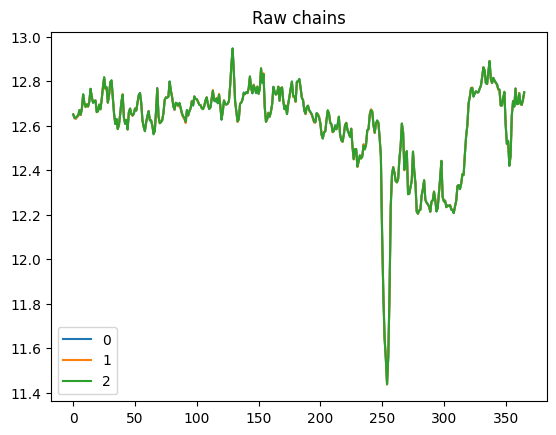

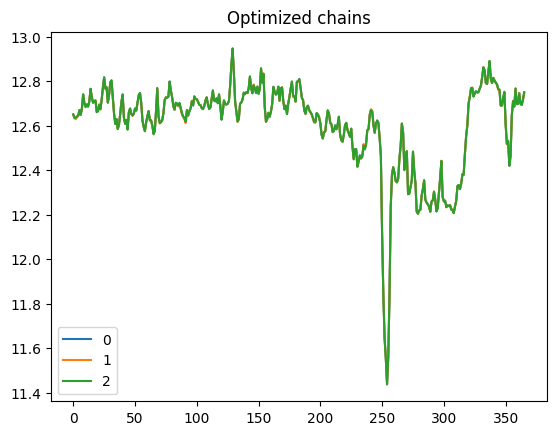

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.078    0.112        0.0      0.0     889.0    1142.0   
eps  0.100  0.007   0.087    0.115        0.0      0.0    1304.0    2529.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.079    0.111        0.0      0.0     953.0    1636.0   
eps  0.099  0.007   0.085    0.112        0.0      0.0    1479.0    2476.0   

     r_hat  
sig    1.0  
eps    1.0  


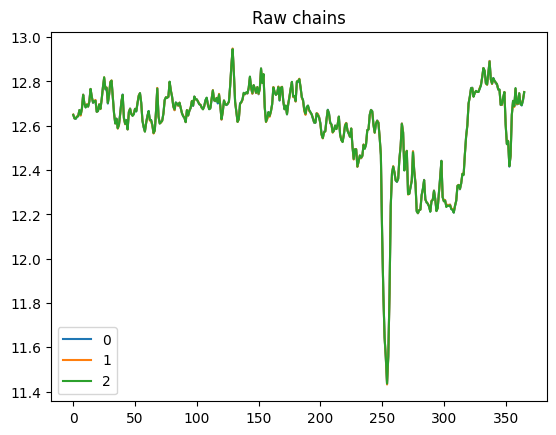

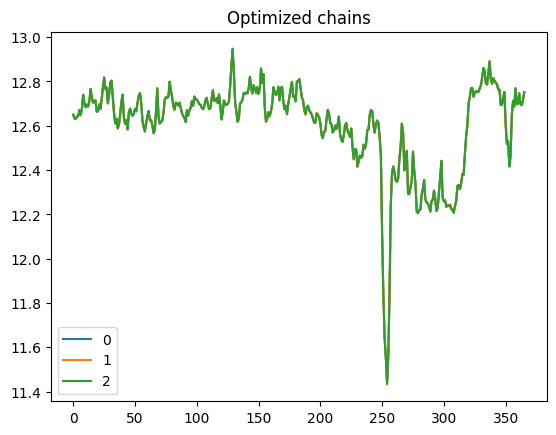

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.079    0.111        0.0      0.0     953.0    1636.0   
eps  0.099  0.007   0.085    0.112        0.0      0.0    1479.0    2476.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 14 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.113        0.0      0.0     737.0    1429.0   
eps  0.101  0.007   0.086    0.115        0.0      0.0     996.0    2065.0   

     r_hat  
sig    1.0  
eps    1.0  


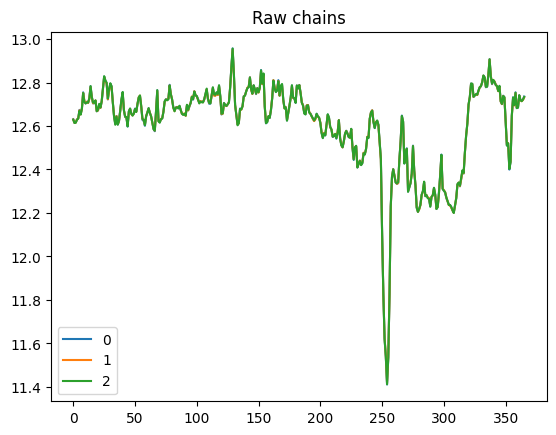

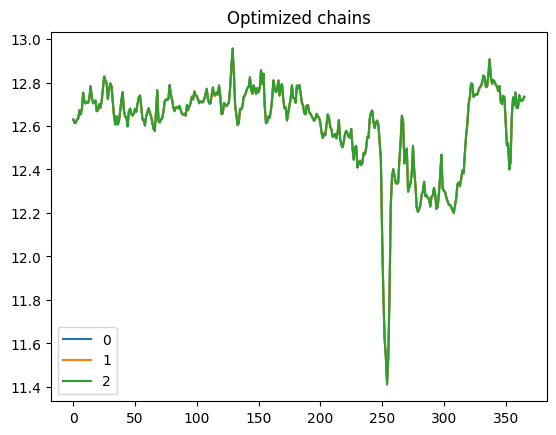

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.113        0.0      0.0     737.0    1429.0   
eps  0.101  0.007   0.086    0.115        0.0      0.0     996.0    2065.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.110  0.012   0.088    0.132        0.0      0.0     578.0    1214.0   
eps  0.148  0.010   0.129    0.165        0.0      0.0    1101.0    1742.0   

     r_hat  
sig   1.01  
eps   1.00  


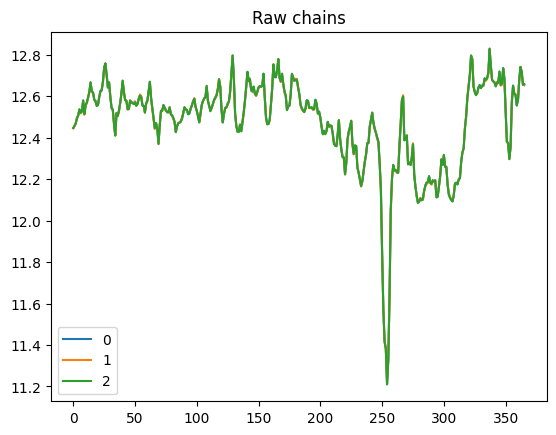

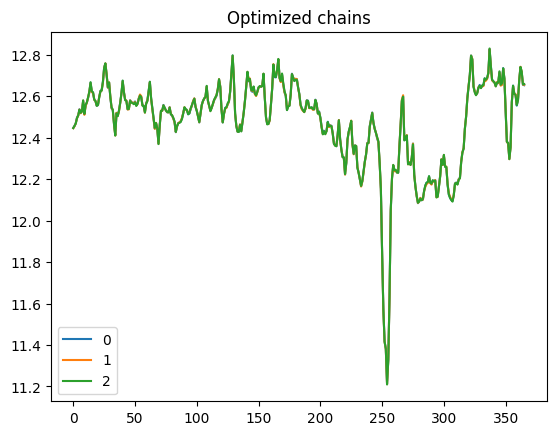

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.110  0.012   0.088    0.132        0.0      0.0     578.0    1214.0   
eps  0.148  0.010   0.129    0.165        0.0      0.0    1101.0    1742.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 10 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.085  0.005   0.075    0.095        0.0      0.0    2213.0    3613.0   
eps  0.054  0.005   0.045    0.064        0.0      0.0     991.0    1404.0   

     r_hat  
sig    1.0  
eps    1.0  


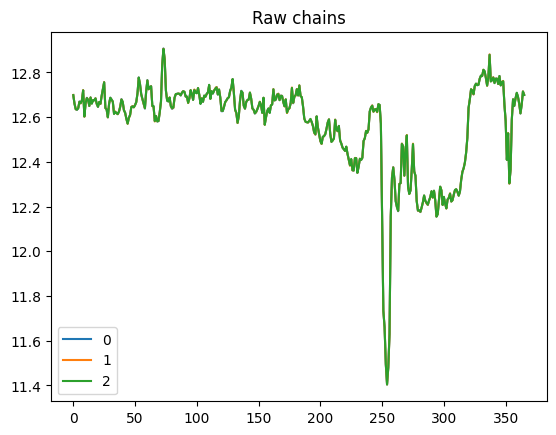

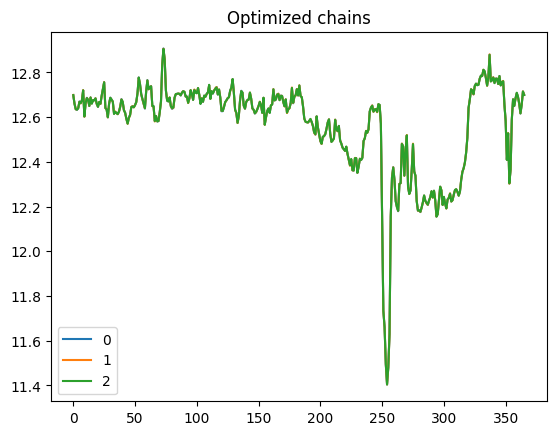

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.085  0.005   0.075    0.095        0.0      0.0    2213.0    3613.0   
eps  0.054  0.005   0.045    0.064        0.0      0.0     991.0    1404.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 18 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.109  0.012   0.089    0.132        0.0      0.0     635.0    1587.0   
eps  0.143  0.009   0.126    0.161        0.0      0.0    1240.0    2228.0   

     r_hat  
sig    1.0  
eps    1.0  


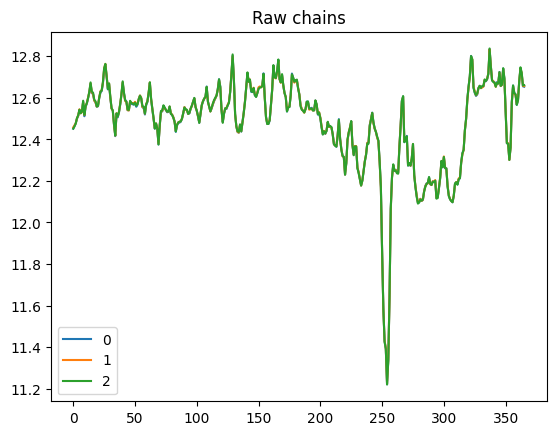

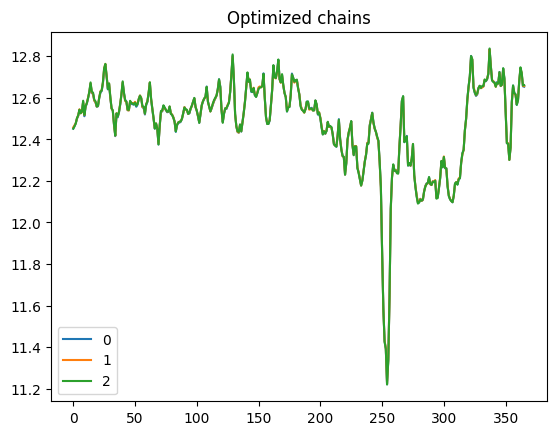

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.109  0.012   0.089    0.132        0.0      0.0     635.0    1587.0   
eps  0.143  0.009   0.126    0.161        0.0      0.0    1240.0    2228.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.079    0.111        0.0      0.0     861.0    1700.0   
eps  0.100  0.007   0.086    0.114        0.0      0.0    1341.0    2788.0   

     r_hat  
sig    1.0  
eps    1.0  


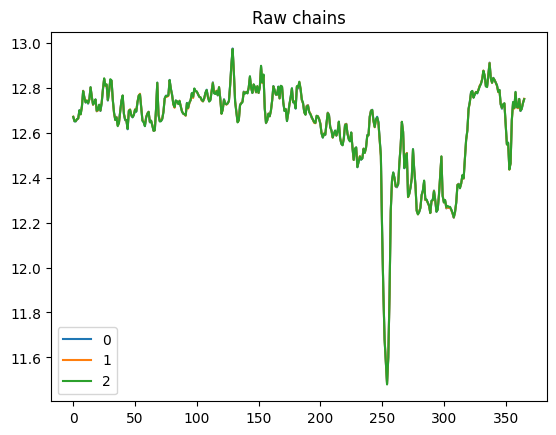

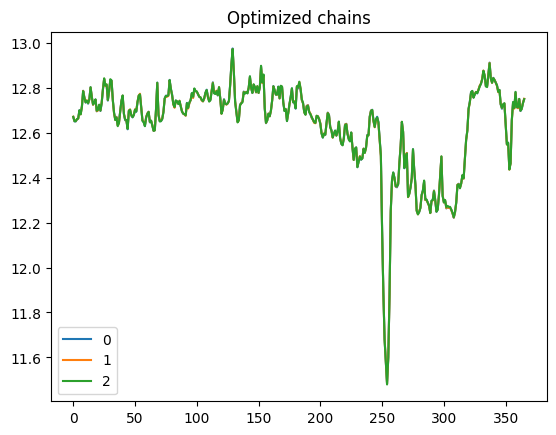

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.079    0.111        0.0      0.0     861.0    1700.0   
eps  0.100  0.007   0.086    0.114        0.0      0.0    1341.0    2788.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.112        0.0      0.0     958.0    1770.0   
eps  0.101  0.007   0.087    0.115        0.0      0.0    1507.0    2501.0   

     r_hat  
sig    1.0  
eps    1.0  


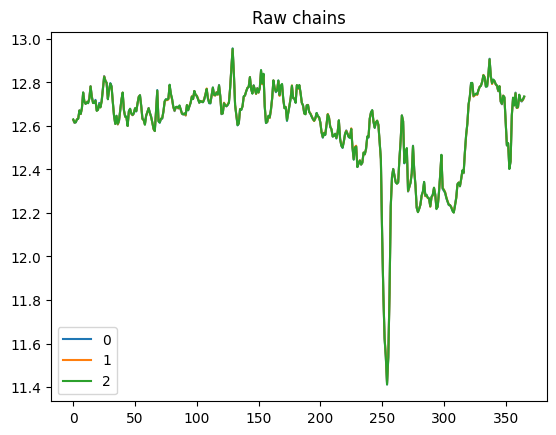

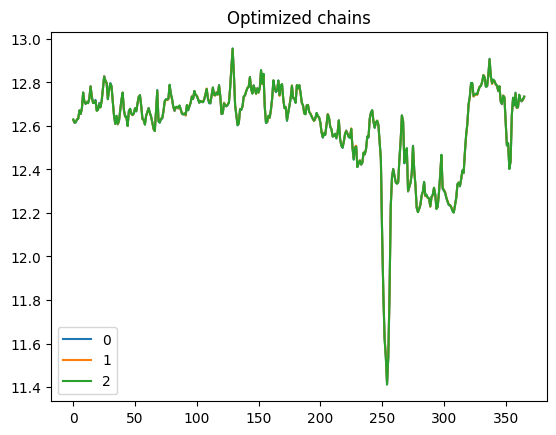

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.112        0.0      0.0     958.0    1770.0   
eps  0.101  0.007   0.087    0.115        0.0      0.0    1507.0    2501.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.081    0.113        0.0      0.0     994.0    1637.0   
eps  0.102  0.007   0.088    0.116        0.0      0.0    1407.0    2383.0   

     r_hat  
sig    1.0  
eps    1.0  


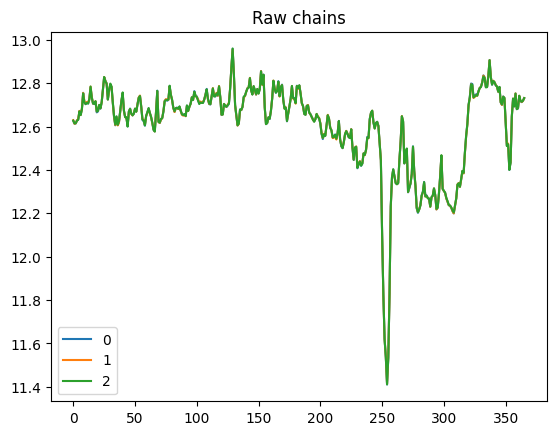

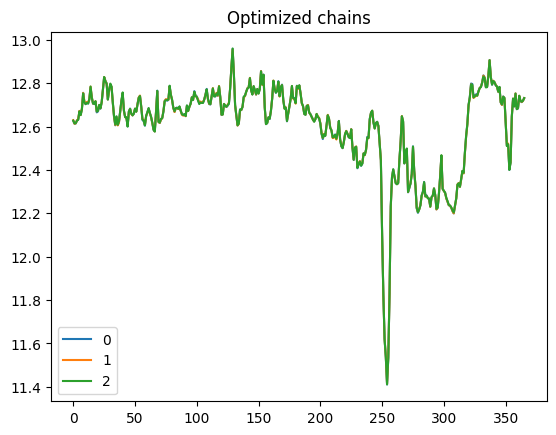

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.081    0.113        0.0      0.0     994.0    1637.0   
eps  0.102  0.007   0.088    0.116        0.0      0.0    1407.0    2383.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 12 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.080    0.113        0.0      0.0     909.0    1767.0   
eps  0.101  0.008   0.087    0.115        0.0      0.0    1376.0    2543.0   

     r_hat  
sig   1.01  
eps   1.00  


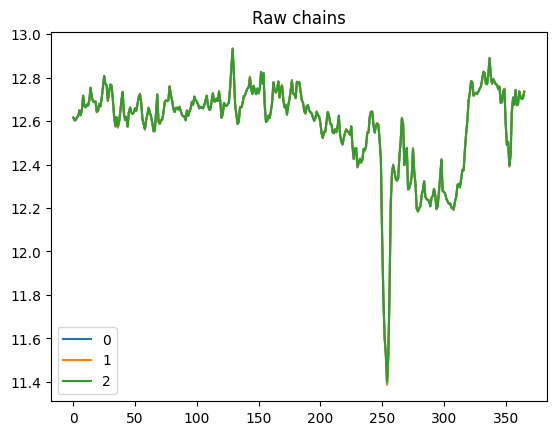

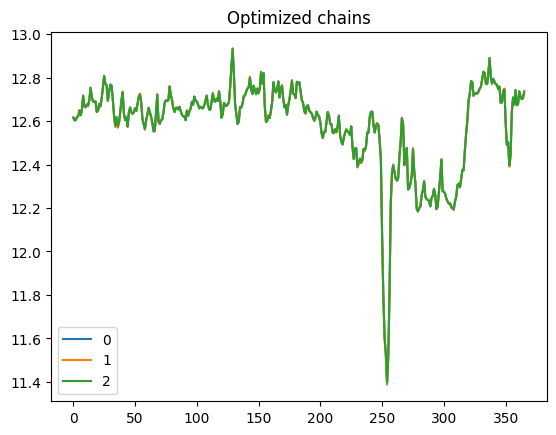

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.080    0.113        0.0      0.0     909.0    1767.0   
eps  0.101  0.008   0.087    0.115        0.0      0.0    1376.0    2543.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.077    0.109        0.0      0.0     939.0    1883.0   
eps  0.100  0.007   0.087    0.114        0.0      0.0    1287.0    2432.0   

     r_hat  
sig    1.0  
eps    1.0  


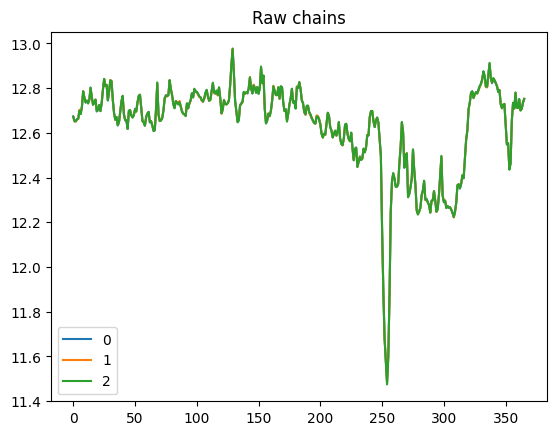

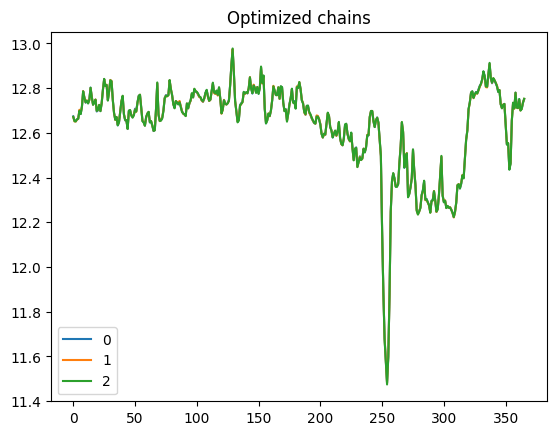

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.077    0.109        0.0      0.0     939.0    1883.0   
eps  0.100  0.007   0.087    0.114        0.0      0.0    1287.0    2432.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 12 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.112        0.0      0.0     886.0    1758.0   
eps  0.101  0.007   0.087    0.114        0.0      0.0    1309.0    2639.0   

     r_hat  
sig    1.0  
eps    1.0  


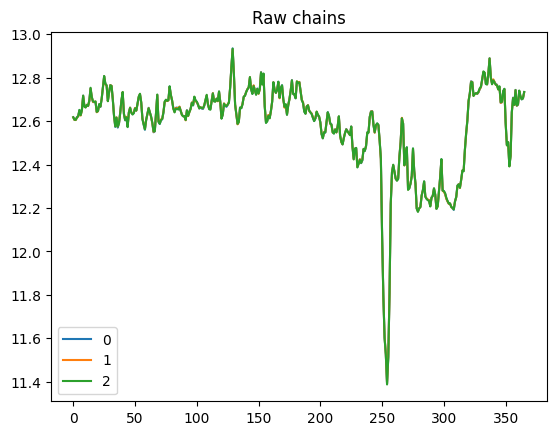

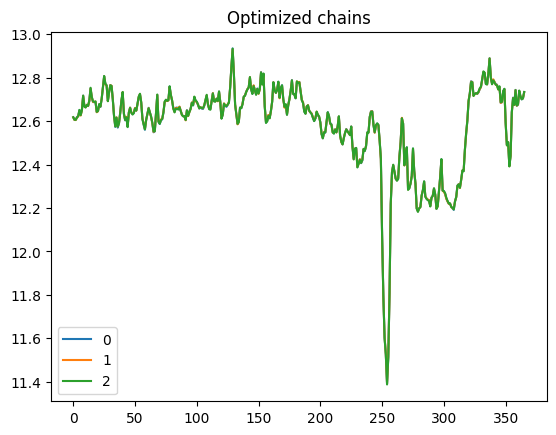

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.112        0.0      0.0     886.0    1758.0   
eps  0.101  0.007   0.087    0.114        0.0      0.0    1309.0    2639.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 12 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.097  0.009   0.081    0.114        0.0      0.0     887.0    1547.0   
eps  0.102  0.008   0.088    0.116        0.0      0.0    1443.0    2667.0   

     r_hat  
sig    1.0  
eps    1.0  


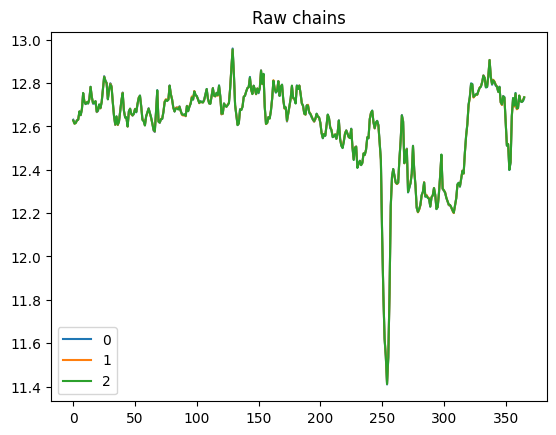

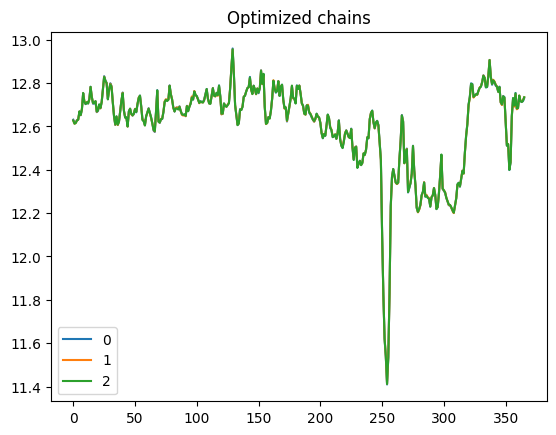

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.097  0.009   0.081    0.114        0.0      0.0     887.0    1547.0   
eps  0.102  0.008   0.088    0.116        0.0      0.0    1443.0    2667.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 17 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.011   0.083    0.122        0.0      0.0     685.0    1328.0   
eps  0.127  0.009   0.111    0.144        0.0      0.0    1266.0    2026.0   

     r_hat  
sig   1.01  
eps   1.00  


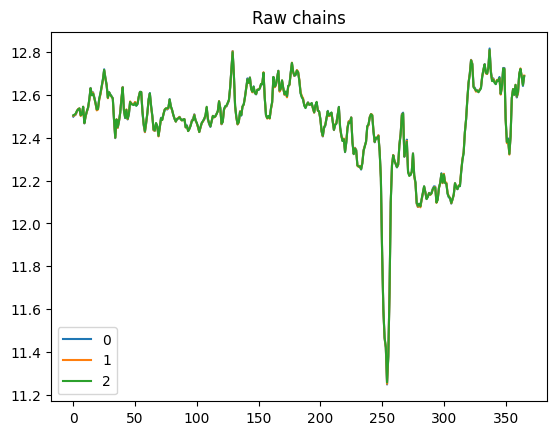

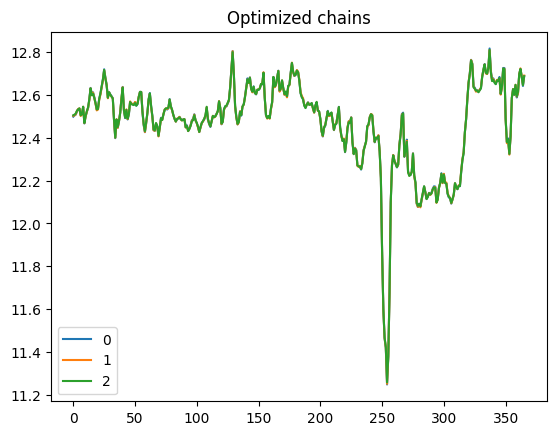

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.011   0.083    0.122        0.0      0.0     685.0    1328.0   
eps  0.127  0.009   0.111    0.144        0.0      0.0    1266.0    2026.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.109  0.011   0.087    0.129        0.0      0.0     646.0    1409.0   
eps  0.143  0.010   0.125    0.161        0.0      0.0    1328.0    2646.0   

     r_hat  
sig    1.0  
eps    1.0  


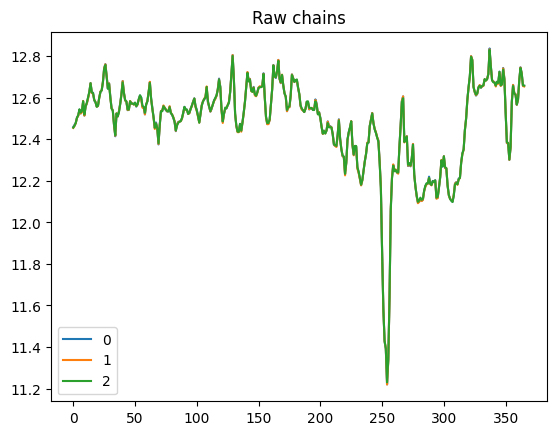

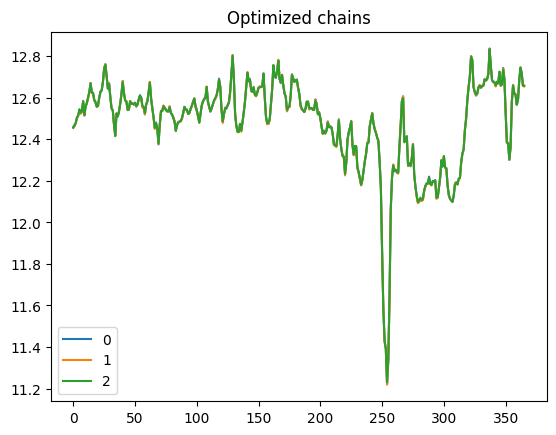

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.109  0.011   0.087    0.129        0.0      0.0     646.0    1409.0   
eps  0.143  0.010   0.125    0.161        0.0      0.0    1328.0    2646.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 12 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.080    0.113        0.0      0.0     799.0    1611.0   
eps  0.101  0.008   0.086    0.115        0.0      0.0    1193.0    2254.0   

     r_hat  
sig    1.0  
eps    1.0  


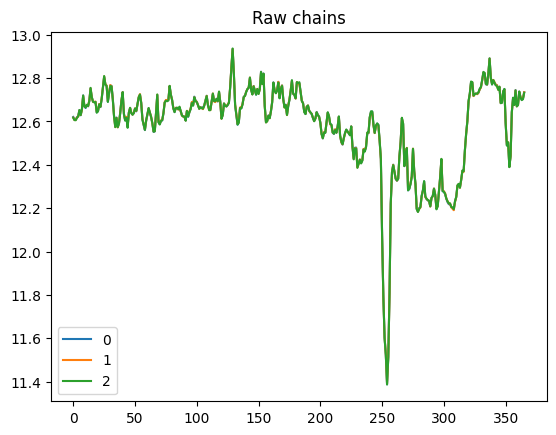

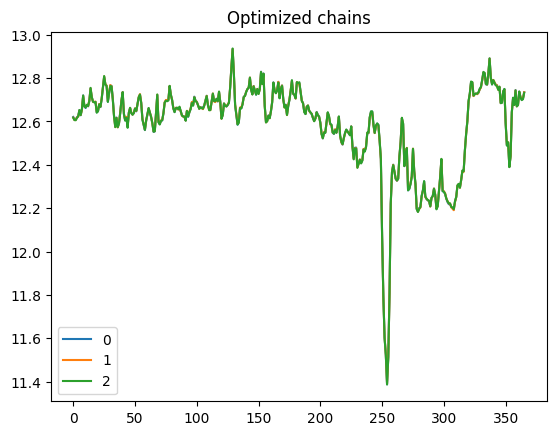

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.080    0.113        0.0      0.0     799.0    1611.0   
eps  0.101  0.008   0.086    0.115        0.0      0.0    1193.0    2254.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.111        0.0      0.0     836.0    1380.0   
eps  0.101  0.007   0.087    0.114        0.0      0.0    1272.0    2471.0   

     r_hat  
sig   1.01  
eps   1.00  


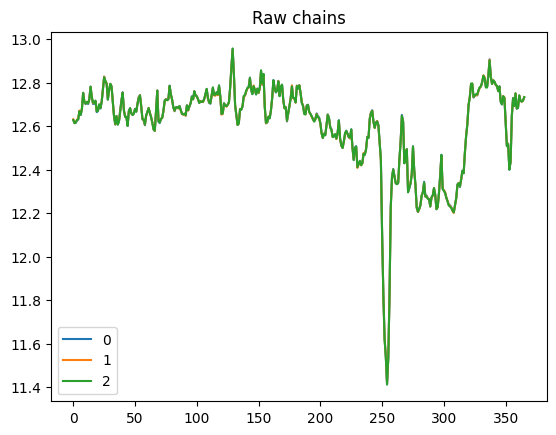

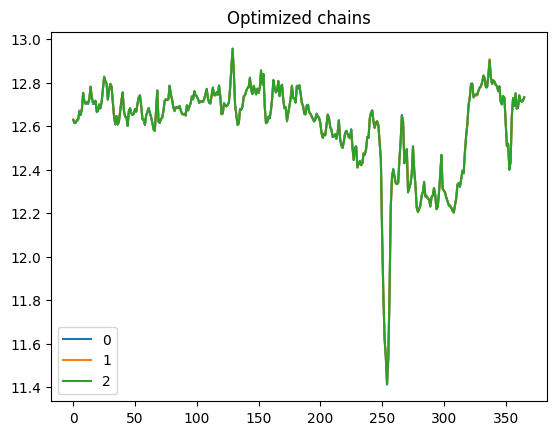

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.111        0.0      0.0     836.0    1380.0   
eps  0.101  0.007   0.087    0.114        0.0      0.0    1272.0    2471.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 10 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.090  0.006   0.079    0.100        0.0      0.0    2210.0    3528.0   
eps  0.055  0.005   0.045    0.065        0.0      0.0    1002.0    1471.0   

     r_hat  
sig    1.0  
eps    1.0  


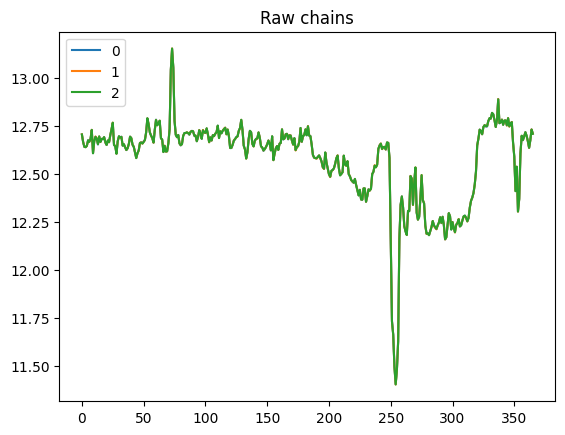

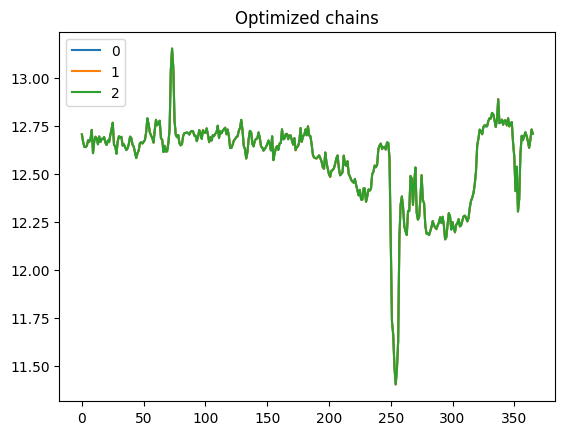

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.090  0.006   0.079    0.100        0.0      0.0    2210.0    3528.0   
eps  0.055  0.005   0.045    0.065        0.0      0.0    1002.0    1471.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.077    0.111        0.0      0.0     824.0    1425.0   
eps  0.100  0.007   0.087    0.114        0.0      0.0    1320.0    2663.0   

     r_hat  
sig    1.0  
eps    1.0  


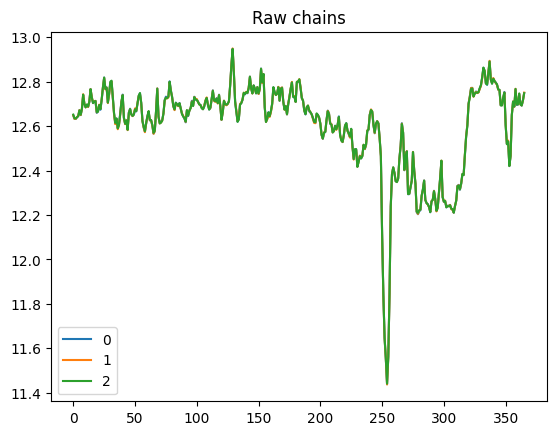

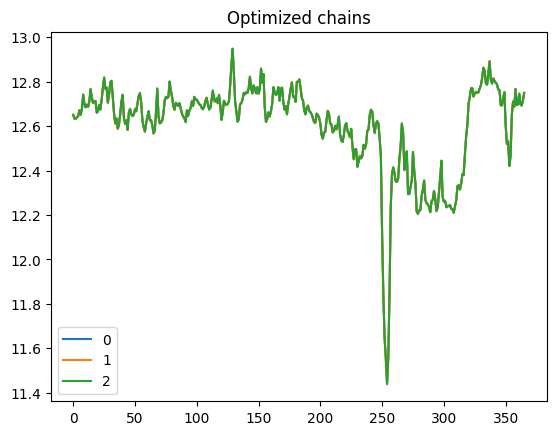

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.077    0.111        0.0      0.0     824.0    1425.0   
eps  0.100  0.007   0.087    0.114        0.0      0.0    1320.0    2663.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.111        0.0      0.0     922.0    1910.0   
eps  0.101  0.007   0.087    0.115        0.0      0.0    1447.0    2514.0   

     r_hat  
sig    1.0  
eps    1.0  


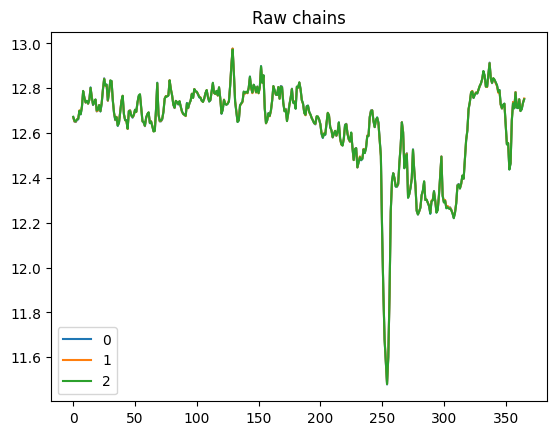

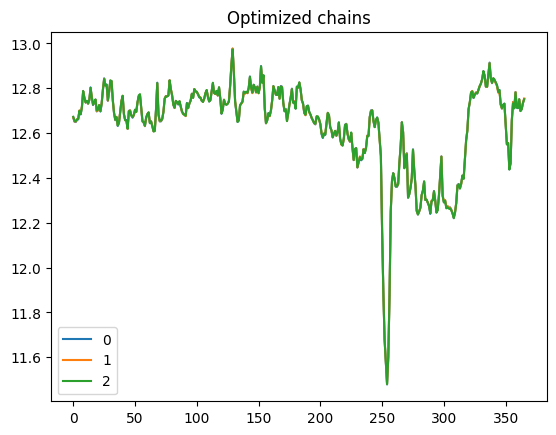

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.111        0.0      0.0     922.0    1910.0   
eps  0.101  0.007   0.087    0.115        0.0      0.0    1447.0    2514.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 19 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.108  0.012   0.088    0.131        0.0      0.0     636.0    1332.0   
eps  0.142  0.009   0.124    0.159        0.0      0.0    1202.0    1908.0   

     r_hat  
sig    1.0  
eps    1.0  


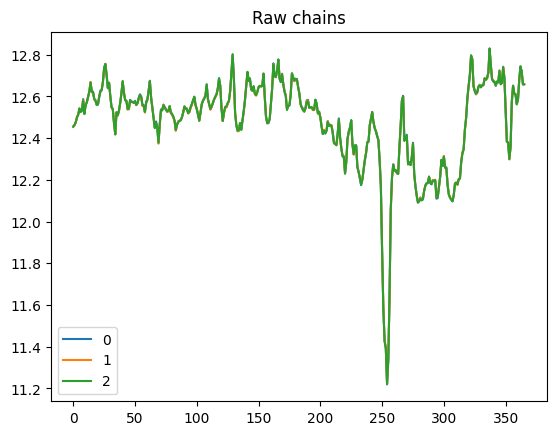

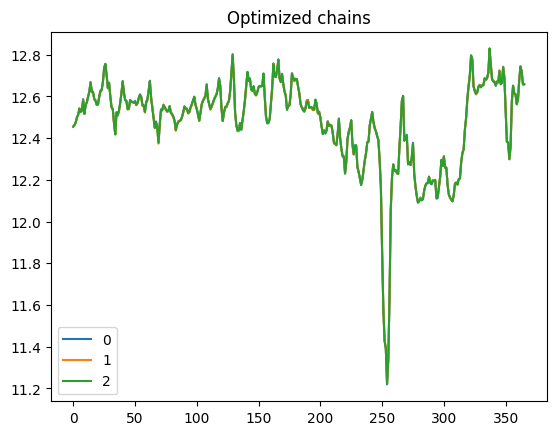

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.108  0.012   0.088    0.131        0.0      0.0     636.0    1332.0   
eps  0.142  0.009   0.124    0.159        0.0      0.0    1202.0    1908.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.080    0.113        0.0      0.0     933.0    1581.0   
eps  0.101  0.007   0.087    0.115        0.0      0.0    1389.0    2567.0   

     r_hat  
sig    1.0  
eps    1.0  


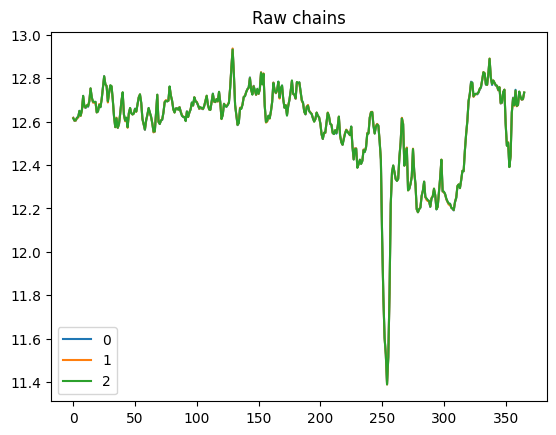

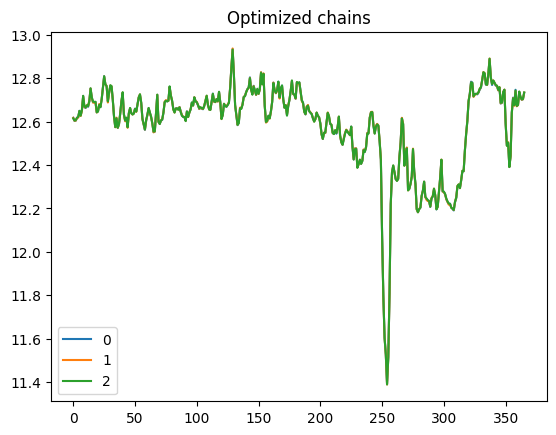

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.080    0.113        0.0      0.0     933.0    1581.0   
eps  0.101  0.007   0.087    0.115        0.0      0.0    1389.0    2567.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 11 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.092  0.007   0.078    0.105        0.0      0.0    1280.0    2365.0   
eps  0.082  0.006   0.071    0.095        0.0      0.0    1401.0    1846.0   

     r_hat  
sig    1.0  
eps    1.0  


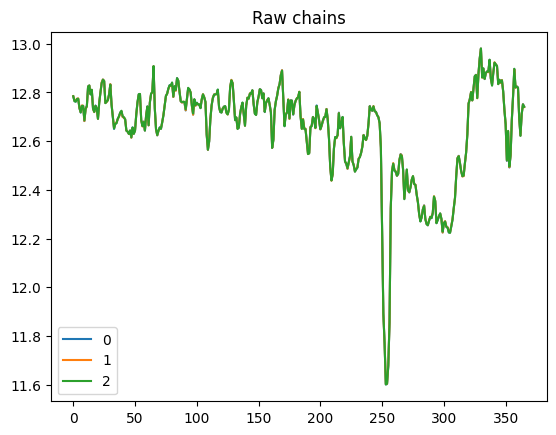

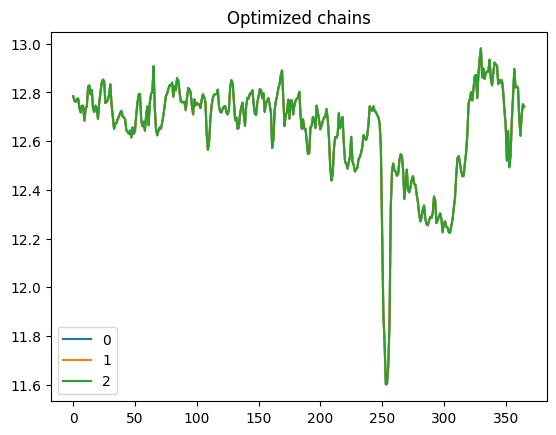

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.092  0.007   0.078    0.105        0.0      0.0    1280.0    2365.0   
eps  0.082  0.006   0.071    0.095        0.0      0.0    1401.0    1846.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 11 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.084  0.005   0.074    0.094        0.0      0.0    2231.0    3315.0   
eps  0.055  0.005   0.046    0.065        0.0      0.0    1075.0    1804.0   

     r_hat  
sig    1.0  
eps    1.0  


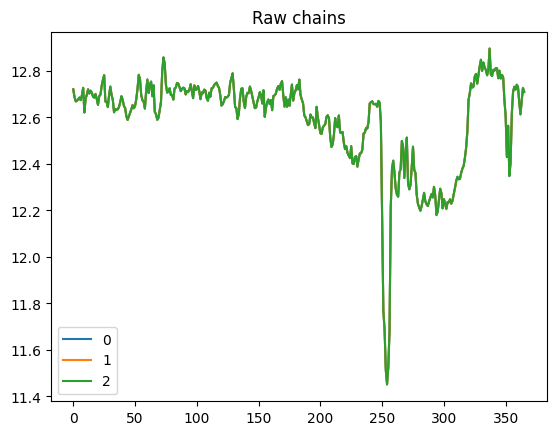

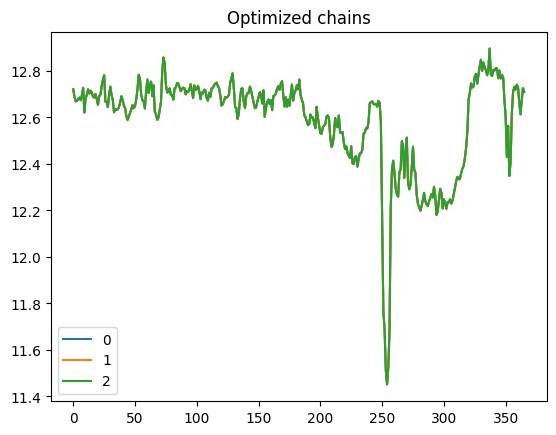

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.084  0.005   0.074    0.094        0.0      0.0    2231.0    3315.0   
eps  0.055  0.005   0.046    0.065        0.0      0.0    1075.0    1804.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 17 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.011   0.082    0.121        0.0      0.0     661.0    1083.0   
eps  0.124  0.009   0.108    0.140        0.0      0.0    1341.0    2178.0   

     r_hat  
sig   1.01  
eps   1.00  


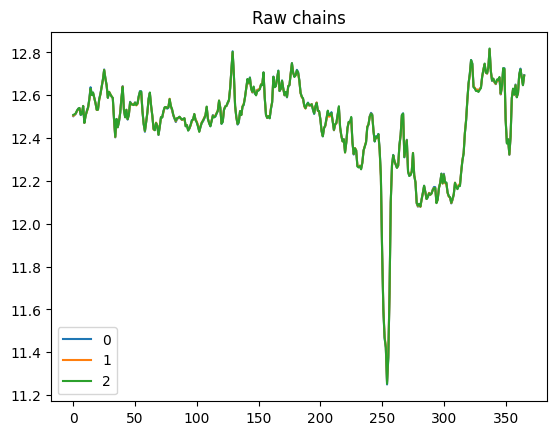

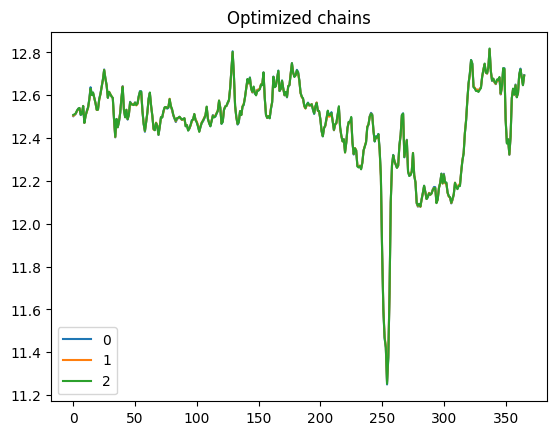

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.011   0.082    0.121        0.0      0.0     661.0    1083.0   
eps  0.124  0.009   0.108    0.140        0.0      0.0    1341.0    2178.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 17 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.010   0.083    0.122        0.0      0.0     611.0    1230.0   
eps  0.125  0.009   0.108    0.140        0.0      0.0    1253.0    2313.0   

     r_hat  
sig   1.01  
eps   1.00  


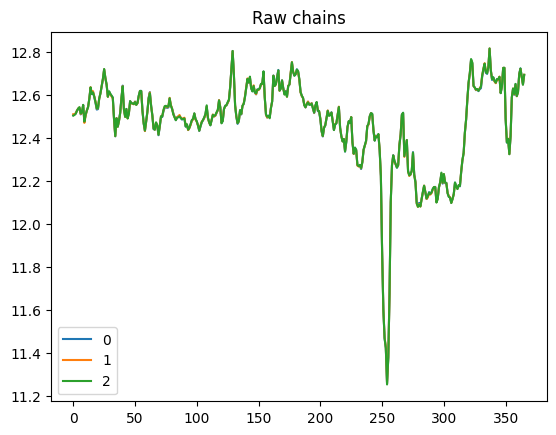

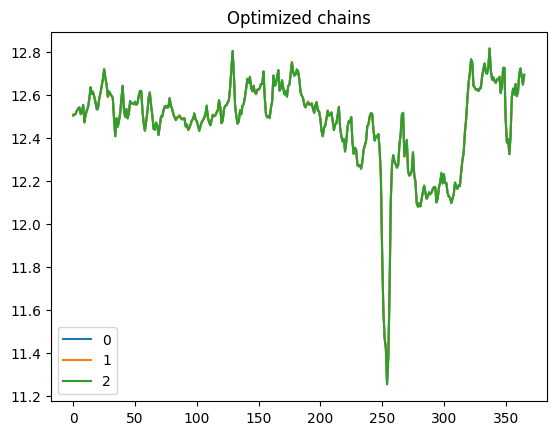

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.010   0.083    0.122        0.0      0.0     611.0    1230.0   
eps  0.125  0.009   0.108    0.140        0.0      0.0    1253.0    2313.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 17 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.010   0.083    0.122        0.0      0.0     717.0    1442.0   
eps  0.124  0.009   0.107    0.140        0.0      0.0    1375.0    2057.0   

     r_hat  
sig    1.0  
eps    1.0  


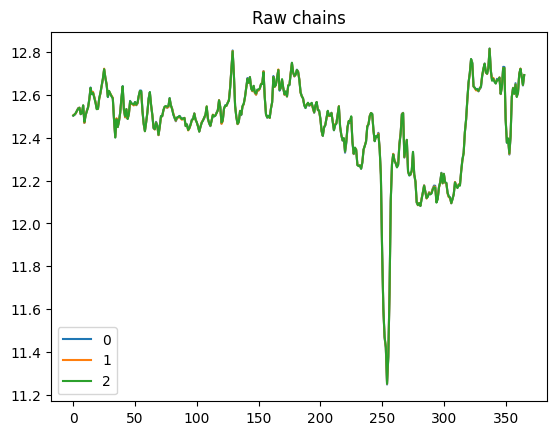

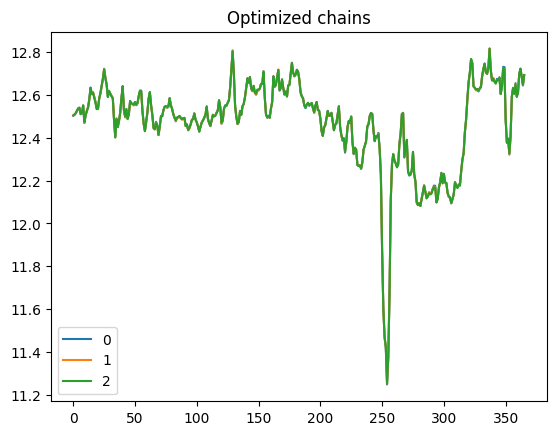

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.010   0.083    0.122        0.0      0.0     717.0    1442.0   
eps  0.124  0.009   0.107    0.140        0.0      0.0    1375.0    2057.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 12 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.081    0.113        0.0      0.0     918.0    2228.0   
eps  0.100  0.007   0.087    0.114        0.0      0.0    1260.0    2383.0   

     r_hat  
sig    1.0  
eps    1.0  


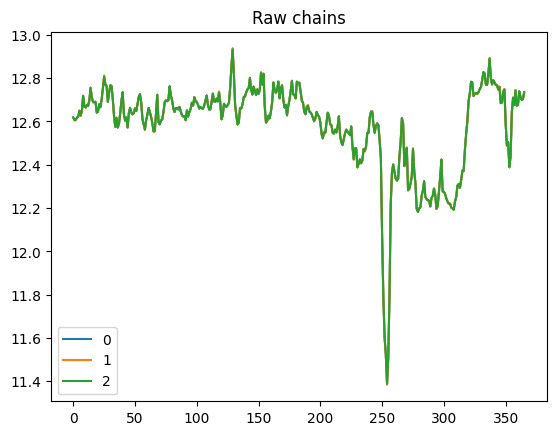

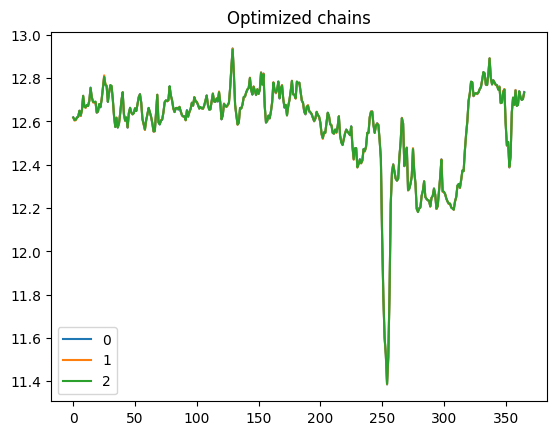

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.081    0.113        0.0      0.0     918.0    2228.0   
eps  0.100  0.007   0.087    0.114        0.0      0.0    1260.0    2383.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 16 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.010   0.082    0.121        0.0      0.0     715.0    1756.0   
eps  0.125  0.009   0.109    0.141        0.0      0.0    1247.0    2609.0   

     r_hat  
sig   1.01  
eps   1.00  


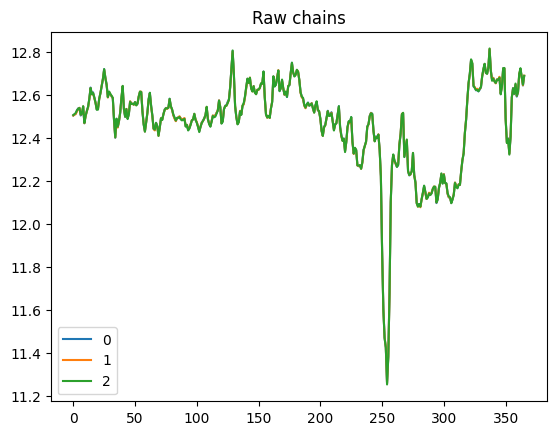

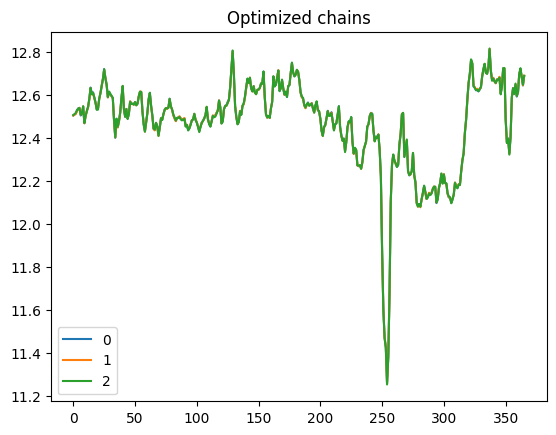

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.010   0.082    0.121        0.0      0.0     715.0    1756.0   
eps  0.125  0.009   0.109    0.141        0.0      0.0    1247.0    2609.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.113        0.0      0.0     885.0    1607.0   
eps  0.101  0.008   0.087    0.116        0.0      0.0    1333.0    1975.0   

     r_hat  
sig    1.0  
eps    1.0  


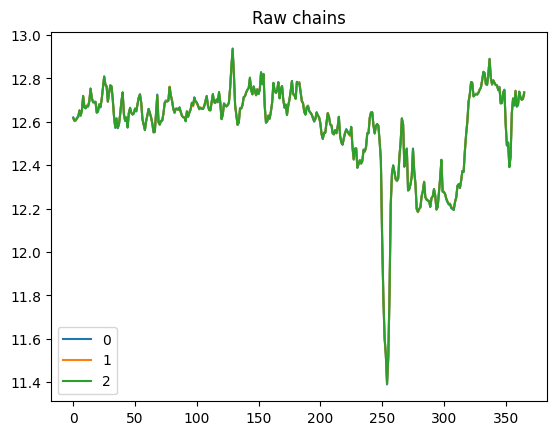

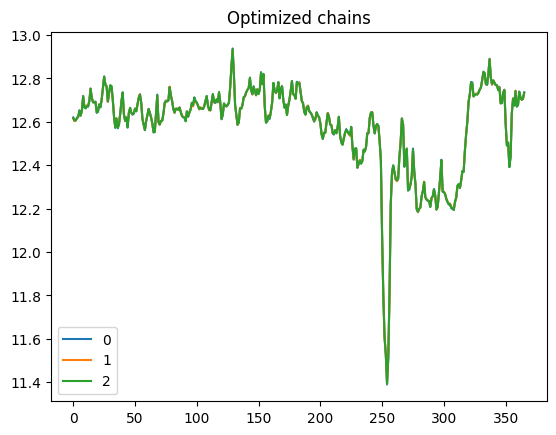

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.113        0.0      0.0     885.0    1607.0   
eps  0.101  0.008   0.087    0.116        0.0      0.0    1333.0    1975.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 12 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.113        0.0      0.0     840.0    1388.0   
eps  0.100  0.008   0.086    0.115        0.0      0.0    1196.0    2033.0   

     r_hat  
sig    1.0  
eps    1.0  


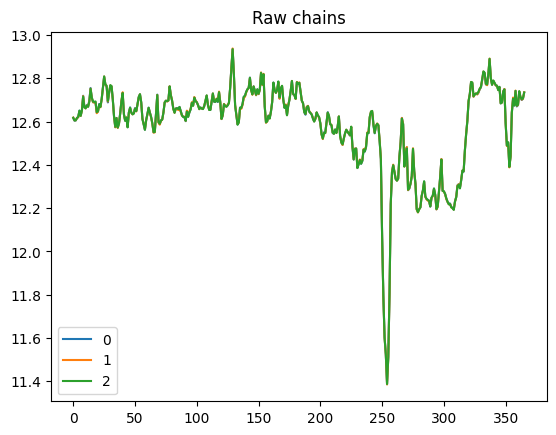

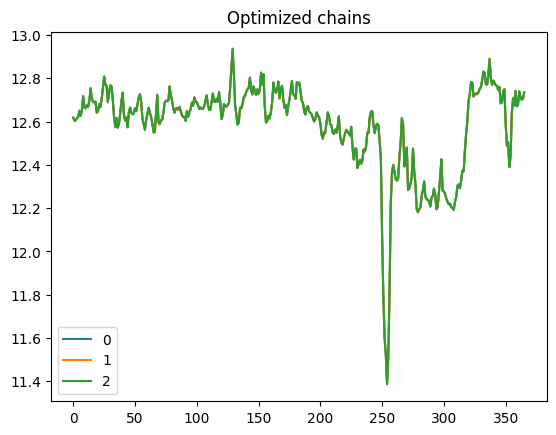

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.113        0.0      0.0     840.0    1388.0   
eps  0.100  0.008   0.086    0.115        0.0      0.0    1196.0    2033.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 12 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.080    0.113        0.0      0.0     811.0    1857.0   
eps  0.101  0.007   0.088    0.115        0.0      0.0    1438.0    2734.0   

     r_hat  
sig    1.0  
eps    1.0  


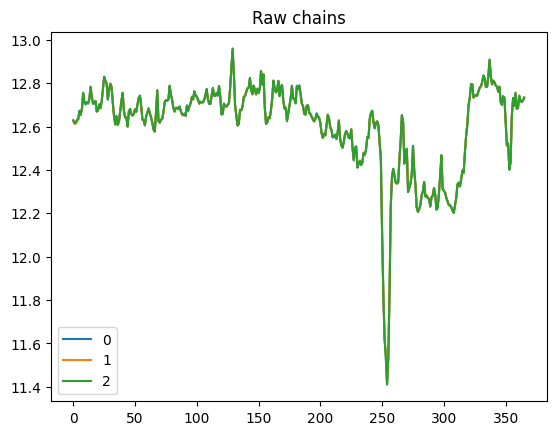

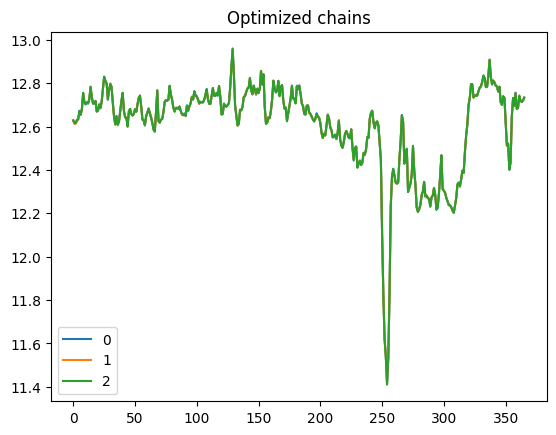

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.080    0.113        0.0      0.0     811.0    1857.0   
eps  0.101  0.007   0.088    0.115        0.0      0.0    1438.0    2734.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 18 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.011   0.078    0.118        0.0      0.0     577.0    1427.0   
eps  0.124  0.009   0.108    0.140        0.0      0.0    1200.0    2132.0   

     r_hat  
sig    1.0  
eps    1.0  


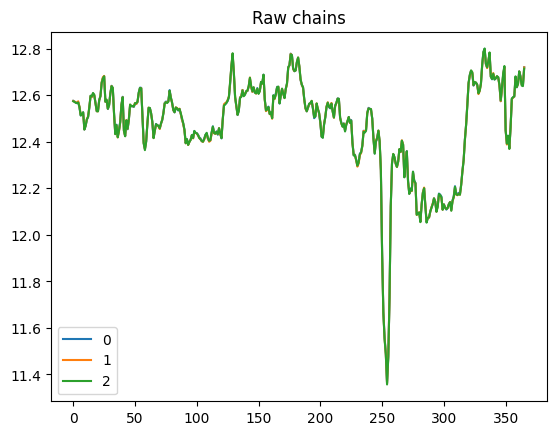

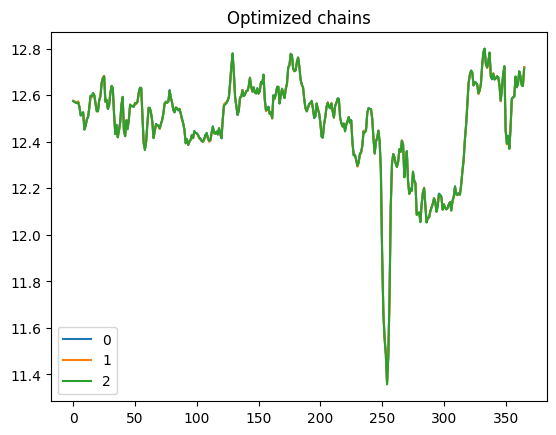

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.011   0.078    0.118        0.0      0.0     577.0    1427.0   
eps  0.124  0.009   0.108    0.140        0.0      0.0    1200.0    2132.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 15 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.111        0.0      0.0     989.0    1906.0   
eps  0.101  0.007   0.087    0.115        0.0      0.0    1408.0    2535.0   

     r_hat  
sig    1.0  
eps    1.0  


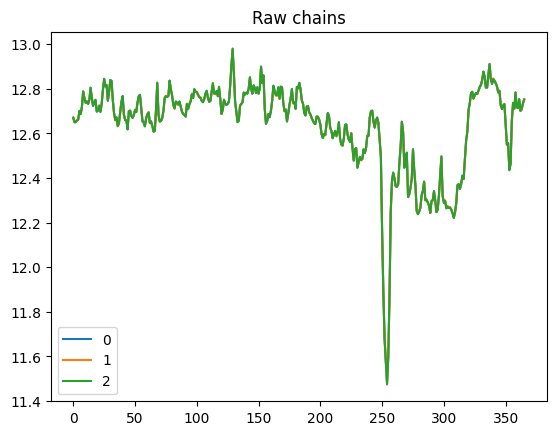

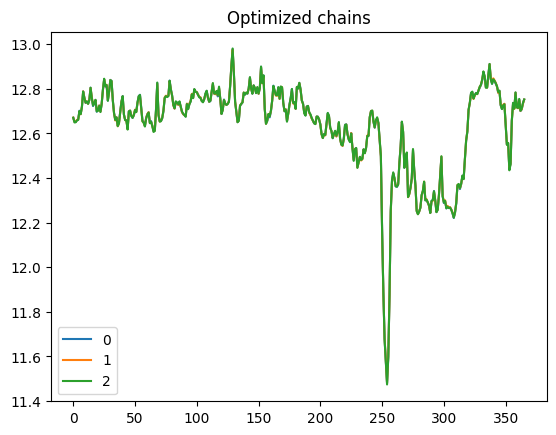

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.111        0.0      0.0     989.0    1906.0   
eps  0.101  0.007   0.087    0.115        0.0      0.0    1408.0    2535.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 12 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.112        0.0      0.0     979.0    2006.0   
eps  0.101  0.008   0.086    0.115        0.0      0.0    1339.0    2330.0   

     r_hat  
sig    1.0  
eps    1.0  


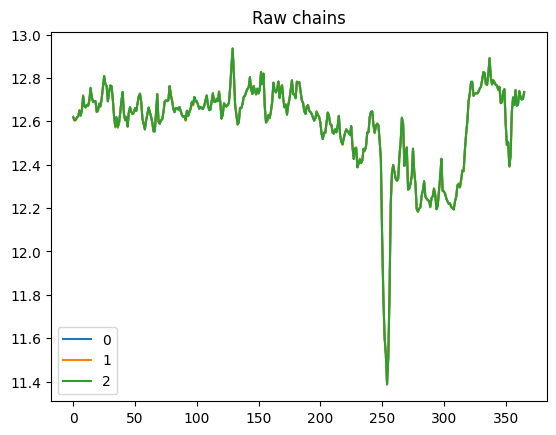

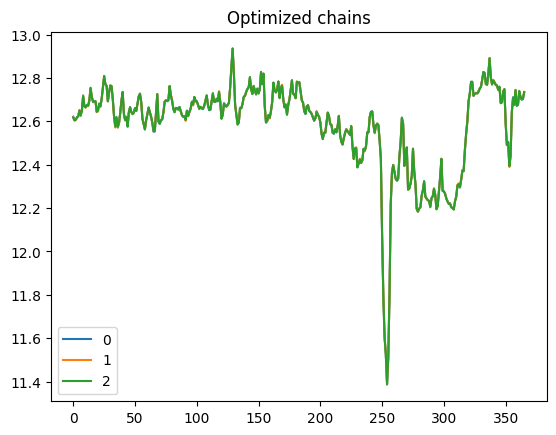

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.112        0.0      0.0     979.0    2006.0   
eps  0.101  0.008   0.086    0.115        0.0      0.0    1339.0    2330.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.080    0.112        0.0      0.0    1015.0    1824.0   
eps  0.102  0.007   0.088    0.115        0.0      0.0    1330.0    2584.0   

     r_hat  
sig    1.0  
eps    1.0  


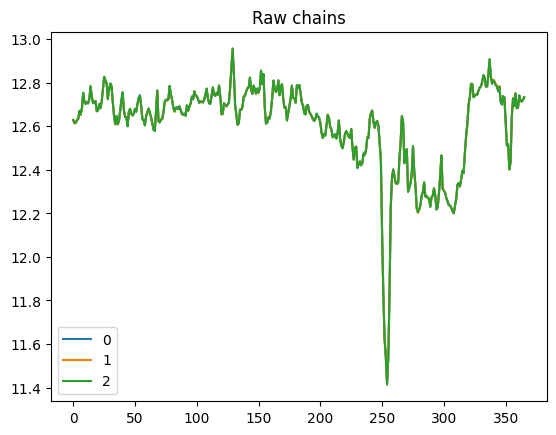

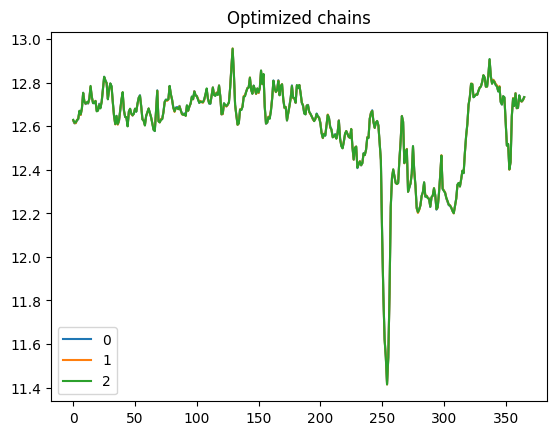

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.080    0.112        0.0      0.0    1015.0    1824.0   
eps  0.102  0.007   0.088    0.115        0.0      0.0    1330.0    2584.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.111        0.0      0.0     827.0    1961.0   
eps  0.099  0.007   0.085    0.113        0.0      0.0    1246.0    1629.0   

     r_hat  
sig    1.0  
eps    1.0  


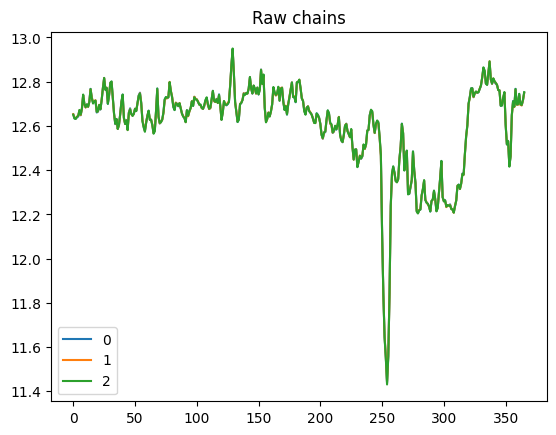

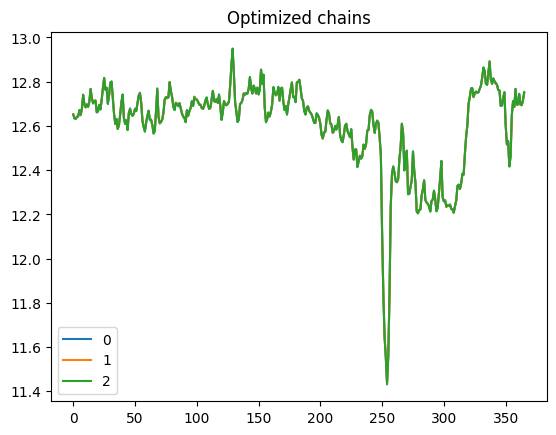

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.111        0.0      0.0     827.0    1961.0   
eps  0.099  0.007   0.085    0.113        0.0      0.0    1246.0    1629.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 20 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.011   0.078    0.121        0.0      0.0     647.0    1282.0   
eps  0.139  0.009   0.122    0.156        0.0      0.0    1336.0    2335.0   

     r_hat  
sig    1.0  
eps    1.0  


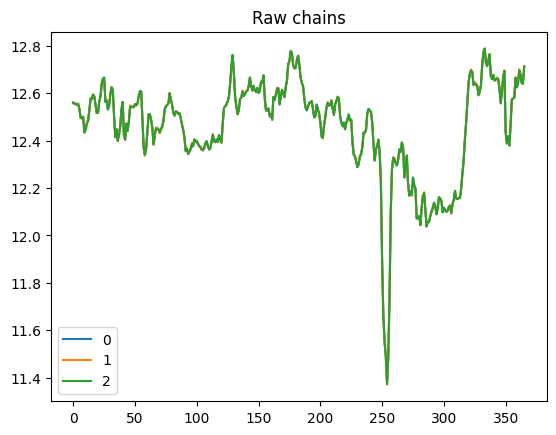

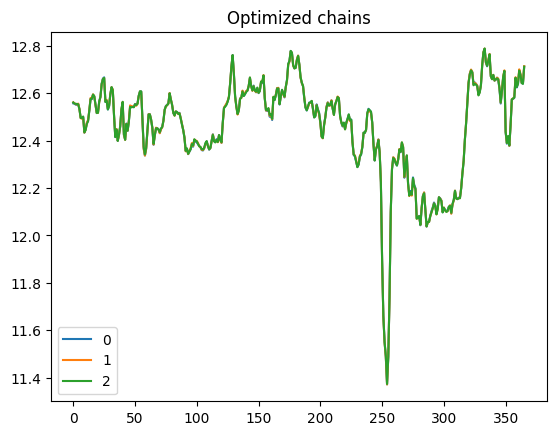

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.011   0.078    0.121        0.0      0.0     647.0    1282.0   
eps  0.139  0.009   0.122    0.156        0.0      0.0    1336.0    2335.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.080    0.112        0.0      0.0    1008.0    1947.0   
eps  0.102  0.007   0.089    0.116        0.0      0.0    1482.0    2433.0   

     r_hat  
sig    1.0  
eps    1.0  


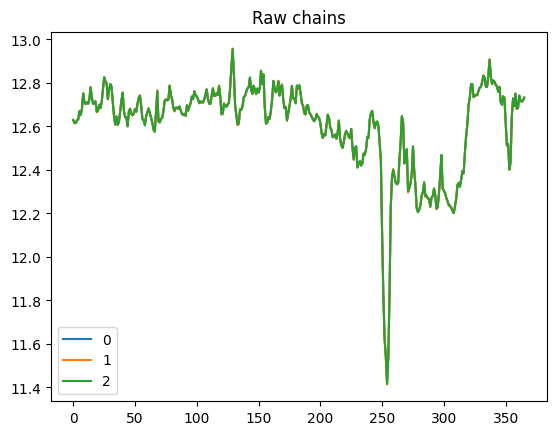

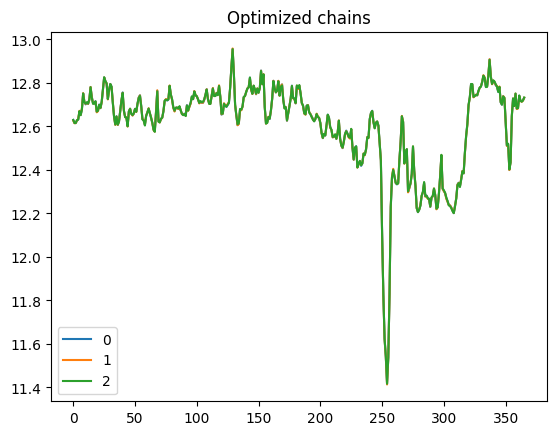

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.080    0.112        0.0      0.0    1008.0    1947.0   
eps  0.102  0.007   0.089    0.116        0.0      0.0    1482.0    2433.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 12 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.112        0.0      0.0     995.0    1613.0   
eps  0.101  0.007   0.087    0.115        0.0      0.0    1430.0    2516.0   

     r_hat  
sig    1.0  
eps    1.0  


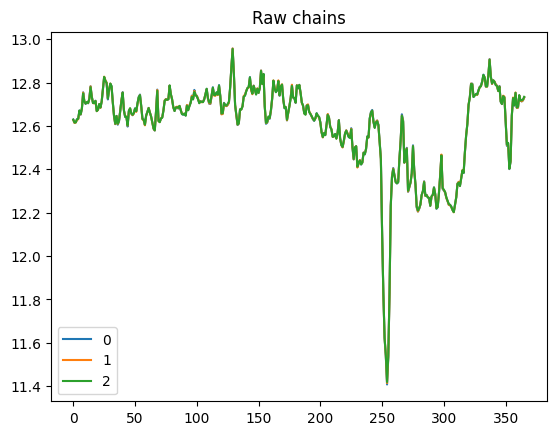

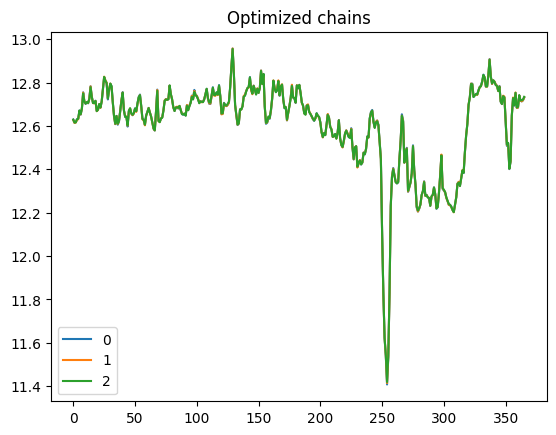

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.112        0.0      0.0     995.0    1613.0   
eps  0.101  0.007   0.087    0.115        0.0      0.0    1430.0    2516.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 10 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.084  0.005   0.073    0.093        0.0      0.0    2292.0    3580.0   
eps  0.054  0.005   0.045    0.064        0.0      0.0    1035.0    1625.0   

     r_hat  
sig    1.0  
eps    1.0  


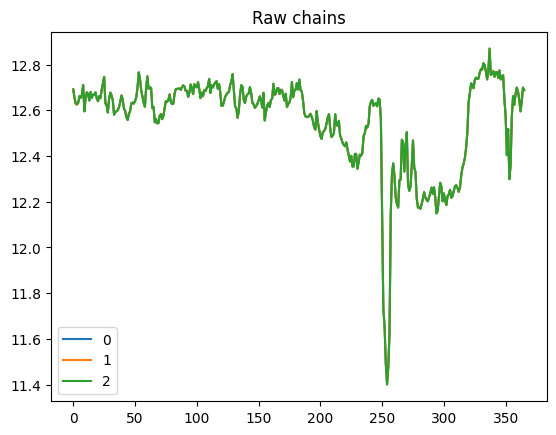

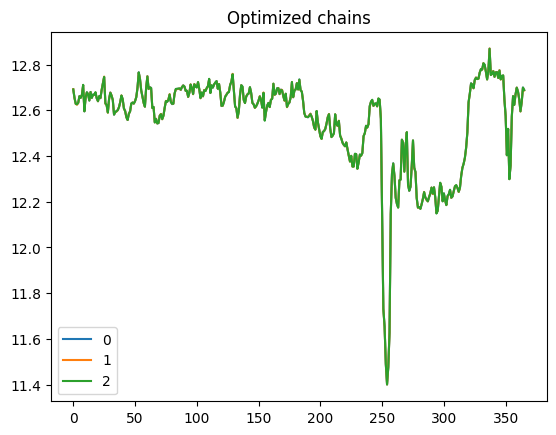

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.084  0.005   0.073    0.093        0.0      0.0    2292.0    3580.0   
eps  0.054  0.005   0.045    0.064        0.0      0.0    1035.0    1625.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.109  0.012   0.087    0.132        0.0      0.0     688.0    1248.0   
eps  0.148  0.010   0.131    0.167        0.0      0.0    1428.0    1895.0   

     r_hat  
sig   1.01  
eps   1.00  


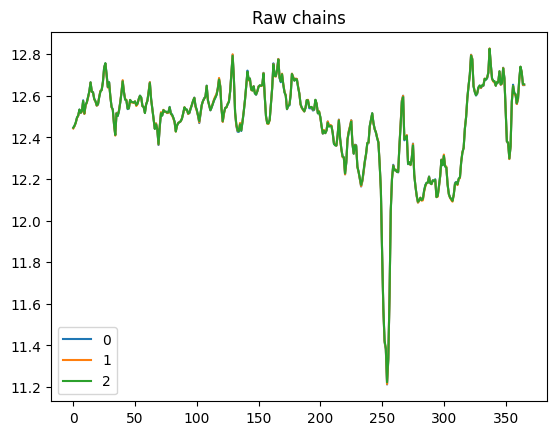

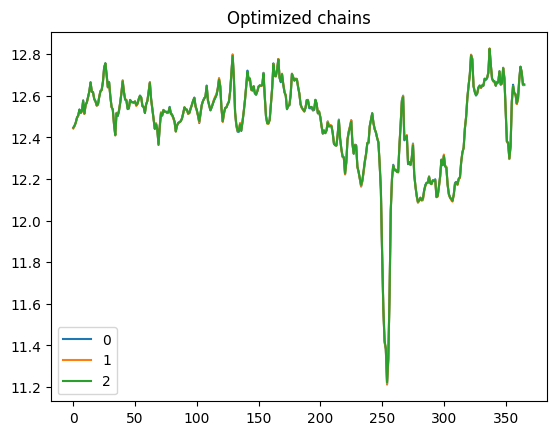

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.109  0.012   0.087    0.132        0.0      0.0     688.0    1248.0   
eps  0.148  0.010   0.131    0.167        0.0      0.0    1428.0    1895.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 14 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.110        0.0      0.0     963.0    2015.0   
eps  0.100  0.007   0.085    0.113        0.0      0.0    1253.0    2173.0   

     r_hat  
sig    1.0  
eps    1.0  


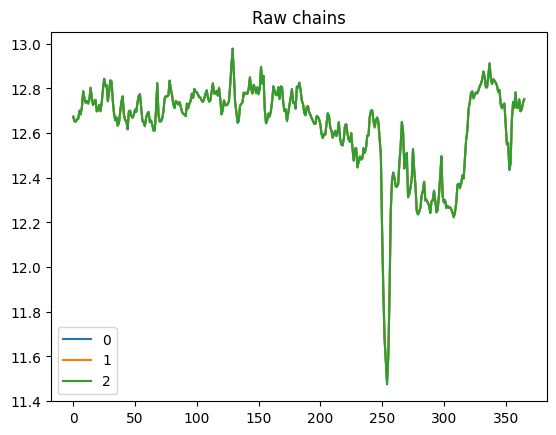

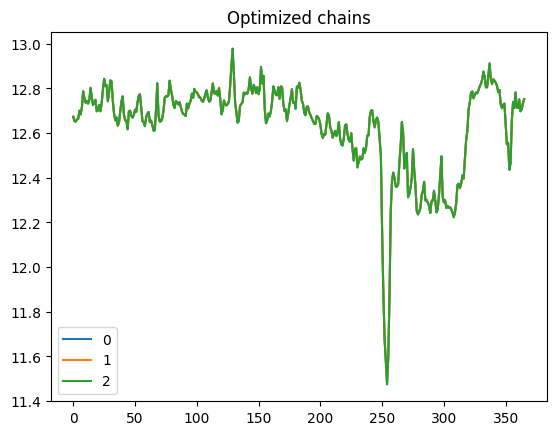

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.110        0.0      0.0     963.0    2015.0   
eps  0.100  0.007   0.085    0.113        0.0      0.0    1253.0    2173.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.077    0.110        0.0      0.0     841.0    1509.0   
eps  0.099  0.007   0.086    0.114        0.0      0.0    1214.0    2218.0   

     r_hat  
sig    1.0  
eps    1.0  


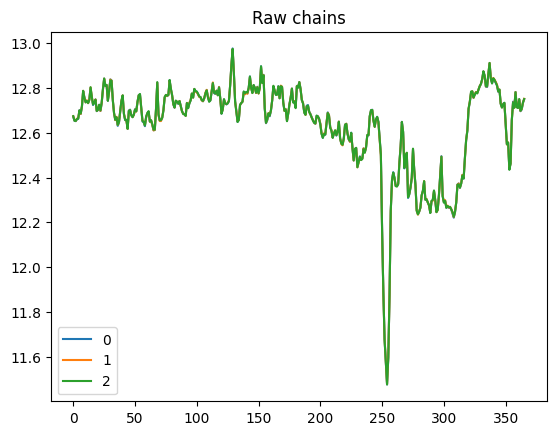

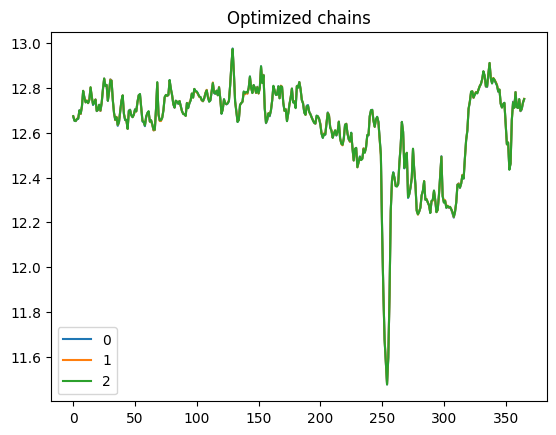

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.077    0.110        0.0      0.0     841.0    1509.0   
eps  0.099  0.007   0.086    0.114        0.0      0.0    1214.0    2218.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.010   0.084    0.122        0.0      0.0     795.0    1655.0   
eps  0.125  0.008   0.110    0.141        0.0      0.0    1365.0    2472.0   

     r_hat  
sig    1.0  
eps    1.0  


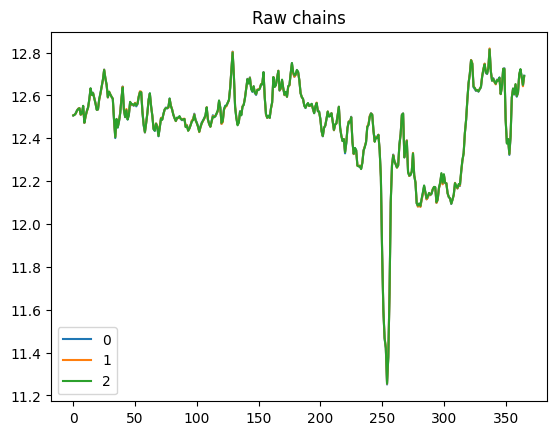

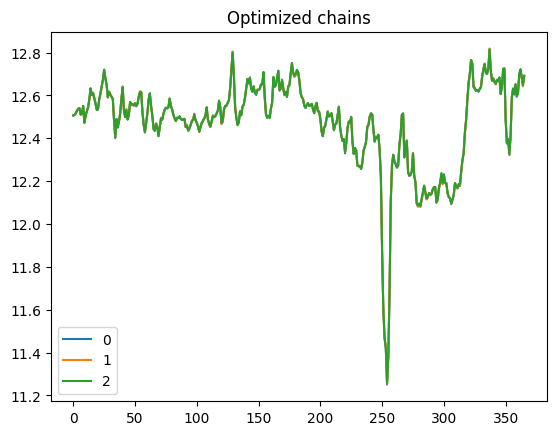

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.010   0.084    0.122        0.0      0.0     795.0    1655.0   
eps  0.125  0.008   0.110    0.141        0.0      0.0    1365.0    2472.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 14 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.110        0.0      0.0     888.0    1433.0   
eps  0.100  0.007   0.086    0.114        0.0      0.0    1269.0    2657.0   

     r_hat  
sig    1.0  
eps    1.0  


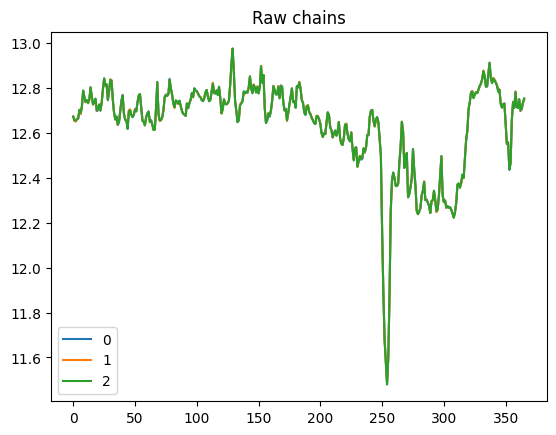

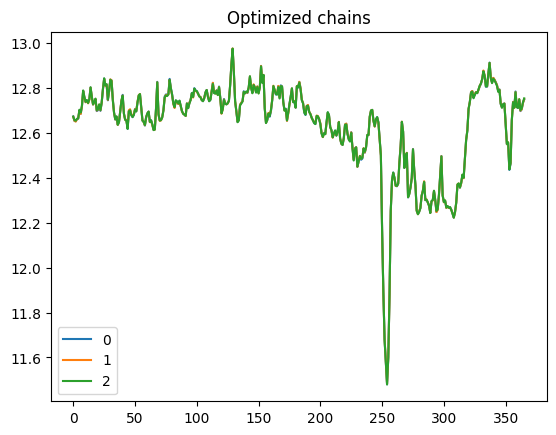

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.110        0.0      0.0     888.0    1433.0   
eps  0.100  0.007   0.086    0.114        0.0      0.0    1269.0    2657.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 12 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.111        0.0      0.0     770.0    1761.0   
eps  0.099  0.007   0.084    0.112        0.0      0.0    1201.0    2070.0   

     r_hat  
sig    1.0  
eps    1.0  


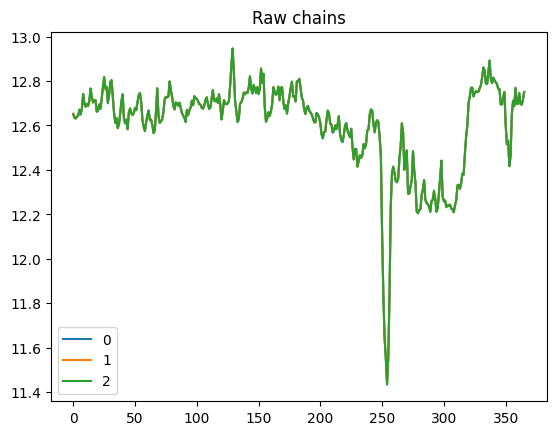

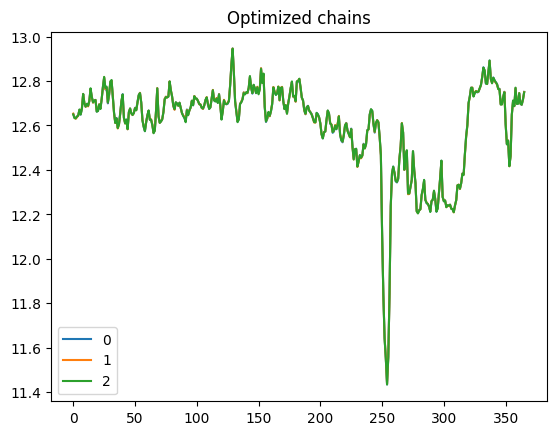

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.111        0.0      0.0     770.0    1761.0   
eps  0.099  0.007   0.084    0.112        0.0      0.0    1201.0    2070.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.110  0.012   0.087    0.133      0.001      0.0     503.0    1165.0   
eps  0.148  0.010   0.130    0.167      0.000      0.0    1011.0    1882.0   

     r_hat  
sig   1.01  
eps   1.00  


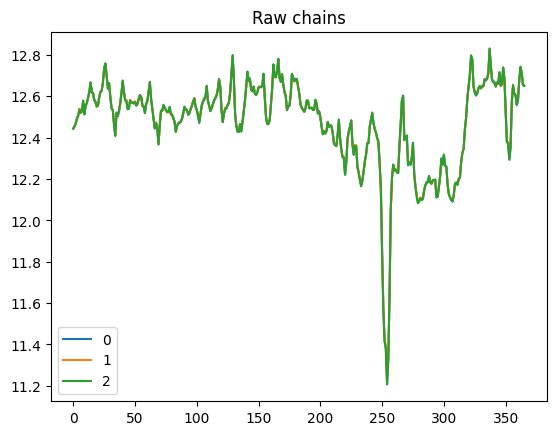

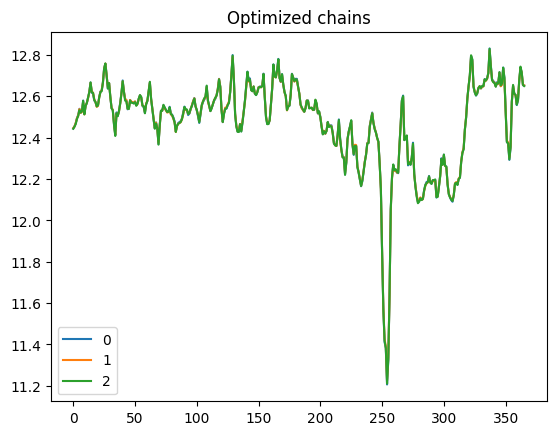

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.110  0.012   0.087    0.133      0.001      0.0     503.0    1165.0   
eps  0.148  0.010   0.130    0.167      0.000      0.0    1011.0    1882.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.110  0.012   0.089    0.134      0.001      0.0     467.0    1321.0   
eps  0.154  0.010   0.136    0.173      0.000      0.0    1206.0    1985.0   

     r_hat  
sig   1.01  
eps   1.00  


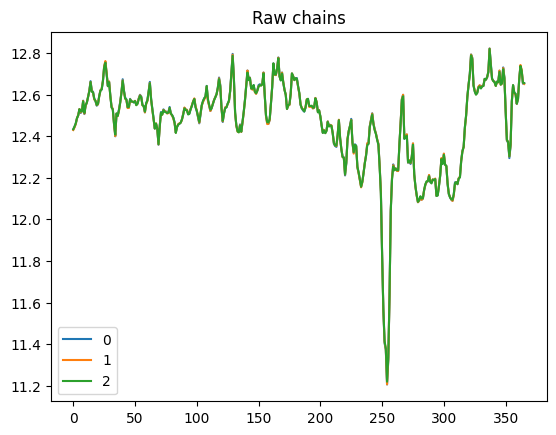

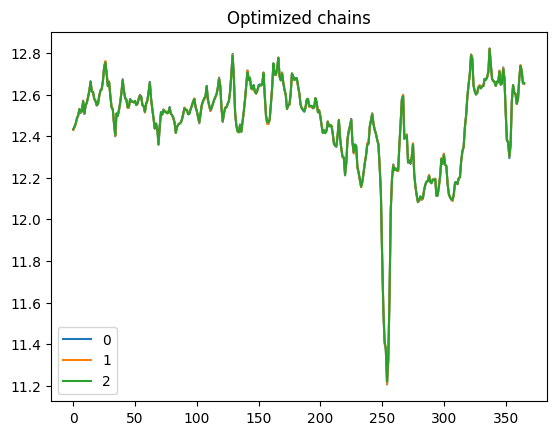

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.110  0.012   0.089    0.134      0.001      0.0     467.0    1321.0   
eps  0.154  0.010   0.136    0.173      0.000      0.0    1206.0    1985.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 15 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.093  0.009   0.077    0.110        0.0      0.0     810.0    1921.0   
eps  0.102  0.007   0.088    0.115        0.0      0.0    1207.0    2419.0   

     r_hat  
sig   1.01  
eps   1.00  


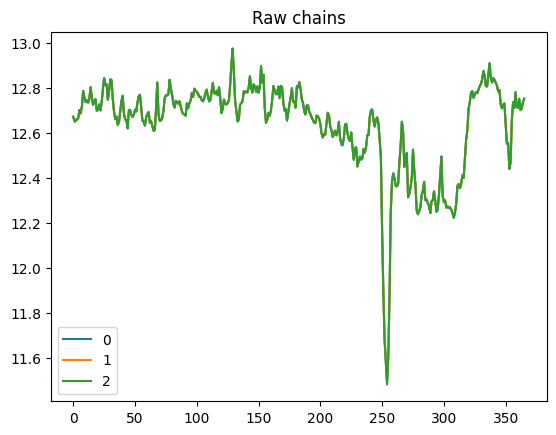

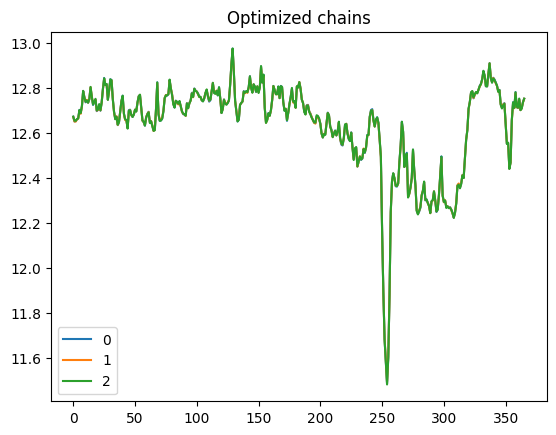

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.093  0.009   0.077    0.110        0.0      0.0     810.0    1921.0   
eps  0.102  0.007   0.088    0.115        0.0      0.0    1207.0    2419.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 17 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.103  0.010   0.084    0.123        0.0      0.0     806.0    1480.0   
eps  0.126  0.009   0.110    0.142        0.0      0.0    1240.0    2231.0   

     r_hat  
sig    1.0  
eps    1.0  


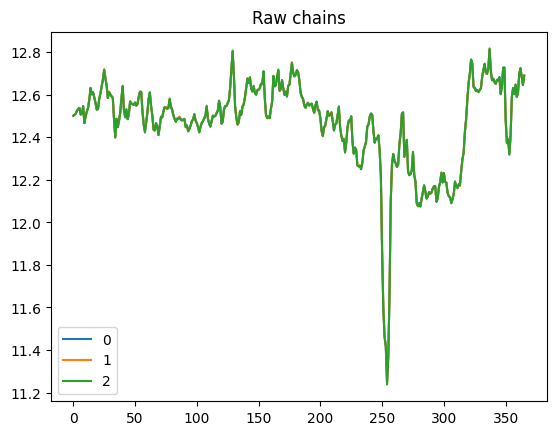

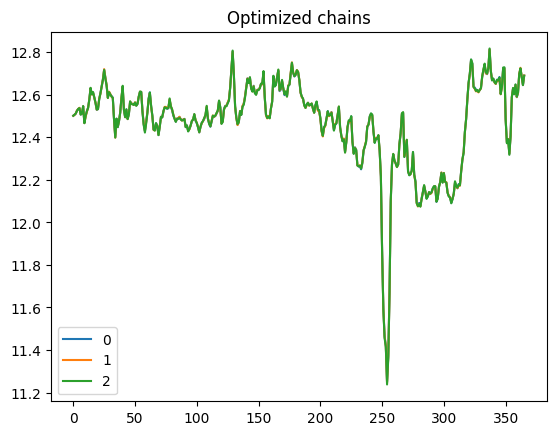

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.103  0.010   0.084    0.123        0.0      0.0     806.0    1480.0   
eps  0.126  0.009   0.110    0.142        0.0      0.0    1240.0    2231.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.108  0.012   0.087    0.131        0.0      0.0     591.0    1084.0   
eps  0.144  0.010   0.127    0.162        0.0      0.0    1276.0    1966.0   

     r_hat  
sig    1.0  
eps    1.0  


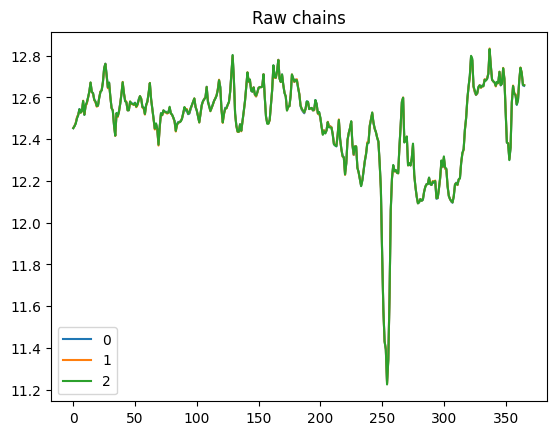

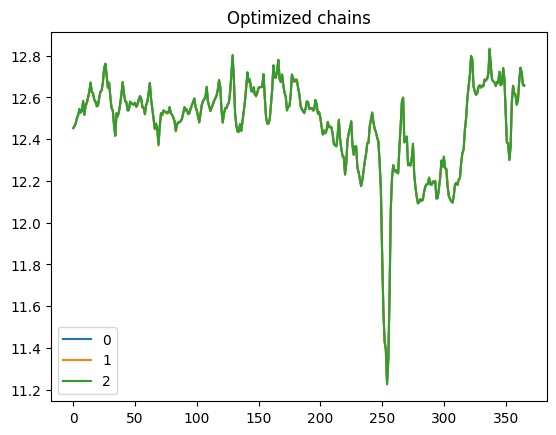

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.108  0.012   0.087    0.131        0.0      0.0     591.0    1084.0   
eps  0.144  0.010   0.127    0.162        0.0      0.0    1276.0    1966.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.079    0.112        0.0      0.0     833.0    1475.0   
eps  0.099  0.007   0.085    0.113        0.0      0.0    1124.0    2233.0   

     r_hat  
sig    1.0  
eps    1.0  


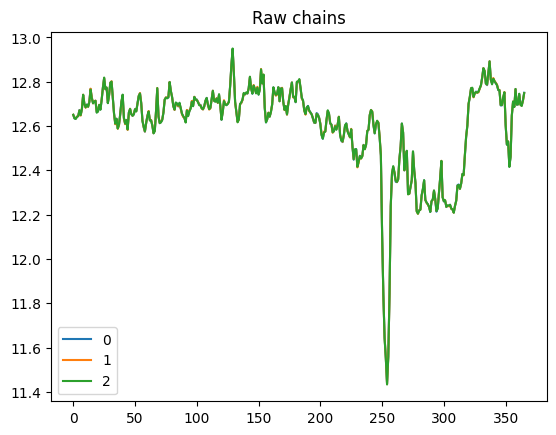

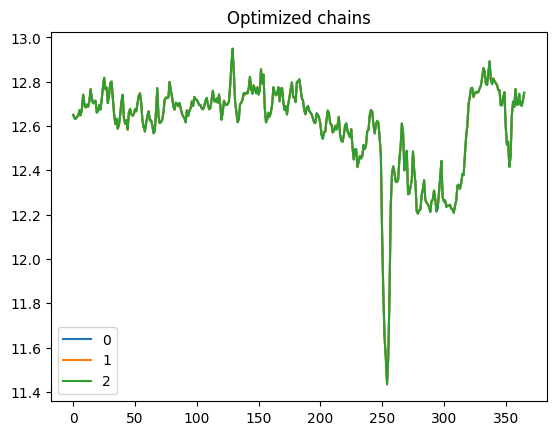

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.079    0.112        0.0      0.0     833.0    1475.0   
eps  0.099  0.007   0.085    0.113        0.0      0.0    1124.0    2233.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.010   0.078    0.117        0.0      0.0     716.0    1607.0   
eps  0.124  0.008   0.108    0.140        0.0      0.0    1232.0    2049.0   

     r_hat  
sig    1.0  
eps    1.0  


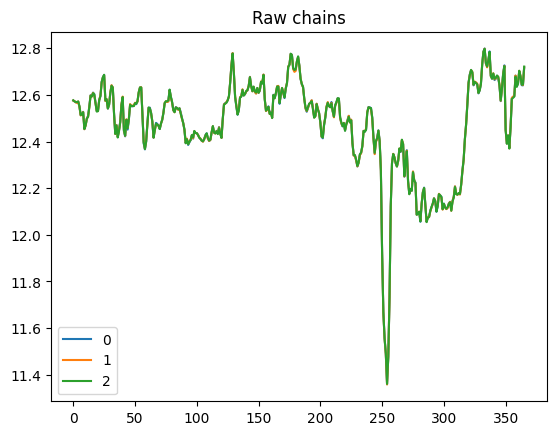

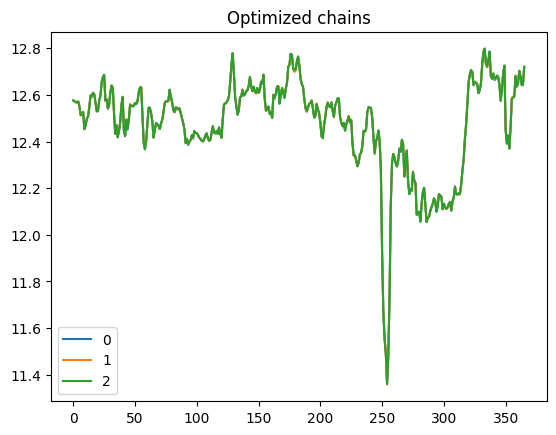

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.010   0.078    0.117        0.0      0.0     716.0    1607.0   
eps  0.124  0.008   0.108    0.140        0.0      0.0    1232.0    2049.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 12 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.092  0.007   0.078    0.106        0.0      0.0    1443.0    2369.0   
eps  0.082  0.006   0.070    0.095        0.0      0.0    1391.0    2315.0   

     r_hat  
sig    1.0  
eps    1.0  


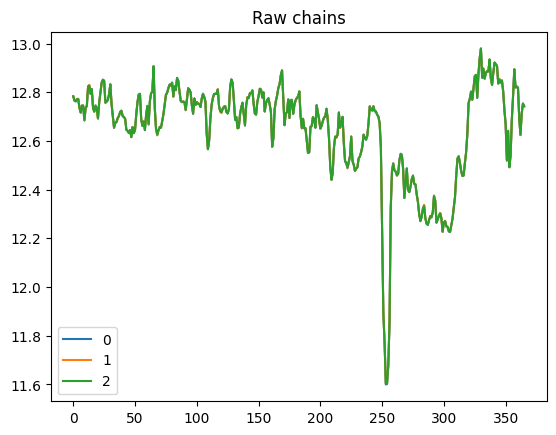

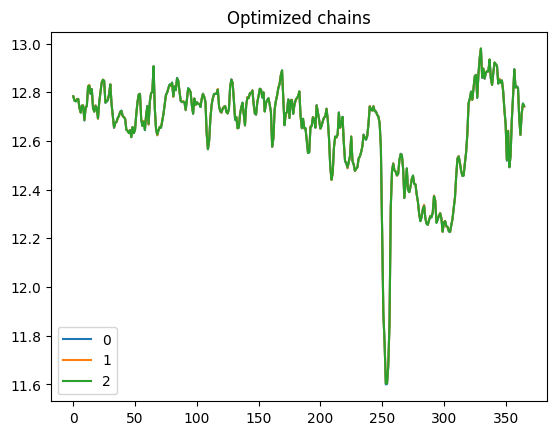

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.092  0.007   0.078    0.106        0.0      0.0    1443.0    2369.0   
eps  0.082  0.006   0.070    0.095        0.0      0.0    1391.0    2315.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 17 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.010   0.083    0.121        0.0      0.0     641.0    1368.0   
eps  0.127  0.008   0.112    0.143        0.0      0.0    1360.0    1833.0   

     r_hat  
sig    1.0  
eps    1.0  


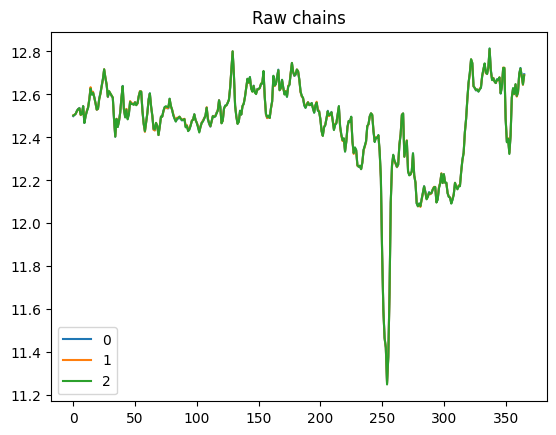

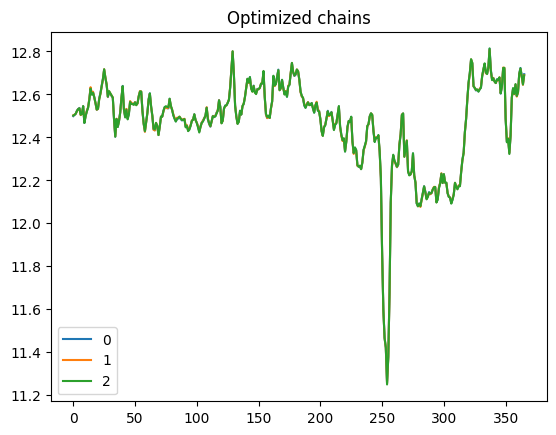

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.010   0.083    0.121        0.0      0.0     641.0    1368.0   
eps  0.127  0.008   0.112    0.143        0.0      0.0    1360.0    1833.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.097  0.011   0.078    0.118        0.0      0.0     636.0    1274.0   
eps  0.128  0.009   0.112    0.144        0.0      0.0    1266.0    2538.0   

     r_hat  
sig    1.0  
eps    1.0  


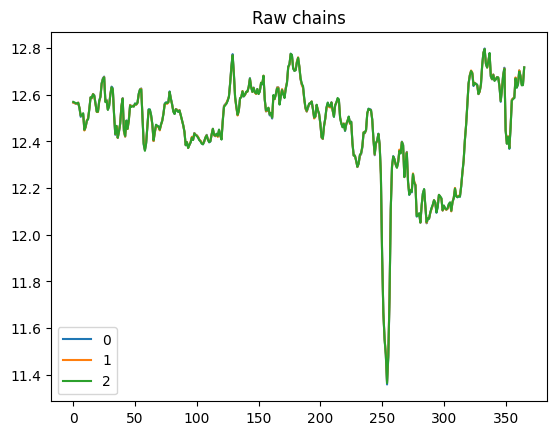

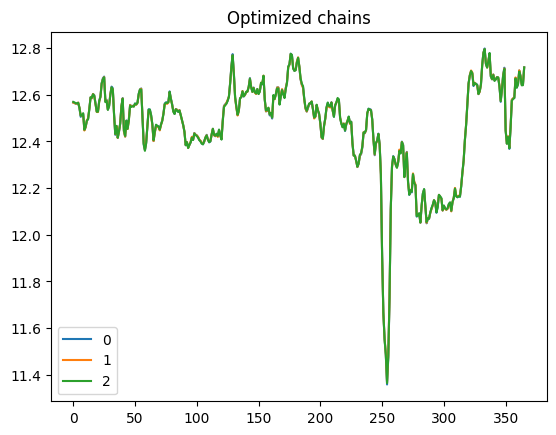

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.097  0.011   0.078    0.118        0.0      0.0     636.0    1274.0   
eps  0.128  0.009   0.112    0.144        0.0      0.0    1266.0    2538.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 15 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.080    0.114        0.0      0.0     875.0    1554.0   
eps  0.101  0.007   0.088    0.115        0.0      0.0    1420.0    2371.0   

     r_hat  
sig    1.0  
eps    1.0  


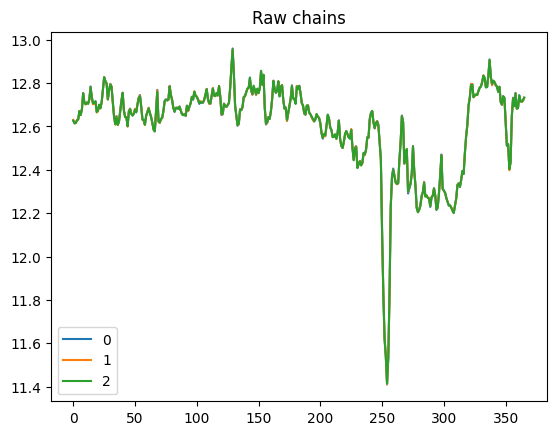

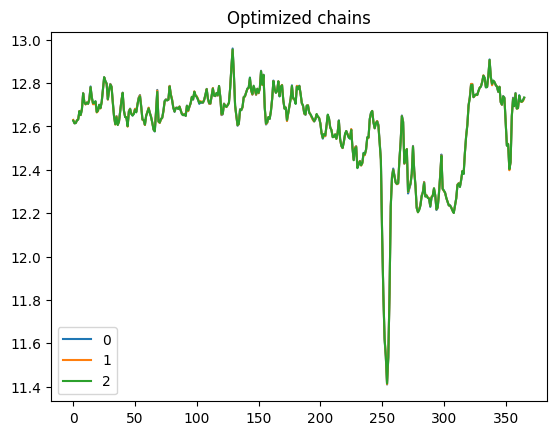

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.080    0.114        0.0      0.0     875.0    1554.0   
eps  0.101  0.007   0.088    0.115        0.0      0.0    1420.0    2371.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 18 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.011   0.084    0.124        0.0      0.0     527.0    1643.0   
eps  0.127  0.009   0.110    0.143        0.0      0.0     990.0    2469.0   

     r_hat  
sig   1.01  
eps   1.01  


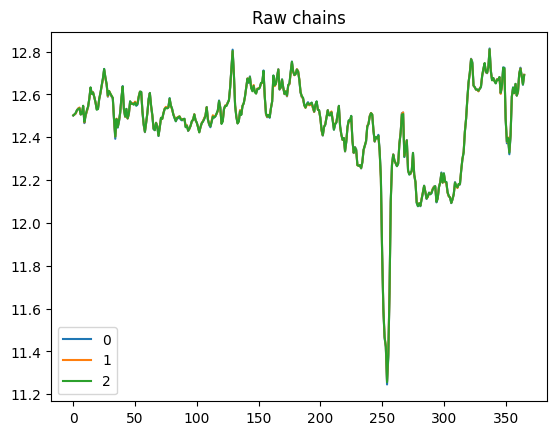

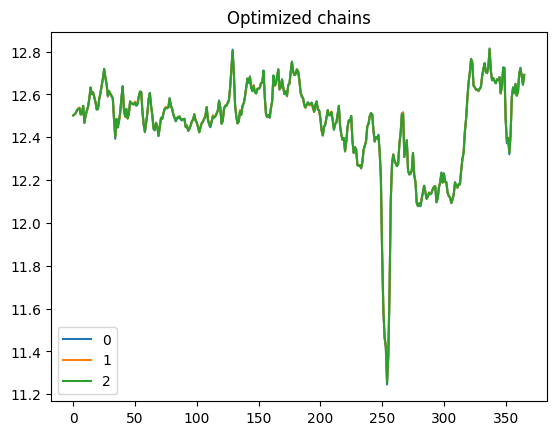

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.011   0.084    0.124        0.0      0.0     527.0    1643.0   
eps  0.127  0.009   0.110    0.143        0.0      0.0     990.0    2469.0   

     r_hat  
sig   1.01  
eps   1.01  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.110  0.012   0.087    0.131        0.0      0.0     650.0    1100.0   
eps  0.149  0.010   0.130    0.166        0.0      0.0    1449.0    2037.0   

     r_hat  
sig   1.01  
eps   1.01  


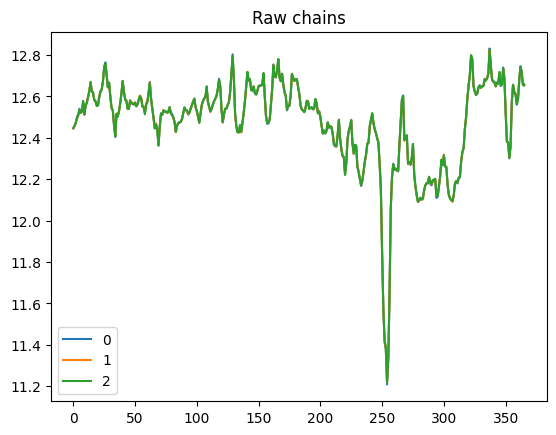

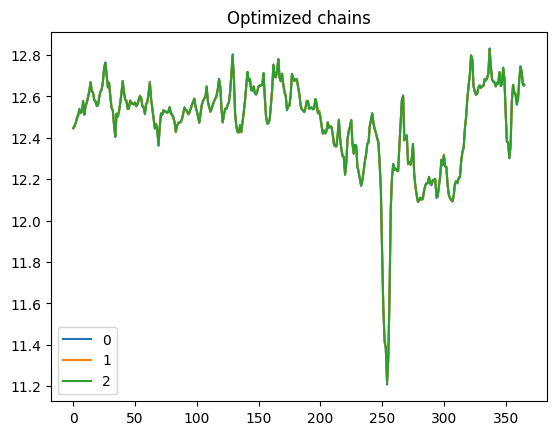

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.110  0.012   0.087    0.131        0.0      0.0     650.0    1100.0   
eps  0.149  0.010   0.130    0.166        0.0      0.0    1449.0    2037.0   

     r_hat  
sig   1.01  
eps   1.01  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.111        0.0      0.0     921.0    1869.0   
eps  0.100  0.007   0.087    0.115        0.0      0.0    1463.0    2420.0   

     r_hat  
sig    1.0  
eps    1.0  


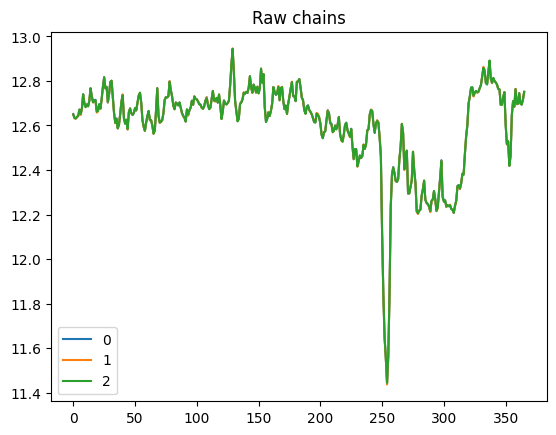

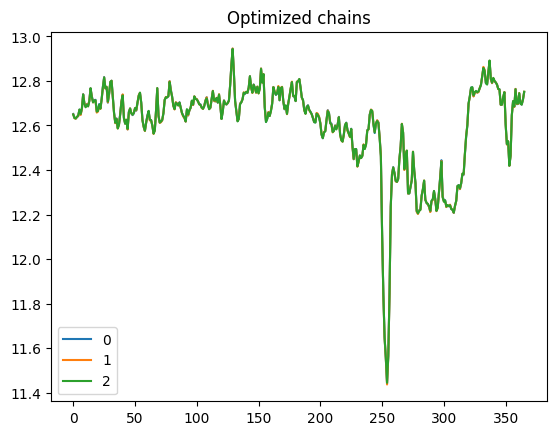

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.111        0.0      0.0     921.0    1869.0   
eps  0.100  0.007   0.087    0.115        0.0      0.0    1463.0    2420.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.097  0.009   0.080    0.112        0.0      0.0     899.0    1499.0   
eps  0.101  0.007   0.086    0.114        0.0      0.0    1522.0    2340.0   

     r_hat  
sig    1.0  
eps    1.0  


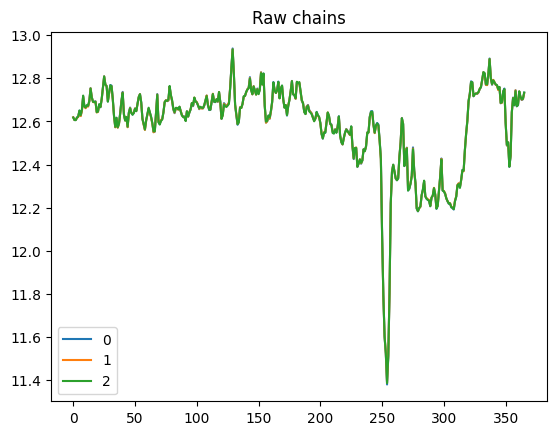

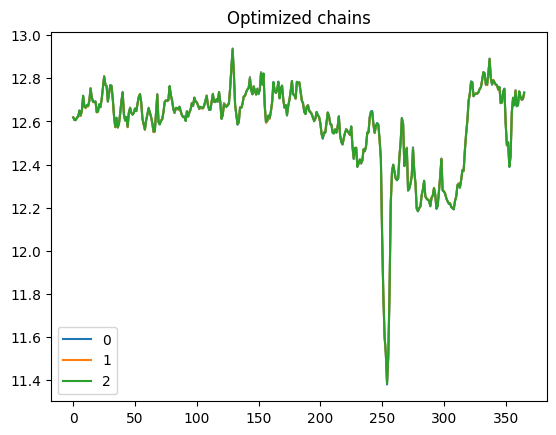

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.097  0.009   0.080    0.112        0.0      0.0     899.0    1499.0   
eps  0.101  0.007   0.086    0.114        0.0      0.0    1522.0    2340.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.110  0.011   0.090    0.133        0.0      0.0     757.0    1366.0   
eps  0.149  0.010   0.129    0.166        0.0      0.0    1456.0    2264.0   

     r_hat  
sig    1.0  
eps    1.0  


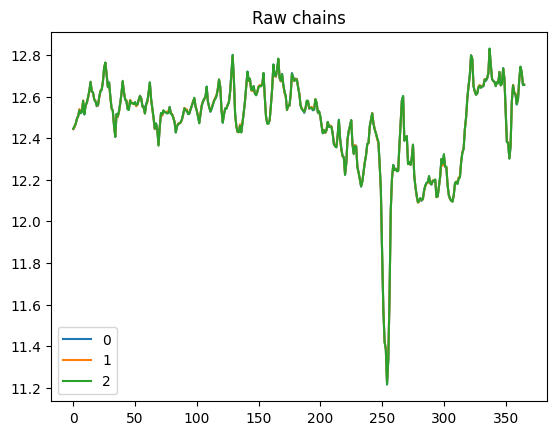

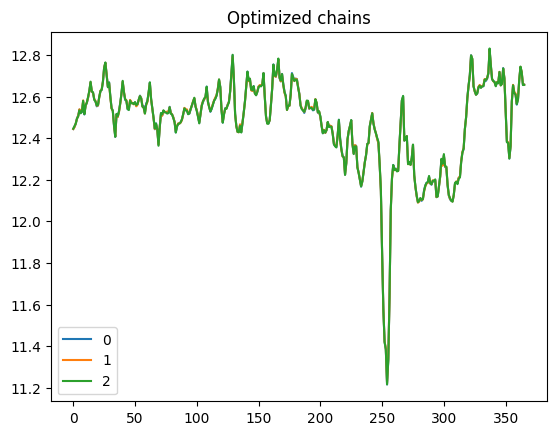

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.110  0.011   0.090    0.133        0.0      0.0     757.0    1366.0   
eps  0.149  0.010   0.129    0.166        0.0      0.0    1456.0    2264.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 15 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.112        0.0      0.0     842.0    1912.0   
eps  0.102  0.007   0.088    0.115        0.0      0.0    1437.0    2848.0   

     r_hat  
sig   1.01  
eps   1.00  


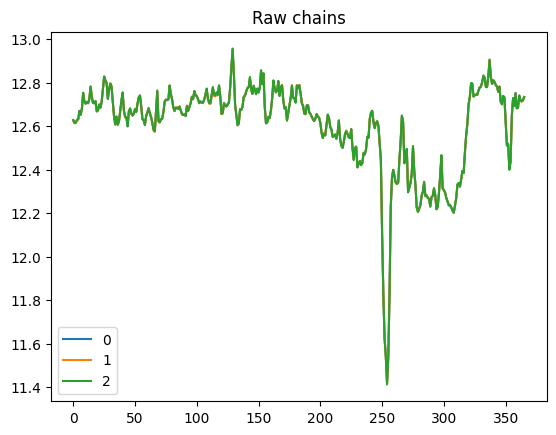

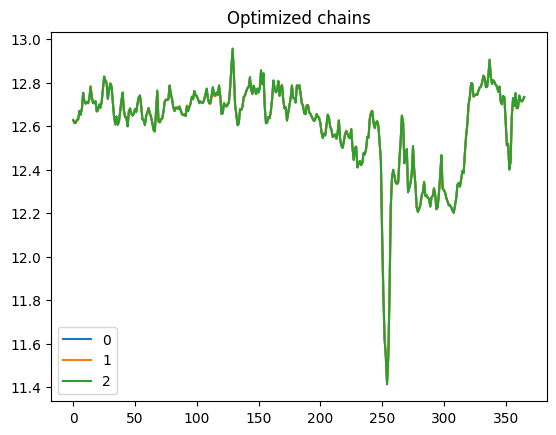

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.112        0.0      0.0     842.0    1912.0   
eps  0.102  0.007   0.088    0.115        0.0      0.0    1437.0    2848.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 12 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.090  0.006   0.079    0.100        0.0      0.0    2535.0    3534.0   
eps  0.055  0.005   0.045    0.064        0.0      0.0    1109.0    1790.0   

     r_hat  
sig    1.0  
eps    1.0  


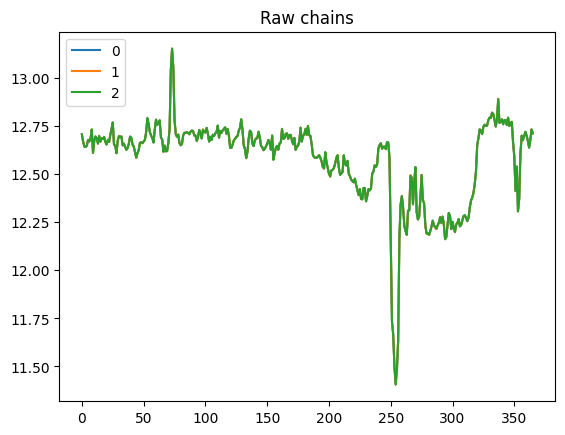

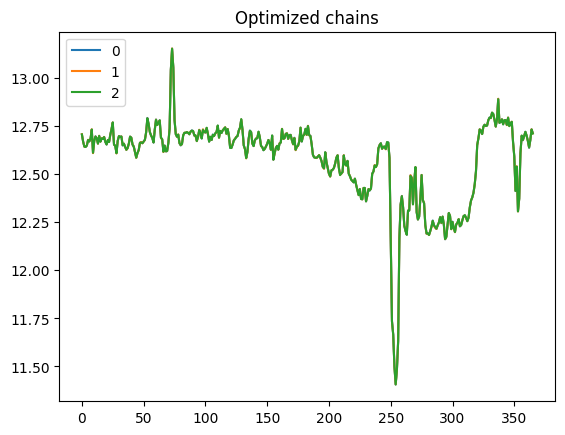

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.090  0.006   0.079    0.100        0.0      0.0    2535.0    3534.0   
eps  0.055  0.005   0.045    0.064        0.0      0.0    1109.0    1790.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 14 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.080    0.113        0.0      0.0     883.0    1507.0   
eps  0.100  0.007   0.086    0.113        0.0      0.0    1136.0    2616.0   

     r_hat  
sig    1.0  
eps    1.0  


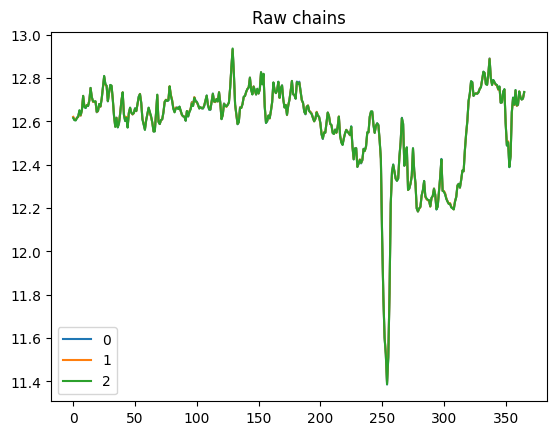

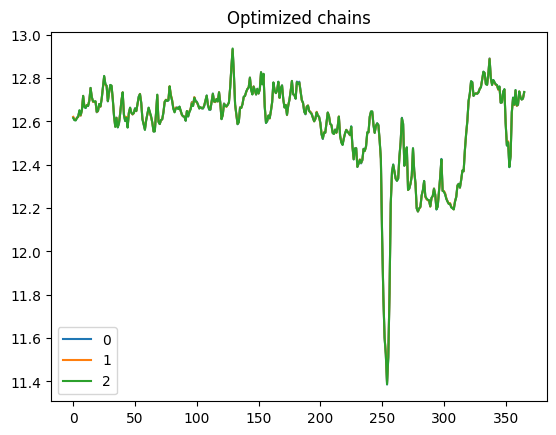

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.080    0.113        0.0      0.0     883.0    1507.0   
eps  0.100  0.007   0.086    0.113        0.0      0.0    1136.0    2616.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 14 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.080    0.111        0.0      0.0    1028.0    1676.0   
eps  0.099  0.007   0.086    0.113        0.0      0.0    1400.0    1934.0   

     r_hat  
sig    1.0  
eps    1.0  


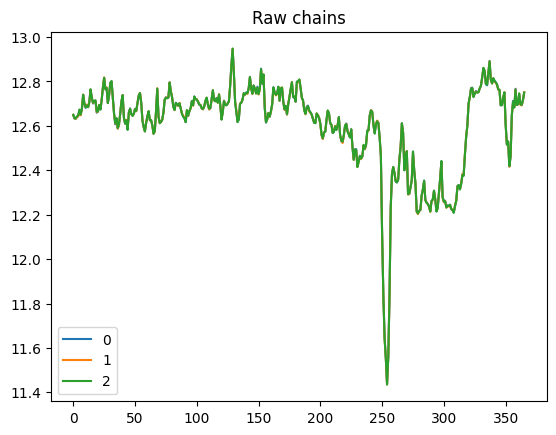

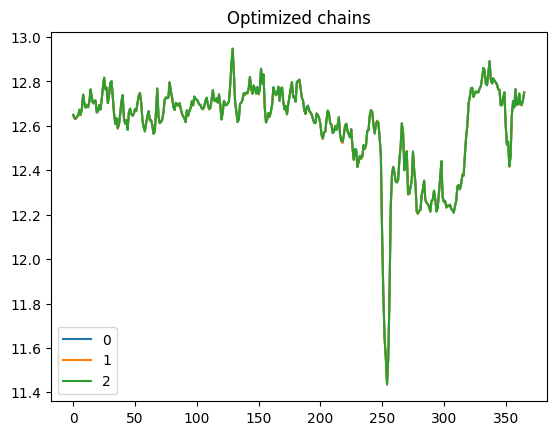

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.080    0.111        0.0      0.0    1028.0    1676.0   
eps  0.099  0.007   0.086    0.113        0.0      0.0    1400.0    1934.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 10 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.084  0.005   0.073    0.094        0.0      0.0    2291.0    3759.0   
eps  0.056  0.005   0.046    0.065        0.0      0.0    1170.0    1893.0   

     r_hat  
sig    1.0  
eps    1.0  


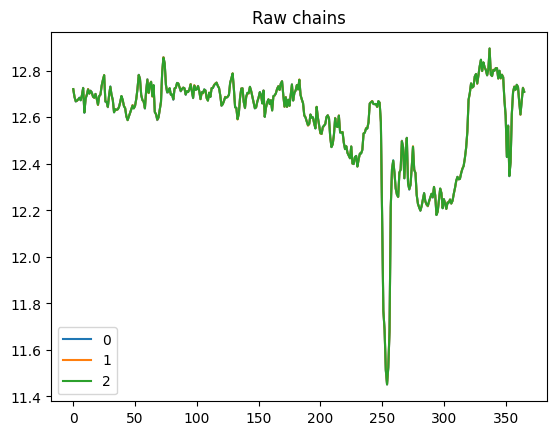

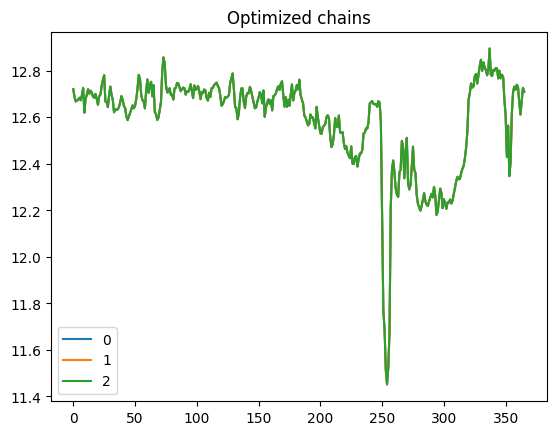

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.084  0.005   0.073    0.094        0.0      0.0    2291.0    3759.0   
eps  0.056  0.005   0.046    0.065        0.0      0.0    1170.0    1893.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 20 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.097  0.011   0.077    0.117        0.0      0.0     620.0    1323.0   
eps  0.133  0.009   0.117    0.150        0.0      0.0    1378.0    2173.0   

     r_hat  
sig   1.01  
eps   1.00  


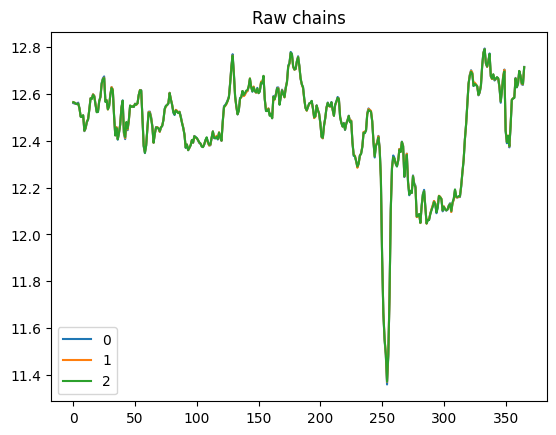

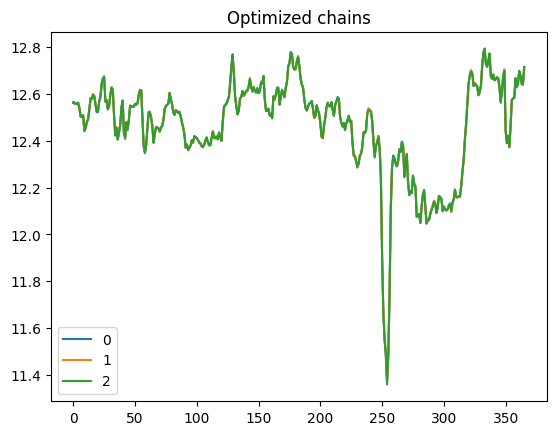

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.097  0.011   0.077    0.117        0.0      0.0     620.0    1323.0   
eps  0.133  0.009   0.117    0.150        0.0      0.0    1378.0    2173.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 18 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.108  0.011   0.088    0.129        0.0      0.0     767.0    1556.0   
eps  0.138  0.009   0.121    0.156        0.0      0.0    1472.0    2203.0   

     r_hat  
sig   1.01  
eps   1.00  


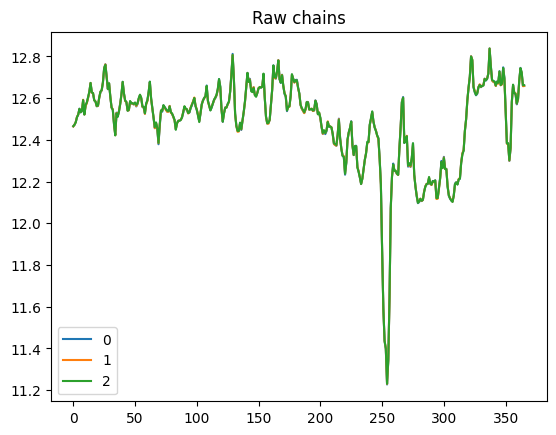

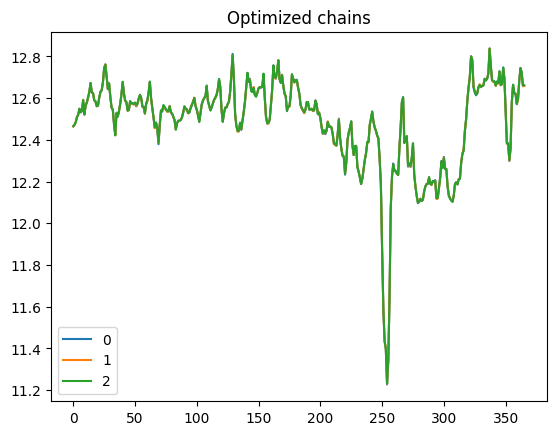

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.108  0.011   0.088    0.129        0.0      0.0     767.0    1556.0   
eps  0.138  0.009   0.121    0.156        0.0      0.0    1472.0    2203.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.079    0.111        0.0      0.0     965.0    1635.0   
eps  0.100  0.007   0.086    0.113        0.0      0.0    1336.0    2562.0   

     r_hat  
sig    1.0  
eps    1.0  


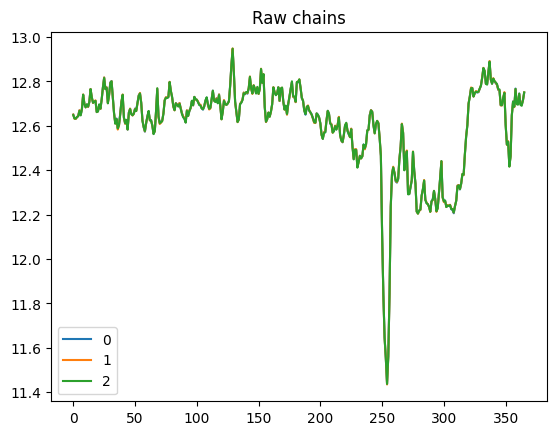

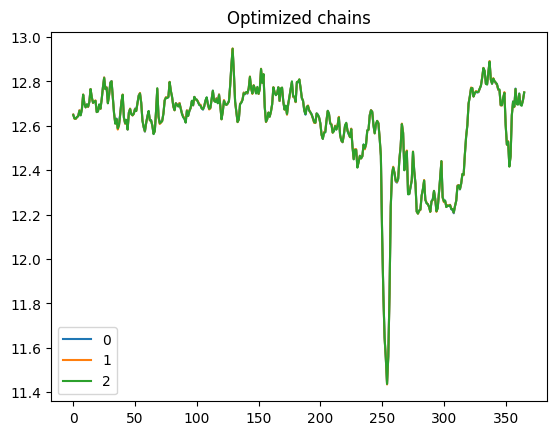

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.079    0.111        0.0      0.0     965.0    1635.0   
eps  0.100  0.007   0.086    0.113        0.0      0.0    1336.0    2562.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 19 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.011   0.083    0.123        0.0      0.0     703.0    1636.0   
eps  0.129  0.009   0.112    0.145        0.0      0.0    1402.0    2673.0   

     r_hat  
sig    1.0  
eps    1.0  


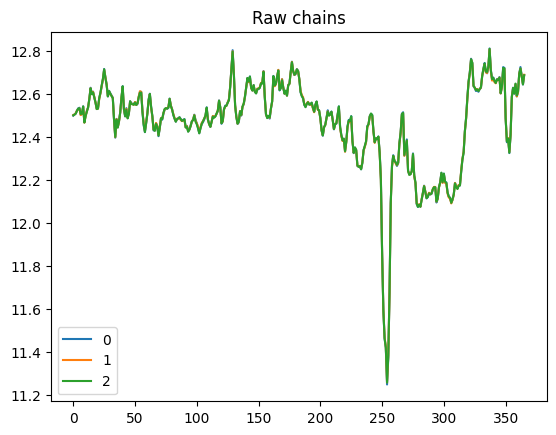

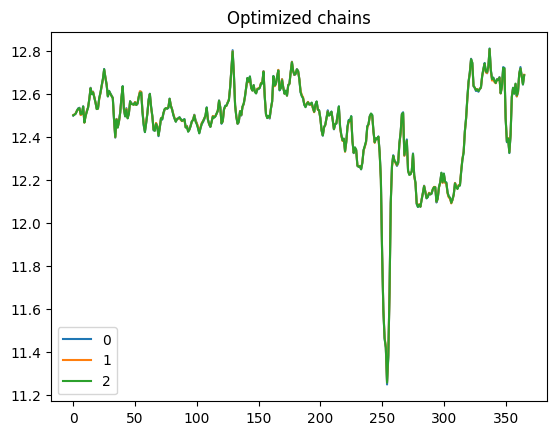

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.011   0.083    0.123        0.0      0.0     703.0    1636.0   
eps  0.129  0.009   0.112    0.145        0.0      0.0    1402.0    2673.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.080    0.113        0.0      0.0     910.0    1545.0   
eps  0.102  0.007   0.088    0.116        0.0      0.0    1255.0    2210.0   

     r_hat  
sig    1.0  
eps    1.0  


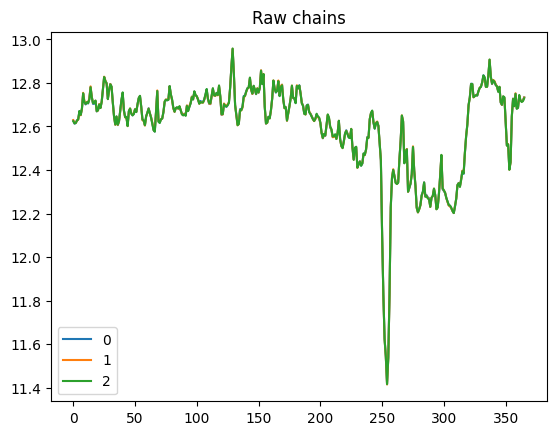

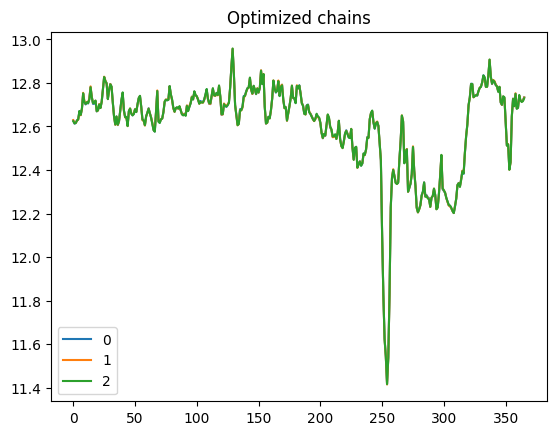

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.080    0.113        0.0      0.0     910.0    1545.0   
eps  0.102  0.007   0.088    0.116        0.0      0.0    1255.0    2210.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 14 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.110        0.0      0.0     774.0    1712.0   
eps  0.101  0.007   0.087    0.114        0.0      0.0    1182.0    1989.0   

     r_hat  
sig    1.0  
eps    1.0  


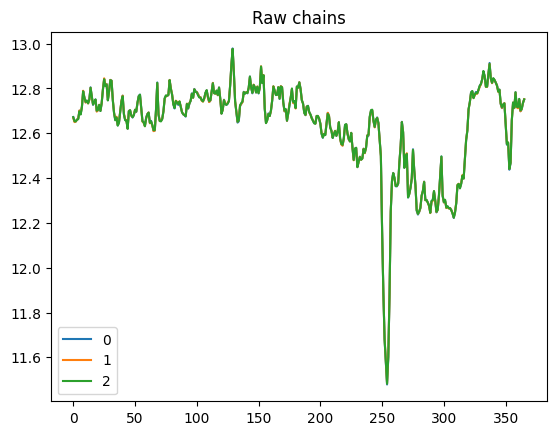

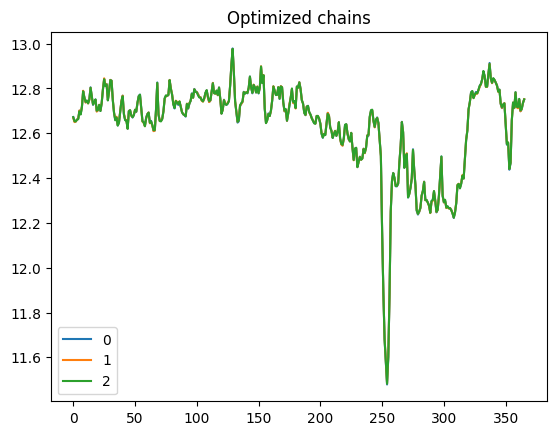

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.110        0.0      0.0     774.0    1712.0   
eps  0.101  0.007   0.087    0.114        0.0      0.0    1182.0    1989.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.011   0.078    0.118        0.0      0.0     656.0    1552.0   
eps  0.134  0.009   0.118    0.151        0.0      0.0    1411.0    2238.0   

     r_hat  
sig    1.0  
eps    1.0  


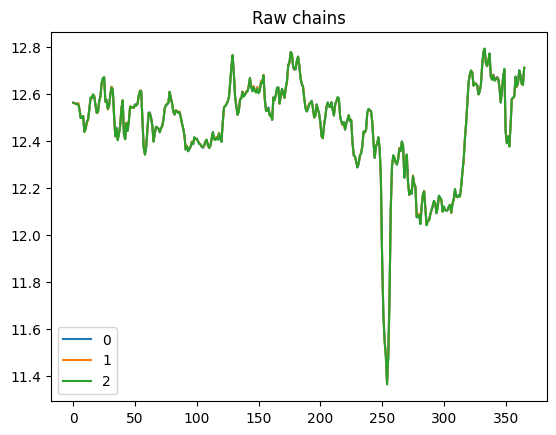

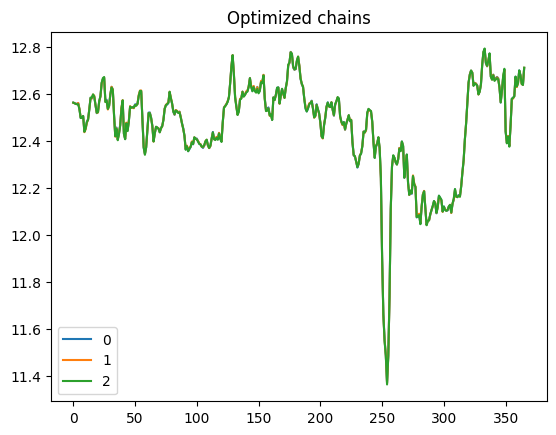

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.011   0.078    0.118        0.0      0.0     656.0    1552.0   
eps  0.134  0.009   0.118    0.151        0.0      0.0    1411.0    2238.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.099  0.011   0.079    0.120        0.0      0.0     634.0    1222.0   
eps  0.134  0.009   0.118    0.151        0.0      0.0    1276.0    1798.0   

     r_hat  
sig    1.0  
eps    1.0  


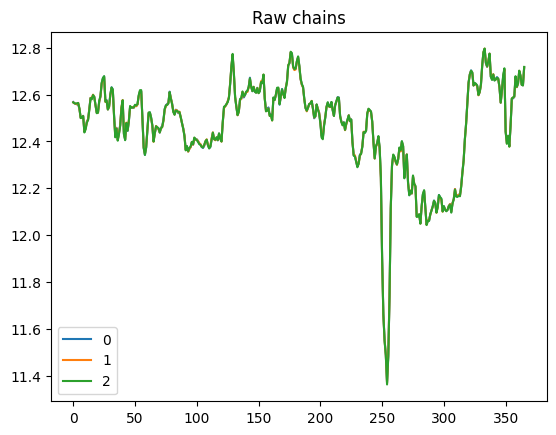

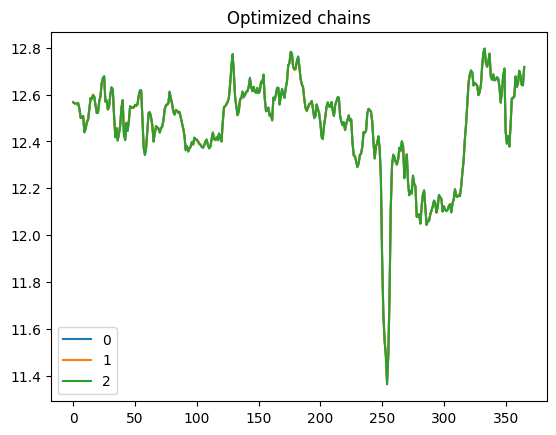

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.099  0.011   0.079    0.120        0.0      0.0     634.0    1222.0   
eps  0.134  0.009   0.118    0.151        0.0      0.0    1276.0    1798.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 14 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.081    0.113        0.0      0.0     928.0    1831.0   
eps  0.100  0.007   0.086    0.114        0.0      0.0    1334.0    2049.0   

     r_hat  
sig    1.0  
eps    1.0  


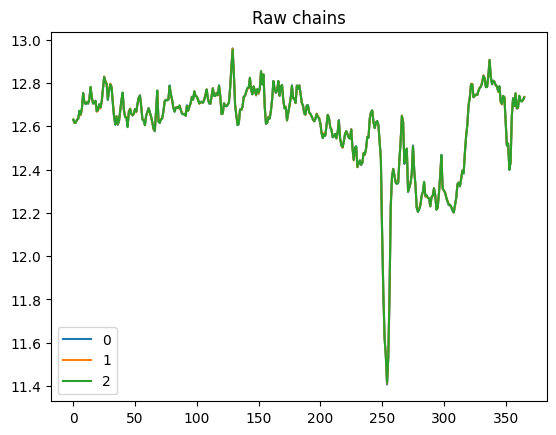

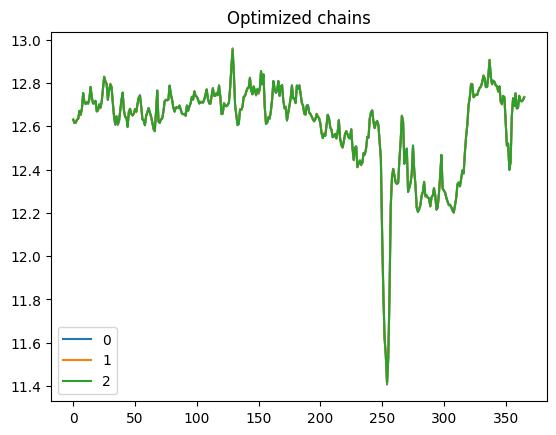

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.081    0.113        0.0      0.0     928.0    1831.0   
eps  0.100  0.007   0.086    0.114        0.0      0.0    1334.0    2049.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 19 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.103  0.011   0.082    0.123        0.0      0.0     527.0    1480.0   
eps  0.129  0.009   0.113    0.146        0.0      0.0    1110.0    1969.0   

     r_hat  
sig   1.01  
eps   1.00  


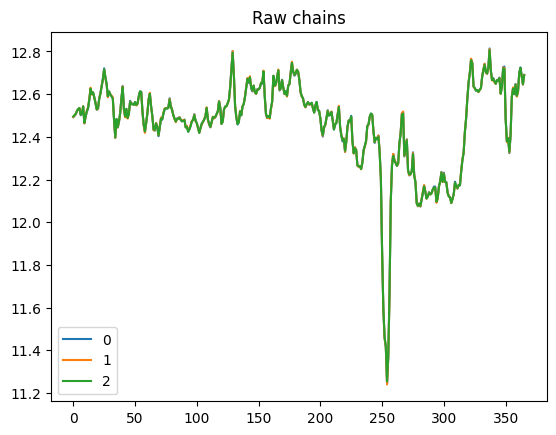

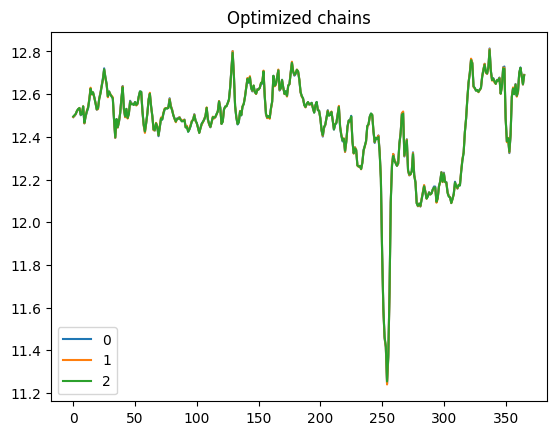

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.103  0.011   0.082    0.123        0.0      0.0     527.0    1480.0   
eps  0.129  0.009   0.113    0.146        0.0      0.0    1110.0    1969.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 12 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.079    0.111        0.0      0.0     866.0    1599.0   
eps  0.099  0.007   0.086    0.114        0.0      0.0    1300.0    2270.0   

     r_hat  
sig    1.0  
eps    1.0  


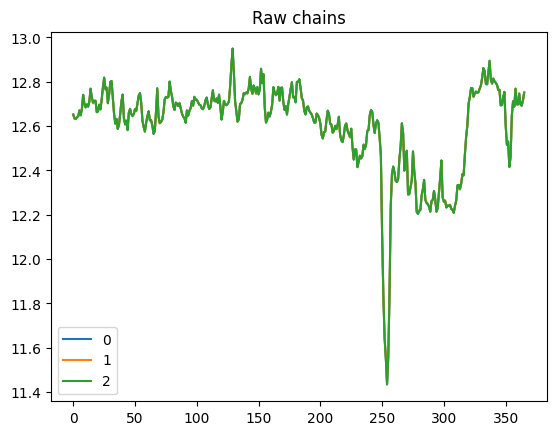

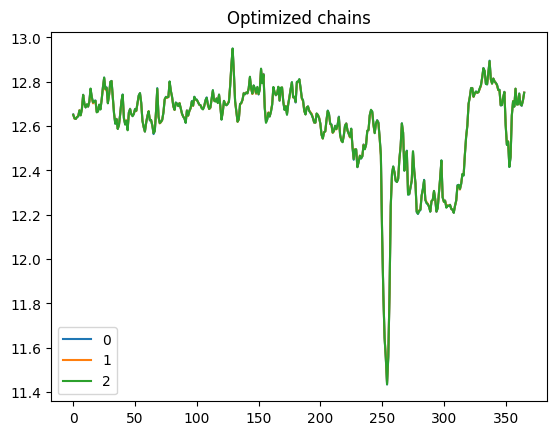

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.079    0.111        0.0      0.0     866.0    1599.0   
eps  0.099  0.007   0.086    0.114        0.0      0.0    1300.0    2270.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 14 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.110        0.0      0.0     807.0    1695.0   
eps  0.101  0.007   0.087    0.115        0.0      0.0    1273.0    2183.0   

     r_hat  
sig    1.0  
eps    1.0  


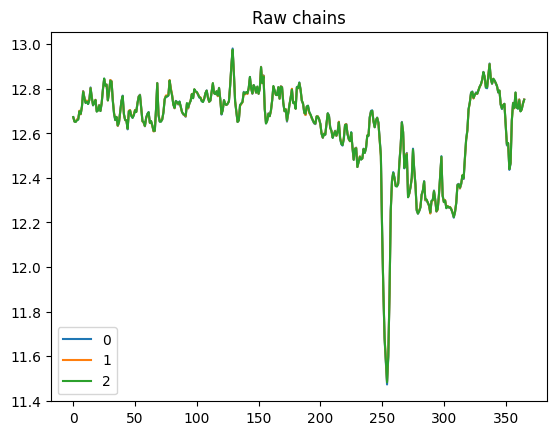

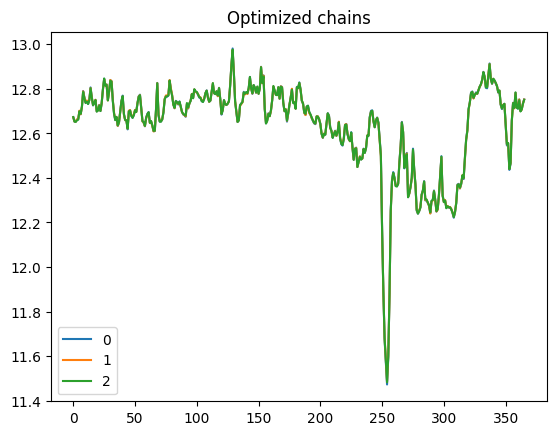

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.110        0.0      0.0     807.0    1695.0   
eps  0.101  0.007   0.087    0.115        0.0      0.0    1273.0    2183.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.011   0.078    0.118        0.0      0.0     558.0    1167.0   
eps  0.133  0.009   0.116    0.150        0.0      0.0    1119.0    1771.0   

     r_hat  
sig   1.01  
eps   1.00  


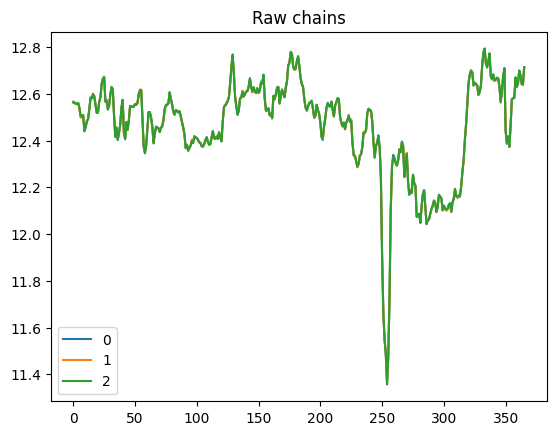

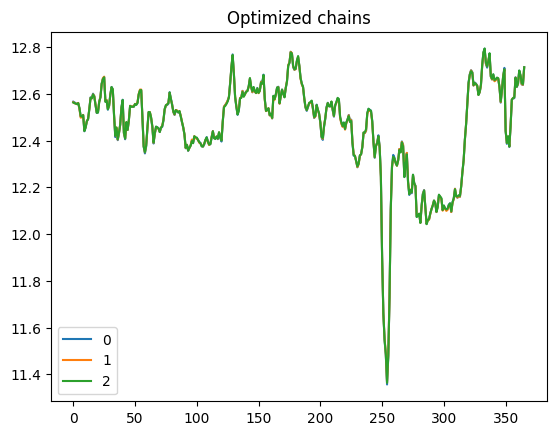

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.011   0.078    0.118        0.0      0.0     558.0    1167.0   
eps  0.133  0.009   0.116    0.150        0.0      0.0    1119.0    1771.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 15 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.113        0.0      0.0    1052.0    2085.0   
eps  0.101  0.007   0.087    0.115        0.0      0.0    1472.0    2287.0   

     r_hat  
sig    1.0  
eps    1.0  


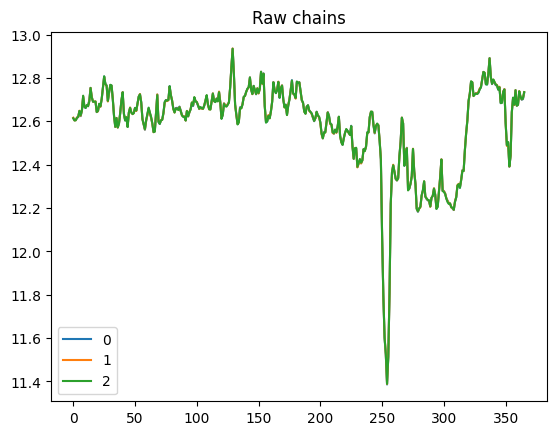

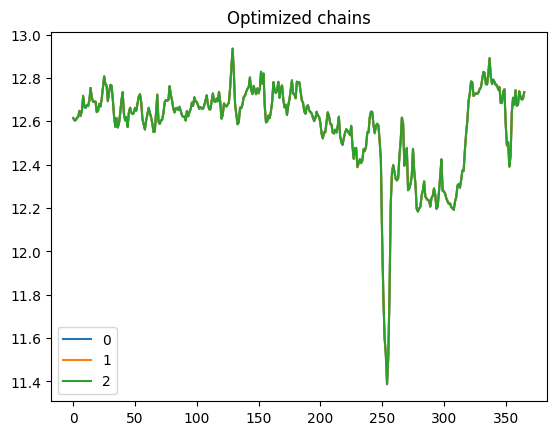

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.113        0.0      0.0    1052.0    2085.0   
eps  0.101  0.007   0.087    0.115        0.0      0.0    1472.0    2287.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 20 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.011   0.083    0.123        0.0      0.0     647.0    1271.0   
eps  0.127  0.009   0.111    0.144        0.0      0.0    1240.0    1959.0   

     r_hat  
sig    1.0  
eps    1.0  


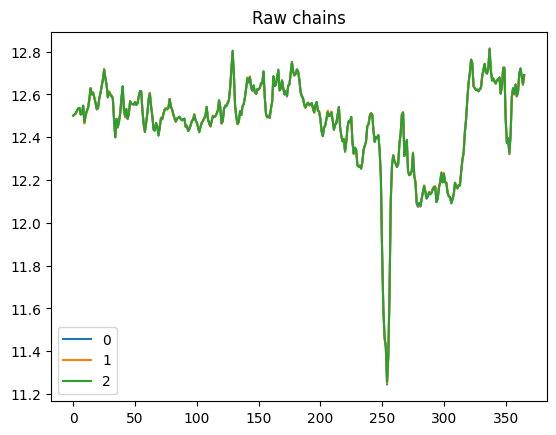

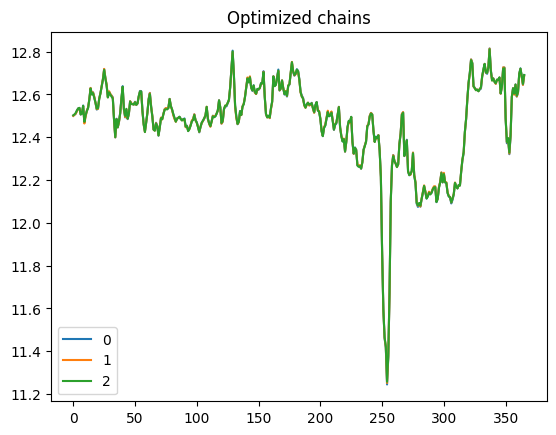

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.011   0.083    0.123        0.0      0.0     647.0    1271.0   
eps  0.127  0.009   0.111    0.144        0.0      0.0    1240.0    1959.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 16 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.077    0.111        0.0      0.0     726.0    1370.0   
eps  0.101  0.008   0.087    0.115        0.0      0.0    1085.0    2177.0   

     r_hat  
sig   1.01  
eps   1.00  


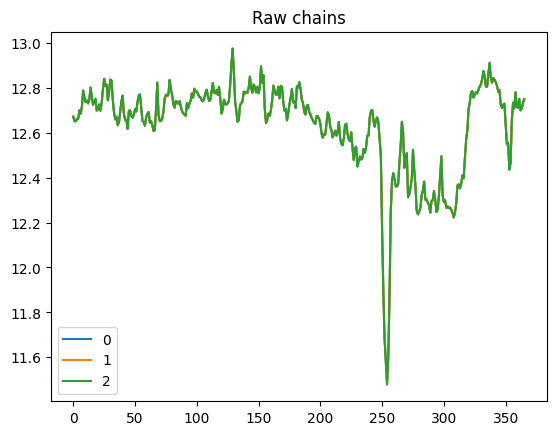

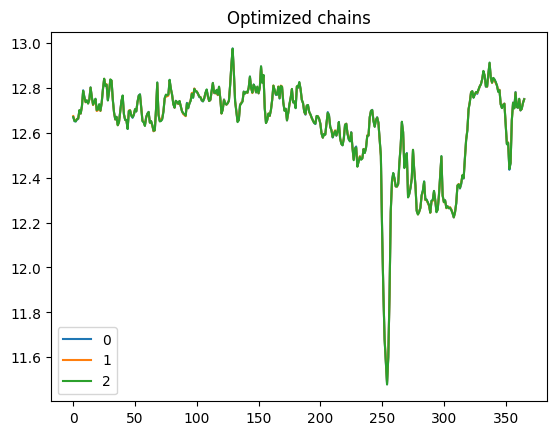

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.077    0.111        0.0      0.0     726.0    1370.0   
eps  0.101  0.008   0.087    0.115        0.0      0.0    1085.0    2177.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.078    0.111        0.0      0.0     816.0    1369.0   
eps  0.099  0.007   0.085    0.113        0.0      0.0    1099.0    1821.0   

     r_hat  
sig    1.0  
eps    1.0  


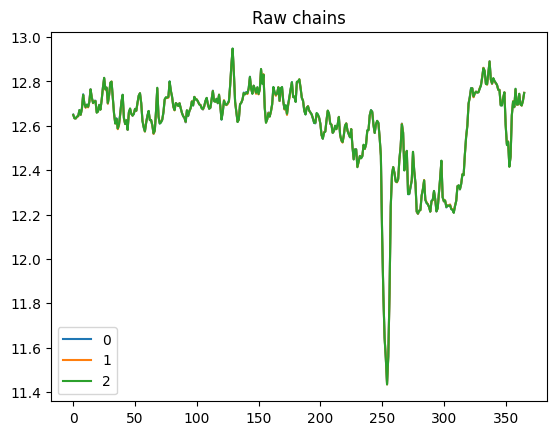

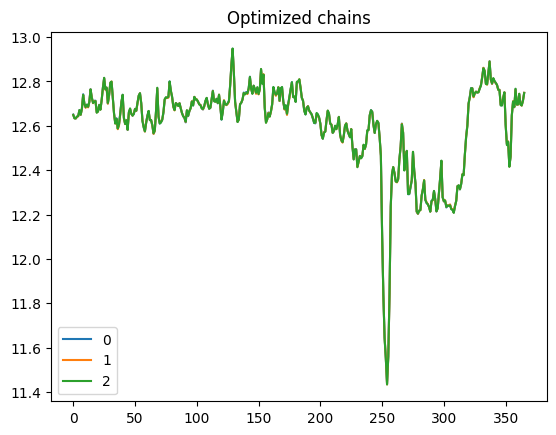

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.078    0.111        0.0      0.0     816.0    1369.0   
eps  0.099  0.007   0.085    0.113        0.0      0.0    1099.0    1821.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 14 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.112        0.0      0.0     847.0    1439.0   
eps  0.102  0.007   0.088    0.116        0.0      0.0    1310.0    2607.0   

     r_hat  
sig    1.0  
eps    1.0  


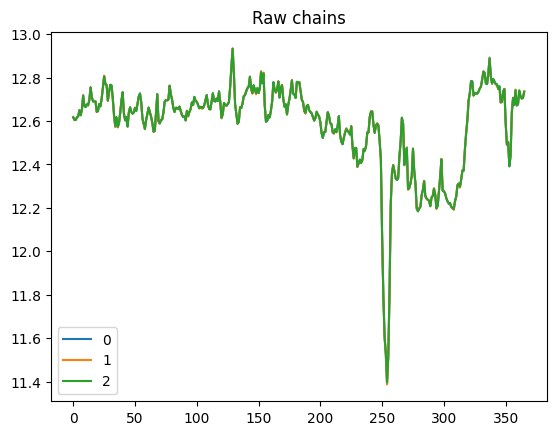

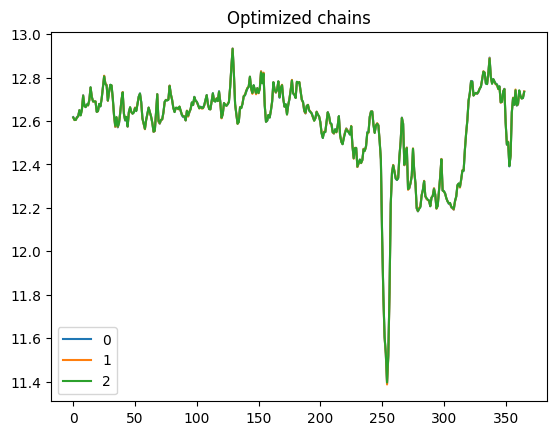

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.112        0.0      0.0     847.0    1439.0   
eps  0.102  0.007   0.088    0.116        0.0      0.0    1310.0    2607.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 19 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.011   0.079    0.118        0.0      0.0     677.0    1373.0   
eps  0.128  0.009   0.112    0.144        0.0      0.0    1213.0    1519.0   

     r_hat  
sig    1.0  
eps    1.0  


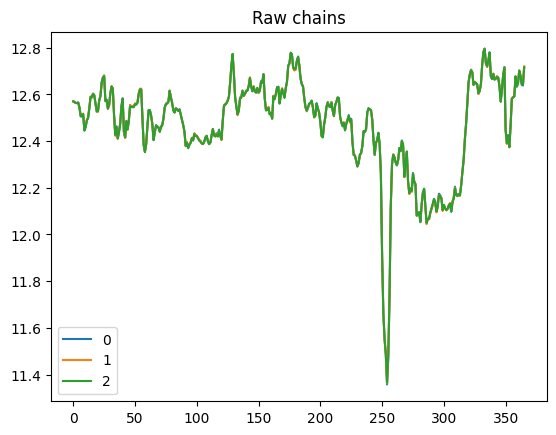

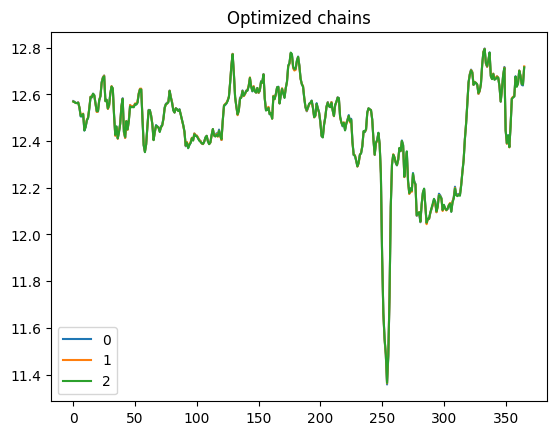

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.011   0.079    0.118        0.0      0.0     677.0    1373.0   
eps  0.128  0.009   0.112    0.144        0.0      0.0    1213.0    1519.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 15 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.079    0.112        0.0      0.0     918.0    1785.0   
eps  0.100  0.007   0.086    0.114        0.0      0.0    1254.0    1999.0   

     r_hat  
sig    1.0  
eps    1.0  


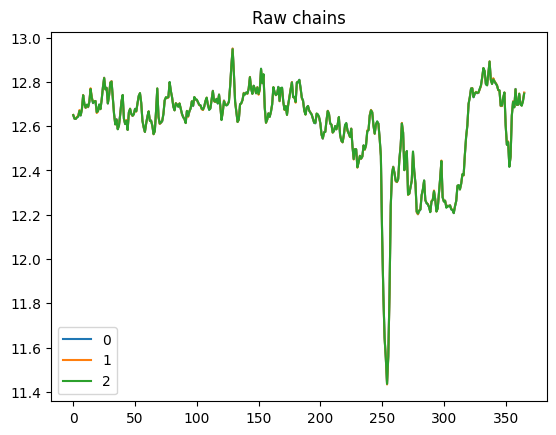

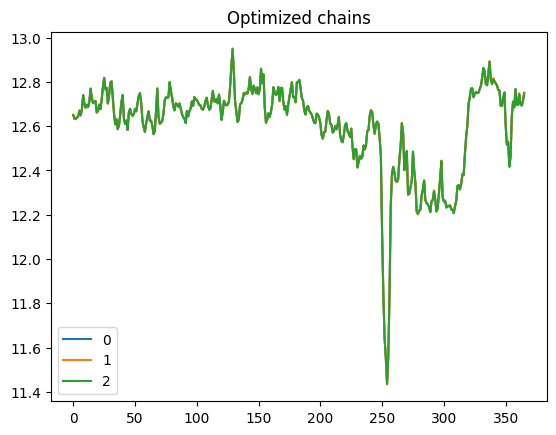

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.079    0.112        0.0      0.0     918.0    1785.0   
eps  0.100  0.007   0.086    0.114        0.0      0.0    1254.0    1999.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 11 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.083  0.006   0.073    0.094        0.0      0.0    1775.0    3413.0   
eps  0.059  0.005   0.049    0.068        0.0      0.0    1189.0    1941.0   

     r_hat  
sig    1.0  
eps    1.0  


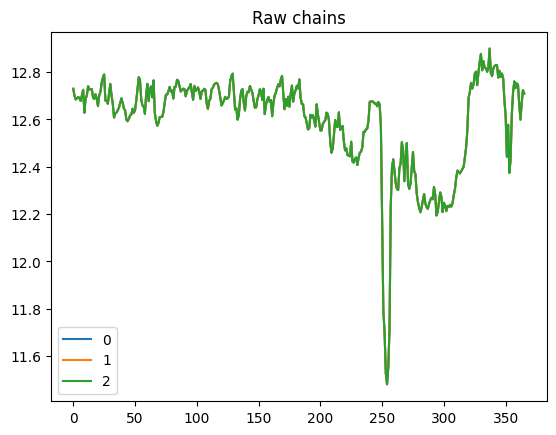

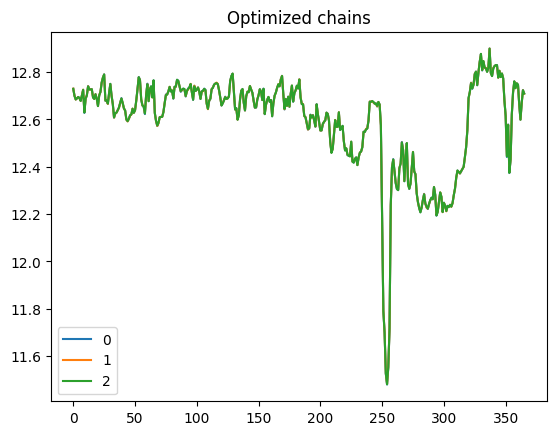

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.083  0.006   0.073    0.094        0.0      0.0    1775.0    3413.0   
eps  0.059  0.005   0.049    0.068        0.0      0.0    1189.0    1941.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 11 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.084  0.006   0.073    0.094        0.0      0.0    2020.0    3406.0   
eps  0.059  0.005   0.049    0.068        0.0      0.0    1154.0    1849.0   

     r_hat  
sig    1.0  
eps    1.0  


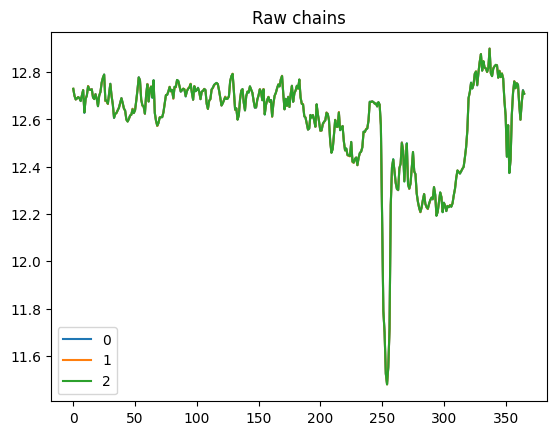

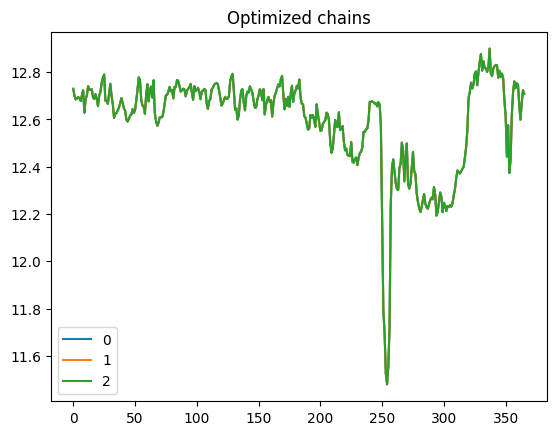

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.084  0.006   0.073    0.094        0.0      0.0    2020.0    3406.0   
eps  0.059  0.005   0.049    0.068        0.0      0.0    1154.0    1849.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 20 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.011   0.077    0.117        0.0      0.0     512.0    1401.0   
eps  0.129  0.009   0.113    0.145        0.0      0.0    1457.0    2331.0   

     r_hat  
sig    1.0  
eps    1.0  


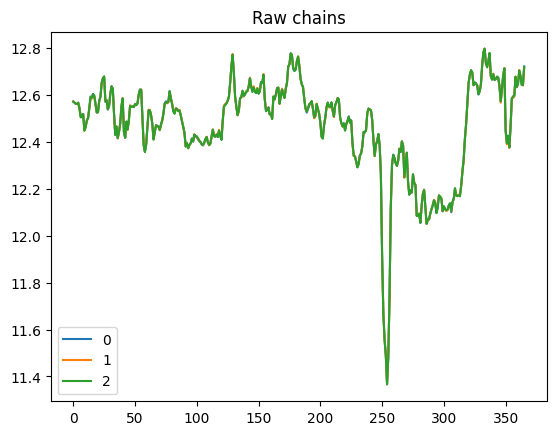

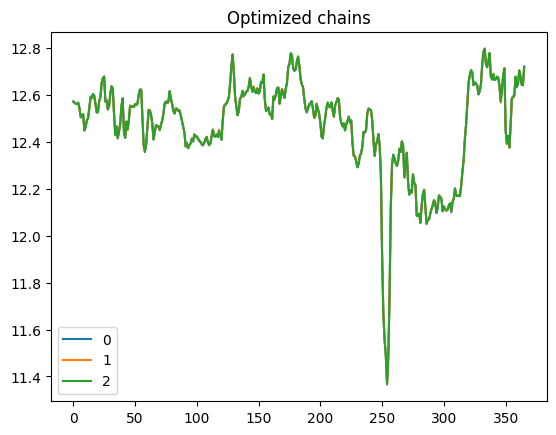

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.011   0.077    0.117        0.0      0.0     512.0    1401.0   
eps  0.129  0.009   0.113    0.145        0.0      0.0    1457.0    2331.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 15 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.111        0.0      0.0     928.0    2153.0   
eps  0.100  0.007   0.086    0.113        0.0      0.0    1268.0    2200.0   

     r_hat  
sig    1.0  
eps    1.0  


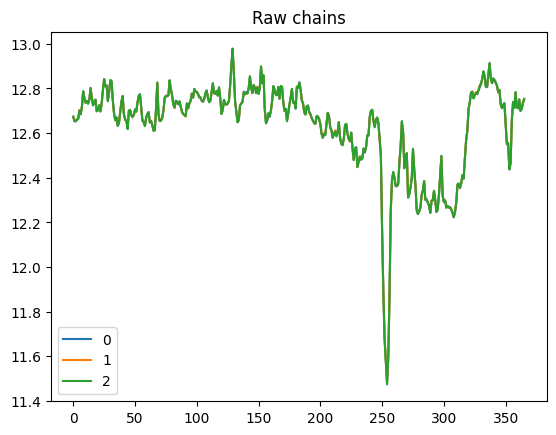

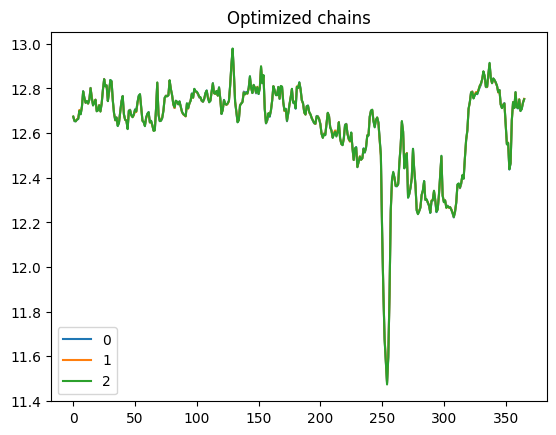

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.111        0.0      0.0     928.0    2153.0   
eps  0.100  0.007   0.086    0.113        0.0      0.0    1268.0    2200.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.110  0.012   0.089    0.133        0.0      0.0     594.0    1170.0   
eps  0.148  0.010   0.130    0.166        0.0      0.0    1086.0    1967.0   

     r_hat  
sig    1.0  
eps    1.0  


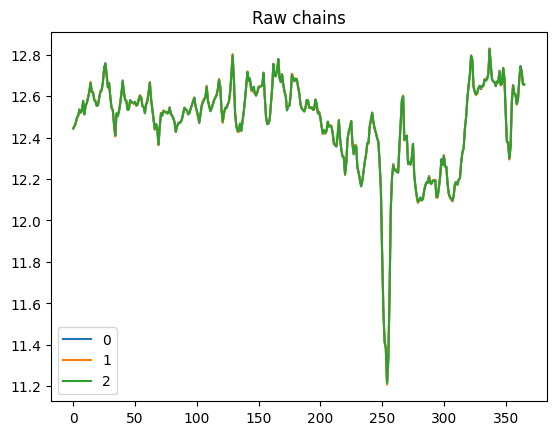

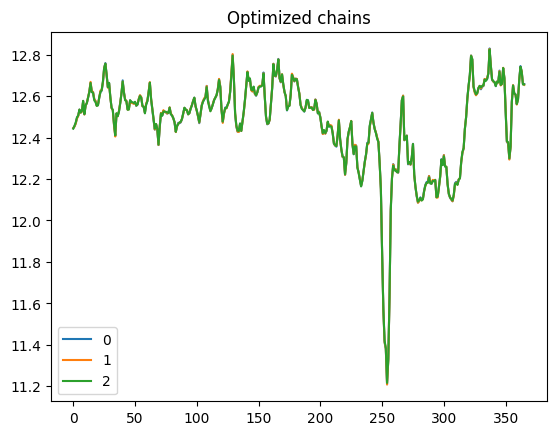

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.110  0.012   0.089    0.133        0.0      0.0     594.0    1170.0   
eps  0.148  0.010   0.130    0.166        0.0      0.0    1086.0    1967.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.108  0.011   0.088    0.129        0.0      0.0     886.0    1444.0   
eps  0.138  0.009   0.121    0.155        0.0      0.0    1594.0    2921.0   

     r_hat  
sig    1.0  
eps    1.0  


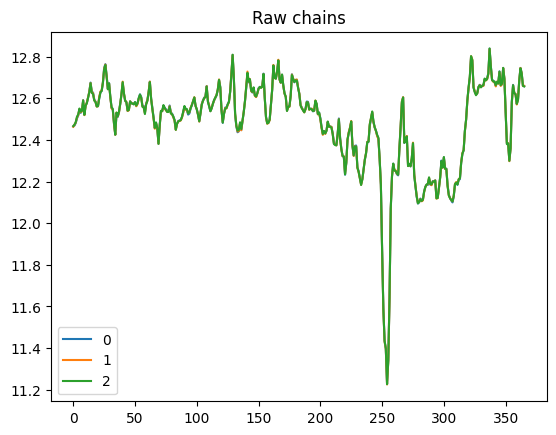

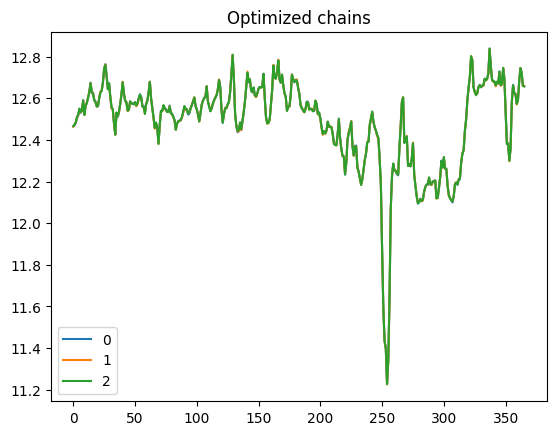

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.108  0.011   0.088    0.129        0.0      0.0     886.0    1444.0   
eps  0.138  0.009   0.121    0.155        0.0      0.0    1594.0    2921.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.080    0.112        0.0      0.0     905.0    1945.0   
eps  0.101  0.007   0.087    0.115        0.0      0.0    1336.0    2751.0   

     r_hat  
sig   1.01  
eps   1.00  


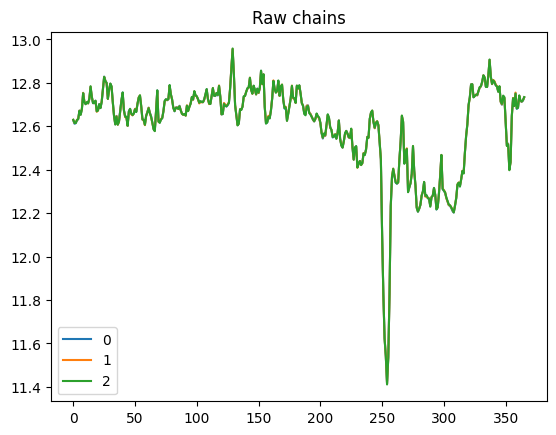

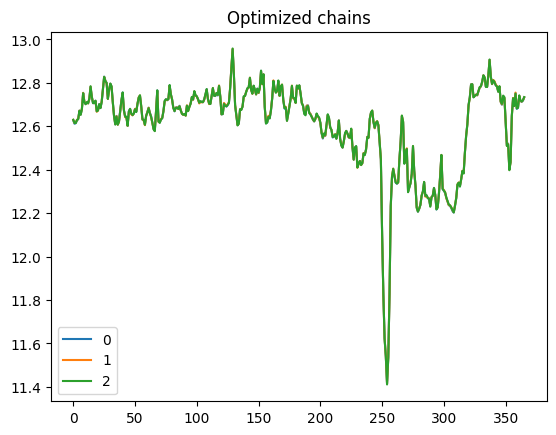

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.080    0.112        0.0      0.0     905.0    1945.0   
eps  0.101  0.007   0.087    0.115        0.0      0.0    1336.0    2751.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 16 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.078    0.111        0.0      0.0     906.0    1766.0   
eps  0.099  0.007   0.086    0.113        0.0      0.0    1226.0    2038.0   

     r_hat  
sig    1.0  
eps    1.0  


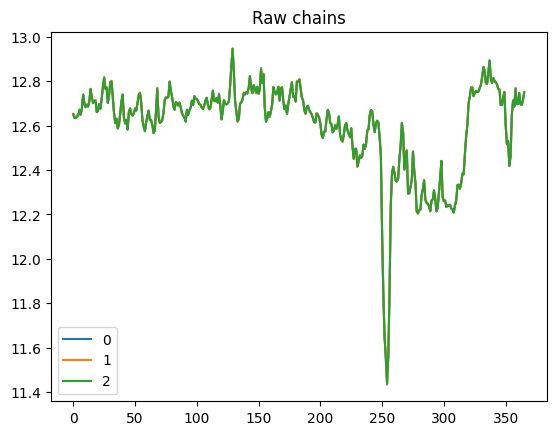

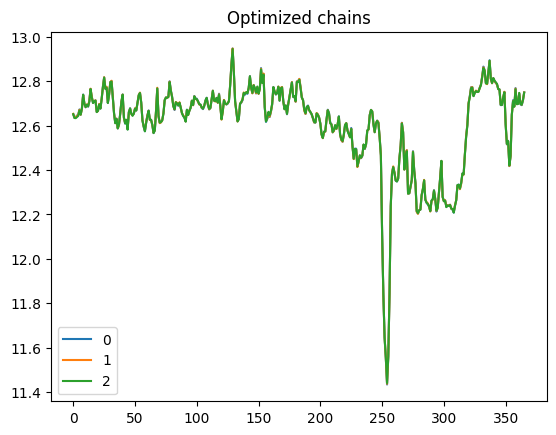

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.078    0.111        0.0      0.0     906.0    1766.0   
eps  0.099  0.007   0.086    0.113        0.0      0.0    1226.0    2038.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 28 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.011   0.078    0.119        0.0      0.0     604.0    1255.0   
eps  0.139  0.009   0.122    0.157        0.0      0.0    1218.0    1624.0   

     r_hat  
sig    1.0  
eps    1.0  


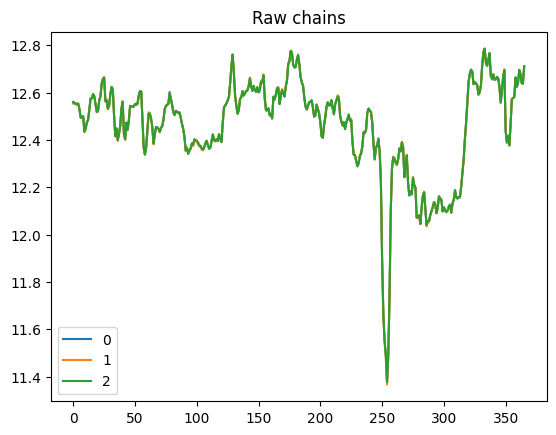

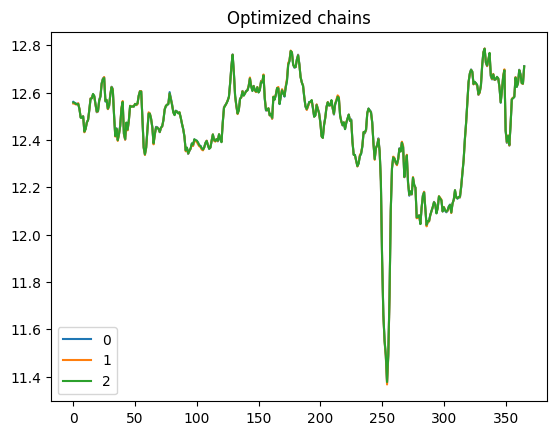

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.011   0.078    0.119        0.0      0.0     604.0    1255.0   
eps  0.139  0.009   0.122    0.157        0.0      0.0    1218.0    1624.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 14 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.090  0.008   0.075    0.105        0.0      0.0     777.0    1791.0   
eps  0.091  0.007   0.079    0.104        0.0      0.0    1109.0    2771.0   

     r_hat  
sig   1.01  
eps   1.00  


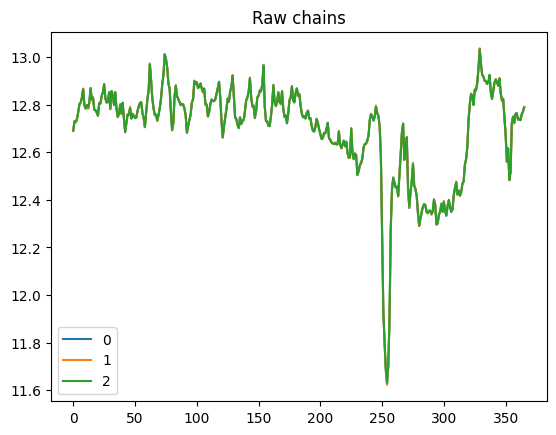

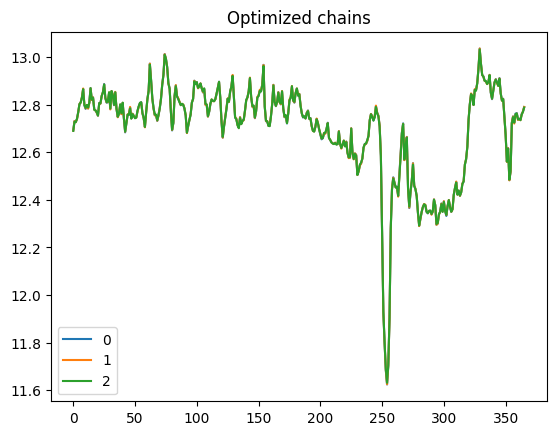

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.090  0.008   0.075    0.105        0.0      0.0     777.0    1791.0   
eps  0.091  0.007   0.079    0.104        0.0      0.0    1109.0    2771.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 14 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.077    0.111        0.0      0.0     817.0    1752.0   
eps  0.100  0.007   0.087    0.115        0.0      0.0    1258.0    2194.0   

     r_hat  
sig    1.0  
eps    1.0  


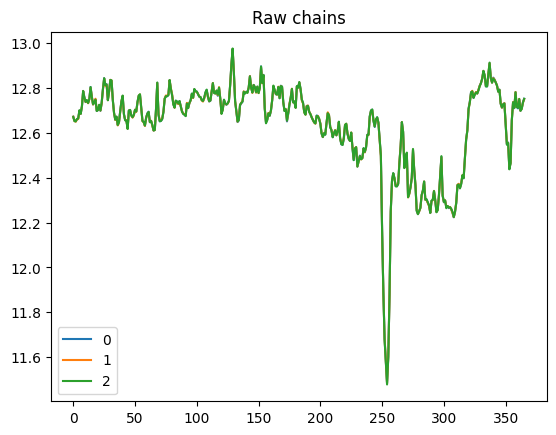

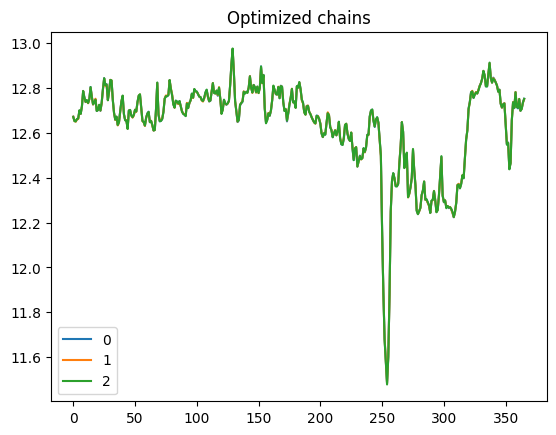

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.077    0.111        0.0      0.0     817.0    1752.0   
eps  0.100  0.007   0.087    0.115        0.0      0.0    1258.0    2194.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 24 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.010   0.080    0.118        0.0      0.0     549.0    1100.0   
eps  0.129  0.009   0.113    0.145        0.0      0.0    1298.0    2209.0   

     r_hat  
sig    1.0  
eps    1.0  


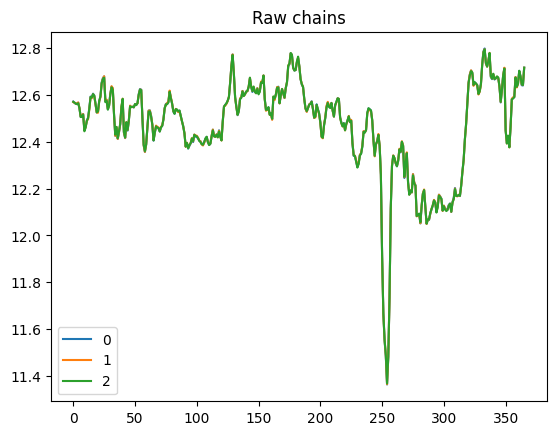

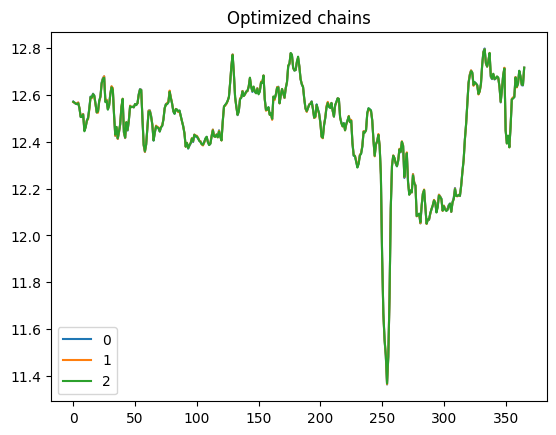

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.010   0.080    0.118        0.0      0.0     549.0    1100.0   
eps  0.129  0.009   0.113    0.145        0.0      0.0    1298.0    2209.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.086  0.006   0.075    0.097        0.0      0.0    2236.0    3120.0   
eps  0.059  0.005   0.049    0.069        0.0      0.0    1204.0    2332.0   

     r_hat  
sig    1.0  
eps    1.0  


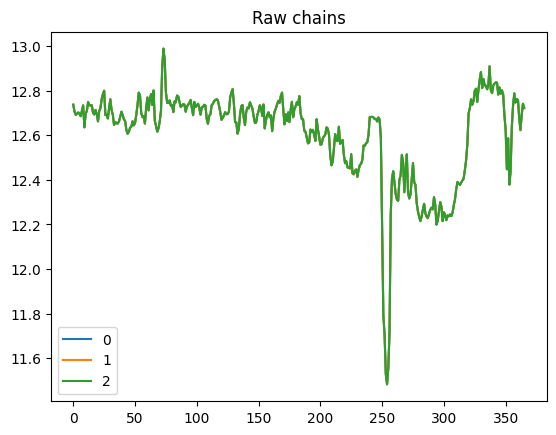

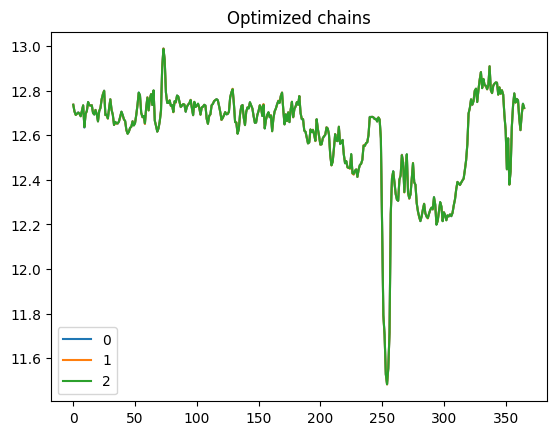

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.086  0.006   0.075    0.097        0.0      0.0    2236.0    3120.0   
eps  0.059  0.005   0.049    0.069        0.0      0.0    1204.0    2332.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 16 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.079    0.111        0.0      0.0     700.0    1602.0   
eps  0.100  0.007   0.086    0.113        0.0      0.0    1085.0    2108.0   

     r_hat  
sig    1.0  
eps    1.0  


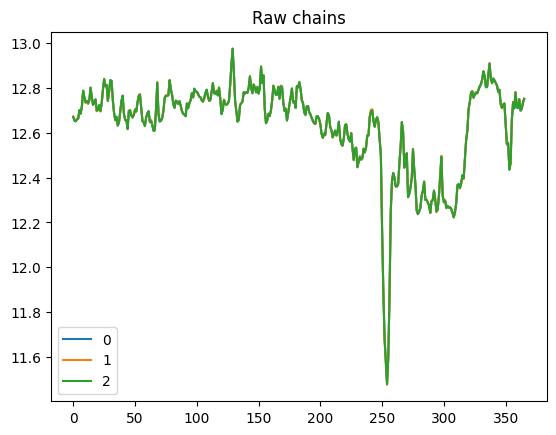

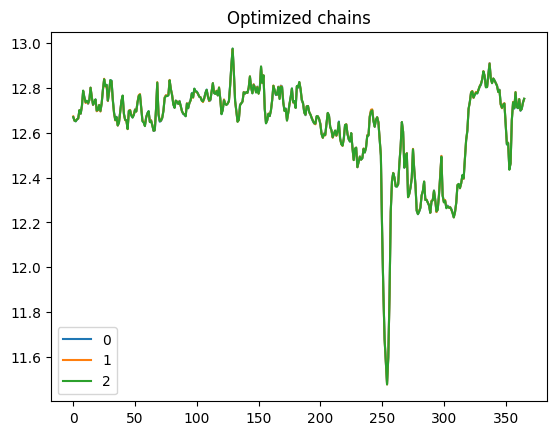

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.079    0.111        0.0      0.0     700.0    1602.0   
eps  0.100  0.007   0.086    0.113        0.0      0.0    1085.0    2108.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 16 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.079    0.112        0.0      0.0     860.0    1823.0   
eps  0.100  0.007   0.085    0.113        0.0      0.0    1253.0    2014.0   

     r_hat  
sig    1.0  
eps    1.0  


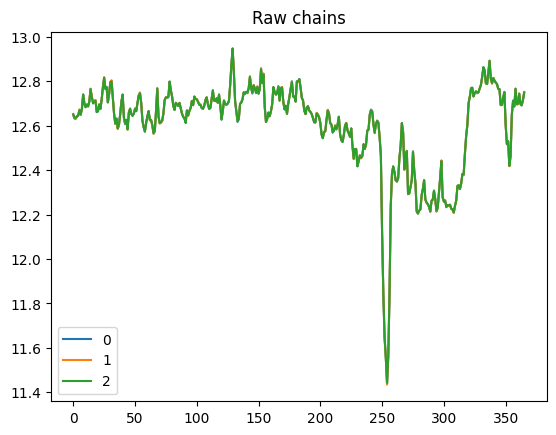

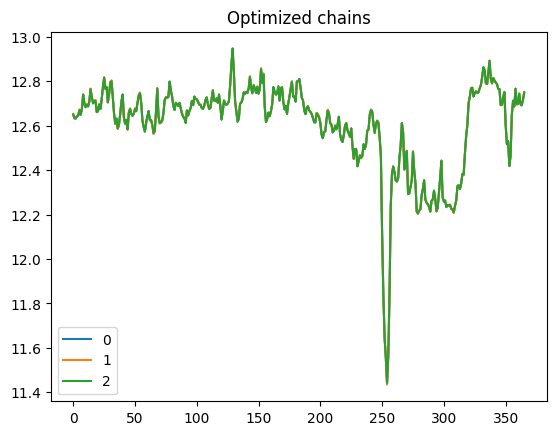

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.079    0.112        0.0      0.0     860.0    1823.0   
eps  0.100  0.007   0.085    0.113        0.0      0.0    1253.0    2014.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 15 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.097  0.009   0.081    0.113        0.0      0.0    1000.0    1429.0   
eps  0.101  0.007   0.087    0.115        0.0      0.0    1386.0    2698.0   

     r_hat  
sig    1.0  
eps    1.0  


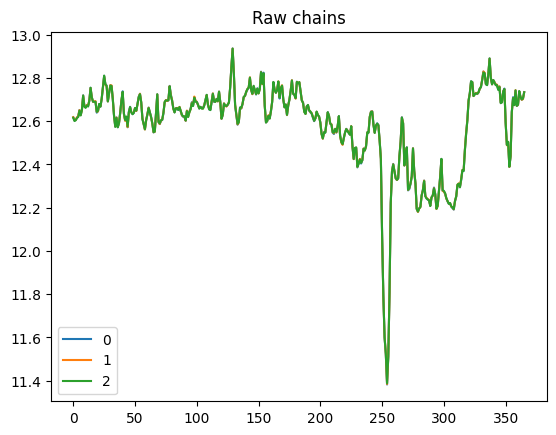

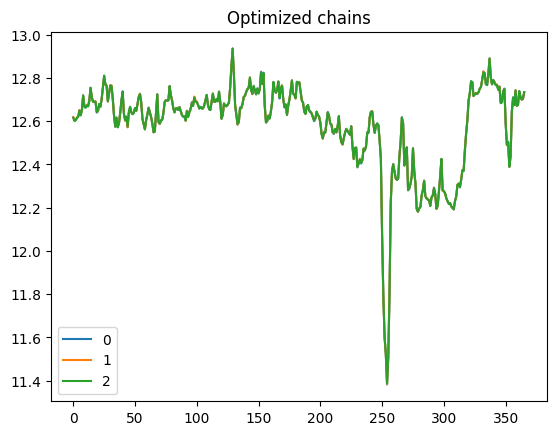

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.097  0.009   0.081    0.113        0.0      0.0    1000.0    1429.0   
eps  0.101  0.007   0.087    0.115        0.0      0.0    1386.0    2698.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 27 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.109  0.011   0.089    0.130        0.0      0.0     753.0    1675.0   
eps  0.142  0.010   0.124    0.159        0.0      0.0    1465.0    2754.0   

     r_hat  
sig    1.0  
eps    1.0  


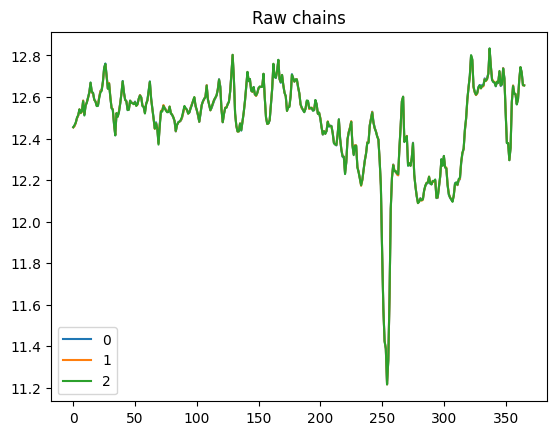

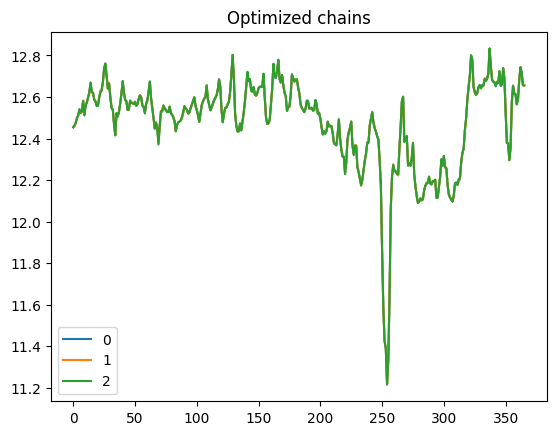

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.109  0.011   0.089    0.130        0.0      0.0     753.0    1675.0   
eps  0.142  0.010   0.124    0.159        0.0      0.0    1465.0    2754.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 30 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.111  0.012   0.088    0.134        0.0      0.0     614.0    1119.0   
eps  0.154  0.010   0.136    0.172        0.0      0.0    1448.0    2198.0   

     r_hat  
sig    1.0  
eps    1.0  


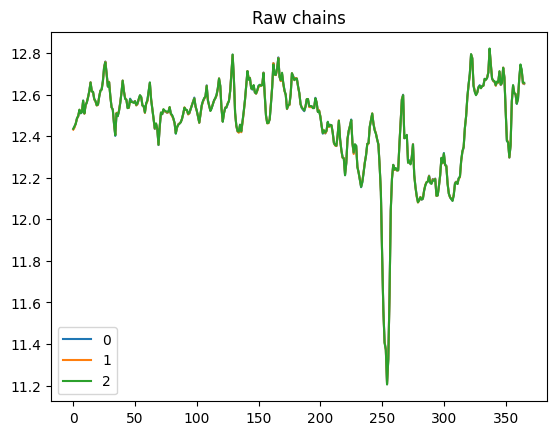

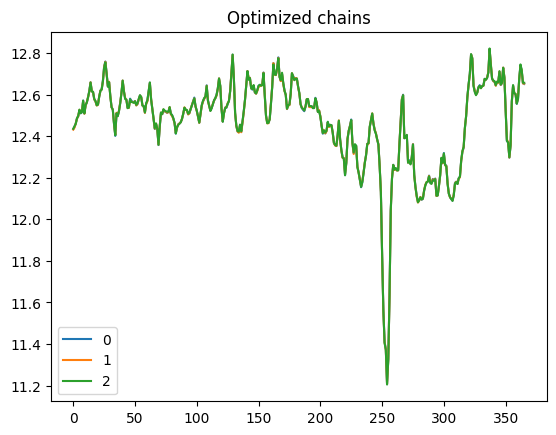

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.111  0.012   0.088    0.134        0.0      0.0     614.0    1119.0   
eps  0.154  0.010   0.136    0.172        0.0      0.0    1448.0    2198.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.109  0.012   0.088    0.132        0.0      0.0     589.0    1074.0   
eps  0.144  0.010   0.126    0.162        0.0      0.0    1165.0    2431.0   

     r_hat  
sig   1.01  
eps   1.00  


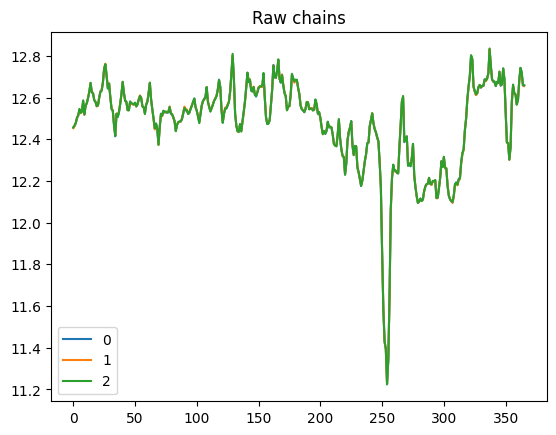

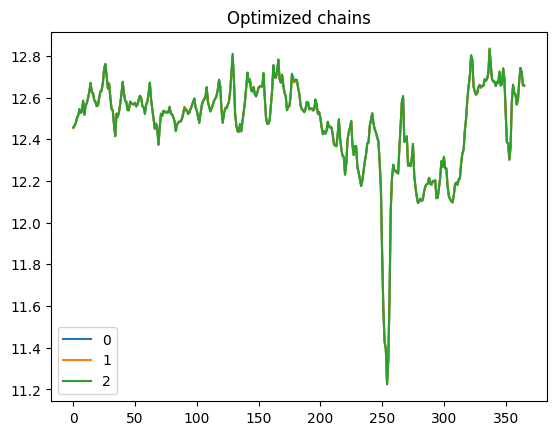

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.109  0.012   0.088    0.132        0.0      0.0     589.0    1074.0   
eps  0.144  0.010   0.126    0.162        0.0      0.0    1165.0    2431.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 12 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.086  0.006   0.076    0.097        0.0      0.0    1784.0    3218.0   
eps  0.059  0.005   0.049    0.069        0.0      0.0    1068.0    1595.0   

     r_hat  
sig    1.0  
eps    1.0  


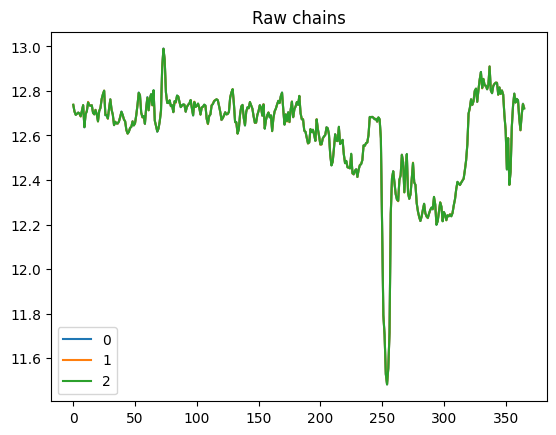

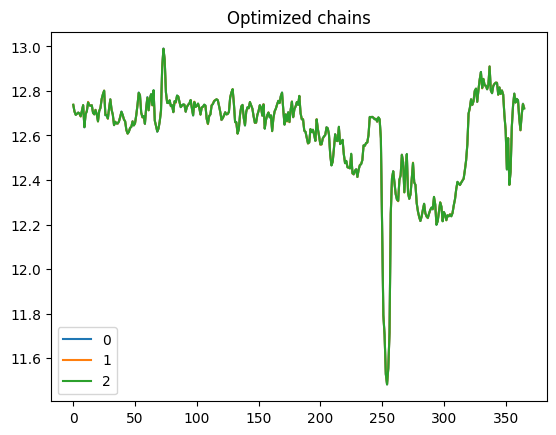

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.086  0.006   0.076    0.097        0.0      0.0    1784.0    3218.0   
eps  0.059  0.005   0.049    0.069        0.0      0.0    1068.0    1595.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 15 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.077    0.110        0.0      0.0     827.0    1649.0   
eps  0.101  0.007   0.087    0.115        0.0      0.0    1225.0    2083.0   

     r_hat  
sig    1.0  
eps    1.0  


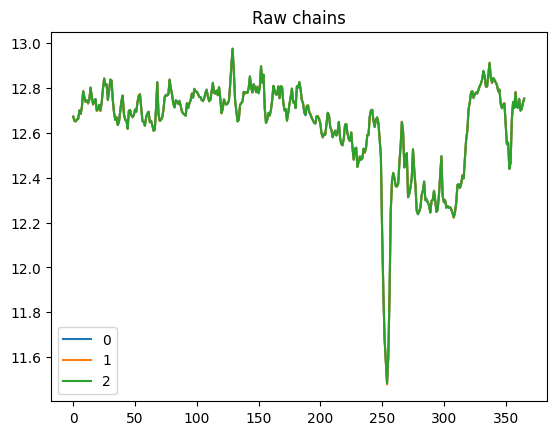

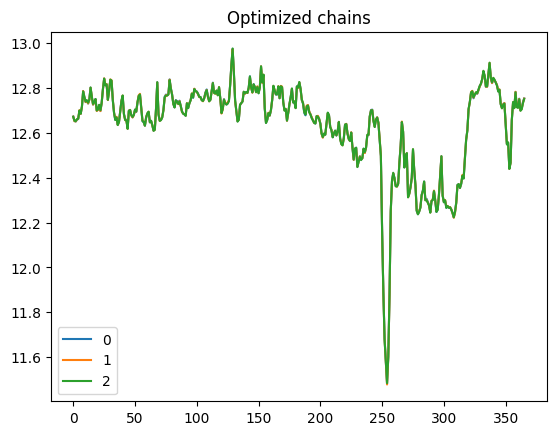

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.077    0.110        0.0      0.0     827.0    1649.0   
eps  0.101  0.007   0.087    0.115        0.0      0.0    1225.0    2083.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 27 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.010   0.079    0.118        0.0      0.0     727.0    1747.0   
eps  0.133  0.009   0.118    0.150        0.0      0.0    1658.0    2512.0   

     r_hat  
sig    1.0  
eps    1.0  


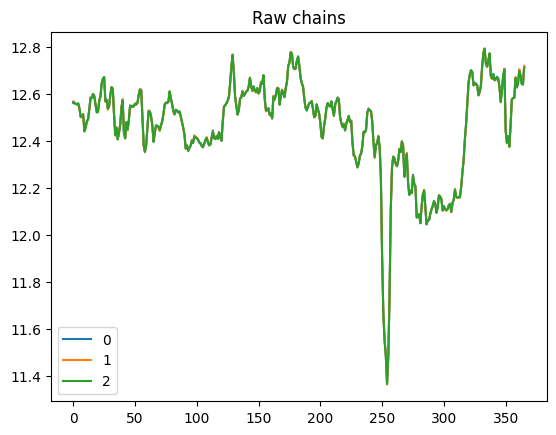

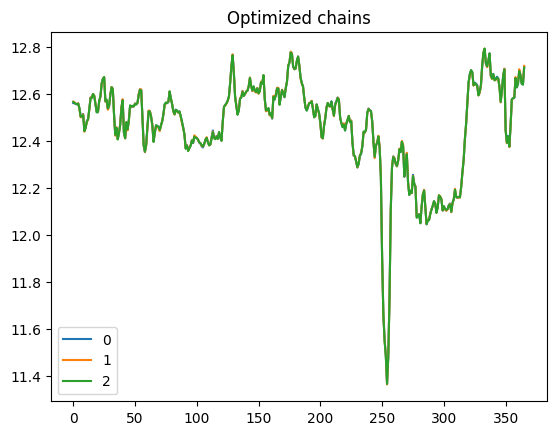

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.010   0.079    0.118        0.0      0.0     727.0    1747.0   
eps  0.133  0.009   0.118    0.150        0.0      0.0    1658.0    2512.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.011   0.077    0.117        0.0      0.0     723.0    1424.0   
eps  0.129  0.009   0.112    0.144        0.0      0.0    1265.0    2160.0   

     r_hat  
sig    1.0  
eps    1.0  


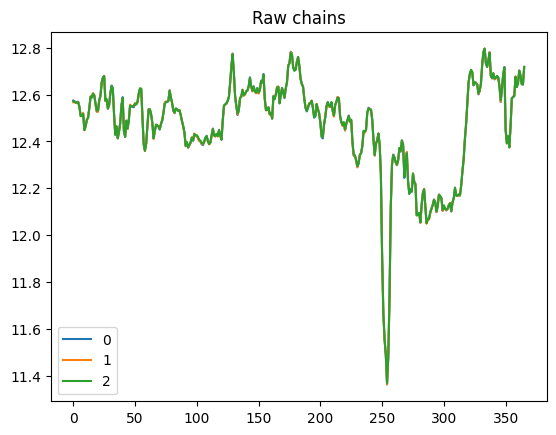

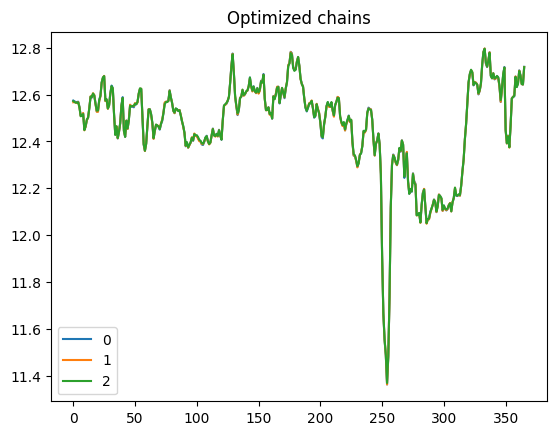

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.011   0.077    0.117        0.0      0.0     723.0    1424.0   
eps  0.129  0.009   0.112    0.144        0.0      0.0    1265.0    2160.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 17 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.081    0.115        0.0      0.0     798.0    1834.0   
eps  0.100  0.007   0.087    0.115        0.0      0.0    1317.0    2129.0   

     r_hat  
sig    1.0  
eps    1.0  


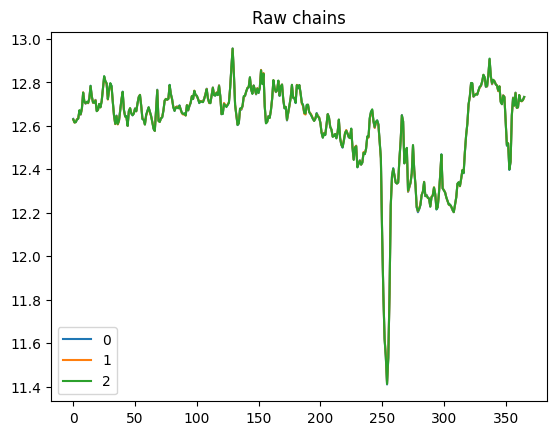

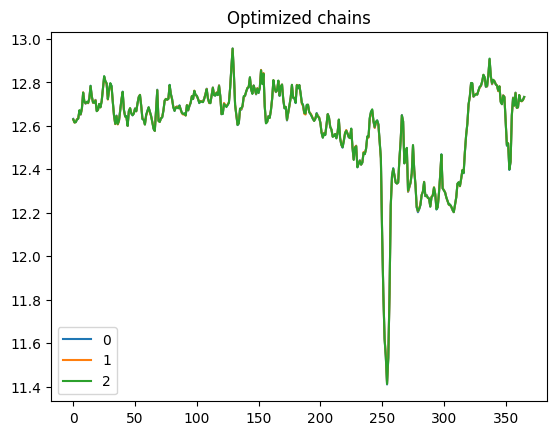

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.081    0.115        0.0      0.0     798.0    1834.0   
eps  0.100  0.007   0.087    0.115        0.0      0.0    1317.0    2129.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.010   0.080    0.118        0.0      0.0     649.0    1131.0   
eps  0.128  0.009   0.112    0.144        0.0      0.0    1466.0    2485.0   

     r_hat  
sig    1.0  
eps    1.0  


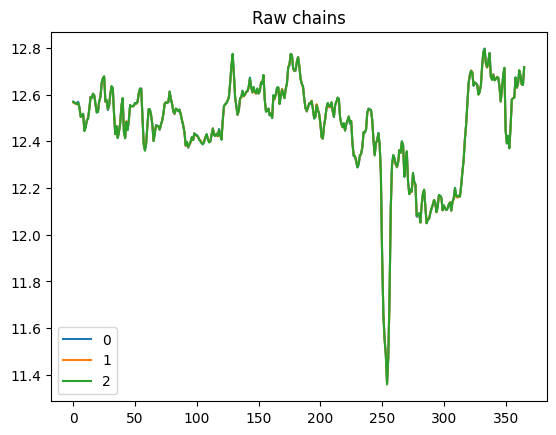

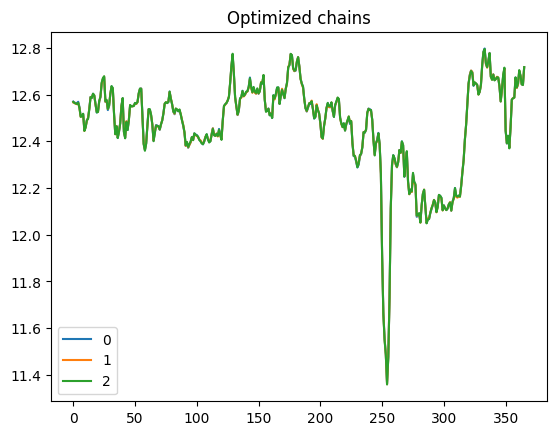

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.010   0.080    0.118        0.0      0.0     649.0    1131.0   
eps  0.128  0.009   0.112    0.144        0.0      0.0    1466.0    2485.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 15 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.111        0.0      0.0     922.0    1995.0   
eps  0.100  0.007   0.086    0.114        0.0      0.0    1524.0    2941.0   

     r_hat  
sig    1.0  
eps    1.0  


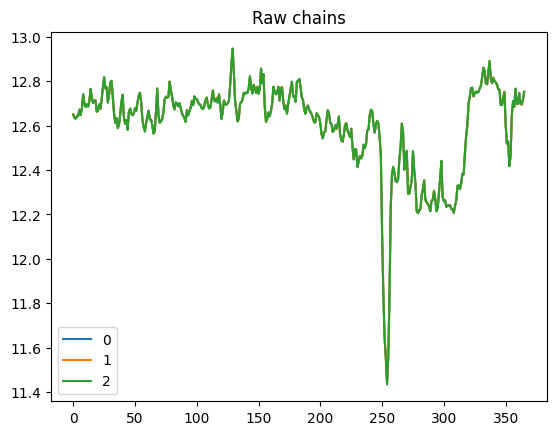

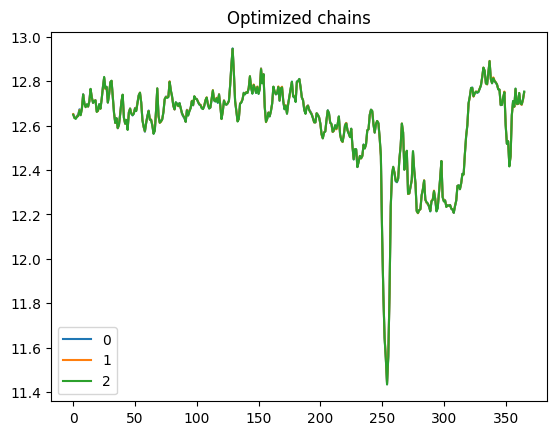

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.111        0.0      0.0     922.0    1995.0   
eps  0.100  0.007   0.086    0.114        0.0      0.0    1524.0    2941.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 18 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.011   0.083    0.122        0.0      0.0     648.0    1630.0   
eps  0.122  0.009   0.106    0.139        0.0      0.0    1002.0    1929.0   

     r_hat  
sig    1.0  
eps    1.0  


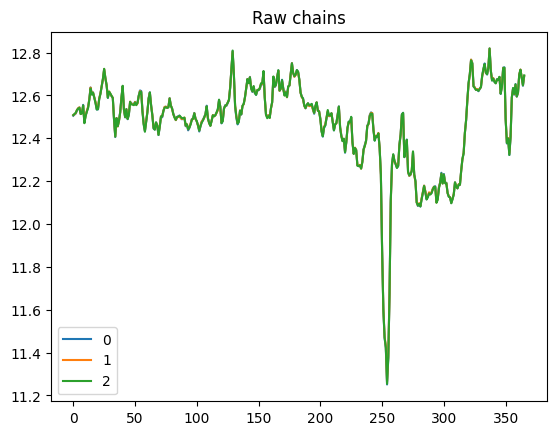

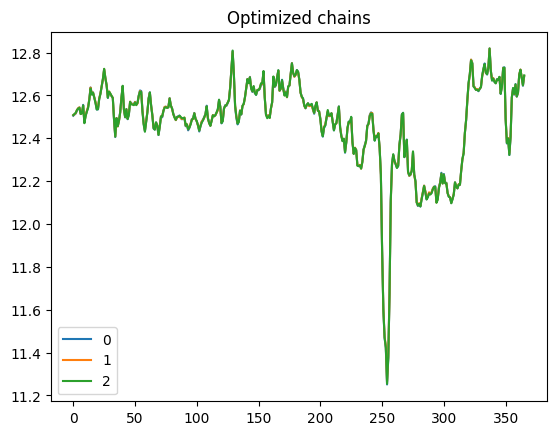

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.011   0.083    0.122        0.0      0.0     648.0    1630.0   
eps  0.122  0.009   0.106    0.139        0.0      0.0    1002.0    1929.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.011   0.083    0.123        0.0      0.0     635.0    1227.0   
eps  0.125  0.009   0.108    0.140        0.0      0.0    1357.0    2078.0   

     r_hat  
sig   1.01  
eps   1.00  


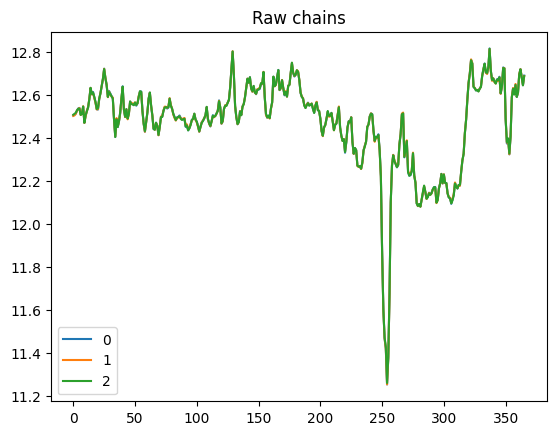

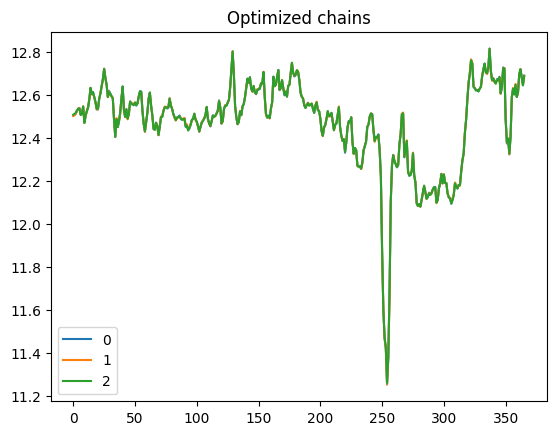

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.011   0.083    0.123        0.0      0.0     635.0    1227.0   
eps  0.125  0.009   0.108    0.140        0.0      0.0    1357.0    2078.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 14 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.078    0.111        0.0      0.0     823.0    1574.0   
eps  0.100  0.007   0.087    0.114        0.0      0.0    1248.0    1715.0   

     r_hat  
sig    1.0  
eps    1.0  


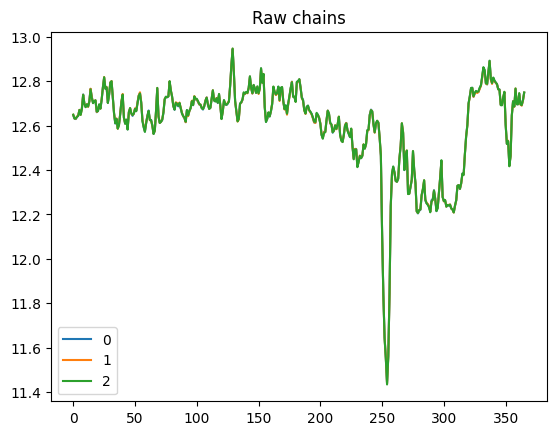

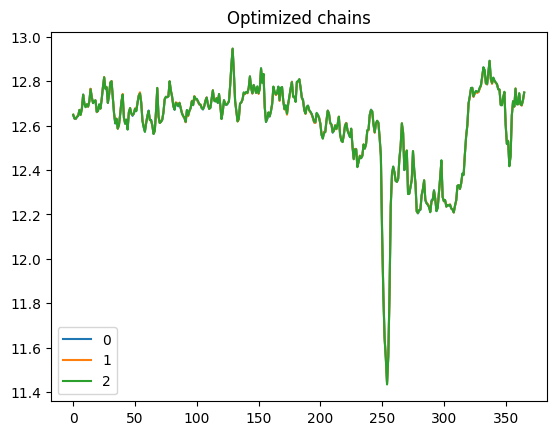

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.095  0.009   0.078    0.111        0.0      0.0     823.0    1574.0   
eps  0.100  0.007   0.087    0.114        0.0      0.0    1248.0    1715.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 18 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.010   0.084    0.121        0.0      0.0     775.0    1685.0   
eps  0.123  0.008   0.107    0.138        0.0      0.0    1302.0    2111.0   

     r_hat  
sig   1.01  
eps   1.00  


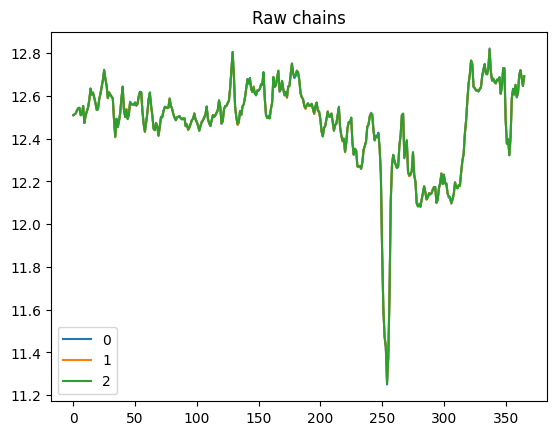

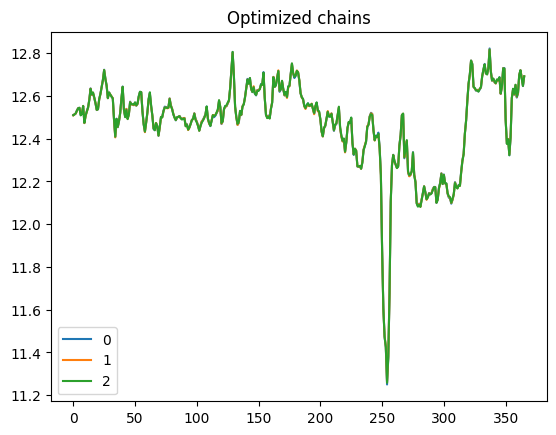

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.102  0.010   0.084    0.121        0.0      0.0     775.0    1685.0   
eps  0.123  0.008   0.107    0.138        0.0      0.0    1302.0    2111.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 11 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.083  0.005   0.073    0.093        0.0      0.0    2281.0    3029.0   
eps  0.055  0.005   0.046    0.064        0.0      0.0    1196.0    1689.0   

     r_hat  
sig    1.0  
eps    1.0  


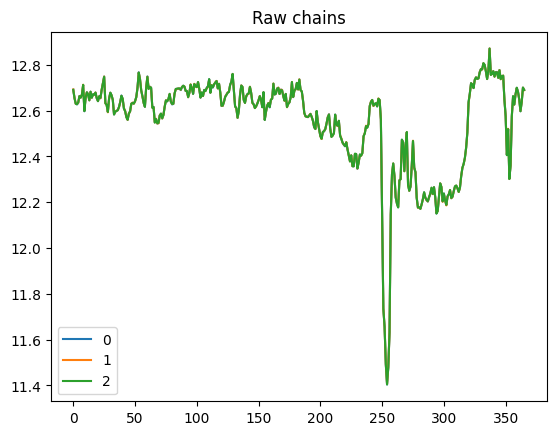

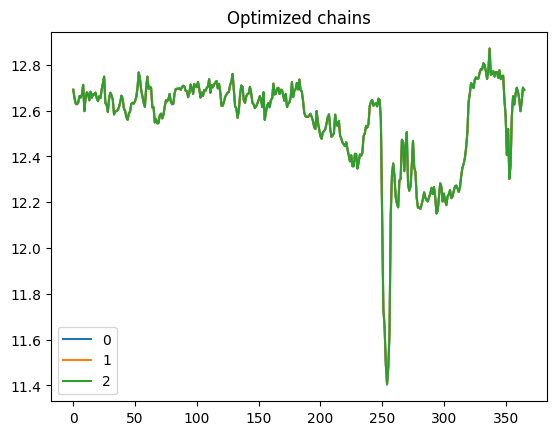

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.083  0.005   0.073    0.093        0.0      0.0    2281.0    3029.0   
eps  0.055  0.005   0.046    0.064        0.0      0.0    1196.0    1689.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.112        0.0      0.0     899.0    1539.0   
eps  0.102  0.007   0.088    0.115        0.0      0.0    1244.0    2273.0   

     r_hat  
sig    1.0  
eps    1.0  


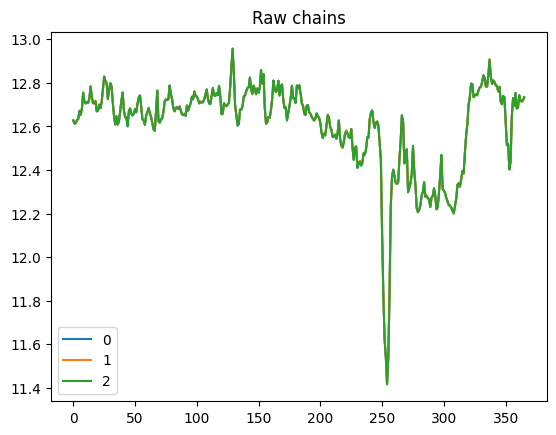

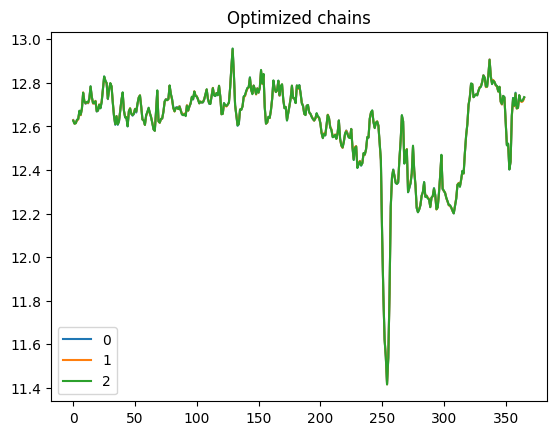

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.112        0.0      0.0     899.0    1539.0   
eps  0.102  0.007   0.088    0.115        0.0      0.0    1244.0    2273.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 19 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.103  0.011   0.083    0.123        0.0      0.0     698.0    1435.0   
eps  0.127  0.009   0.111    0.143        0.0      0.0    1250.0    2123.0   

     r_hat  
sig   1.01  
eps   1.00  


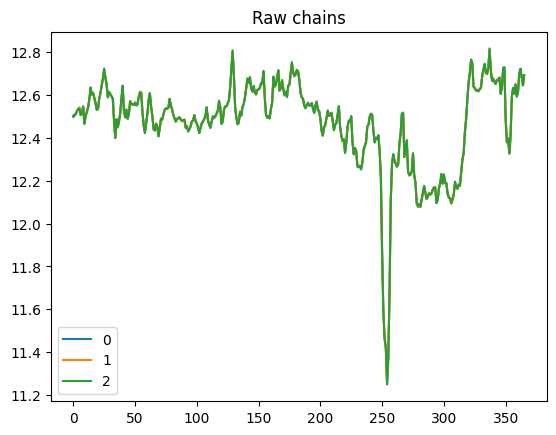

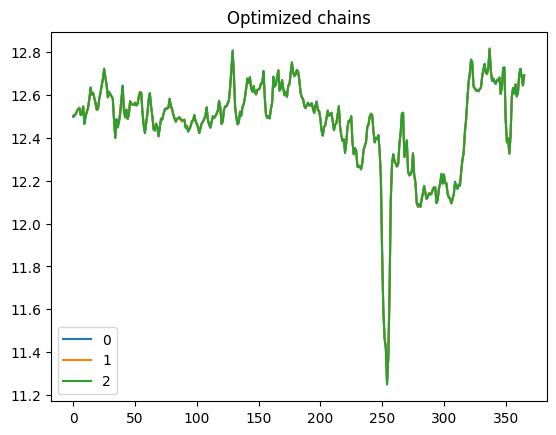

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.103  0.011   0.083    0.123        0.0      0.0     698.0    1435.0   
eps  0.127  0.009   0.111    0.143        0.0      0.0    1250.0    2123.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.080    0.113        0.0      0.0     908.0    1226.0   
eps  0.101  0.008   0.086    0.114        0.0      0.0    1297.0    2449.0   

     r_hat  
sig   1.01  
eps   1.00  


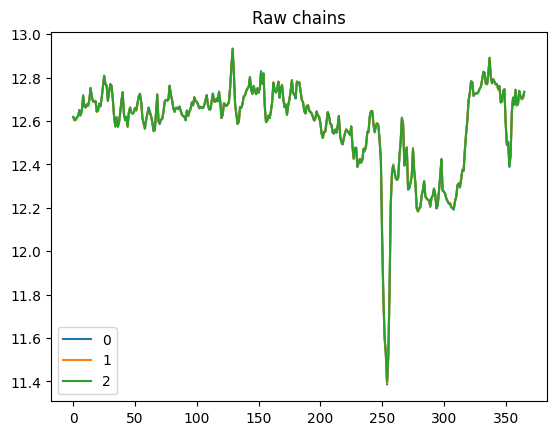

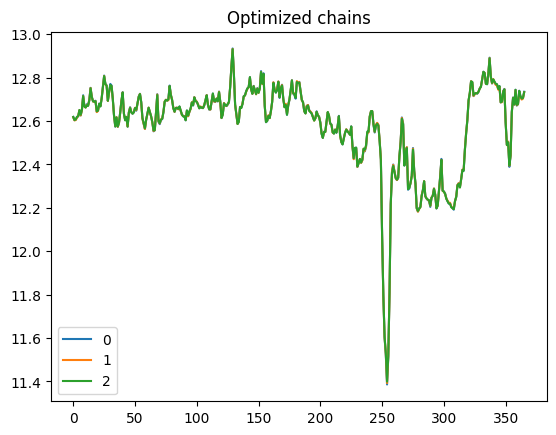

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.080    0.113        0.0      0.0     908.0    1226.0   
eps  0.101  0.008   0.086    0.114        0.0      0.0    1297.0    2449.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 14 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.111        0.0      0.0     835.0    1571.0   
eps  0.101  0.007   0.088    0.115        0.0      0.0    1300.0    2749.0   

     r_hat  
sig    1.0  
eps    1.0  


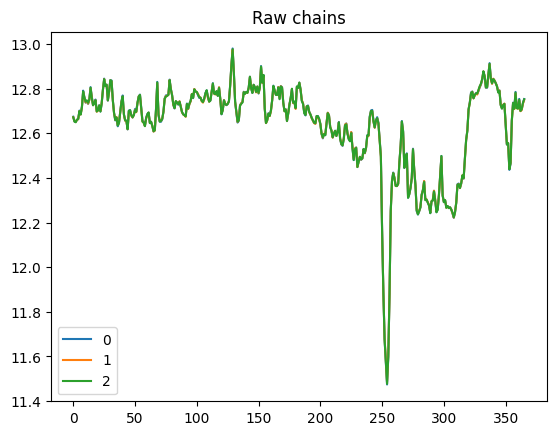

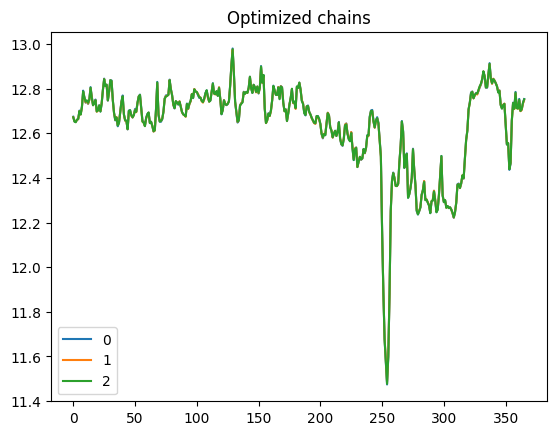

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.094  0.009   0.078    0.111        0.0      0.0     835.0    1571.0   
eps  0.101  0.007   0.088    0.115        0.0      0.0    1300.0    2749.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 11 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.085  0.006   0.075    0.096        0.0      0.0    2176.0    3419.0   
eps  0.054  0.005   0.045    0.064        0.0      0.0    1074.0    1650.0   

     r_hat  
sig    1.0  
eps    1.0  


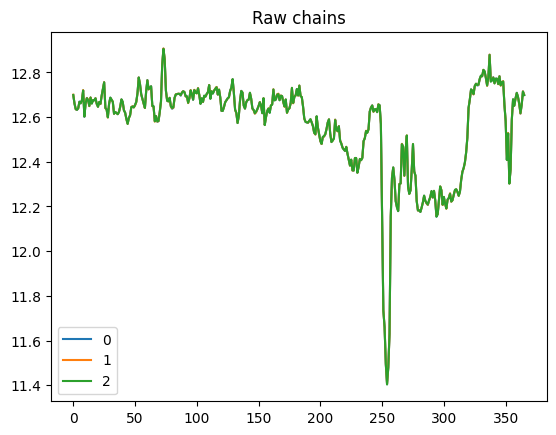

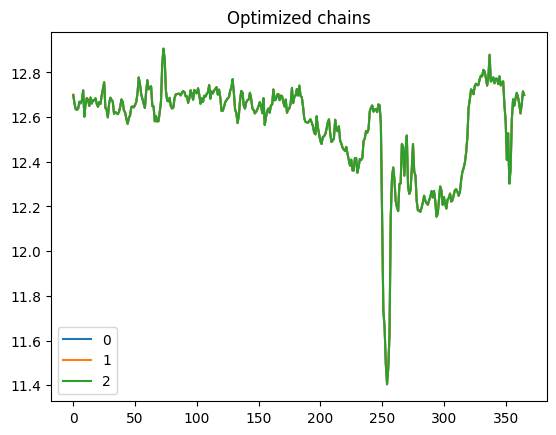

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.085  0.006   0.075    0.096        0.0      0.0    2176.0    3419.0   
eps  0.054  0.005   0.045    0.064        0.0      0.0    1074.0    1650.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 14 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.113        0.0      0.0     975.0    1938.0   
eps  0.101  0.008   0.086    0.115        0.0      0.0    1363.0    2100.0   

     r_hat  
sig    1.0  
eps    1.0  


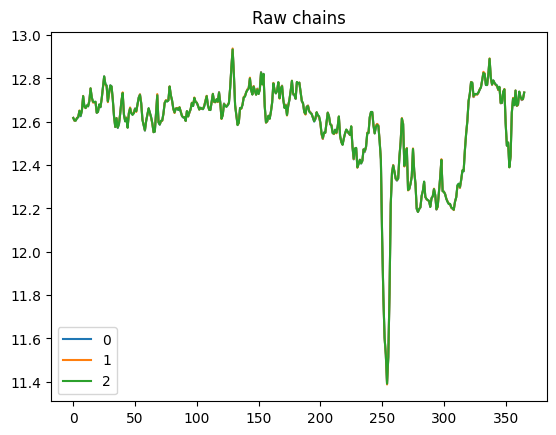

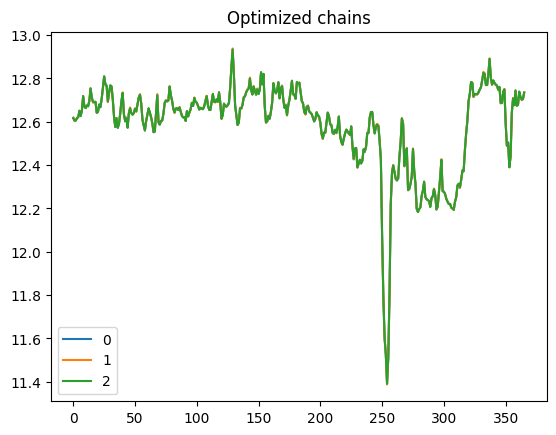

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.113        0.0      0.0     975.0    1938.0   
eps  0.101  0.008   0.086    0.115        0.0      0.0    1363.0    2100.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 20 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.011   0.078    0.119        0.0      0.0     645.0    1176.0   
eps  0.133  0.009   0.116    0.149        0.0      0.0    1187.0    2223.0   

     r_hat  
sig   1.01  
eps   1.00  


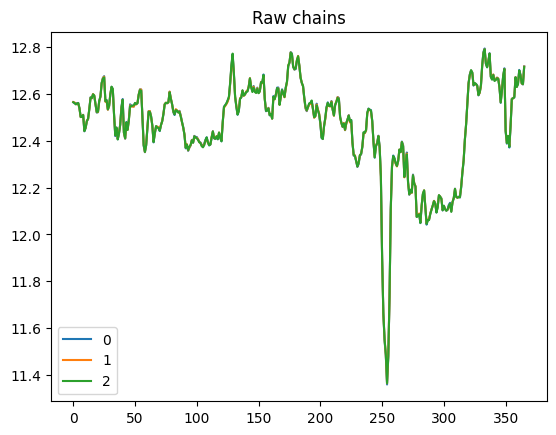

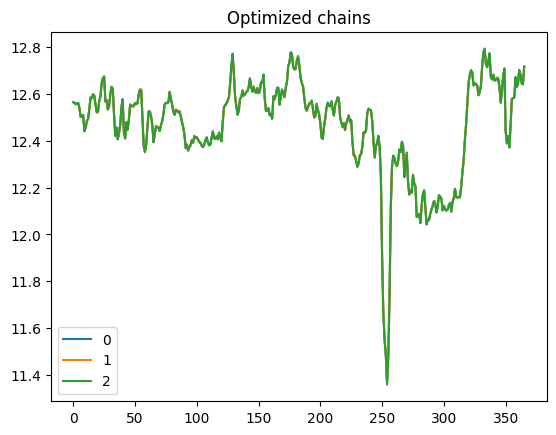

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.098  0.011   0.078    0.119        0.0      0.0     645.0    1176.0   
eps  0.133  0.009   0.116    0.149        0.0      0.0    1187.0    2223.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.113        0.0      0.0     839.0    1557.0   
eps  0.101  0.007   0.087    0.115        0.0      0.0    1186.0    2379.0   

     r_hat  
sig    1.0  
eps    1.0  


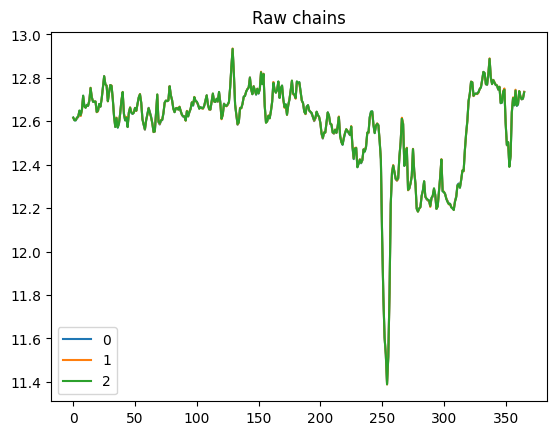

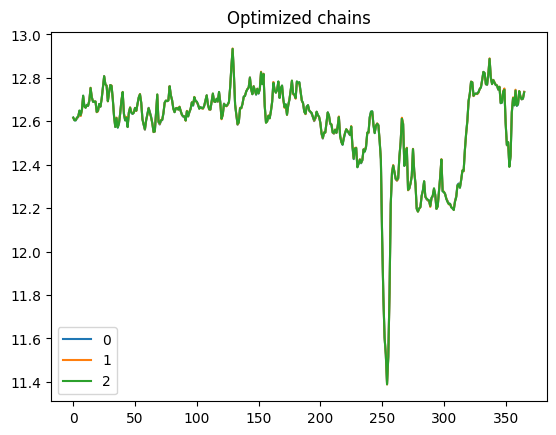

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.096  0.009   0.079    0.113        0.0      0.0     839.0    1557.0   
eps  0.101  0.007   0.087    0.115        0.0      0.0    1186.0    2379.0   

     r_hat  
sig    1.0  
eps    1.0  


In [50]:
for file in filtered_mav_glob:
    file_tail = file.split('model_8_')[1]
    file_fixed_param = file_tail.split('_')[0]
    file_combination = file_tail.split('_')[1].split('.csv')[0]

    sub_data = pd.read_csv(file, sep=';')
    sub_data.dateStart = pd.to_datetime(sub_data.dateStart)
    sub_data['obs'] = np.log(sub_data.Nt_hat)

    scou = fit_model(sub_data)

    sub_data['muX'] = scou.muX
    sub_data['CIL'] = scou.CIL
    sub_data['CIU'] = scou.CIU

    sub_data['muX'] = np.exp(scou.muX)
    sub_data['CIL'] = np.exp(scou.CIL)
    sub_data['CIU'] = np.exp(scou.CIU)

    sub_data = sub_data.rename(columns={'Nt_hat':'obs', 'muX':'Nt_hat'})

    output_filepath = file.replace('model_8', 'model_9')
    sub_data.to_csv(output_filepath, index=False, sep=";")

In [51]:
sev_glob = glob.glob('../outputs/files/SEV_NtHat_hierarchical_2020/*.csv')

In [52]:
filtered_sev_glob = []
for file in sev_glob:
    if 'model_8' in file:
        filtered_sev_glob.append(file)
        
len(filtered_sev_glob)

127

/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.047    0.074        0.0      0.0     494.0    1367.0   
eps  0.112  0.006   0.101    0.124        0.0      0.0    2522.0    4015.0   

     r_hat  
sig   1.01  
eps   1.00  


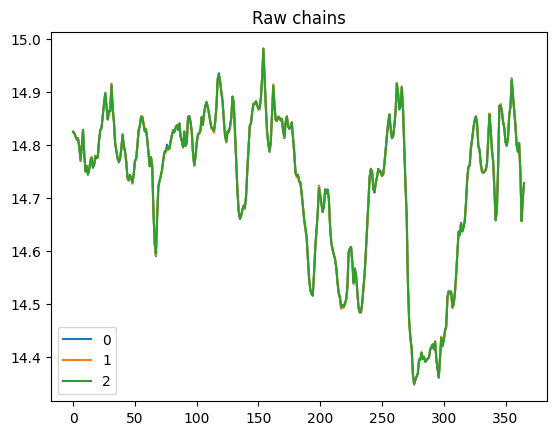

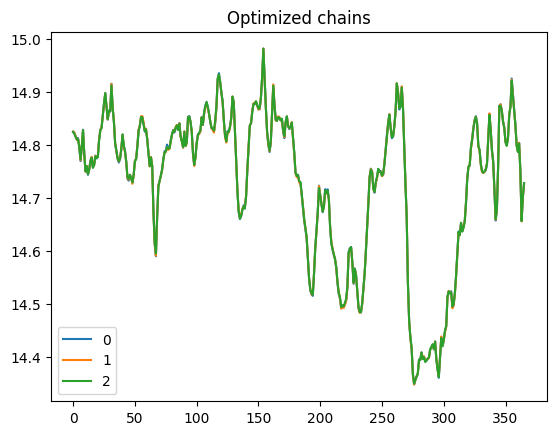

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.047    0.074        0.0      0.0     494.0    1367.0   
eps  0.112  0.006   0.101    0.124        0.0      0.0    2522.0    4015.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 20 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.074        0.0      0.0     534.0     861.0   
eps  0.111  0.006   0.099    0.121        0.0      0.0    2691.0    3835.0   

     r_hat  
sig    1.0  
eps    1.0  


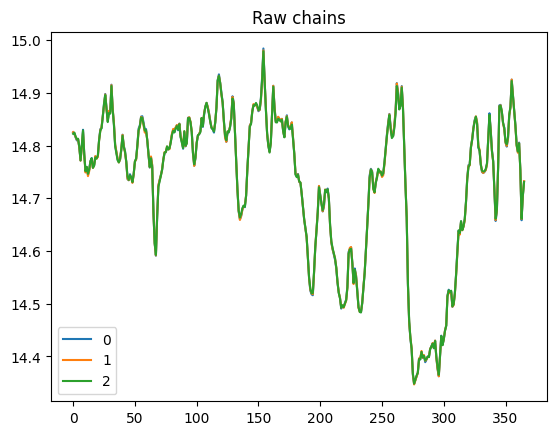

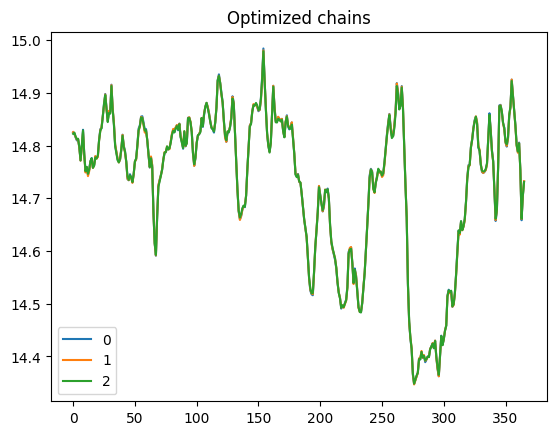

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.074        0.0      0.0     534.0     861.0   
eps  0.111  0.006   0.099    0.121        0.0      0.0    2691.0    3835.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.075        0.0      0.0     472.0    1114.0   
eps  0.119  0.006   0.108    0.131        0.0      0.0    2386.0    3652.0   

     r_hat  
sig    1.0  
eps    1.0  


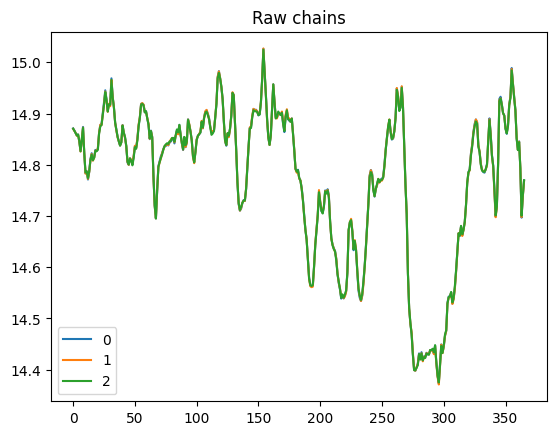

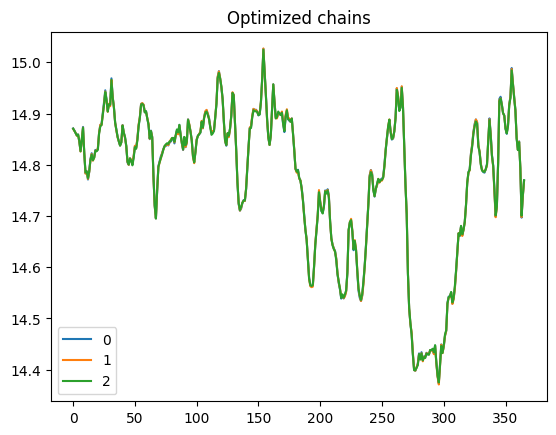

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.075        0.0      0.0     472.0    1114.0   
eps  0.119  0.006   0.108    0.131        0.0      0.0    2386.0    3652.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 28 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.067  0.010   0.049    0.084      0.001      0.0     218.0     377.0   
eps  0.158  0.008   0.144    0.172      0.000      0.0    1634.0    3939.0   

     r_hat  
sig   1.01  
eps   1.00  


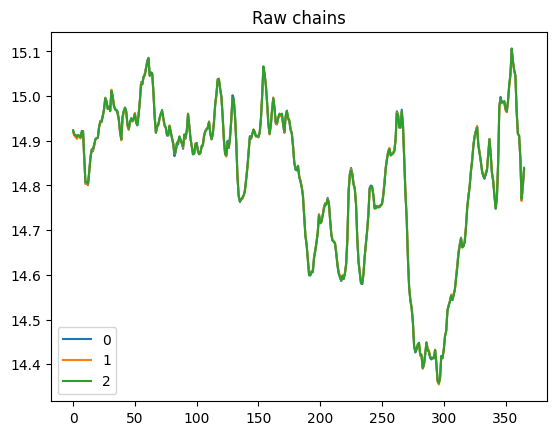

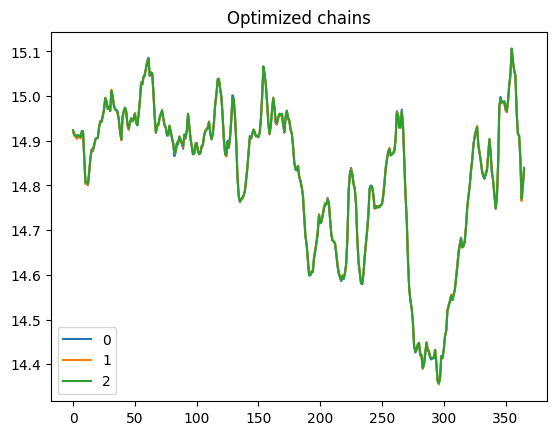

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.067  0.010   0.049    0.084      0.001      0.0     218.0     377.0   
eps  0.158  0.008   0.144    0.172      0.000      0.0    1634.0    3939.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 12 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.046  0.004   0.039    0.053        0.0      0.0    1195.0    2201.0   
eps  0.047  0.003   0.041    0.053        0.0      0.0    1749.0    2605.0   

     r_hat  
sig    1.0  
eps    1.0  


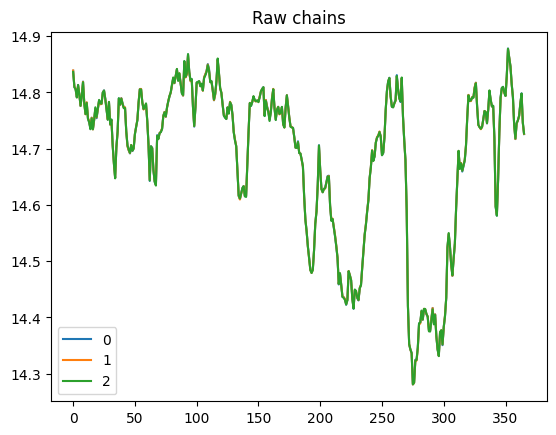

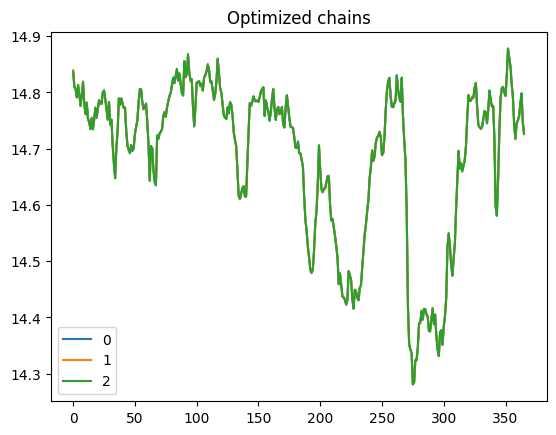

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.046  0.004   0.039    0.053        0.0      0.0    1195.0    2201.0   
eps  0.047  0.003   0.041    0.053        0.0      0.0    1749.0    2605.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 28 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.067  0.009    0.05    0.085        0.0      0.0     382.0     833.0   
eps  0.154  0.008    0.14    0.168        0.0      0.0    1877.0    3845.0   

     r_hat  
sig    1.0  
eps    1.0  


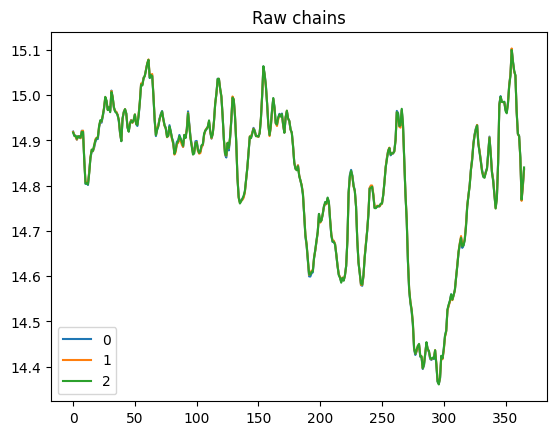

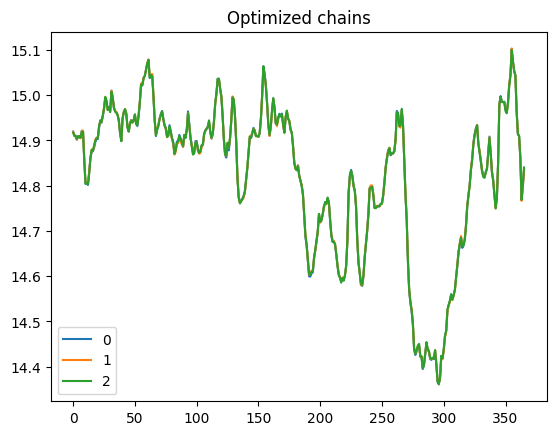

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.067  0.009    0.05    0.085        0.0      0.0     382.0     833.0   
eps  0.154  0.008    0.14    0.168        0.0      0.0    1877.0    3845.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.008   0.047    0.074        0.0      0.0     423.0     900.0   
eps  0.114  0.006   0.103    0.127        0.0      0.0    2026.0    3477.0   

     r_hat  
sig    1.0  
eps    1.0  


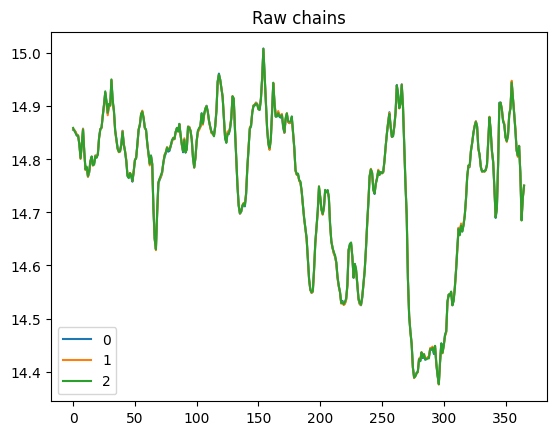

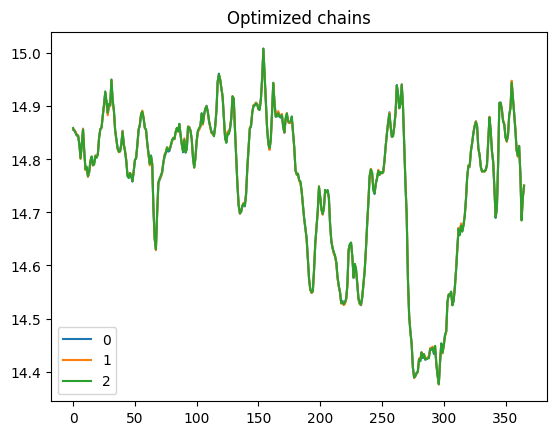

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.008   0.047    0.074        0.0      0.0     423.0     900.0   
eps  0.114  0.006   0.103    0.127        0.0      0.0    2026.0    3477.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 24 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.047    0.075        0.0      0.0     425.0    1019.0   
eps  0.119  0.006   0.108    0.132        0.0      0.0    2207.0    3492.0   

     r_hat  
sig    1.0  
eps    1.0  


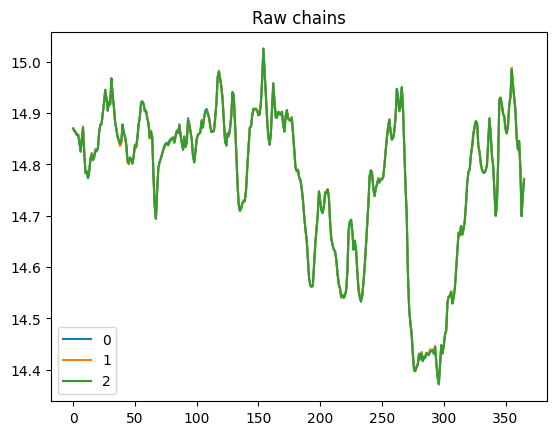

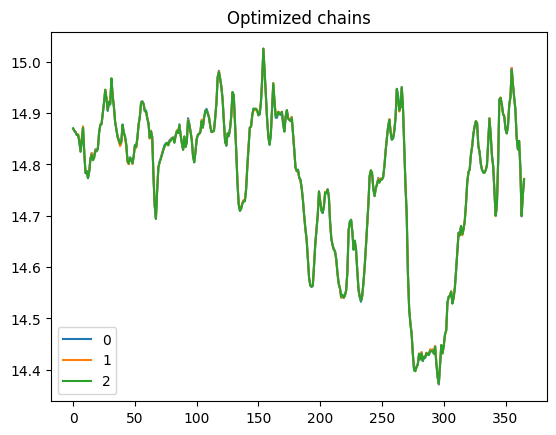

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.047    0.075        0.0      0.0     425.0    1019.0   
eps  0.119  0.006   0.108    0.132        0.0      0.0    2207.0    3492.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.047    0.076        0.0      0.0     407.0     705.0   
eps  0.120  0.006   0.108    0.132        0.0      0.0    2311.0    4556.0   

     r_hat  
sig   1.01  
eps   1.00  


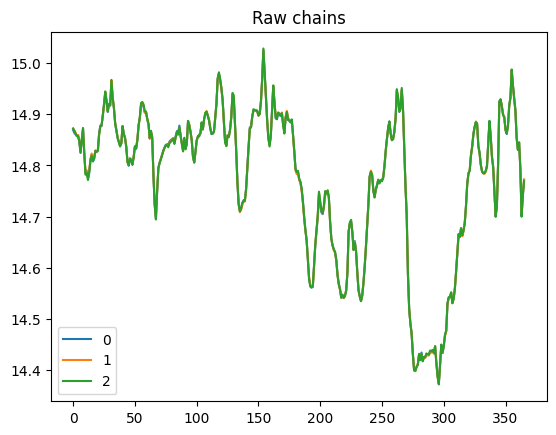

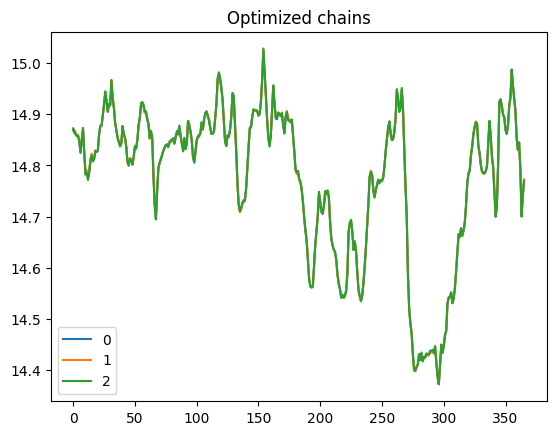

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.047    0.076        0.0      0.0     407.0     705.0   
eps  0.120  0.006   0.108    0.132        0.0      0.0    2311.0    4556.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.046    0.075        0.0      0.0     534.0     967.0   
eps  0.116  0.006   0.104    0.127        0.0      0.0    2204.0    3059.0   

     r_hat  
sig    1.0  
eps    1.0  


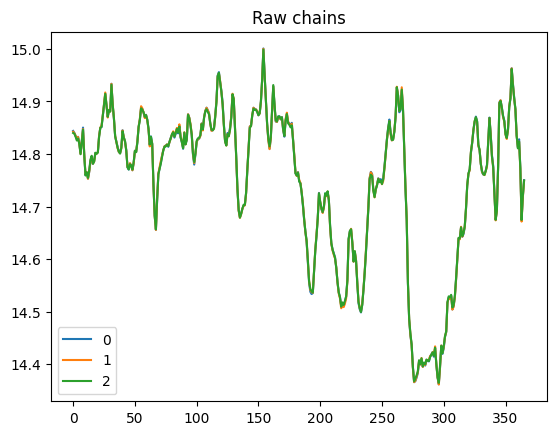

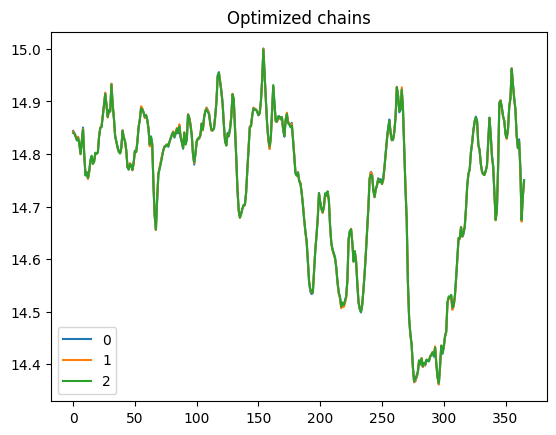

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.046    0.075        0.0      0.0     534.0     967.0   
eps  0.116  0.006   0.104    0.127        0.0      0.0    2204.0    3059.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 24 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.073        0.0      0.0     517.0    1049.0   
eps  0.115  0.006   0.103    0.125        0.0      0.0    2396.0    3847.0   

     r_hat  
sig    1.0  
eps    1.0  


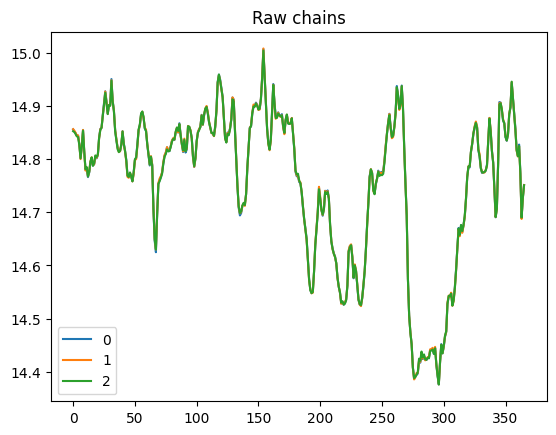

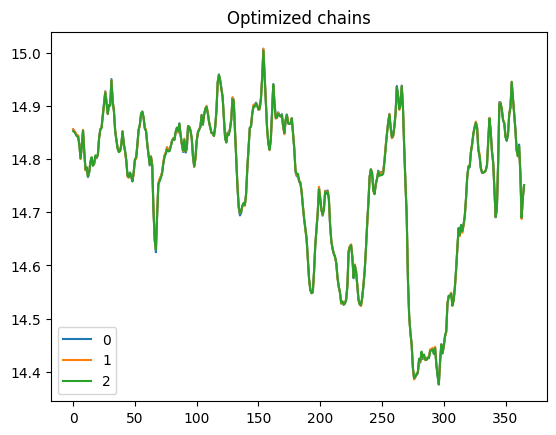

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.073        0.0      0.0     517.0    1049.0   
eps  0.115  0.006   0.103    0.125        0.0      0.0    2396.0    3847.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 25 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.047    0.076        0.0      0.0     361.0     684.0   
eps  0.116  0.006   0.104    0.127        0.0      0.0    1761.0    3653.0   

     r_hat  
sig    1.0  
eps    1.0  


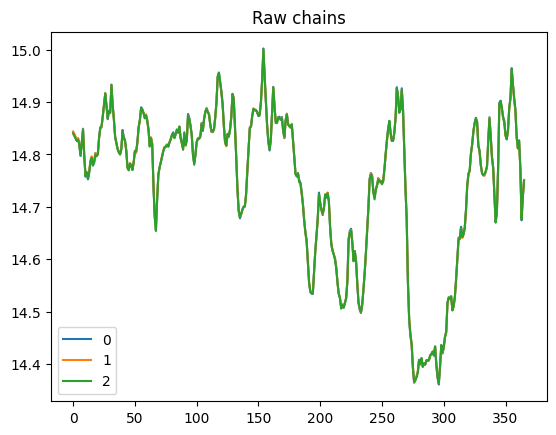

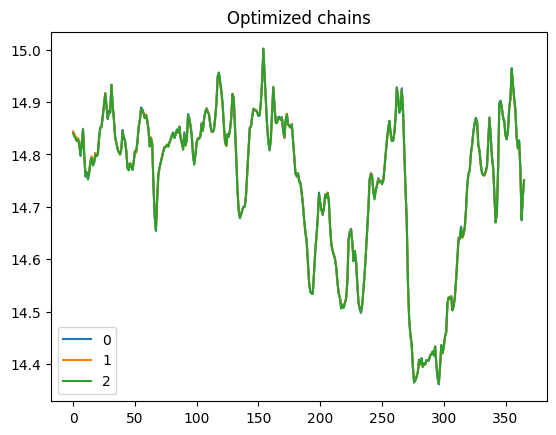

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.047    0.076        0.0      0.0     361.0     684.0   
eps  0.116  0.006   0.104    0.127        0.0      0.0    1761.0    3653.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 25 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.047    0.075        0.0      0.0     394.0    1199.0   
eps  0.121  0.006   0.109    0.133        0.0      0.0    2499.0    4109.0   

     r_hat  
sig    1.0  
eps    1.0  


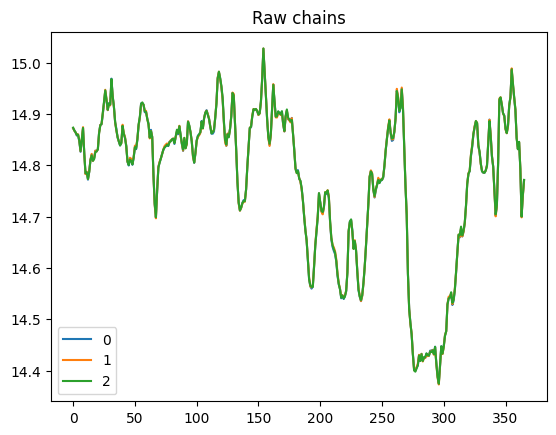

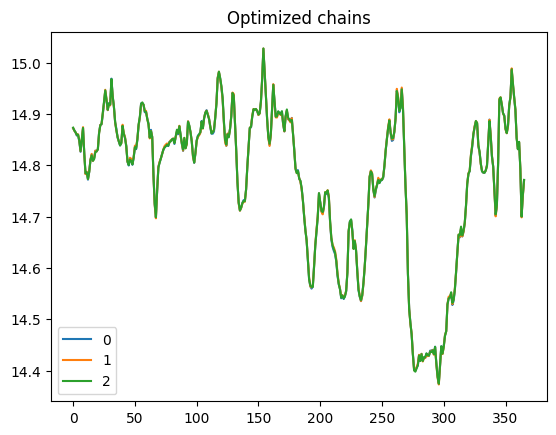

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.047    0.075        0.0      0.0     394.0    1199.0   
eps  0.121  0.006   0.109    0.133        0.0      0.0    2499.0    4109.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 24 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.049    0.079        0.0      0.0     414.0     987.0   
eps  0.129  0.007   0.117    0.142        0.0      0.0    2218.0    3970.0   

     r_hat  
sig    1.0  
eps    1.0  


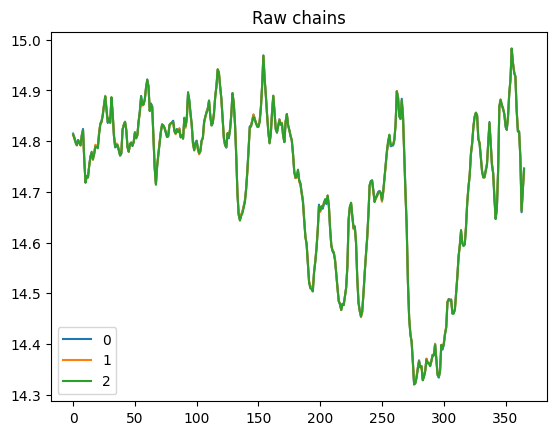

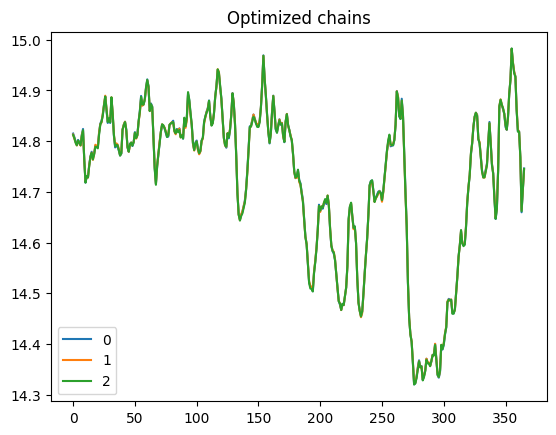

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.049    0.079        0.0      0.0     414.0     987.0   
eps  0.129  0.007   0.117    0.142        0.0      0.0    2218.0    3970.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 28 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.067  0.009   0.050    0.084      0.001      0.0     310.0     608.0   
eps  0.154  0.008   0.139    0.168      0.000      0.0    1770.0    3413.0   

     r_hat  
sig   1.01  
eps   1.00  


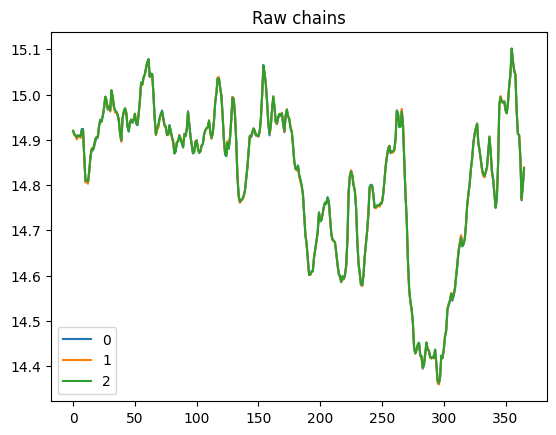

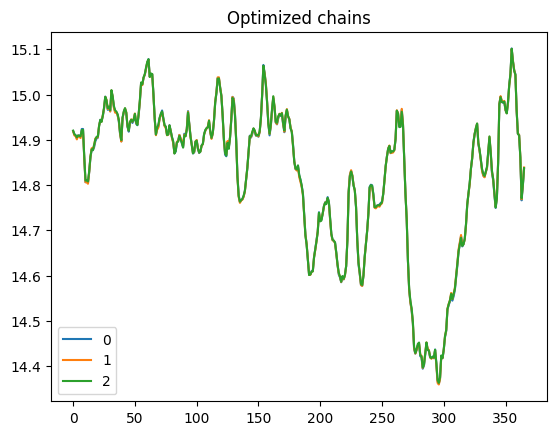

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.067  0.009   0.050    0.084      0.001      0.0     310.0     608.0   
eps  0.154  0.008   0.139    0.168      0.000      0.0    1770.0    3413.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 24 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.047    0.075        0.0      0.0     400.0     932.0   
eps  0.116  0.006   0.104    0.127        0.0      0.0    2120.0    3908.0   

     r_hat  
sig   1.01  
eps   1.00  


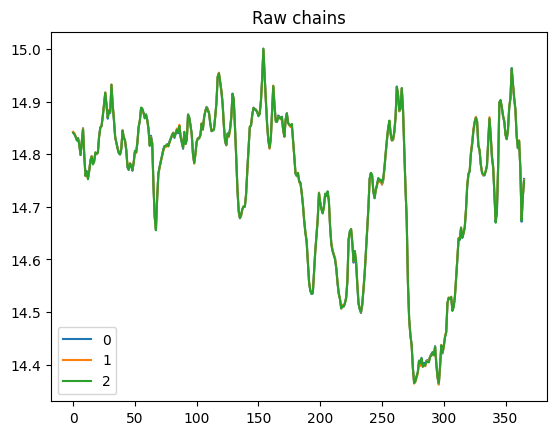

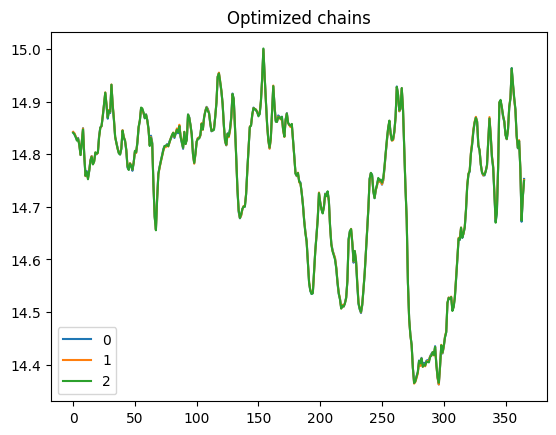

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.047    0.075        0.0      0.0     400.0     932.0   
eps  0.116  0.006   0.104    0.127        0.0      0.0    2120.0    3908.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.048    0.076        0.0      0.0     442.0     882.0   
eps  0.119  0.006   0.107    0.131        0.0      0.0    1993.0    3659.0   

     r_hat  
sig    1.0  
eps    1.0  


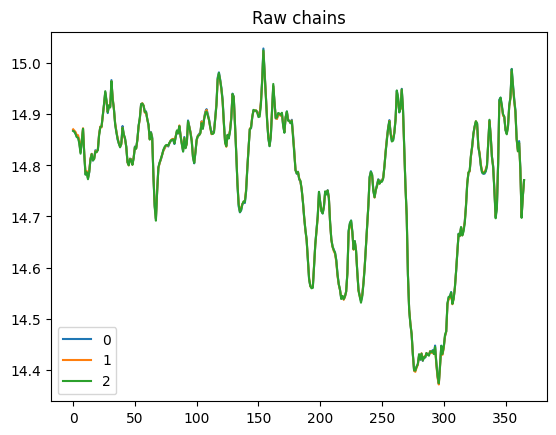

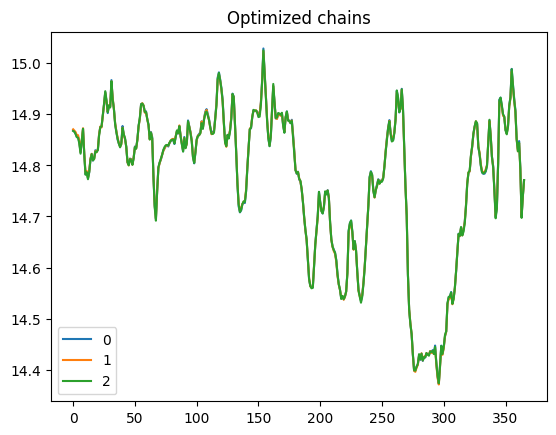

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.048    0.076        0.0      0.0     442.0     882.0   
eps  0.119  0.006   0.107    0.131        0.0      0.0    1993.0    3659.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 15 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.046  0.004   0.039    0.053        0.0      0.0    1257.0    2247.0   
eps  0.047  0.003   0.041    0.053        0.0      0.0    1531.0    2418.0   

     r_hat  
sig    1.0  
eps    1.0  


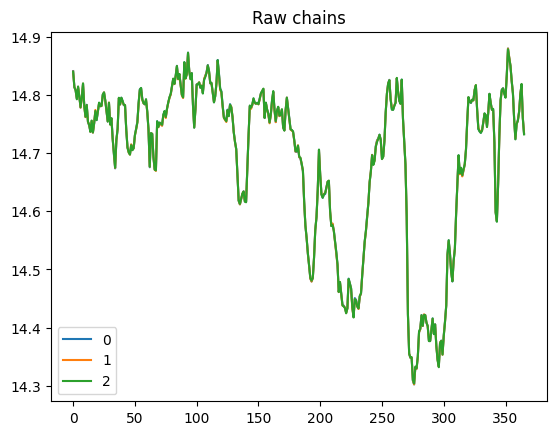

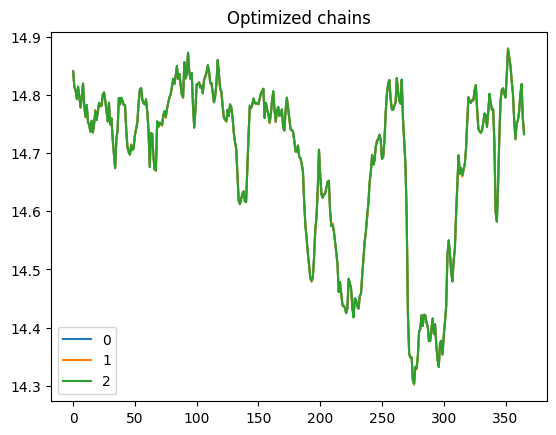

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.046  0.004   0.039    0.053        0.0      0.0    1257.0    2247.0   
eps  0.047  0.003   0.041    0.053        0.0      0.0    1531.0    2418.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.073        0.0      0.0     511.0    1047.0   
eps  0.112  0.006   0.100    0.123        0.0      0.0    1893.0    3197.0   

     r_hat  
sig   1.01  
eps   1.00  


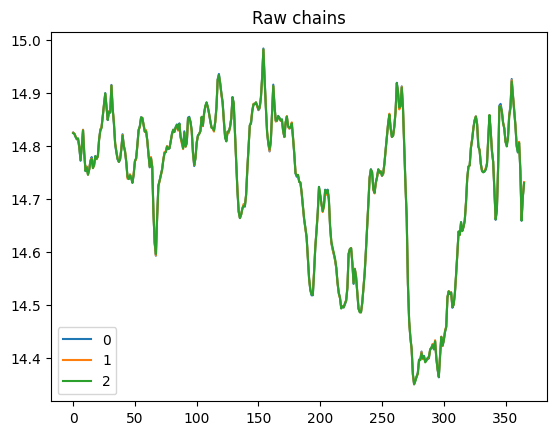

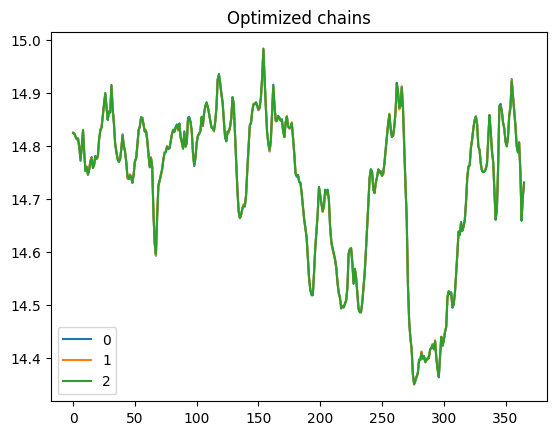

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.073        0.0      0.0     511.0    1047.0   
eps  0.112  0.006   0.100    0.123        0.0      0.0    1893.0    3197.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 25 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.074        0.0      0.0     410.0    1078.0   
eps  0.116  0.006   0.104    0.127        0.0      0.0    2510.0    4068.0   

     r_hat  
sig   1.01  
eps   1.00  


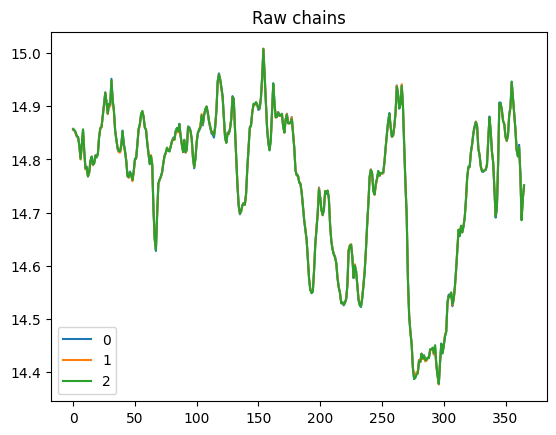

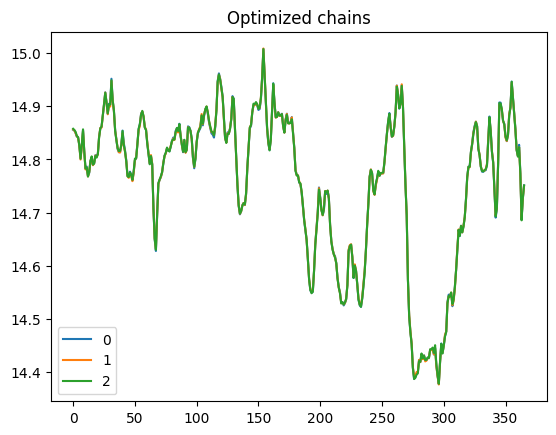

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.074        0.0      0.0     410.0    1078.0   
eps  0.116  0.006   0.104    0.127        0.0      0.0    2510.0    4068.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 32 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.067  0.009   0.050    0.083        0.0      0.0     376.0    1040.0   
eps  0.153  0.008   0.139    0.168        0.0      0.0    2226.0    3436.0   

     r_hat  
sig   1.01  
eps   1.00  


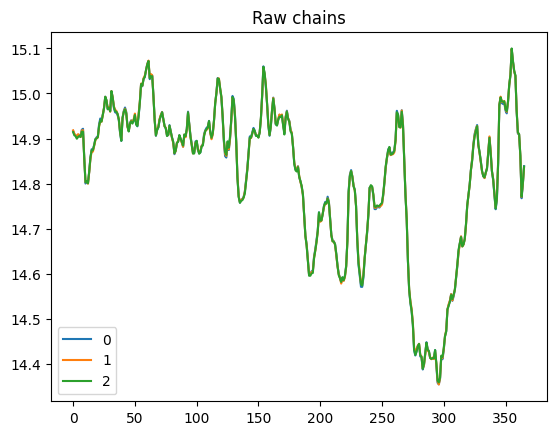

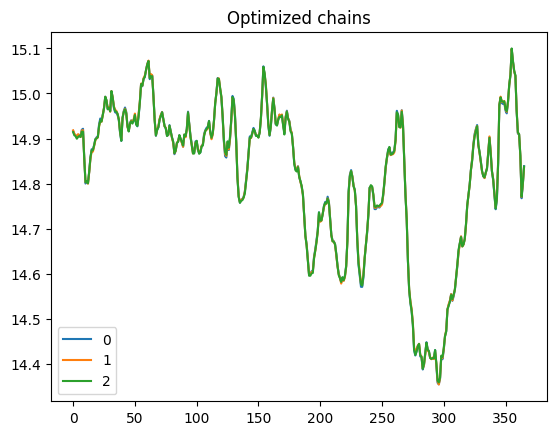

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.067  0.009   0.050    0.083        0.0      0.0     376.0    1040.0   
eps  0.153  0.008   0.139    0.168        0.0      0.0    2226.0    3436.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.046    0.075        0.0      0.0     354.0     718.0   
eps  0.116  0.006   0.105    0.128        0.0      0.0    1781.0    3899.0   

     r_hat  
sig   1.01  
eps   1.00  


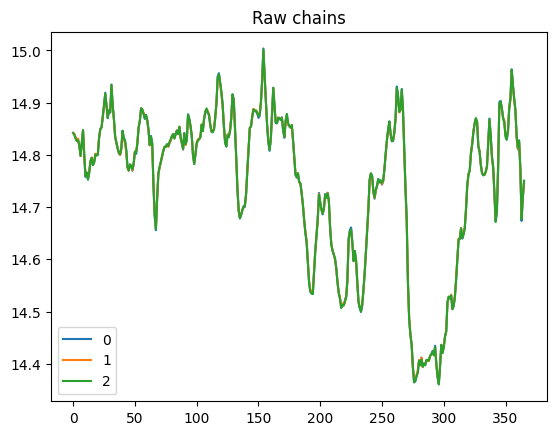

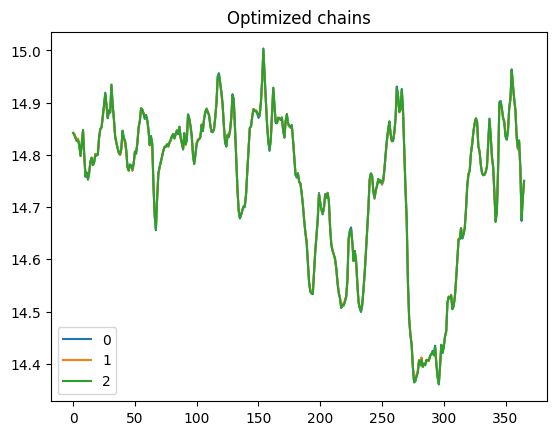

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.046    0.075        0.0      0.0     354.0     718.0   
eps  0.116  0.006   0.105    0.128        0.0      0.0    1781.0    3899.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 11 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.048  0.004   0.041    0.055        0.0      0.0    1614.0    2854.0   
eps  0.045  0.003   0.039    0.051        0.0      0.0    1808.0    3066.0   

     r_hat  
sig    1.0  
eps    1.0  


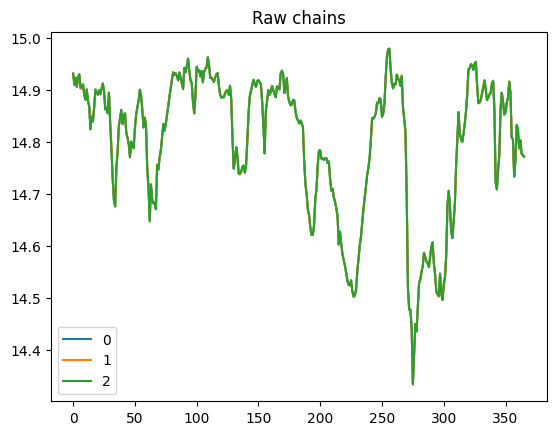

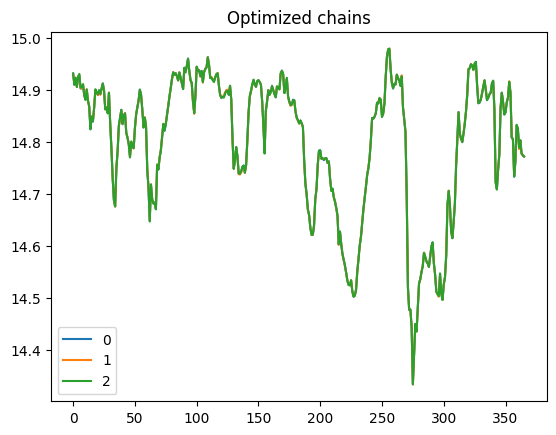

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.048  0.004   0.041    0.055        0.0      0.0    1614.0    2854.0   
eps  0.045  0.003   0.039    0.051        0.0      0.0    1808.0    3066.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 11 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.046  0.004   0.039    0.053        0.0      0.0    1602.0    2498.0   
eps  0.044  0.003   0.039    0.050        0.0      0.0    1905.0    2992.0   

     r_hat  
sig    1.0  
eps    1.0  


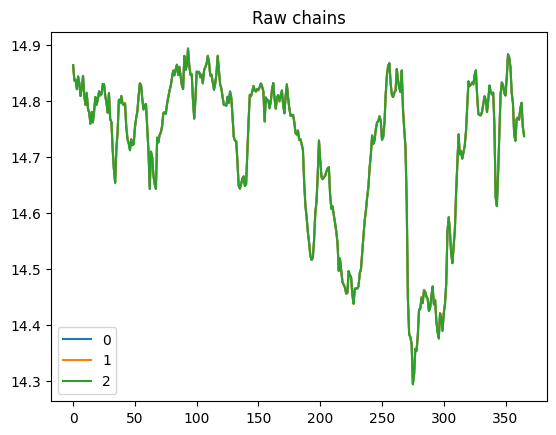

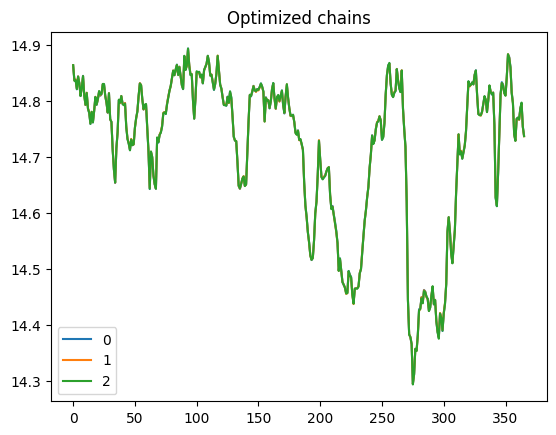

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.046  0.004   0.039    0.053        0.0      0.0    1602.0    2498.0   
eps  0.044  0.003   0.039    0.050        0.0      0.0    1905.0    2992.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.063  0.008   0.048    0.078        0.0      0.0     439.0    1040.0   
eps  0.127  0.007   0.115    0.140        0.0      0.0    2177.0    3696.0   

     r_hat  
sig    1.0  
eps    1.0  


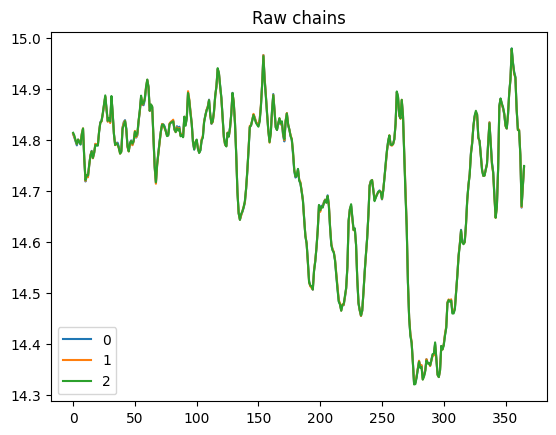

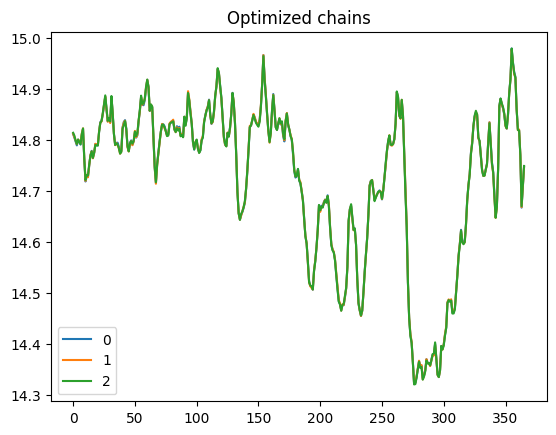

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.063  0.008   0.048    0.078        0.0      0.0     439.0    1040.0   
eps  0.127  0.007   0.115    0.140        0.0      0.0    2177.0    3696.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.049    0.079        0.0      0.0     384.0     625.0   
eps  0.127  0.007   0.114    0.139        0.0      0.0    1585.0    3398.0   

     r_hat  
sig   1.01  
eps   1.00  


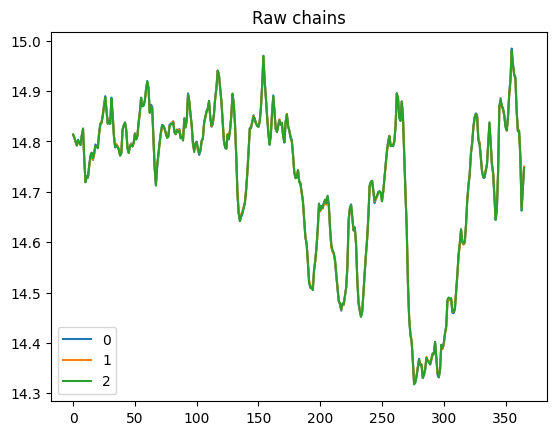

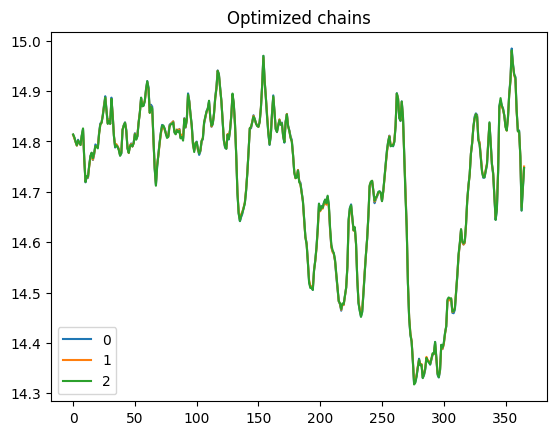

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.049    0.079        0.0      0.0     384.0     625.0   
eps  0.127  0.007   0.114    0.139        0.0      0.0    1585.0    3398.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.048    0.078        0.0      0.0     405.0     669.0   
eps  0.127  0.007   0.115    0.140        0.0      0.0    1973.0    3368.0   

     r_hat  
sig    1.0  
eps    1.0  


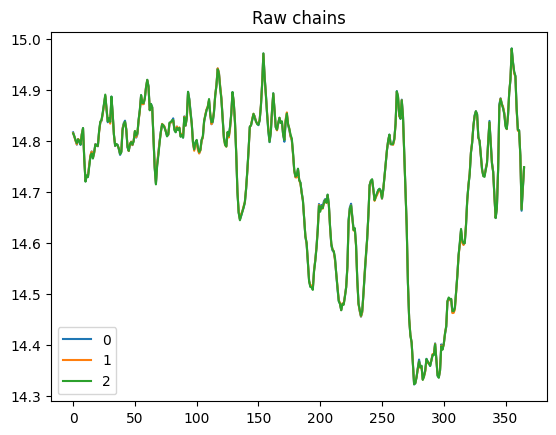

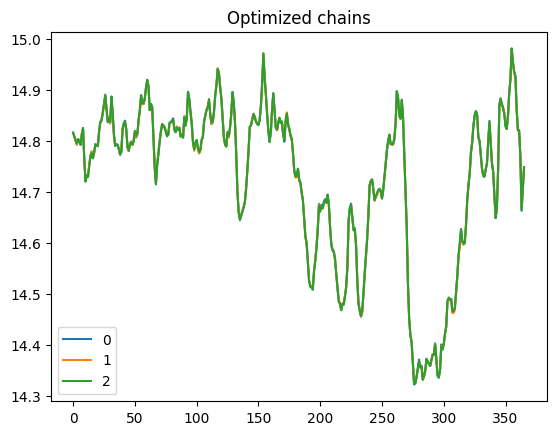

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.048    0.078        0.0      0.0     405.0     669.0   
eps  0.127  0.007   0.115    0.140        0.0      0.0    1973.0    3368.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.075        0.0      0.0     481.0     869.0   
eps  0.115  0.006   0.103    0.126        0.0      0.0    2434.0    3822.0   

     r_hat  
sig    1.0  
eps    1.0  


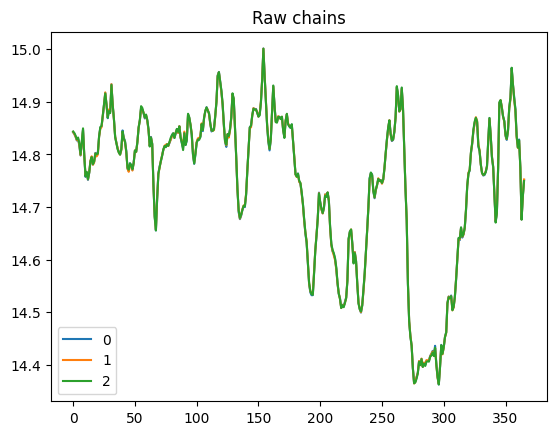

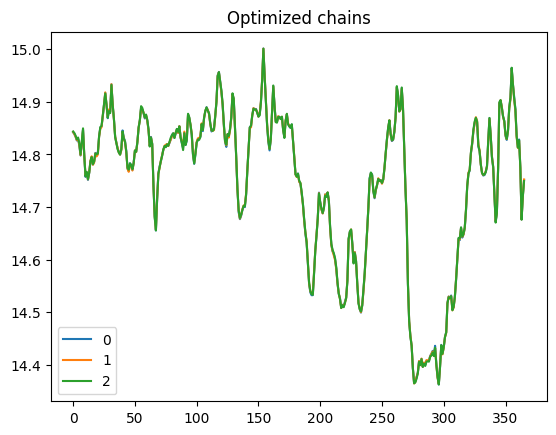

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.075        0.0      0.0     481.0     869.0   
eps  0.115  0.006   0.103    0.126        0.0      0.0    2434.0    3822.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 28 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.049    0.078        0.0      0.0     457.0    1094.0   
eps  0.127  0.006   0.115    0.139        0.0      0.0    1887.0    3016.0   

     r_hat  
sig   1.01  
eps   1.00  


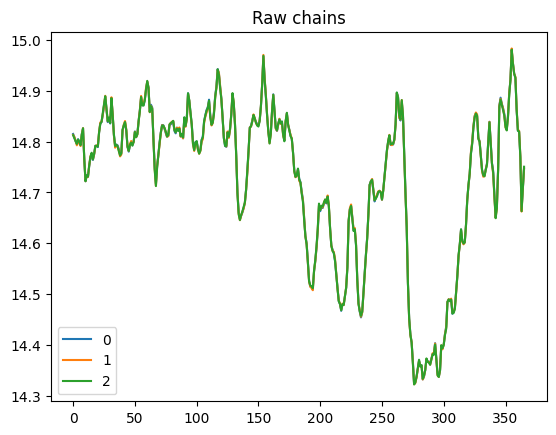

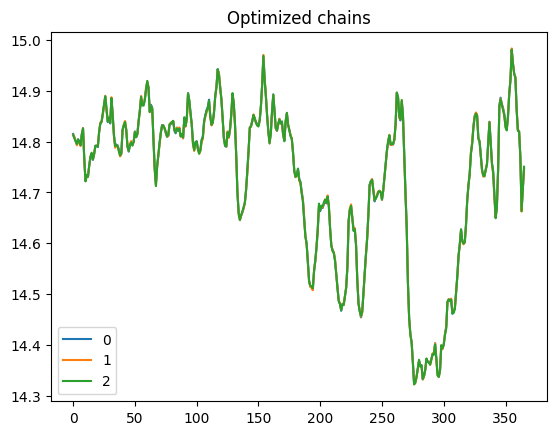

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.049    0.078        0.0      0.0     457.0    1094.0   
eps  0.127  0.006   0.115    0.139        0.0      0.0    1887.0    3016.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.074        0.0      0.0     434.0    1003.0   
eps  0.116  0.006   0.105    0.128        0.0      0.0    2199.0    3768.0   

     r_hat  
sig   1.01  
eps   1.00  


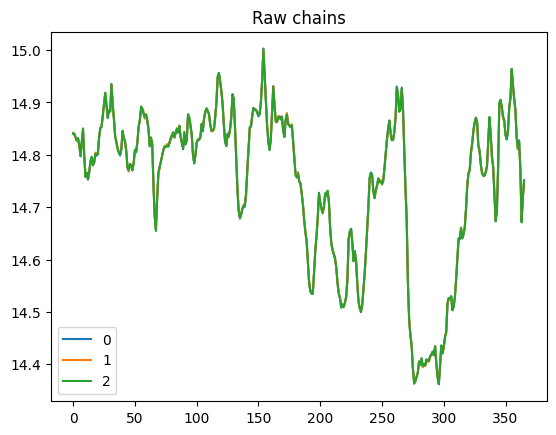

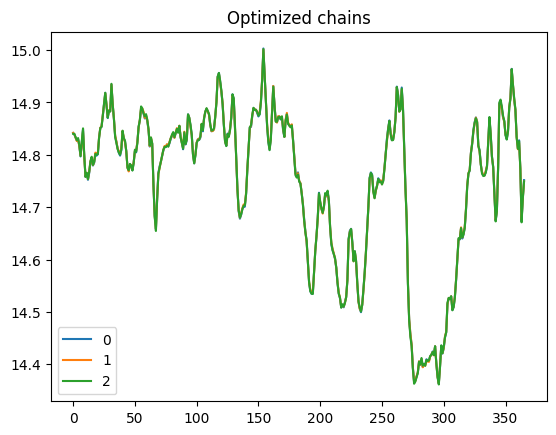

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.074        0.0      0.0     434.0    1003.0   
eps  0.116  0.006   0.105    0.128        0.0      0.0    2199.0    3768.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 25 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.048    0.076        0.0      0.0     537.0    1038.0   
eps  0.115  0.006   0.103    0.126        0.0      0.0    2282.0    3574.0   

     r_hat  
sig    1.0  
eps    1.0  


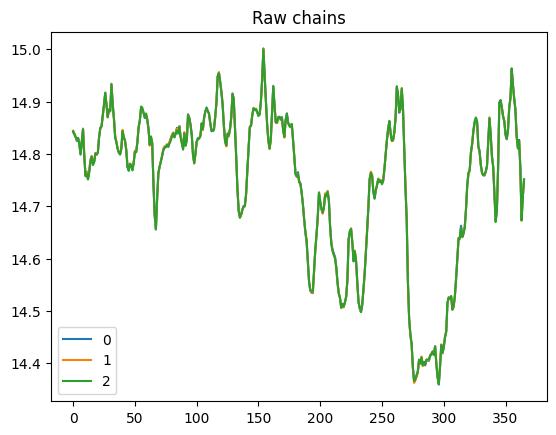

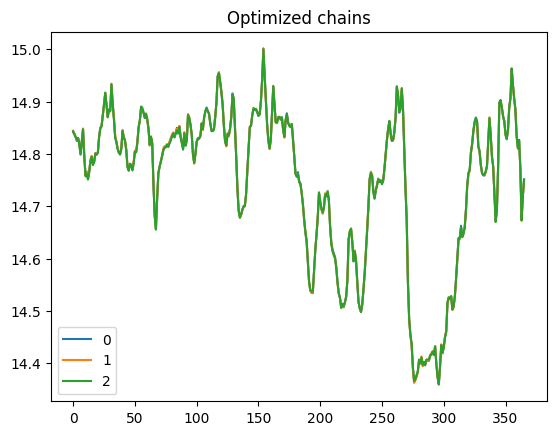

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.048    0.076        0.0      0.0     537.0    1038.0   
eps  0.115  0.006   0.103    0.126        0.0      0.0    2282.0    3574.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.062  0.007   0.048    0.075        0.0      0.0     339.0     742.0   
eps  0.120  0.006   0.108    0.132        0.0      0.0    1795.0    2881.0   

     r_hat  
sig   1.01  
eps   1.00  


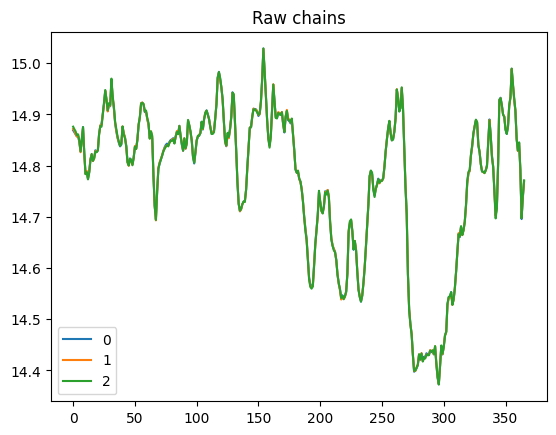

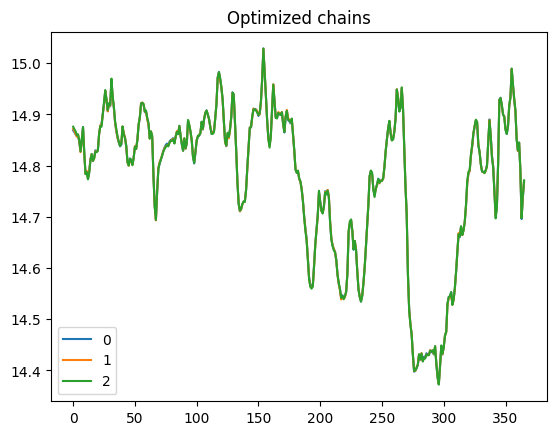

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.062  0.007   0.048    0.075        0.0      0.0     339.0     742.0   
eps  0.120  0.006   0.108    0.132        0.0      0.0    1795.0    2881.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.062  0.007   0.050    0.076        0.0      0.0     527.0    1348.0   
eps  0.104  0.006   0.093    0.115        0.0      0.0    2261.0    3676.0   

     r_hat  
sig   1.01  
eps   1.00  


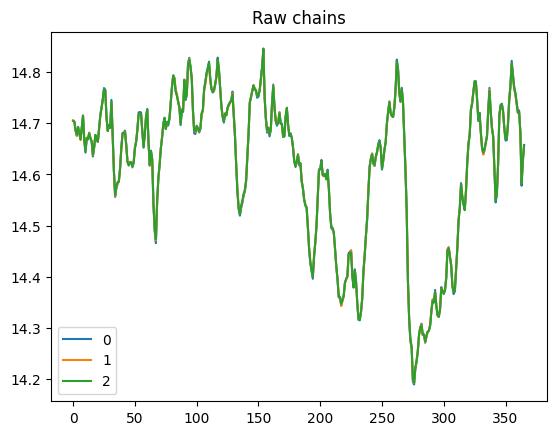

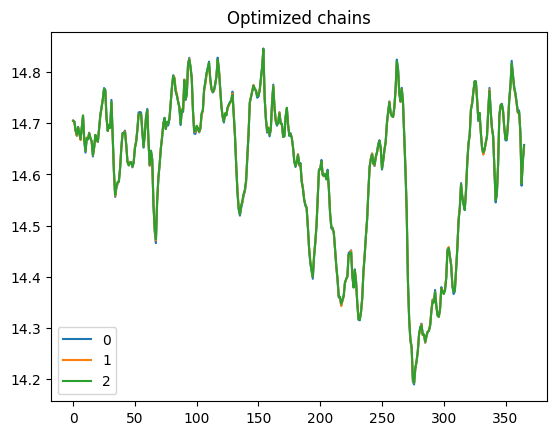

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.062  0.007   0.050    0.076        0.0      0.0     527.0    1348.0   
eps  0.104  0.006   0.093    0.115        0.0      0.0    2261.0    3676.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.008   0.046    0.074        0.0      0.0     436.0    1082.0   
eps  0.116  0.006   0.104    0.128        0.0      0.0    2094.0    3971.0   

     r_hat  
sig   1.01  
eps   1.00  


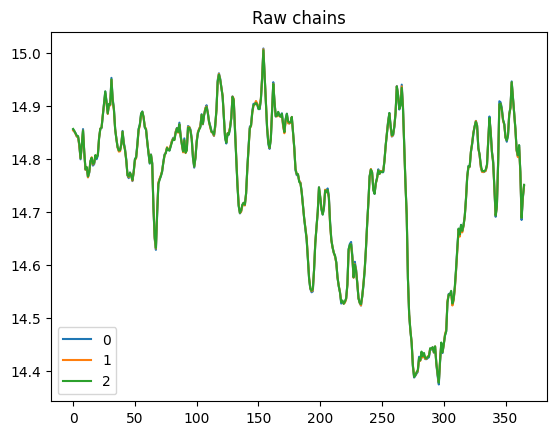

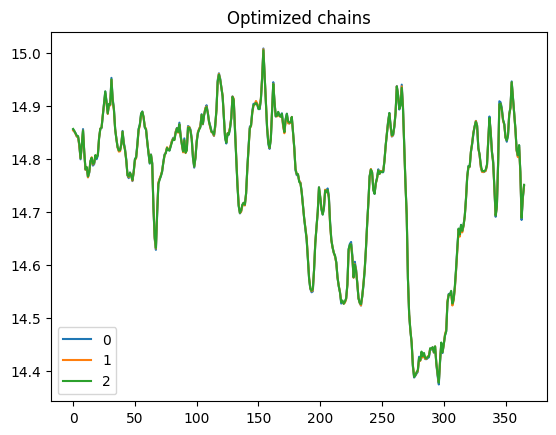

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.008   0.046    0.074        0.0      0.0     436.0    1082.0   
eps  0.116  0.006   0.104    0.128        0.0      0.0    2094.0    3971.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.075        0.0      0.0     455.0    1071.0   
eps  0.116  0.006   0.104    0.127        0.0      0.0    2054.0    4173.0   

     r_hat  
sig    1.0  
eps    1.0  


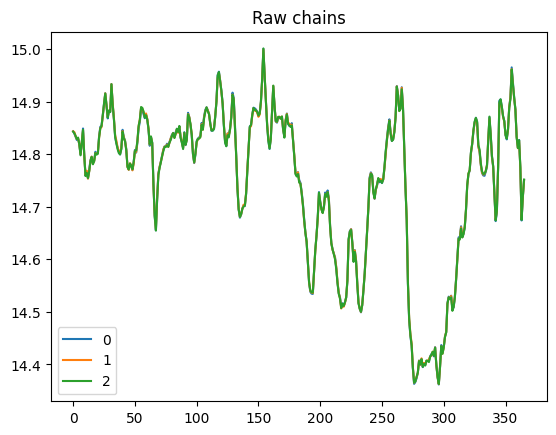

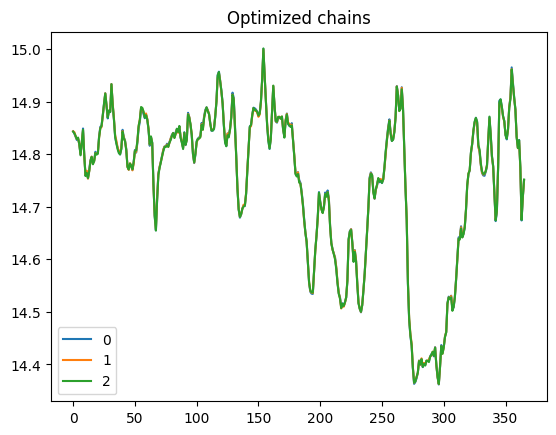

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.075        0.0      0.0     455.0    1071.0   
eps  0.116  0.006   0.104    0.127        0.0      0.0    2054.0    4173.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.062  0.008   0.048    0.076        0.0      0.0     497.0    1031.0   
eps  0.120  0.006   0.108    0.132        0.0      0.0    2716.0    3396.0   

     r_hat  
sig    1.0  
eps    1.0  


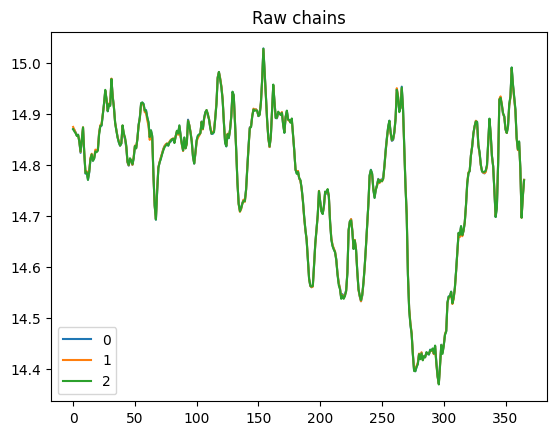

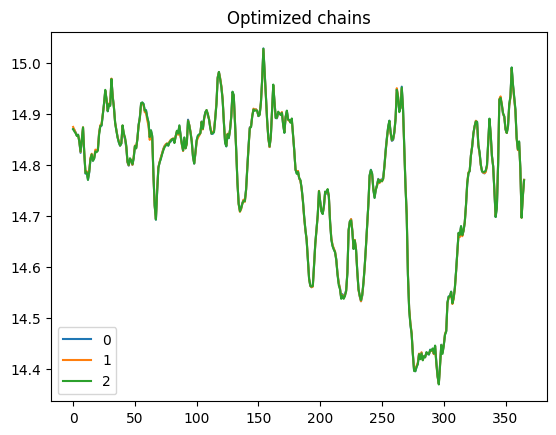

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.062  0.008   0.048    0.076        0.0      0.0     497.0    1031.0   
eps  0.120  0.006   0.108    0.132        0.0      0.0    2716.0    3396.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
     mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.06  0.007   0.048    0.074        0.0      0.0     576.0    1309.0   
eps  0.11  0.006   0.099    0.121        0.0      0.0    2677.0    4365.0   

     r_hat  
sig    1.0  
eps    1.0  


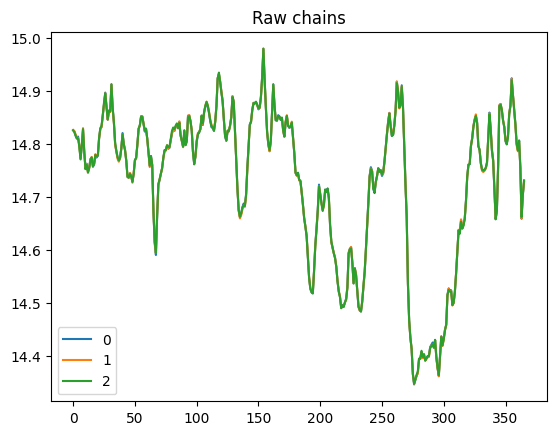

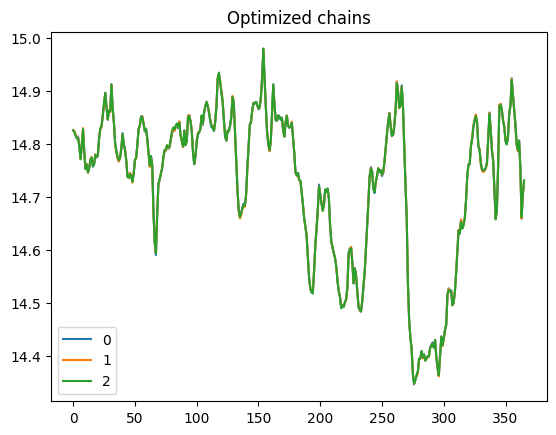

Best chain combination summary:
     mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.06  0.007   0.048    0.074        0.0      0.0     576.0    1309.0   
eps  0.11  0.006   0.099    0.121        0.0      0.0    2677.0    4365.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.065  0.007   0.052    0.079        0.0      0.0     613.0    1504.0   
eps  0.115  0.006   0.103    0.126        0.0      0.0    2669.0    3560.0   

     r_hat  
sig    1.0  
eps    1.0  


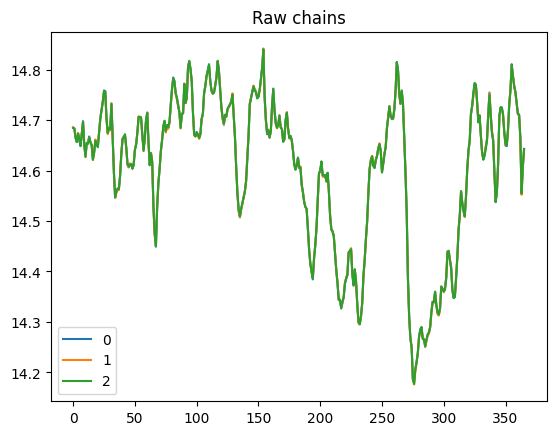

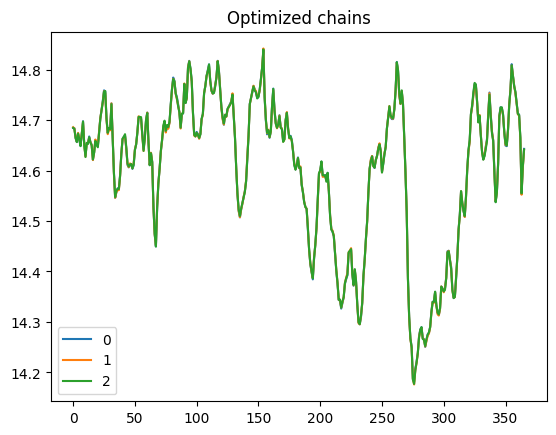

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.065  0.007   0.052    0.079        0.0      0.0     613.0    1504.0   
eps  0.115  0.006   0.103    0.126        0.0      0.0    2669.0    3560.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.047    0.075        0.0      0.0     436.0     992.0   
eps  0.120  0.006   0.108    0.132        0.0      0.0    1970.0    3190.0   

     r_hat  
sig    1.0  
eps    1.0  


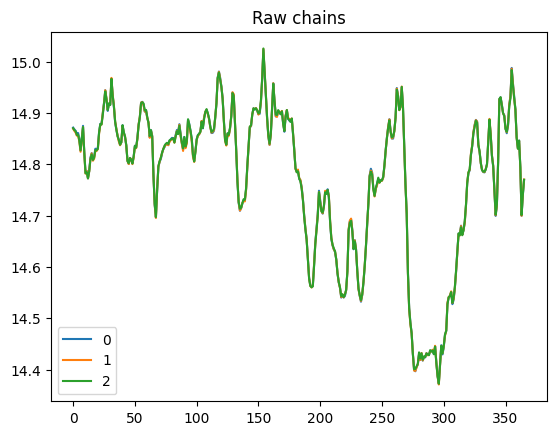

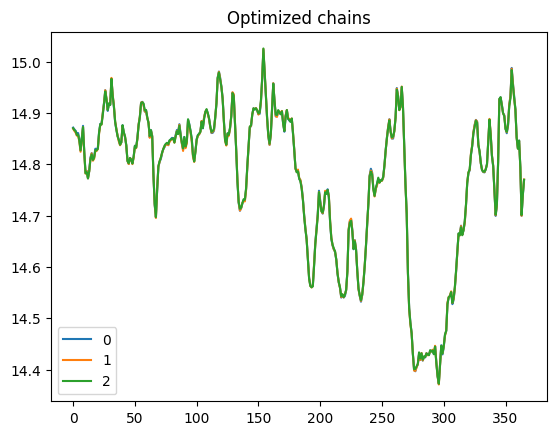

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.047    0.075        0.0      0.0     436.0     992.0   
eps  0.120  0.006   0.108    0.132        0.0      0.0    1970.0    3190.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.075        0.0      0.0     379.0     898.0   
eps  0.119  0.006   0.107    0.130        0.0      0.0    2452.0    3799.0   

     r_hat  
sig   1.01  
eps   1.00  


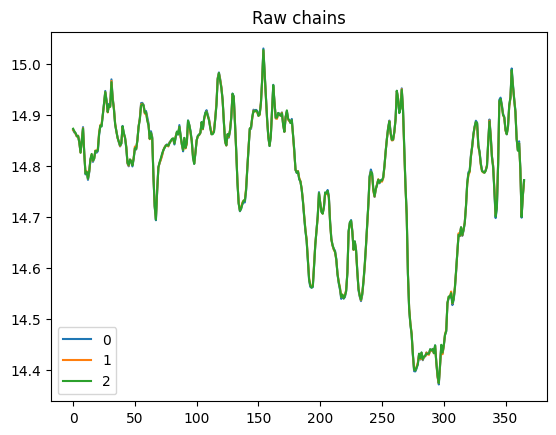

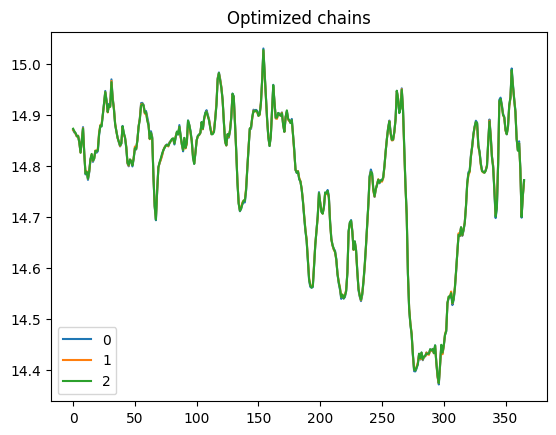

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.075        0.0      0.0     379.0     898.0   
eps  0.119  0.006   0.107    0.130        0.0      0.0    2452.0    3799.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 11 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.047  0.004   0.040    0.055        0.0      0.0    1236.0    1836.0   
eps  0.048  0.003   0.042    0.054        0.0      0.0    1837.0    2920.0   

     r_hat  
sig    1.0  
eps    1.0  


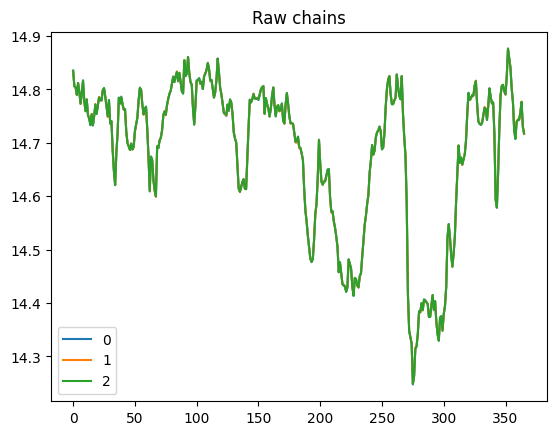

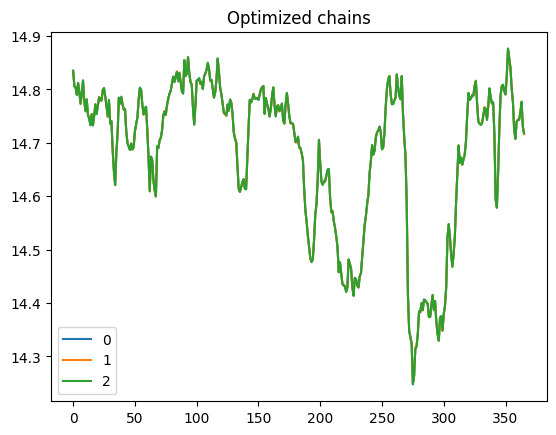

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.047  0.004   0.040    0.055        0.0      0.0    1236.0    1836.0   
eps  0.048  0.003   0.042    0.054        0.0      0.0    1837.0    2920.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 28 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.068  0.009   0.051    0.085        0.0      0.0     349.0     702.0   
eps  0.158  0.008   0.144    0.172        0.0      0.0    1922.0    3445.0   

     r_hat  
sig   1.01  
eps   1.00  


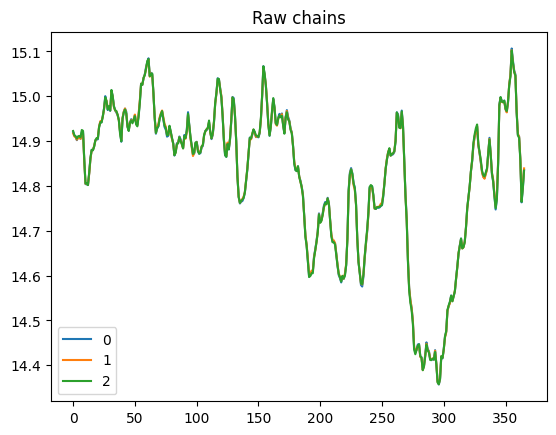

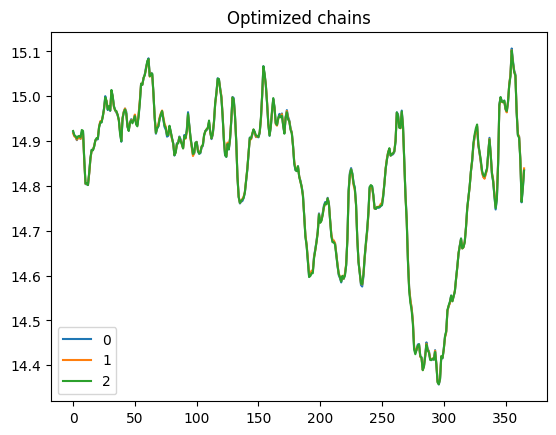

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.068  0.009   0.051    0.085        0.0      0.0     349.0     702.0   
eps  0.158  0.008   0.144    0.172        0.0      0.0    1922.0    3445.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.008   0.047    0.075        0.0      0.0     417.0    1040.0   
eps  0.114  0.006   0.103    0.125        0.0      0.0    2202.0    3853.0   

     r_hat  
sig   1.01  
eps   1.00  


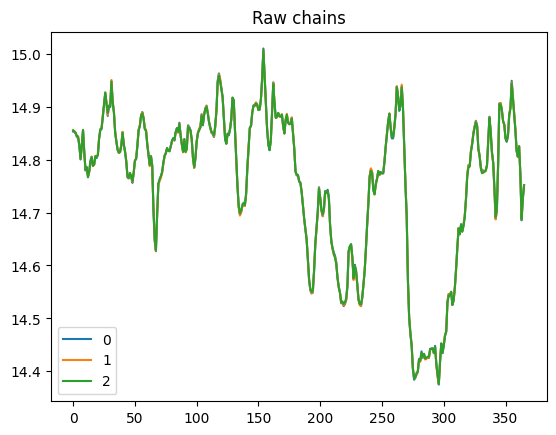

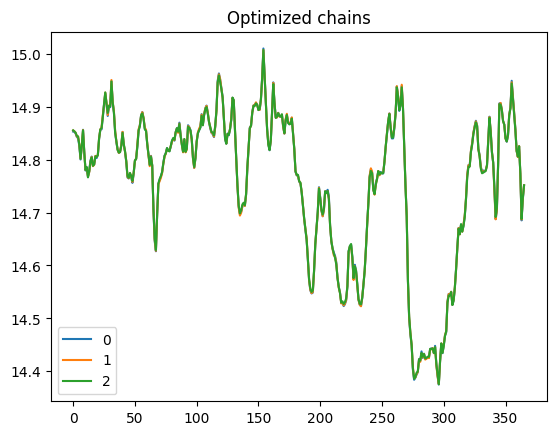

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.008   0.047    0.075        0.0      0.0     417.0    1040.0   
eps  0.114  0.006   0.103    0.125        0.0      0.0    2202.0    3853.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.008   0.047    0.075        0.0      0.0     436.0     997.0   
eps  0.114  0.006   0.102    0.124        0.0      0.0    2243.0    3879.0   

     r_hat  
sig   1.01  
eps   1.00  


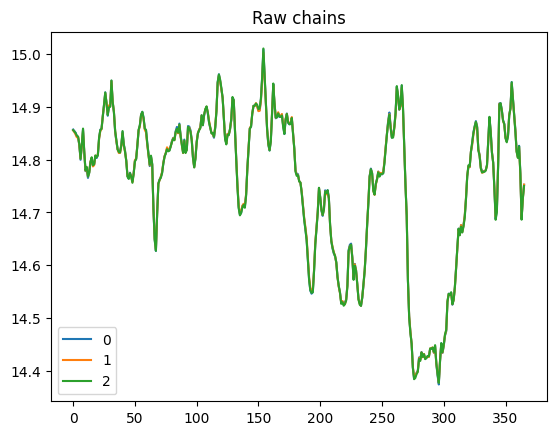

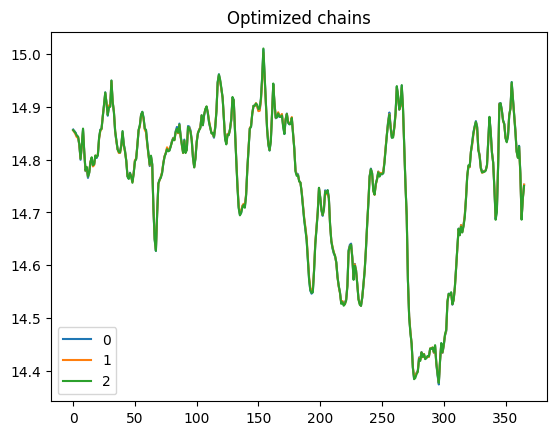

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.008   0.047    0.075        0.0      0.0     436.0     997.0   
eps  0.114  0.006   0.102    0.124        0.0      0.0    2243.0    3879.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.049    0.078        0.0      0.0     311.0     910.0   
eps  0.127  0.007   0.115    0.140        0.0      0.0    2377.0    3533.0   

     r_hat  
sig   1.01  
eps   1.00  


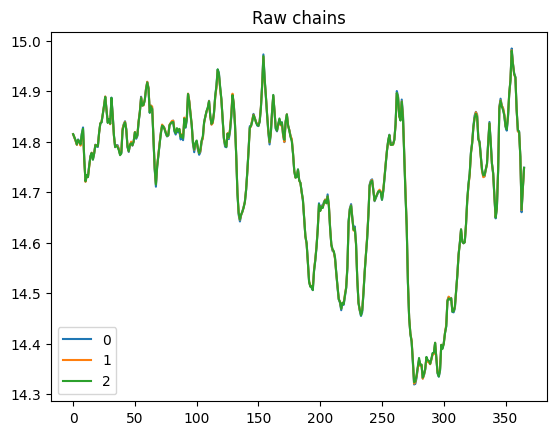

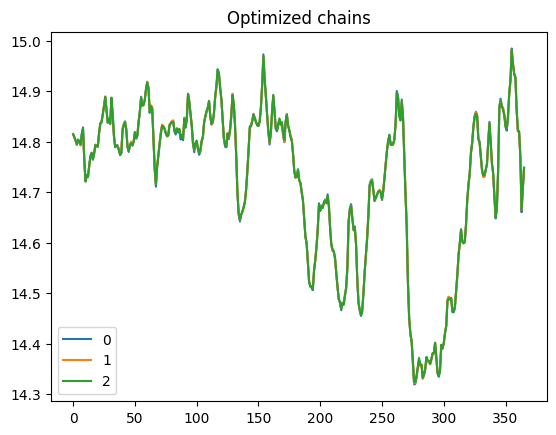

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.049    0.078        0.0      0.0     311.0     910.0   
eps  0.127  0.007   0.115    0.140        0.0      0.0    2377.0    3533.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.059  0.007   0.045    0.073        0.0      0.0     444.0     896.0   
eps  0.115  0.006   0.103    0.126        0.0      0.0    2128.0    4400.0   

     r_hat  
sig    1.0  
eps    1.0  


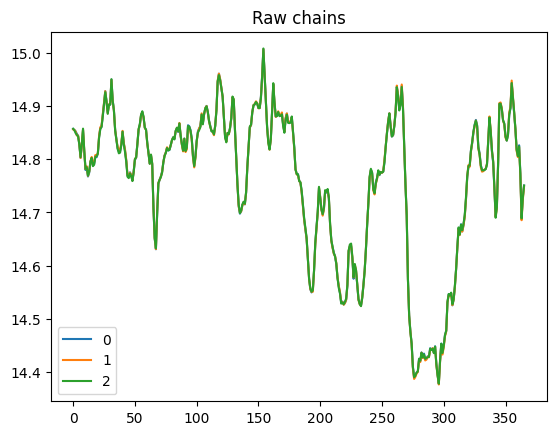

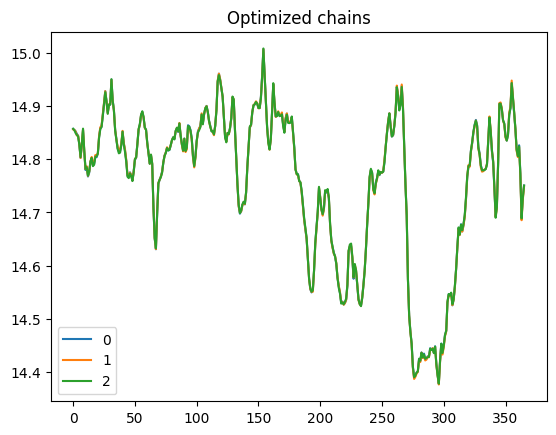

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.059  0.007   0.045    0.073        0.0      0.0     444.0     896.0   
eps  0.115  0.006   0.103    0.126        0.0      0.0    2128.0    4400.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.075        0.0      0.0     505.0    1179.0   
eps  0.110  0.006   0.100    0.122        0.0      0.0    2195.0    3736.0   

     r_hat  
sig   1.01  
eps   1.00  


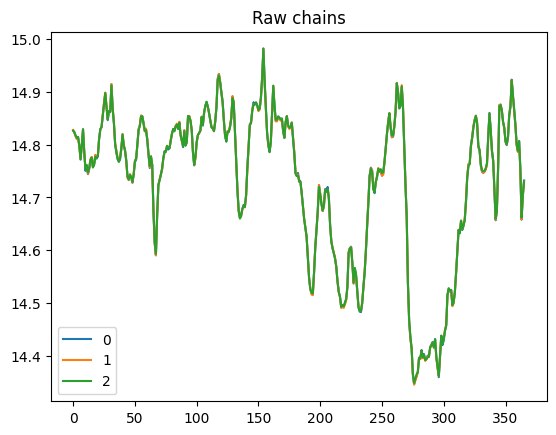

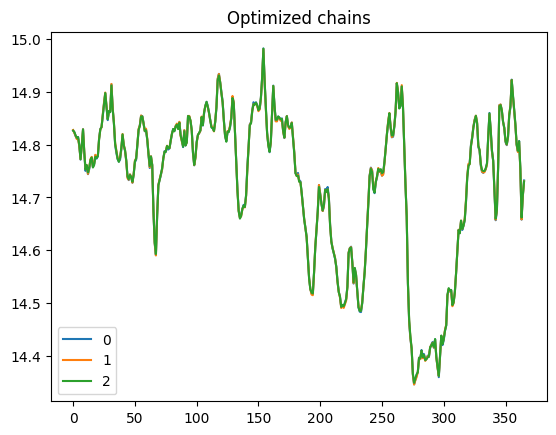

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.075        0.0      0.0     505.0    1179.0   
eps  0.110  0.006   0.100    0.122        0.0      0.0    2195.0    3736.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 27 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.068  0.009   0.051    0.084        0.0      0.0     465.0     998.0   
eps  0.158  0.008   0.143    0.172        0.0      0.0    2386.0    4282.0   

     r_hat  
sig   1.01  
eps   1.00  


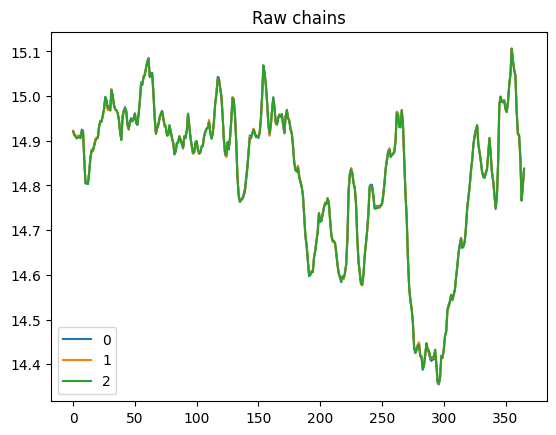

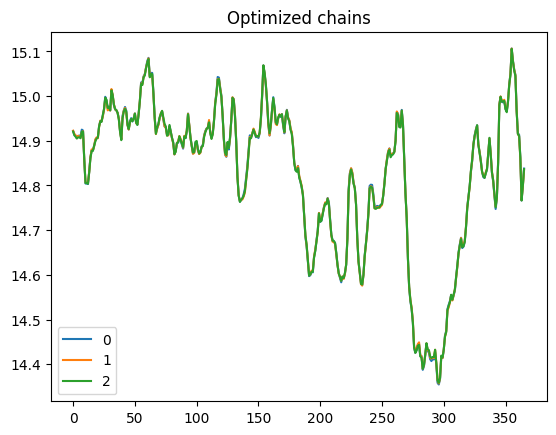

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.068  0.009   0.051    0.084        0.0      0.0     465.0     998.0   
eps  0.158  0.008   0.143    0.172        0.0      0.0    2386.0    4282.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 30 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.068  0.009   0.051    0.084      0.001      0.0     278.0     809.0   
eps  0.163  0.008   0.148    0.178      0.000      0.0    1831.0    3605.0   

     r_hat  
sig   1.01  
eps   1.00  


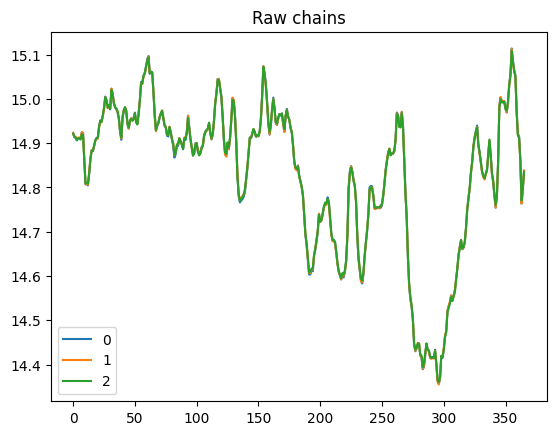

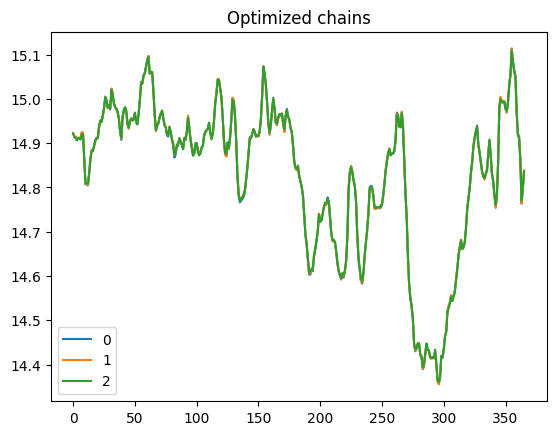

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.068  0.009   0.051    0.084      0.001      0.0     278.0     809.0   
eps  0.163  0.008   0.148    0.178      0.000      0.0    1831.0    3605.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.008   0.046    0.074        0.0      0.0     280.0     661.0   
eps  0.116  0.006   0.105    0.128        0.0      0.0    1819.0    3970.0   

     r_hat  
sig   1.01  
eps   1.00  


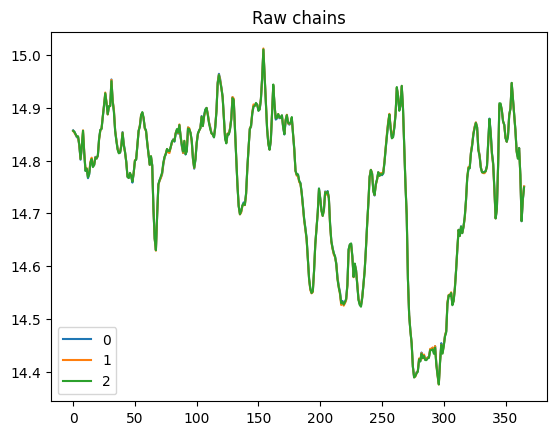

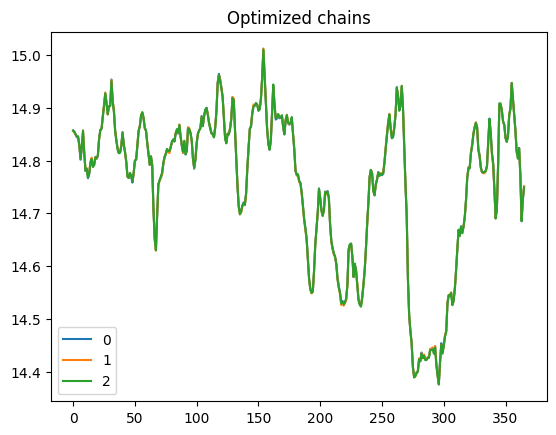

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.008   0.046    0.074        0.0      0.0     280.0     661.0   
eps  0.116  0.006   0.105    0.128        0.0      0.0    1819.0    3970.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.049    0.080        0.0      0.0     380.0     894.0   
eps  0.129  0.007   0.117    0.142        0.0      0.0    1967.0    4011.0   

     r_hat  
sig   1.01  
eps   1.00  


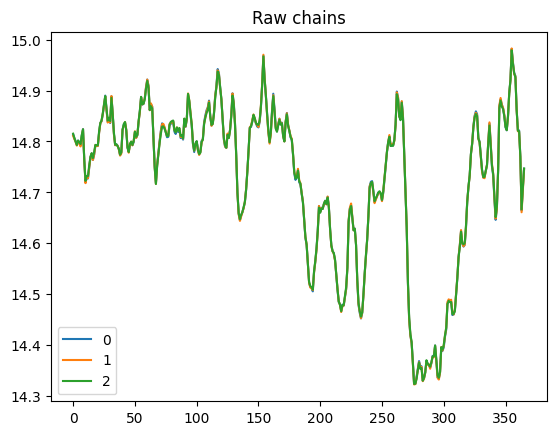

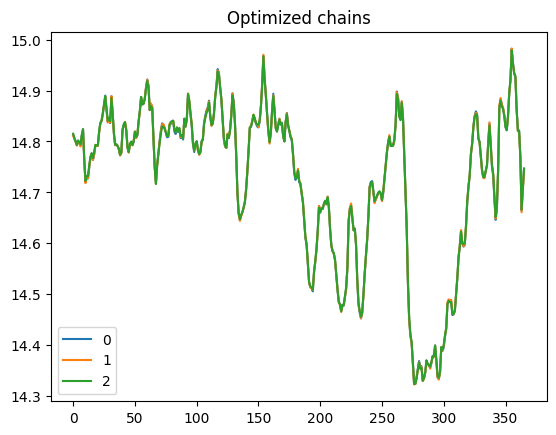

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.049    0.080        0.0      0.0     380.0     894.0   
eps  0.129  0.007   0.117    0.142        0.0      0.0    1967.0    4011.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 31 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.066  0.009   0.050    0.085      0.001      0.0     291.0     538.0   
eps  0.154  0.008   0.139    0.168      0.000      0.0    1836.0    3477.0   

     r_hat  
sig   1.01  
eps   1.00  


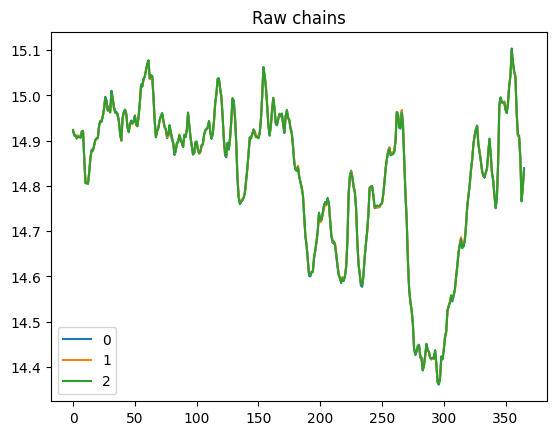

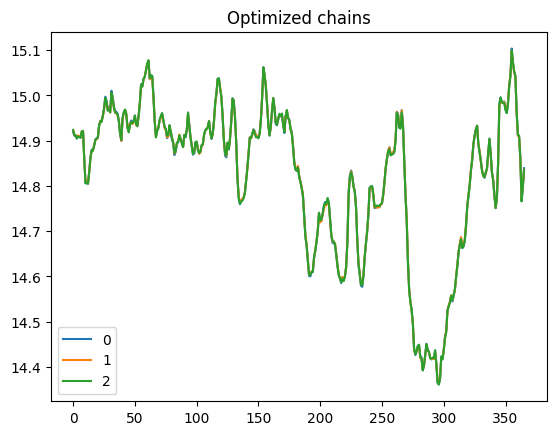

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.066  0.009   0.050    0.085      0.001      0.0     291.0     538.0   
eps  0.154  0.008   0.139    0.168      0.000      0.0    1836.0    3477.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 24 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.074        0.0      0.0     261.0     747.0   
eps  0.111  0.006   0.100    0.123        0.0      0.0    1926.0    3556.0   

     r_hat  
sig   1.01  
eps   1.00  


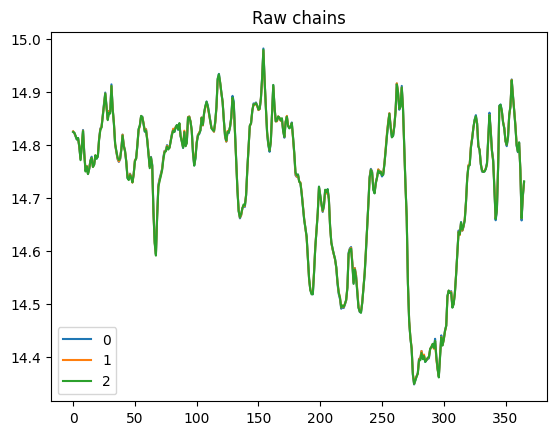

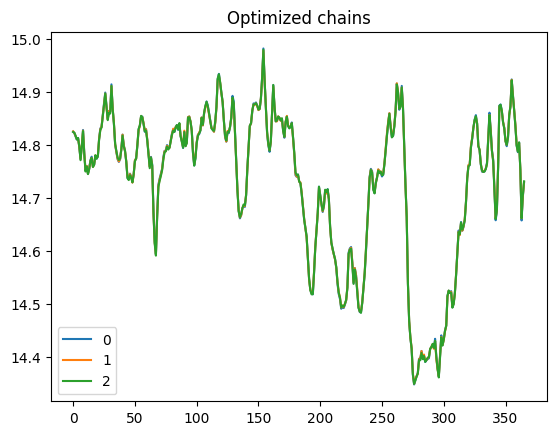

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.074        0.0      0.0     261.0     747.0   
eps  0.111  0.006   0.100    0.123        0.0      0.0    1926.0    3556.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.063  0.007   0.049    0.076        0.0      0.0     558.0    1287.0   
eps  0.104  0.006   0.093    0.115        0.0      0.0    2098.0    3604.0   

     r_hat  
sig   1.01  
eps   1.00  


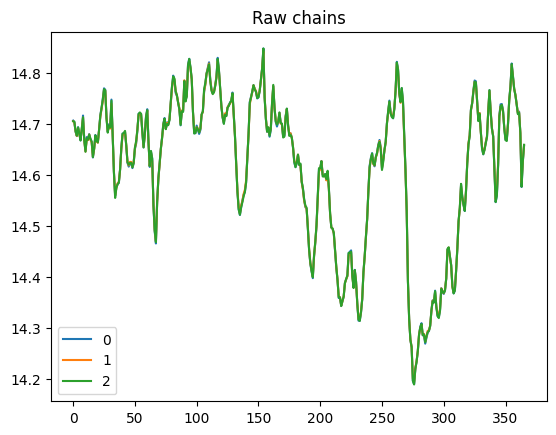

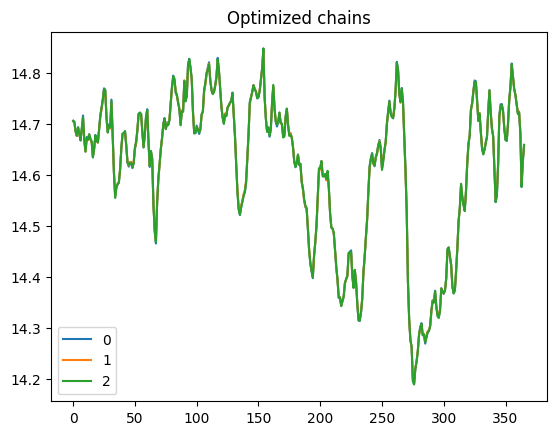

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.063  0.007   0.049    0.076        0.0      0.0     558.0    1287.0   
eps  0.104  0.006   0.093    0.115        0.0      0.0    2098.0    3604.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 11 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.048  0.004   0.041    0.054        0.0      0.0    1516.0    2528.0   
eps  0.045  0.003   0.039    0.051        0.0      0.0    1623.0    2736.0   

     r_hat  
sig    1.0  
eps    1.0  


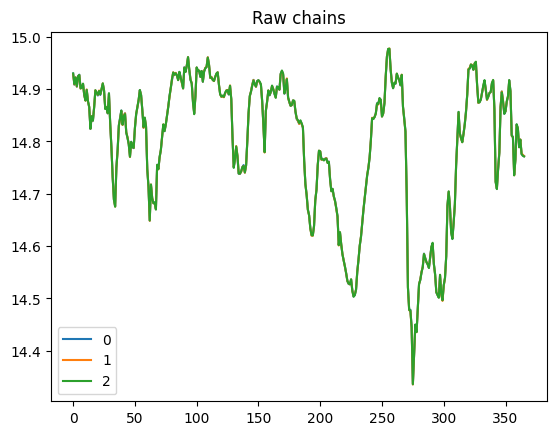

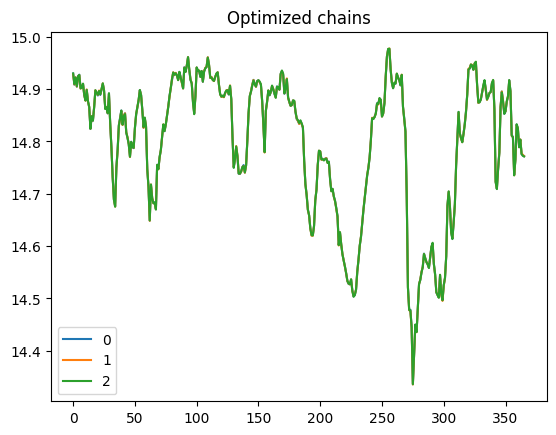

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.048  0.004   0.041    0.054        0.0      0.0    1516.0    2528.0   
eps  0.045  0.003   0.039    0.051        0.0      0.0    1623.0    2736.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.049    0.079        0.0      0.0     471.0     867.0   
eps  0.129  0.007   0.116    0.141        0.0      0.0    2284.0    4072.0   

     r_hat  
sig    1.0  
eps    1.0  


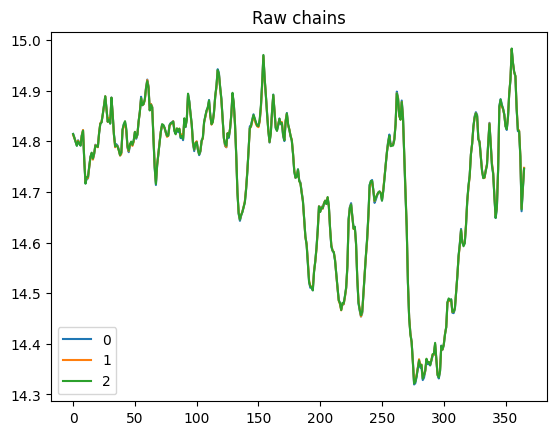

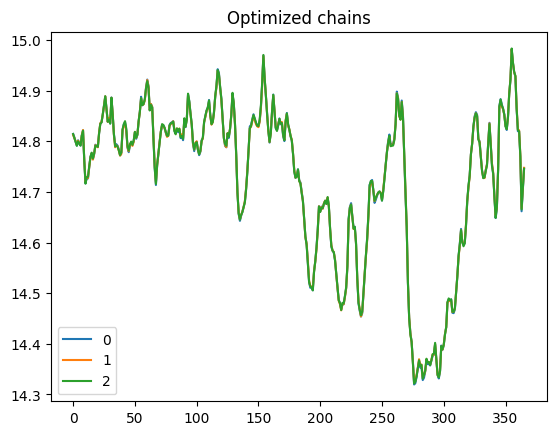

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.049    0.079        0.0      0.0     471.0     867.0   
eps  0.129  0.007   0.116    0.141        0.0      0.0    2284.0    4072.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 25 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.063  0.007   0.049    0.076        0.0      0.0     475.0    1071.0   
eps  0.107  0.006   0.096    0.118        0.0      0.0    1967.0    3487.0   

     r_hat  
sig    1.0  
eps    1.0  


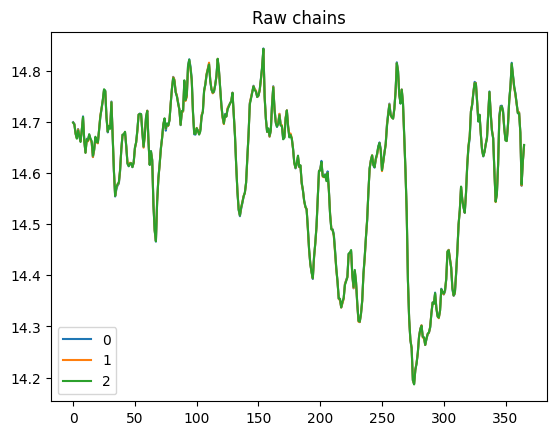

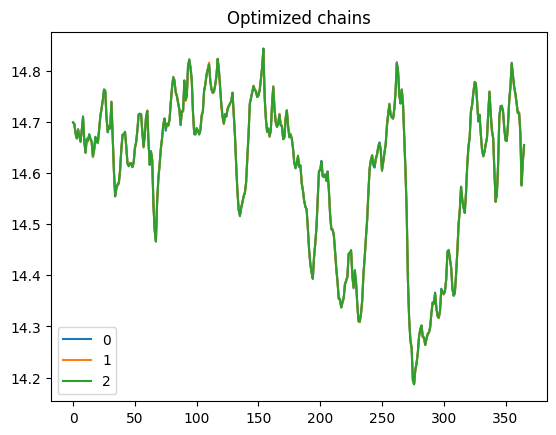

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.063  0.007   0.049    0.076        0.0      0.0     475.0    1071.0   
eps  0.107  0.006   0.096    0.118        0.0      0.0    1967.0    3487.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.047    0.075        0.0      0.0     416.0     511.0   
eps  0.119  0.006   0.108    0.131        0.0      0.0    2352.0    3573.0   

     r_hat  
sig   1.01  
eps   1.00  


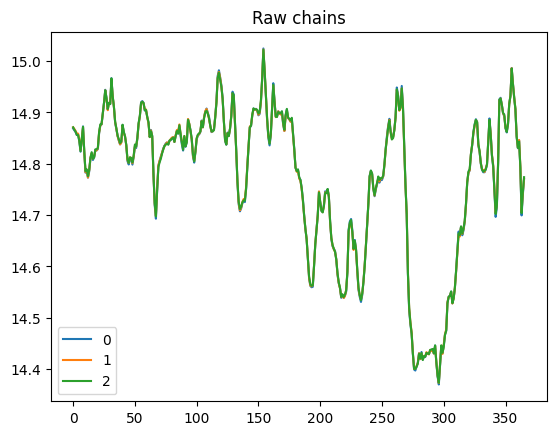

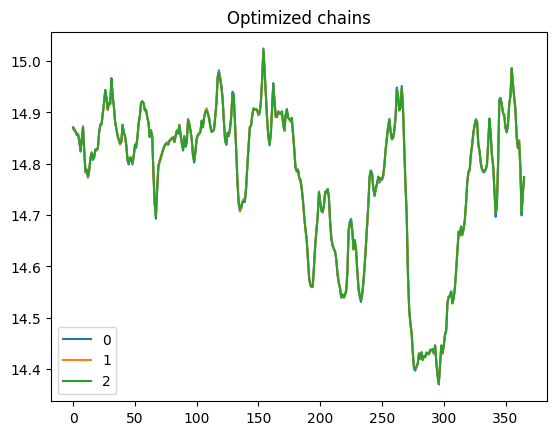

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.047    0.075        0.0      0.0     416.0     511.0   
eps  0.119  0.006   0.108    0.131        0.0      0.0    2352.0    3573.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.050    0.080        0.0      0.0     334.0     921.0   
eps  0.129  0.007   0.117    0.142        0.0      0.0    2765.0    4539.0   

     r_hat  
sig    1.0  
eps    1.0  


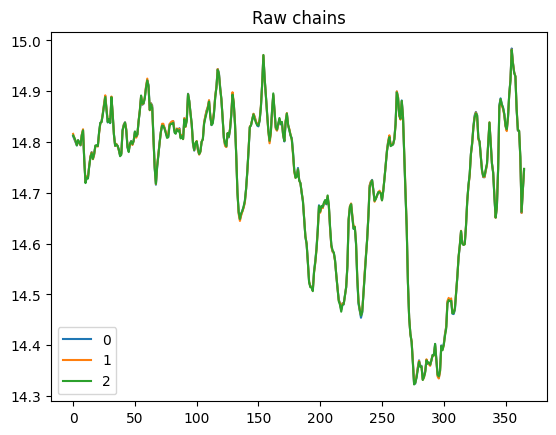

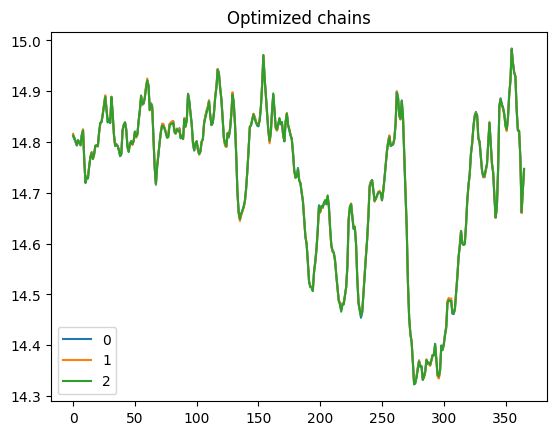

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.050    0.080        0.0      0.0     334.0     921.0   
eps  0.129  0.007   0.117    0.142        0.0      0.0    2765.0    4539.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 27 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.067  0.009   0.050    0.084        0.0      0.0     353.0     832.0   
eps  0.159  0.008   0.144    0.173        0.0      0.0    1692.0    3375.0   

     r_hat  
sig   1.01  
eps   1.00  


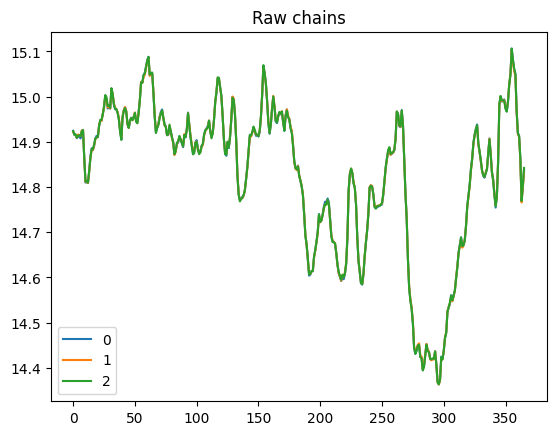

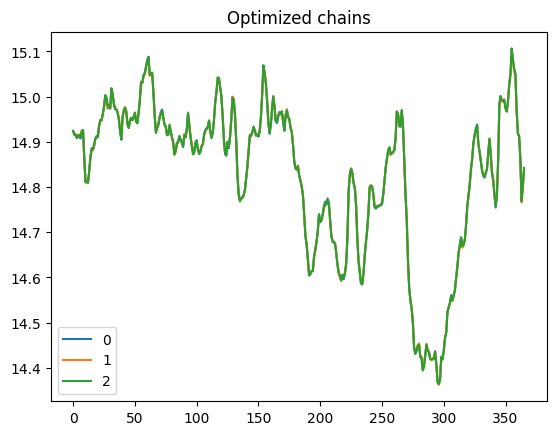

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.067  0.009   0.050    0.084        0.0      0.0     353.0     832.0   
eps  0.159  0.008   0.144    0.173        0.0      0.0    1692.0    3375.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 20 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.073        0.0      0.0     502.0    1019.0   
eps  0.112  0.006   0.100    0.123        0.0      0.0    2234.0    3722.0   

     r_hat  
sig    1.0  
eps    1.0  


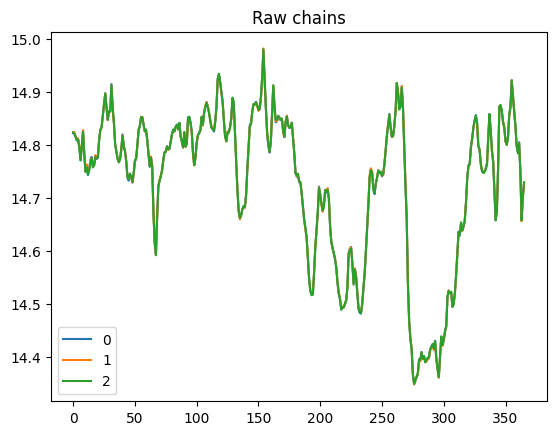

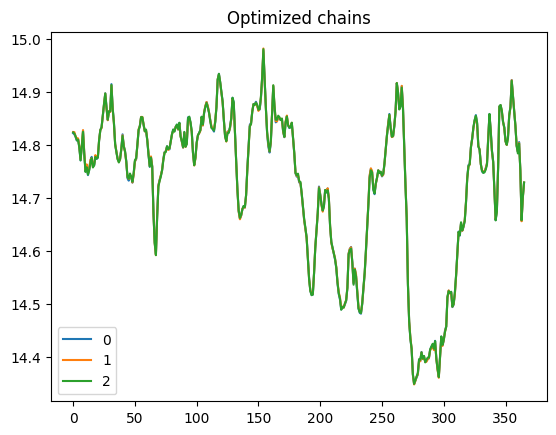

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.073        0.0      0.0     502.0    1019.0   
eps  0.112  0.006   0.100    0.123        0.0      0.0    2234.0    3722.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.047    0.075        0.0      0.0     477.0     930.0   
eps  0.116  0.006   0.105    0.128        0.0      0.0    2221.0    3387.0   

     r_hat  
sig    1.0  
eps    1.0  


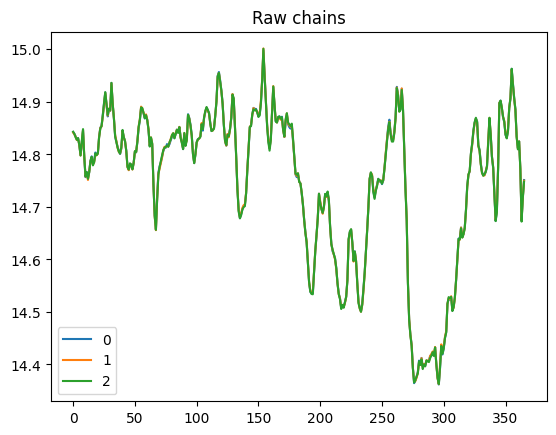

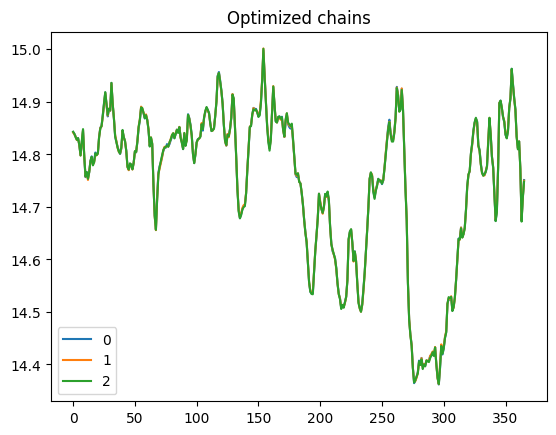

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.047    0.075        0.0      0.0     477.0     930.0   
eps  0.116  0.006   0.105    0.128        0.0      0.0    2221.0    3387.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 29 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.067  0.010   0.049    0.085      0.001      0.0     247.0     767.0   
eps  0.159  0.008   0.145    0.174      0.000      0.0    1750.0    3115.0   

     r_hat  
sig   1.01  
eps   1.00  


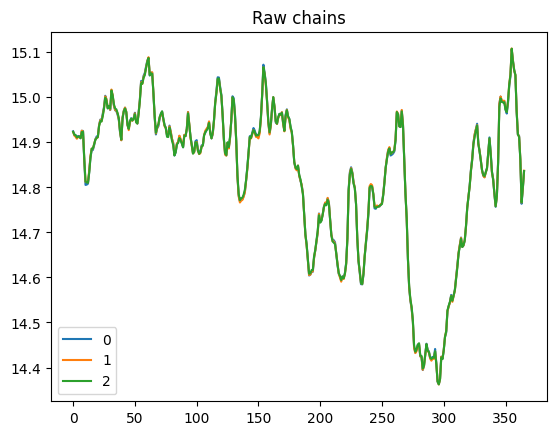

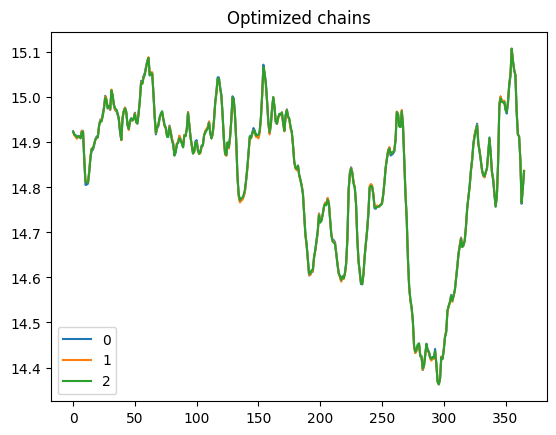

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.067  0.010   0.049    0.085      0.001      0.0     247.0     767.0   
eps  0.159  0.008   0.145    0.174      0.000      0.0    1750.0    3115.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.047    0.076        0.0      0.0     360.0     964.0   
eps  0.120  0.006   0.108    0.131        0.0      0.0    2084.0    3623.0   

     r_hat  
sig   1.01  
eps   1.00  


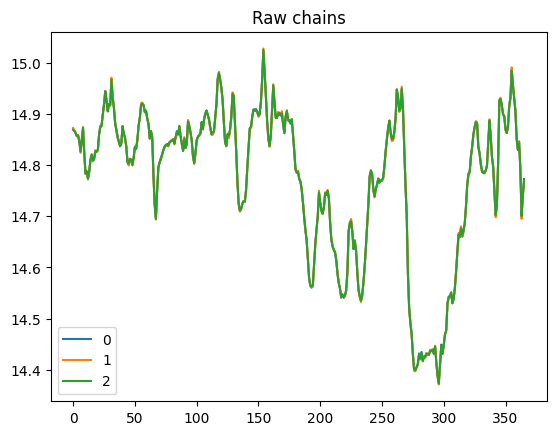

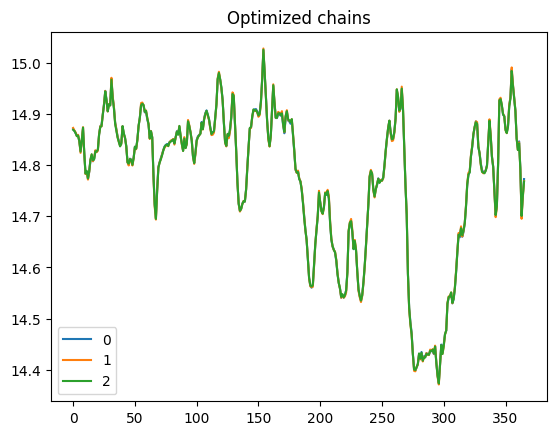

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.047    0.076        0.0      0.0     360.0     964.0   
eps  0.120  0.006   0.108    0.131        0.0      0.0    2084.0    3623.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.046  0.004   0.039    0.053        0.0      0.0    1292.0    2277.0   
eps  0.047  0.003   0.041    0.053        0.0      0.0    1684.0    3230.0   

     r_hat  
sig    1.0  
eps    1.0  


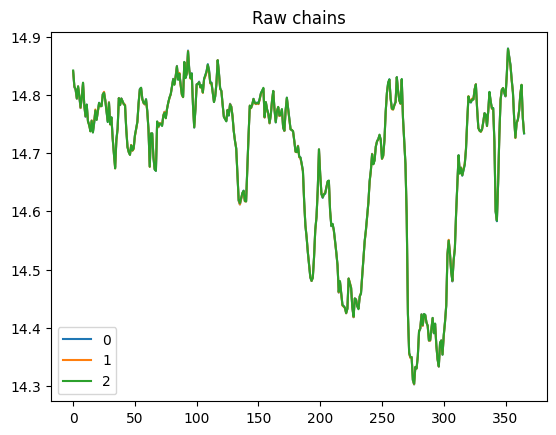

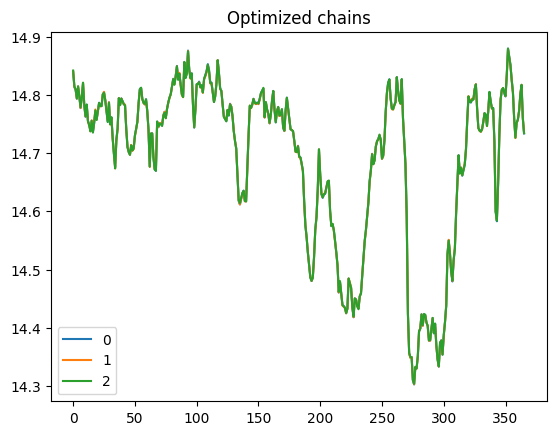

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.046  0.004   0.039    0.053        0.0      0.0    1292.0    2277.0   
eps  0.047  0.003   0.041    0.053        0.0      0.0    1684.0    3230.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 24 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.048    0.076        0.0      0.0     430.0     845.0   
eps  0.115  0.006   0.103    0.127        0.0      0.0    1786.0    3885.0   

     r_hat  
sig    1.0  
eps    1.0  


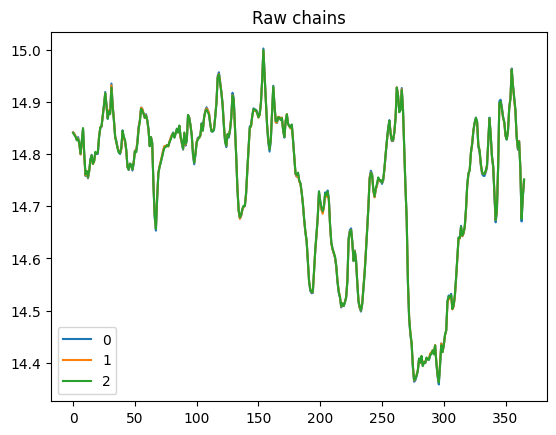

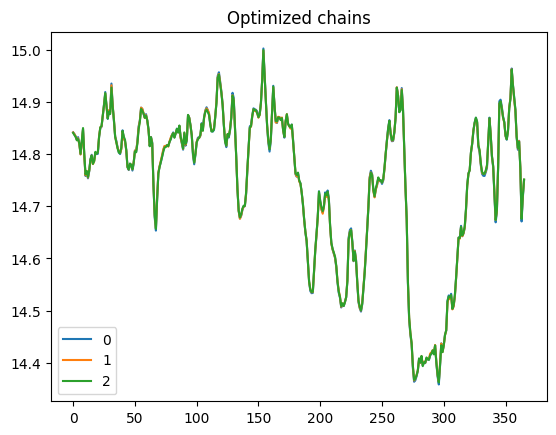

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.048    0.076        0.0      0.0     430.0     845.0   
eps  0.115  0.006   0.103    0.127        0.0      0.0    1786.0    3885.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 26 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.073        0.0      0.0     596.0    1403.0   
eps  0.111  0.006   0.100    0.122        0.0      0.0    2893.0    3888.0   

     r_hat  
sig   1.01  
eps   1.00  


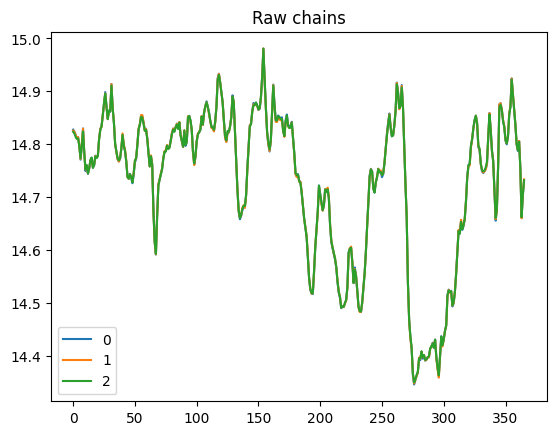

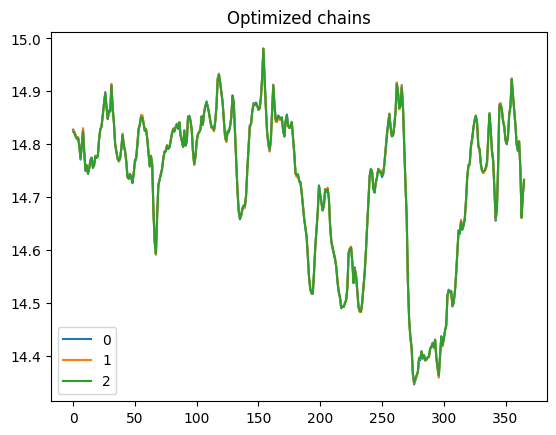

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.073        0.0      0.0     596.0    1403.0   
eps  0.111  0.006   0.100    0.122        0.0      0.0    2893.0    3888.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 14 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.046  0.003   0.039    0.053        0.0      0.0    1657.0    2311.0   
eps  0.044  0.003   0.038    0.049        0.0      0.0    1894.0    3343.0   

     r_hat  
sig    1.0  
eps    1.0  


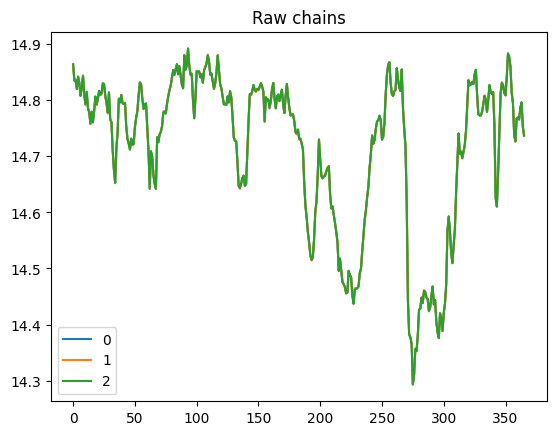

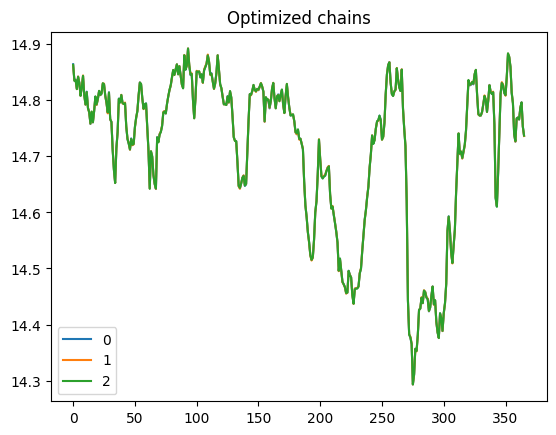

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.046  0.003   0.039    0.053        0.0      0.0    1657.0    2311.0   
eps  0.044  0.003   0.038    0.049        0.0      0.0    1894.0    3343.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.007    0.05    0.077        0.0      0.0     512.0    1023.0   
eps  0.111  0.006    0.10    0.122        0.0      0.0    2175.0    3279.0   

     r_hat  
sig    1.0  
eps    1.0  


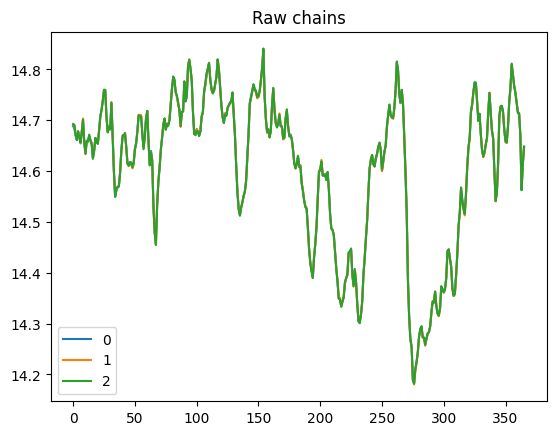

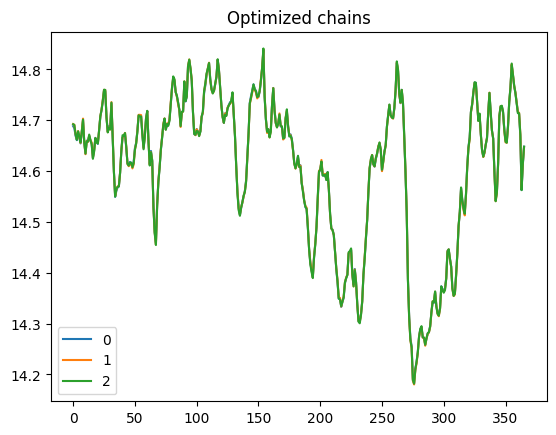

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.007    0.05    0.077        0.0      0.0     512.0    1023.0   
eps  0.111  0.006    0.10    0.122        0.0      0.0    2175.0    3279.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 26 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.066  0.008   0.051    0.082        0.0      0.0     323.0    1082.0   
eps  0.149  0.007   0.135    0.162        0.0      0.0    2249.0    3654.0   

     r_hat  
sig   1.01  
eps   1.00  


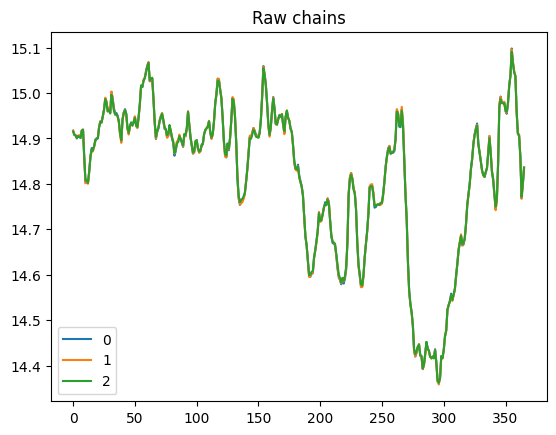

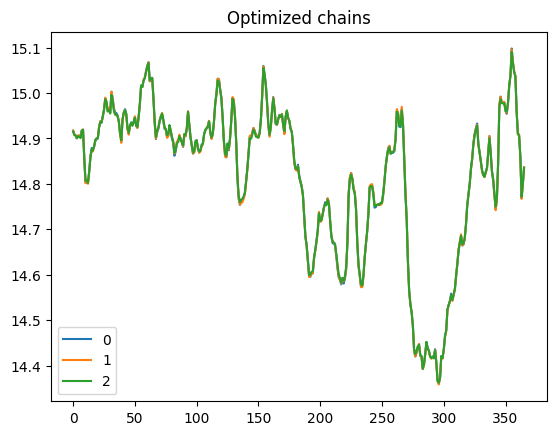

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.066  0.008   0.051    0.082        0.0      0.0     323.0    1082.0   
eps  0.149  0.007   0.135    0.162        0.0      0.0    2249.0    3654.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.075        0.0      0.0     558.0     952.0   
eps  0.111  0.006   0.101    0.123        0.0      0.0    2288.0    3485.0   

     r_hat  
sig    1.0  
eps    1.0  


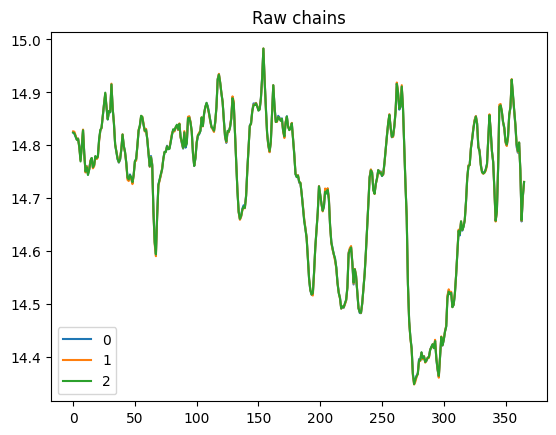

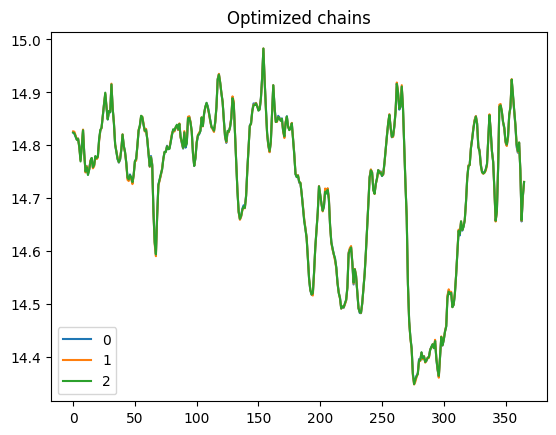

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.075        0.0      0.0     558.0     952.0   
eps  0.111  0.006   0.101    0.123        0.0      0.0    2288.0    3485.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.049    0.079        0.0      0.0     291.0     477.0   
eps  0.131  0.007   0.120    0.145        0.0      0.0    2121.0    4315.0   

     r_hat  
sig   1.01  
eps   1.00  


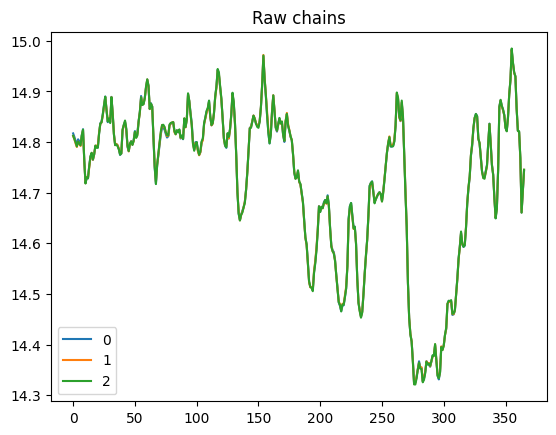

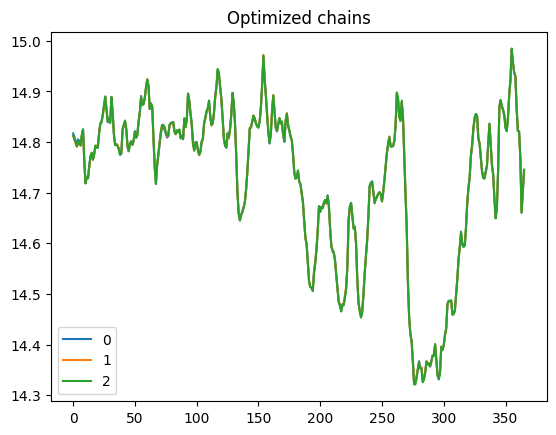

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.049    0.079        0.0      0.0     291.0     477.0   
eps  0.131  0.007   0.120    0.145        0.0      0.0    2121.0    4315.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.047    0.075        0.0      0.0     491.0    1344.0   
eps  0.121  0.006   0.109    0.133        0.0      0.0    2404.0    4143.0   

     r_hat  
sig    1.0  
eps    1.0  


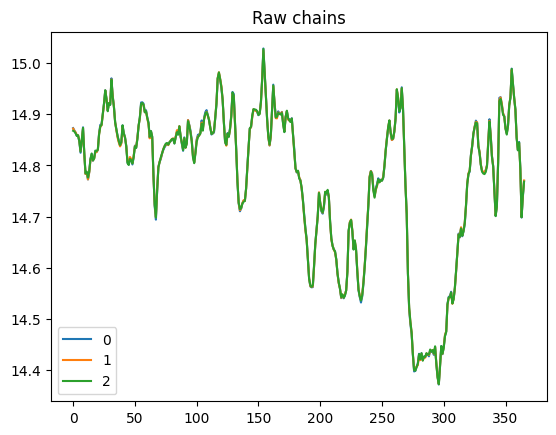

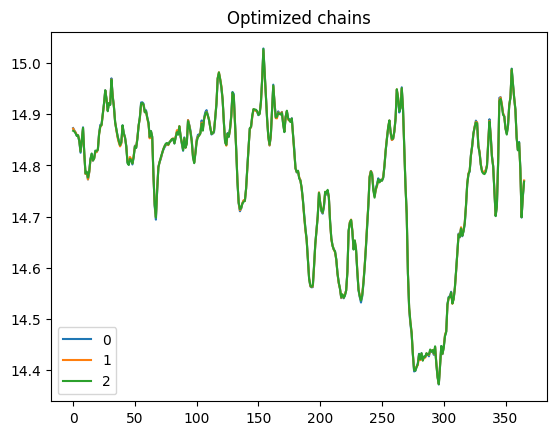

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.047    0.075        0.0      0.0     491.0    1344.0   
eps  0.121  0.006   0.109    0.133        0.0      0.0    2404.0    4143.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.074        0.0      0.0     432.0     866.0   
eps  0.115  0.006   0.104    0.128        0.0      0.0    2530.0    3796.0   

     r_hat  
sig   1.01  
eps   1.00  


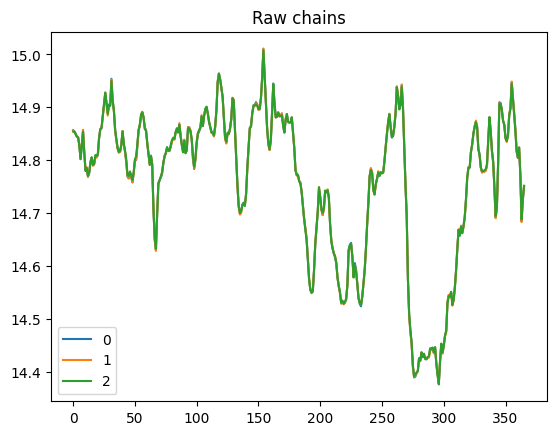

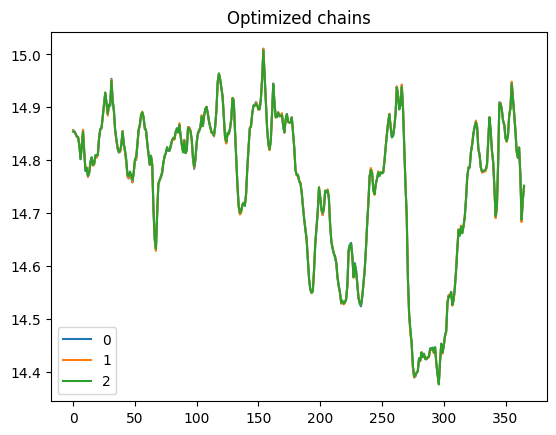

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.074        0.0      0.0     432.0     866.0   
eps  0.115  0.006   0.104    0.128        0.0      0.0    2530.0    3796.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.063  0.007    0.05    0.078        0.0      0.0     560.0    1228.0   
eps  0.112  0.006    0.10    0.124        0.0      0.0    2141.0    3280.0   

     r_hat  
sig    1.0  
eps    1.0  


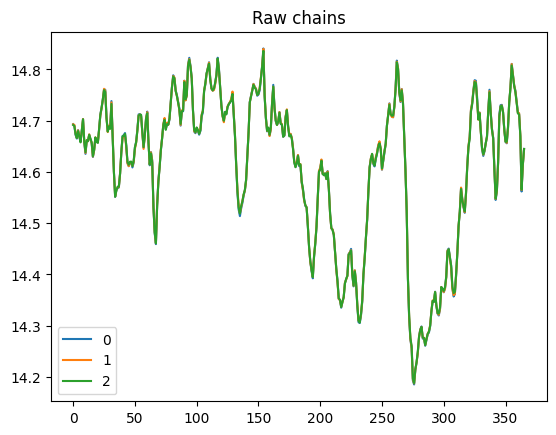

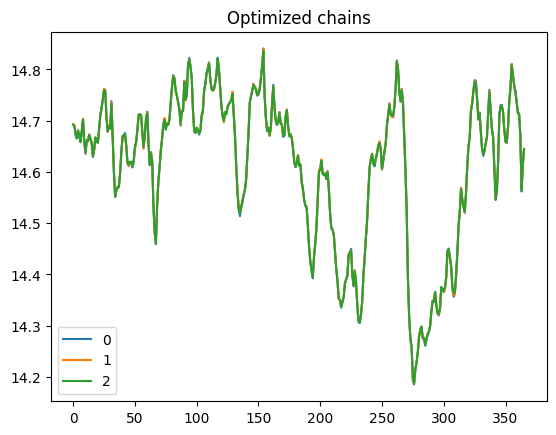

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.063  0.007    0.05    0.078        0.0      0.0     560.0    1228.0   
eps  0.112  0.006    0.10    0.124        0.0      0.0    2141.0    3280.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008    0.05    0.079        0.0      0.0     547.0    1202.0   
eps  0.112  0.006    0.10    0.123        0.0      0.0    2198.0    3731.0   

     r_hat  
sig    1.0  
eps    1.0  


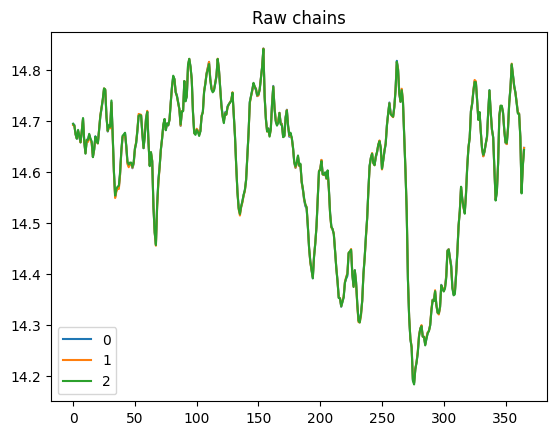

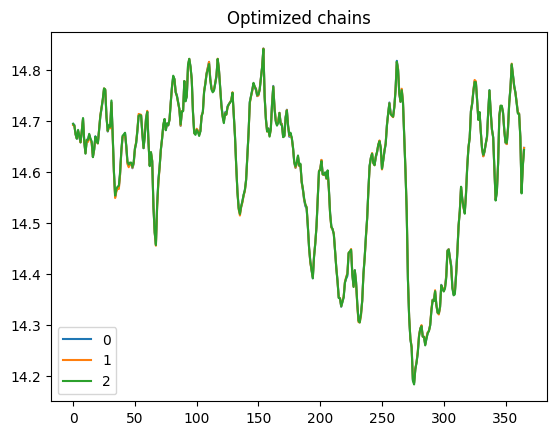

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008    0.05    0.079        0.0      0.0     547.0    1202.0   
eps  0.112  0.006    0.10    0.123        0.0      0.0    2198.0    3731.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.075        0.0      0.0     398.0     962.0   
eps  0.118  0.006   0.107    0.130        0.0      0.0    1712.0    3343.0   

     r_hat  
sig   1.01  
eps   1.00  


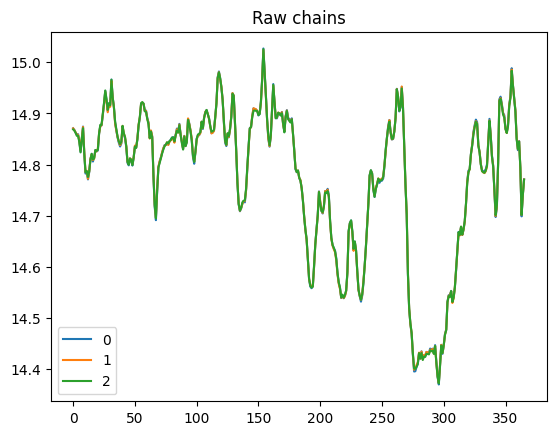

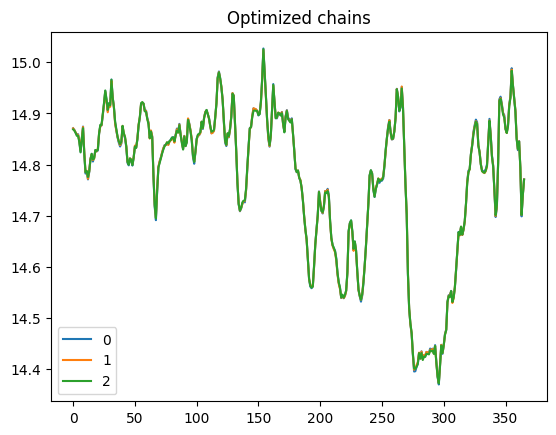

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.075        0.0      0.0     398.0     962.0   
eps  0.118  0.006   0.107    0.130        0.0      0.0    1712.0    3343.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.049    0.079        0.0      0.0     490.0    1103.0   
eps  0.131  0.007   0.119    0.144        0.0      0.0    2495.0    4154.0   

     r_hat  
sig    1.0  
eps    1.0  


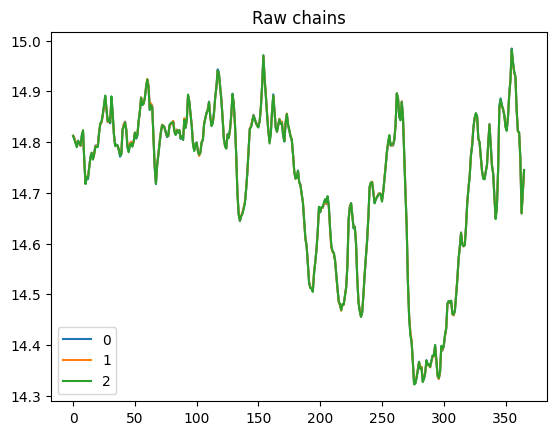

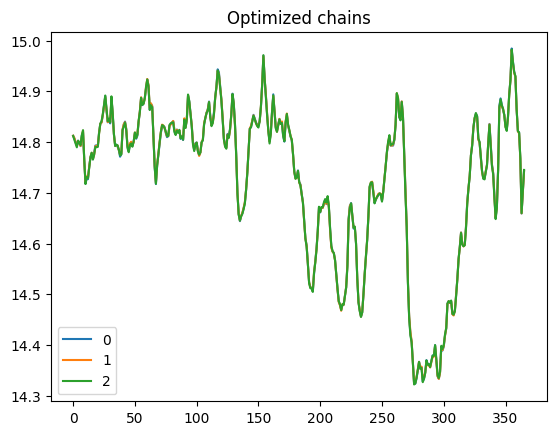

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.049    0.079        0.0      0.0     490.0    1103.0   
eps  0.131  0.007   0.119    0.144        0.0      0.0    2495.0    4154.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.047    0.074        0.0      0.0     493.0     839.0   
eps  0.111  0.006   0.100    0.123        0.0      0.0    2025.0    3627.0   

     r_hat  
sig   1.01  
eps   1.00  


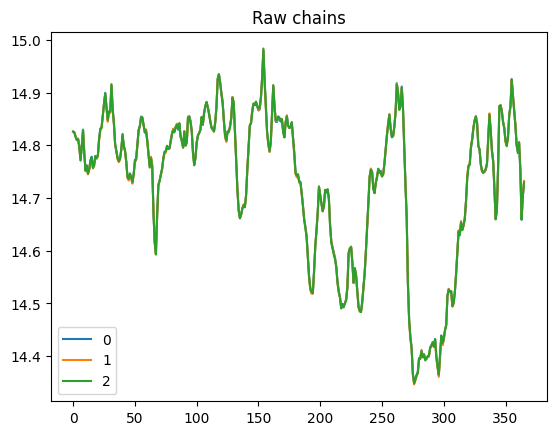

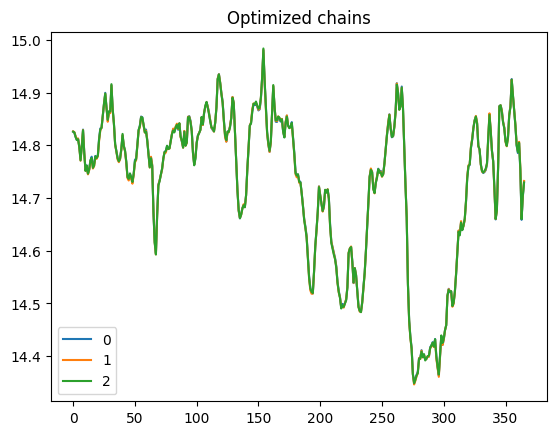

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.047    0.074        0.0      0.0     493.0     839.0   
eps  0.111  0.006   0.100    0.123        0.0      0.0    2025.0    3627.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.047    0.074        0.0      0.0     539.0    1037.0   
eps  0.115  0.006   0.104    0.127        0.0      0.0    2464.0    3862.0   

     r_hat  
sig   1.01  
eps   1.00  


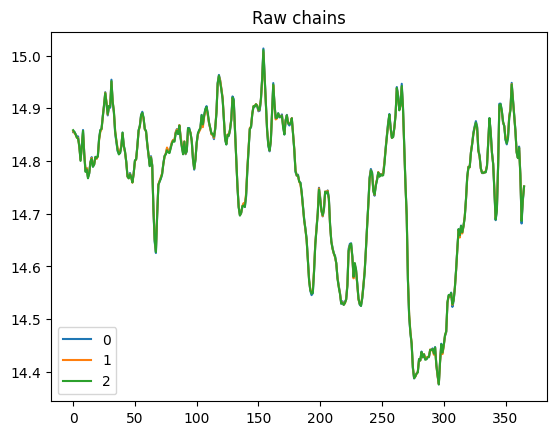

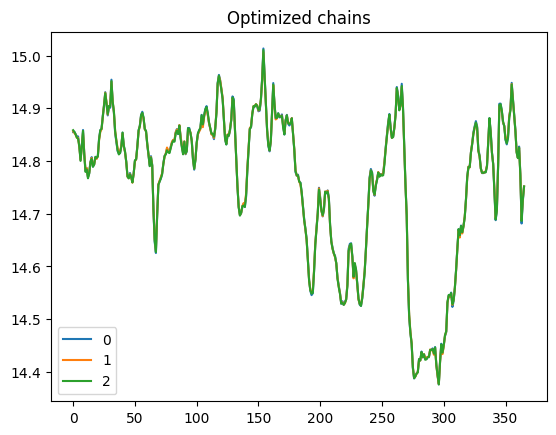

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.047    0.074        0.0      0.0     539.0    1037.0   
eps  0.115  0.006   0.104    0.127        0.0      0.0    2464.0    3862.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 20 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.007   0.051    0.078        0.0      0.0     568.0    1242.0   
eps  0.111  0.006   0.099    0.122        0.0      0.0    2611.0    2731.0   

     r_hat  
sig    1.0  
eps    1.0  


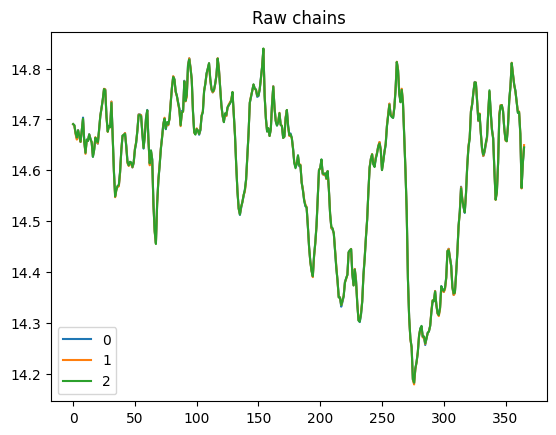

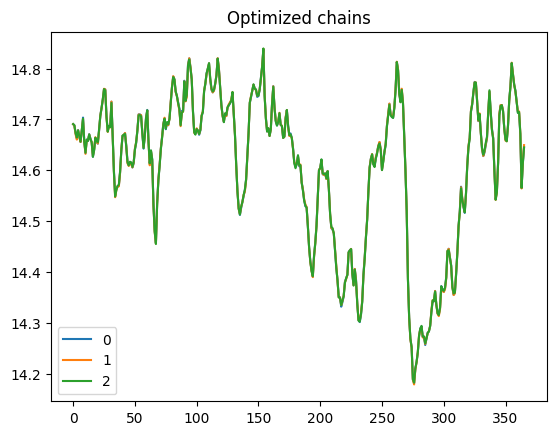

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.007   0.051    0.078        0.0      0.0     568.0    1242.0   
eps  0.111  0.006   0.099    0.122        0.0      0.0    2611.0    2731.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 24 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.075        0.0      0.0     570.0    1039.0   
eps  0.117  0.006   0.105    0.129        0.0      0.0    2507.0    3592.0   

     r_hat  
sig    1.0  
eps    1.0  


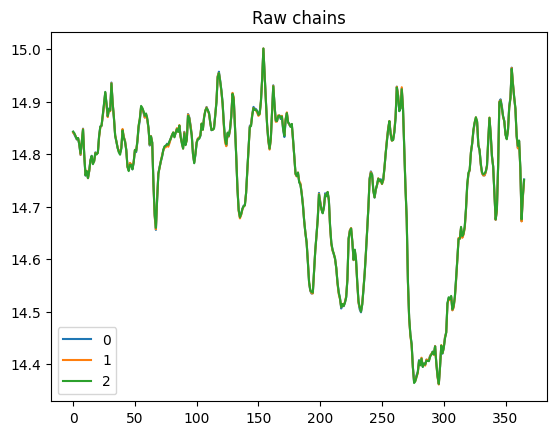

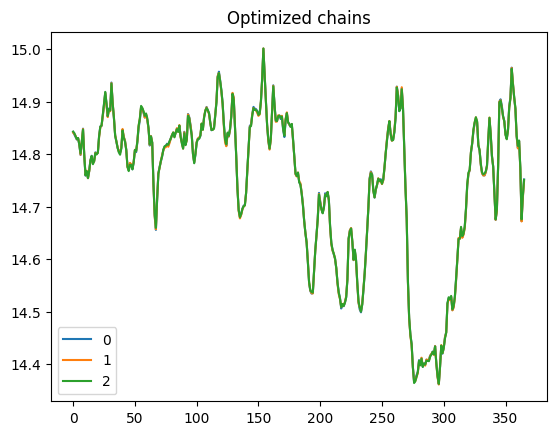

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.075        0.0      0.0     570.0    1039.0   
eps  0.117  0.006   0.105    0.129        0.0      0.0    2507.0    3592.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 29 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.050    0.079        0.0      0.0     432.0     937.0   
eps  0.129  0.007   0.116    0.141        0.0      0.0    2613.0    4446.0   

     r_hat  
sig    1.0  
eps    1.0  


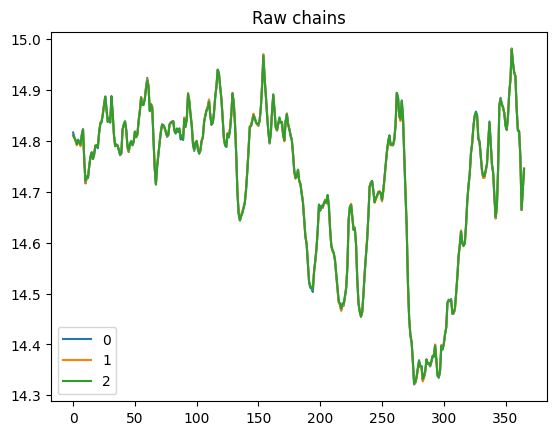

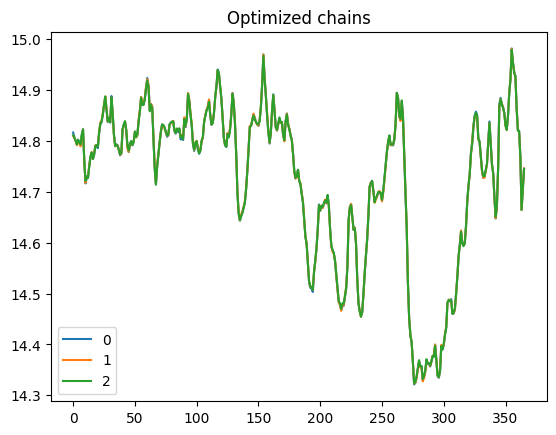

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.050    0.079        0.0      0.0     432.0     937.0   
eps  0.129  0.007   0.116    0.141        0.0      0.0    2613.0    4446.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 27 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.046    0.075        0.0      0.0     315.0     701.0   
eps  0.115  0.006   0.104    0.127        0.0      0.0    1948.0    3671.0   

     r_hat  
sig   1.01  
eps   1.00  


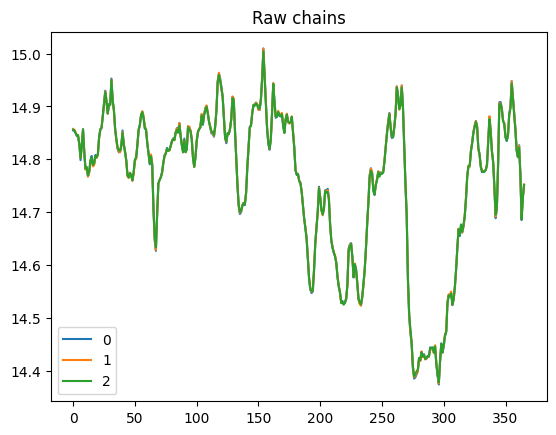

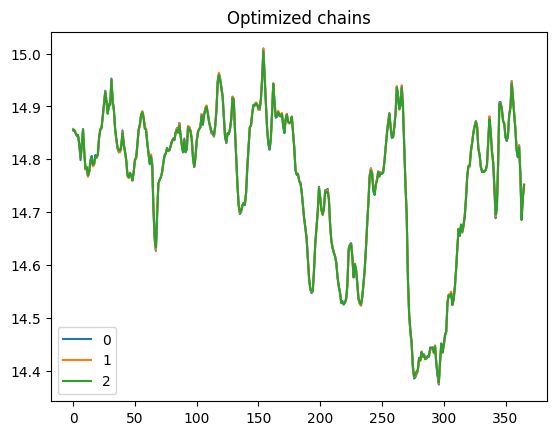

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.046    0.075        0.0      0.0     315.0     701.0   
eps  0.115  0.006   0.104    0.127        0.0      0.0    1948.0    3671.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.048    0.075        0.0      0.0     501.0    1181.0   
eps  0.111  0.006   0.099    0.122        0.0      0.0    2578.0    3751.0   

     r_hat  
sig    1.0  
eps    1.0  


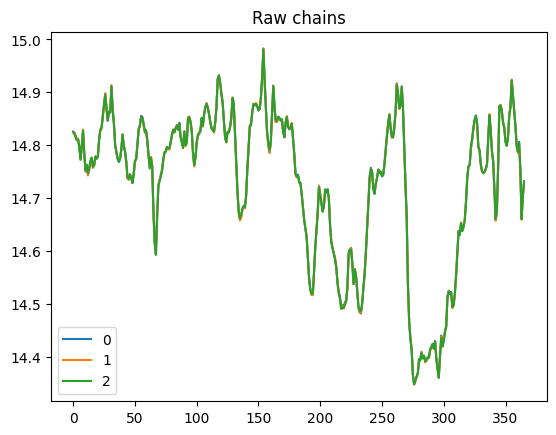

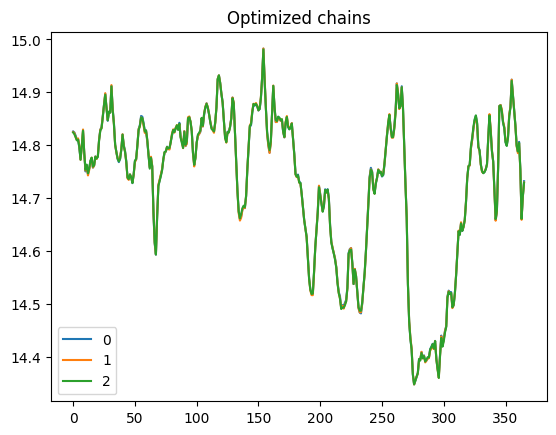

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.048    0.075        0.0      0.0     501.0    1181.0   
eps  0.111  0.006   0.099    0.122        0.0      0.0    2578.0    3751.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.076        0.0      0.0     421.0    1392.0   
eps  0.117  0.006   0.105    0.128        0.0      0.0    2247.0    3243.0   

     r_hat  
sig   1.01  
eps   1.00  


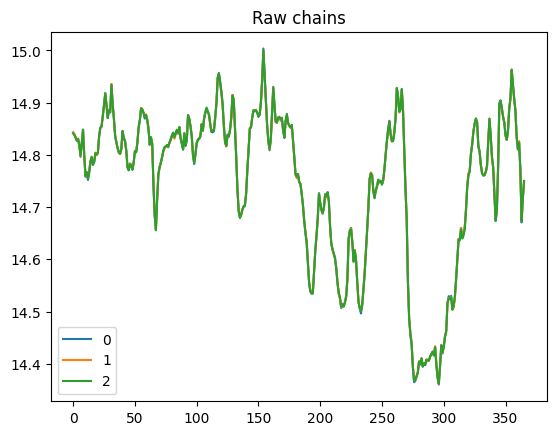

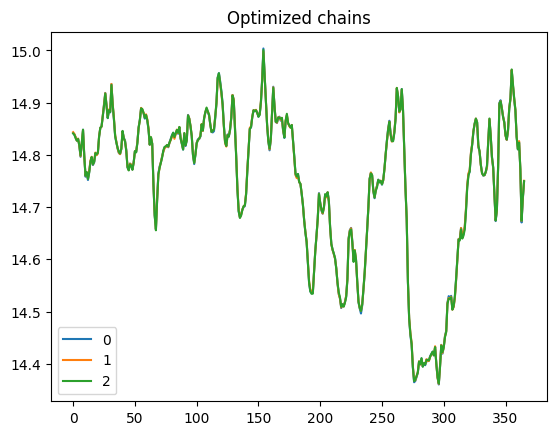

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.076        0.0      0.0     421.0    1392.0   
eps  0.117  0.006   0.105    0.128        0.0      0.0    2247.0    3243.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.063  0.007   0.051    0.077        0.0      0.0     493.0     946.0   
eps  0.108  0.006   0.097    0.119        0.0      0.0    2698.0    3261.0   

     r_hat  
sig    1.0  
eps    1.0  


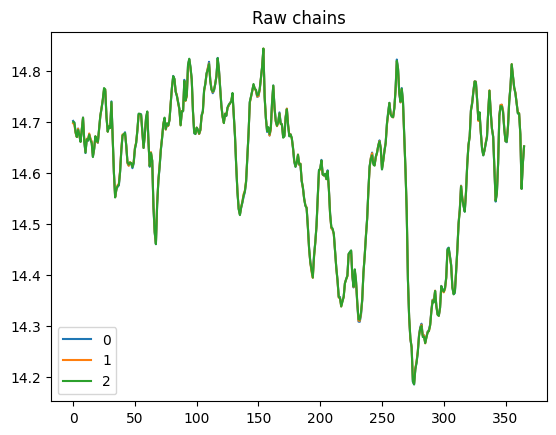

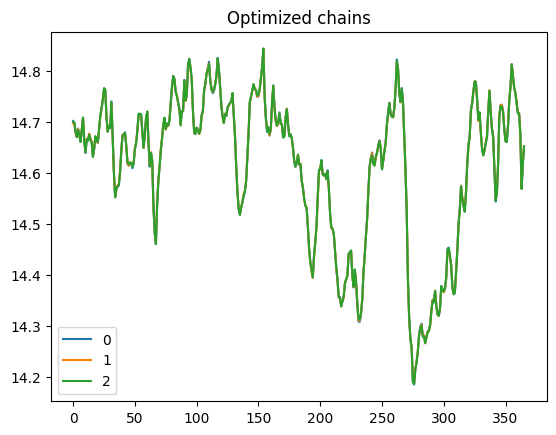

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.063  0.007   0.051    0.077        0.0      0.0     493.0     946.0   
eps  0.108  0.006   0.097    0.119        0.0      0.0    2698.0    3261.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.074        0.0      0.0     443.0     960.0   
eps  0.112  0.006   0.101    0.123        0.0      0.0    2233.0    3568.0   

     r_hat  
sig    1.0  
eps    1.0  


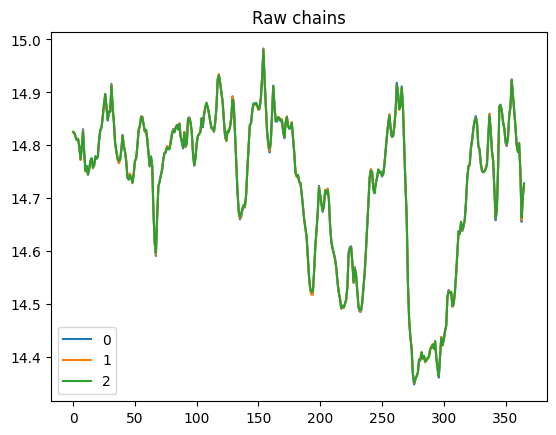

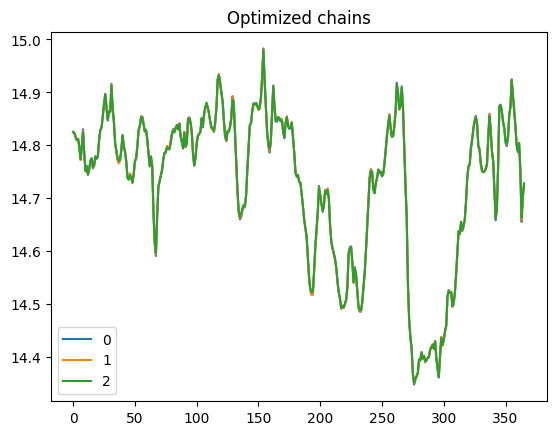

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.074        0.0      0.0     443.0     960.0   
eps  0.112  0.006   0.101    0.123        0.0      0.0    2233.0    3568.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 11 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.047  0.004   0.040    0.053        0.0      0.0    1695.0    3273.0   
eps  0.043  0.003   0.038    0.049        0.0      0.0    1749.0    2614.0   

     r_hat  
sig    1.0  
eps    1.0  


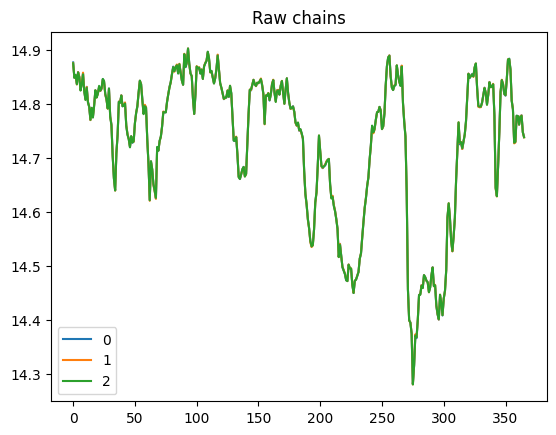

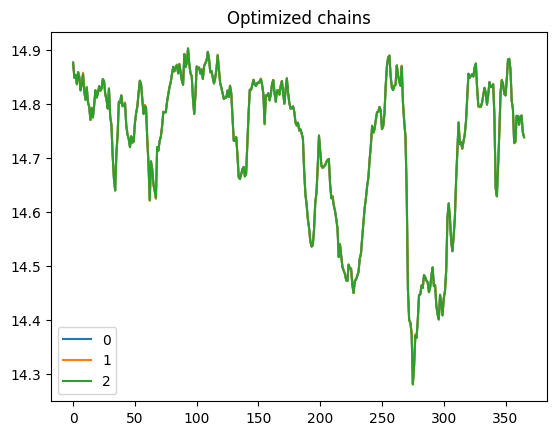

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.047  0.004   0.040    0.053        0.0      0.0    1695.0    3273.0   
eps  0.043  0.003   0.038    0.049        0.0      0.0    1749.0    2614.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 15 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.047  0.004   0.040    0.053        0.0      0.0    1435.0    2691.0   
eps  0.044  0.003   0.038    0.049        0.0      0.0    1810.0    2656.0   

     r_hat  
sig    1.0  
eps    1.0  


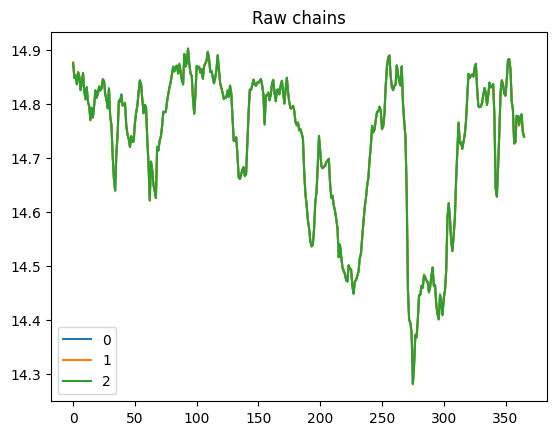

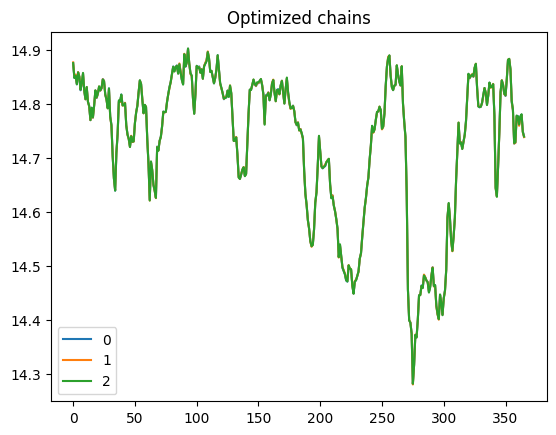

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.047  0.004   0.040    0.053        0.0      0.0    1435.0    2691.0   
eps  0.044  0.003   0.038    0.049        0.0      0.0    1810.0    2656.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.063  0.007   0.050    0.077        0.0      0.0     639.0    1489.0   
eps  0.108  0.006   0.096    0.118        0.0      0.0    2127.0    2173.0   

     r_hat  
sig    1.0  
eps    1.0  


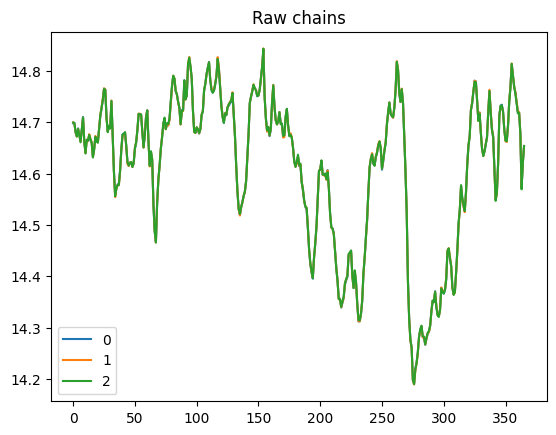

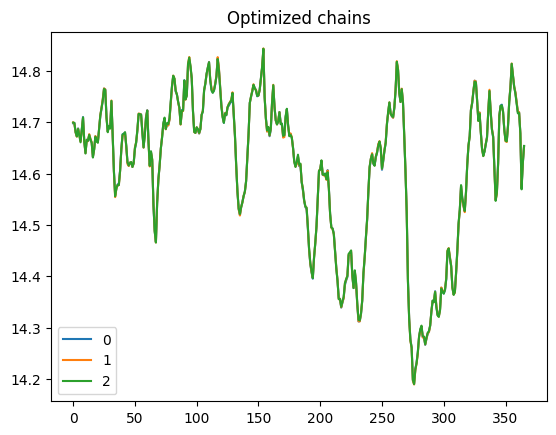

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.063  0.007   0.050    0.077        0.0      0.0     639.0    1489.0   
eps  0.108  0.006   0.096    0.118        0.0      0.0    2127.0    2173.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.046    0.074        0.0      0.0     432.0     976.0   
eps  0.114  0.006   0.103    0.126        0.0      0.0    2026.0    3268.0   

     r_hat  
sig   1.01  
eps   1.00  


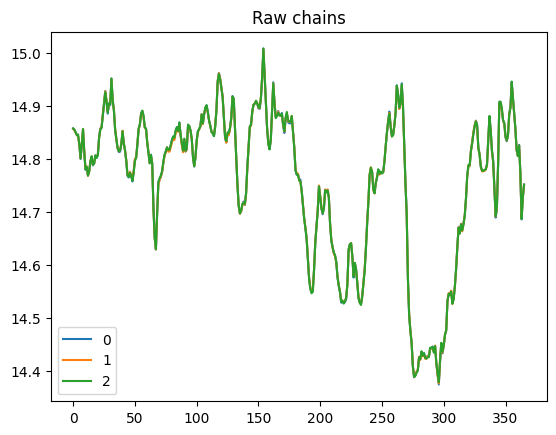

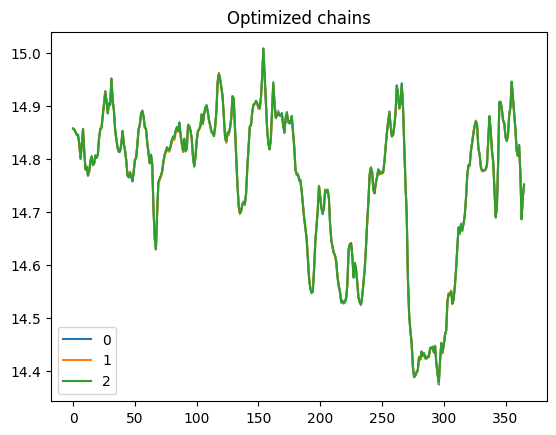

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.046    0.074        0.0      0.0     432.0     976.0   
eps  0.114  0.006   0.103    0.126        0.0      0.0    2026.0    3268.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 27 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.068  0.009   0.050    0.085      0.001      0.0     332.0     895.0   
eps  0.158  0.008   0.143    0.172      0.000      0.0    1611.0    3899.0   

     r_hat  
sig   1.01  
eps   1.00  


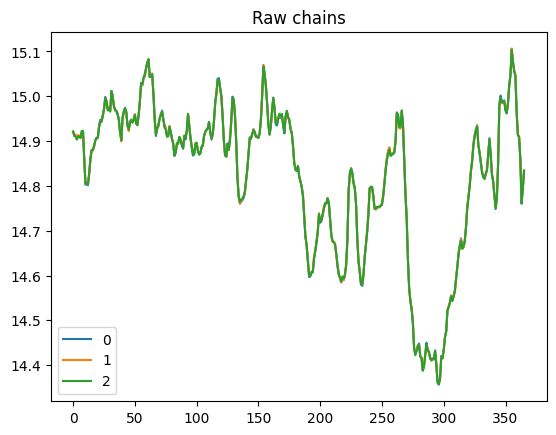

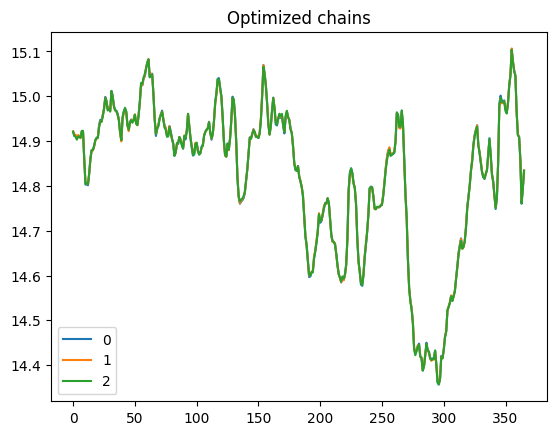

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.068  0.009   0.050    0.085      0.001      0.0     332.0     895.0   
eps  0.158  0.008   0.143    0.172      0.000      0.0    1611.0    3899.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 26 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.066  0.008   0.050    0.082        0.0      0.0     396.0     934.0   
eps  0.149  0.007   0.136    0.163        0.0      0.0    2163.0    4167.0   

     r_hat  
sig   1.01  
eps   1.00  


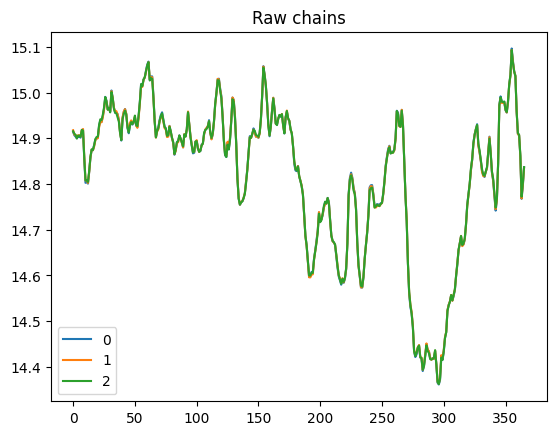

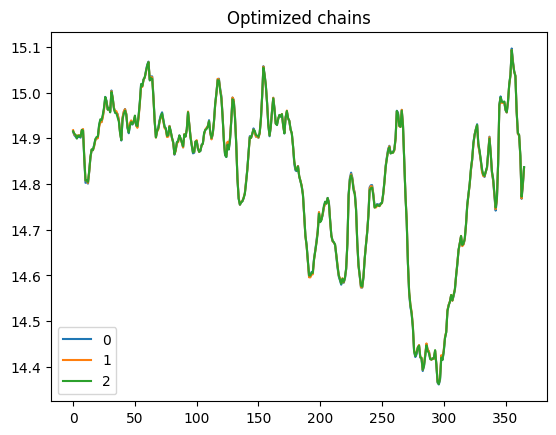

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.066  0.008   0.050    0.082        0.0      0.0     396.0     934.0   
eps  0.149  0.007   0.136    0.163        0.0      0.0    2163.0    4167.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.048    0.076        0.0      0.0     475.0    1116.0   
eps  0.119  0.006   0.108    0.131        0.0      0.0    2162.0    3947.0   

     r_hat  
sig    1.0  
eps    1.0  


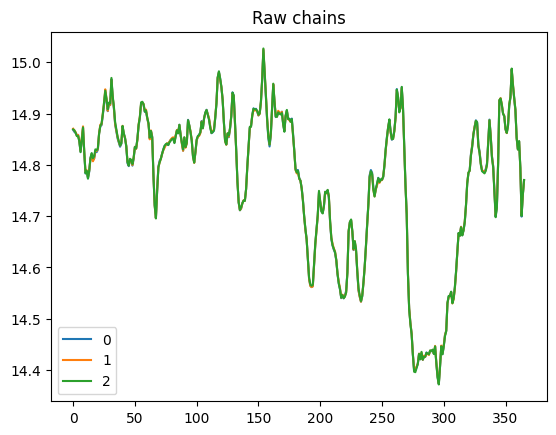

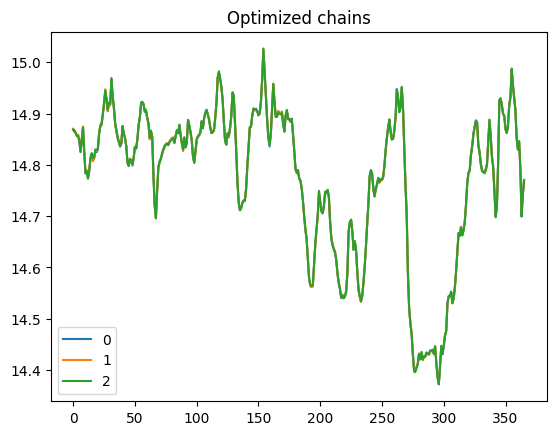

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.048    0.076        0.0      0.0     475.0    1116.0   
eps  0.119  0.006   0.108    0.131        0.0      0.0    2162.0    3947.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.074        0.0      0.0     565.0    1074.0   
eps  0.111  0.006   0.100    0.122        0.0      0.0    2420.0    3451.0   

     r_hat  
sig    1.0  
eps    1.0  


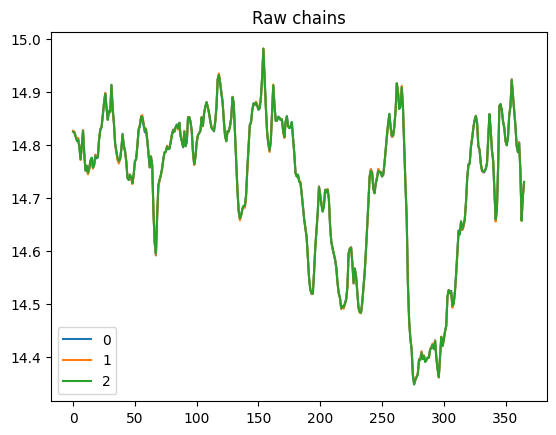

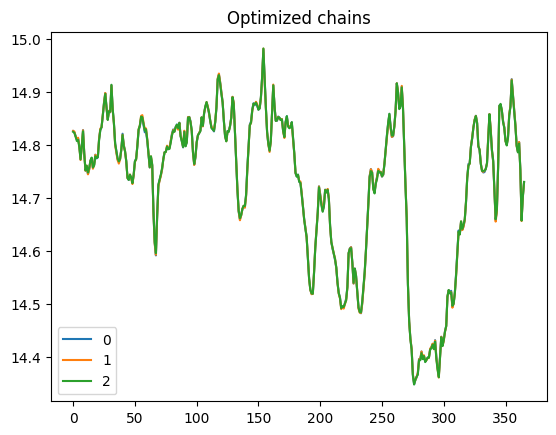

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.074        0.0      0.0     565.0    1074.0   
eps  0.111  0.006   0.100    0.122        0.0      0.0    2420.0    3451.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 25 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.065  0.007   0.052    0.078        0.0      0.0     713.0    1503.0   
eps  0.115  0.006   0.103    0.127        0.0      0.0    2760.0    4114.0   

     r_hat  
sig    1.0  
eps    1.0  


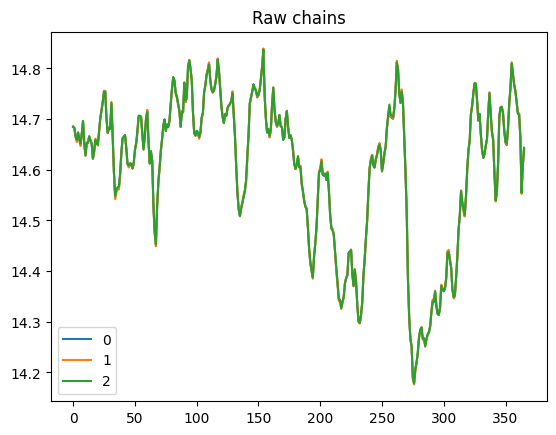

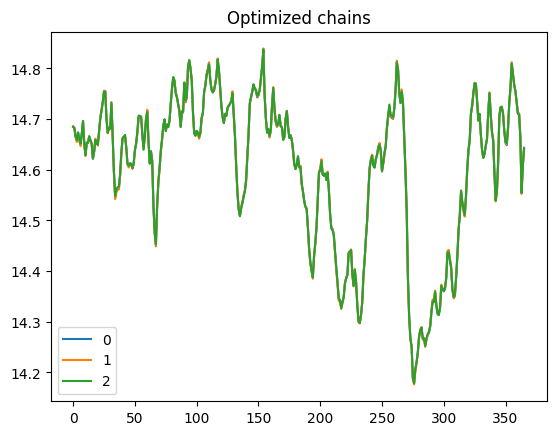

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.065  0.007   0.052    0.078        0.0      0.0     713.0    1503.0   
eps  0.115  0.006   0.103    0.127        0.0      0.0    2760.0    4114.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.056  0.006   0.044    0.067        0.0      0.0     506.0     875.0   
eps  0.087  0.005   0.077    0.096        0.0      0.0    1894.0    2182.0   

     r_hat  
sig    1.0  
eps    1.0  


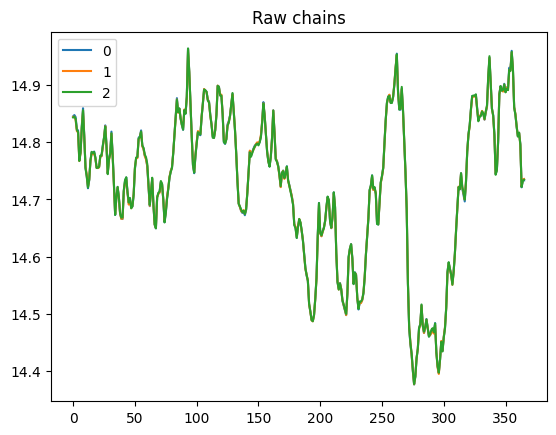

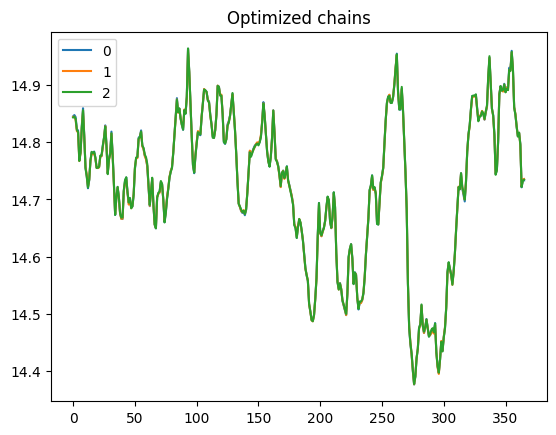

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.056  0.006   0.044    0.067        0.0      0.0     506.0     875.0   
eps  0.087  0.005   0.077    0.096        0.0      0.0    1894.0    2182.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.046    0.074        0.0      0.0     535.0    1219.0   
eps  0.115  0.006   0.103    0.126        0.0      0.0    2303.0    4248.0   

     r_hat  
sig    1.0  
eps    1.0  


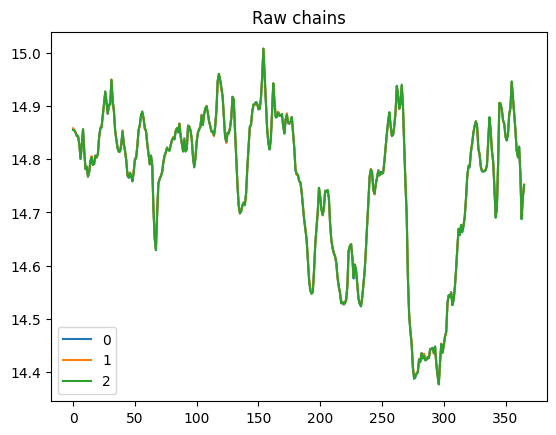

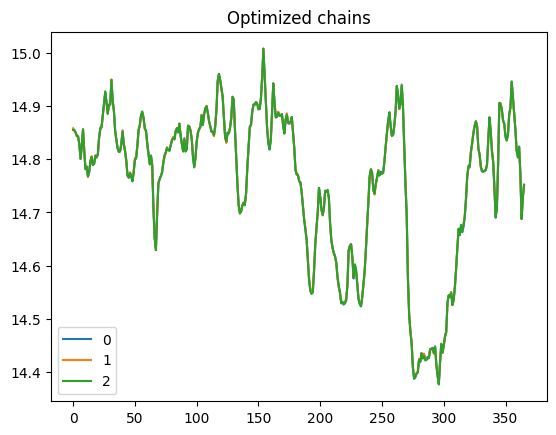

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.046    0.074        0.0      0.0     535.0    1219.0   
eps  0.115  0.006   0.103    0.126        0.0      0.0    2303.0    4248.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 20 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.063  0.007   0.050    0.076        0.0      0.0     641.0    1460.0   
eps  0.108  0.006   0.097    0.119        0.0      0.0    2745.0    3508.0   

     r_hat  
sig    1.0  
eps    1.0  


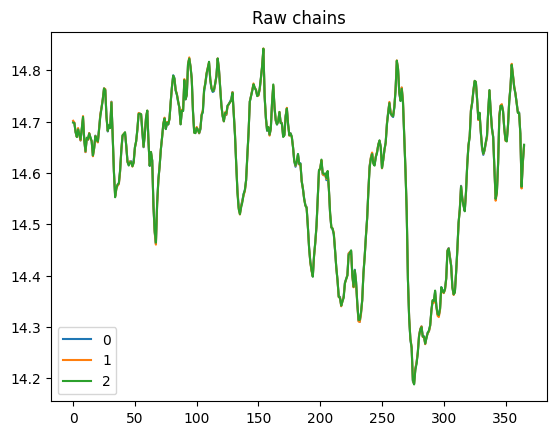

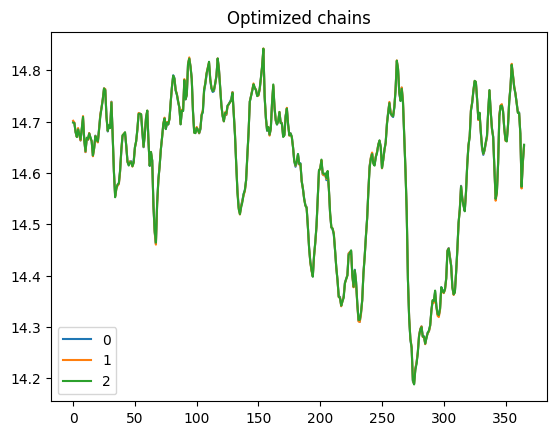

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.063  0.007   0.050    0.076        0.0      0.0     641.0    1460.0   
eps  0.108  0.006   0.097    0.119        0.0      0.0    2745.0    3508.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 10 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.045  0.003   0.039    0.052        0.0      0.0    1708.0    2726.0   
eps  0.043  0.003   0.037    0.048        0.0      0.0    2102.0    3213.0   

     r_hat  
sig    1.0  
eps    1.0  


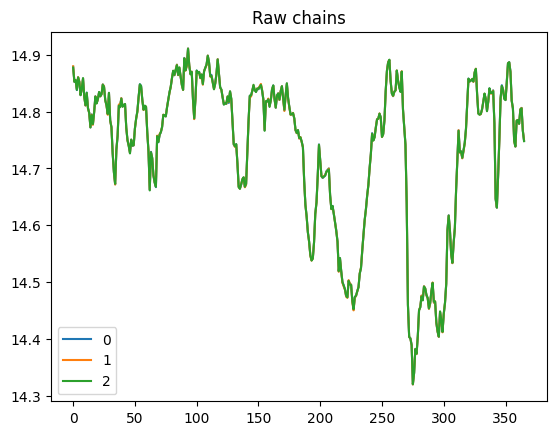

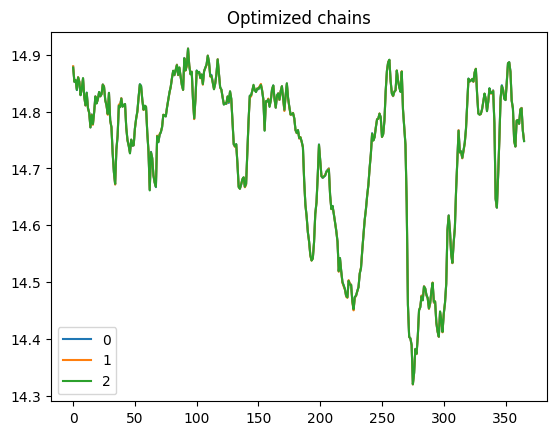

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.045  0.003   0.039    0.052        0.0      0.0    1708.0    2726.0   
eps  0.043  0.003   0.037    0.048        0.0      0.0    2102.0    3213.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.073        0.0      0.0     488.0    1102.0   
eps  0.115  0.006   0.103    0.125        0.0      0.0    2212.0    3630.0   

     r_hat  
sig   1.01  
eps   1.00  


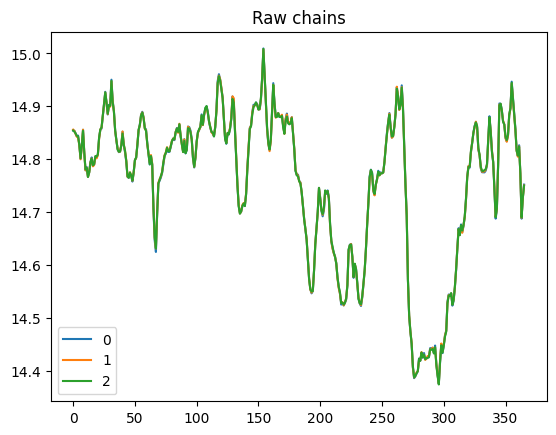

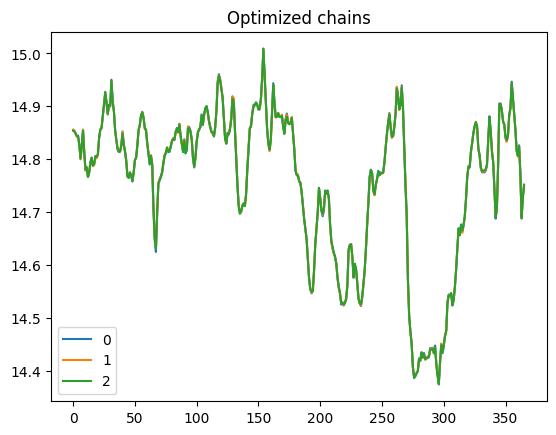

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.073        0.0      0.0     488.0    1102.0   
eps  0.115  0.006   0.103    0.125        0.0      0.0    2212.0    3630.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.073        0.0      0.0     489.0    1088.0   
eps  0.112  0.006   0.101    0.123        0.0      0.0    2336.0    3723.0   

     r_hat  
sig   1.01  
eps   1.00  


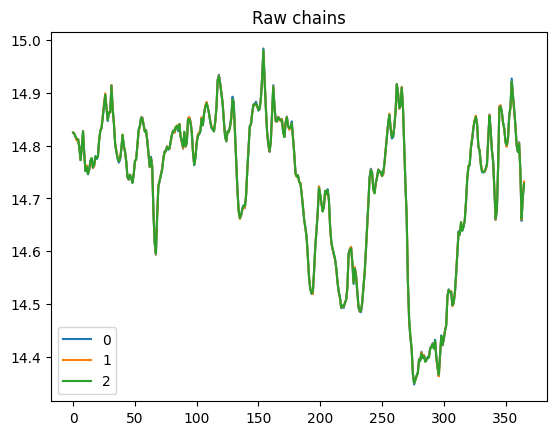

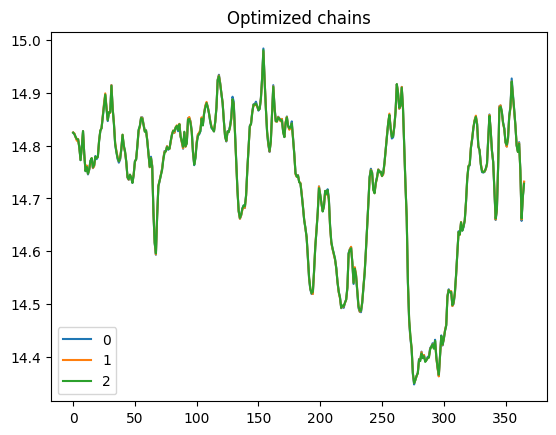

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.073        0.0      0.0     489.0    1088.0   
eps  0.112  0.006   0.101    0.123        0.0      0.0    2336.0    3723.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 31 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.062  0.008   0.048    0.077        0.0      0.0     526.0     962.0   
eps  0.116  0.006   0.104    0.127        0.0      0.0    2218.0    3470.0   

     r_hat  
sig   1.01  
eps   1.00  


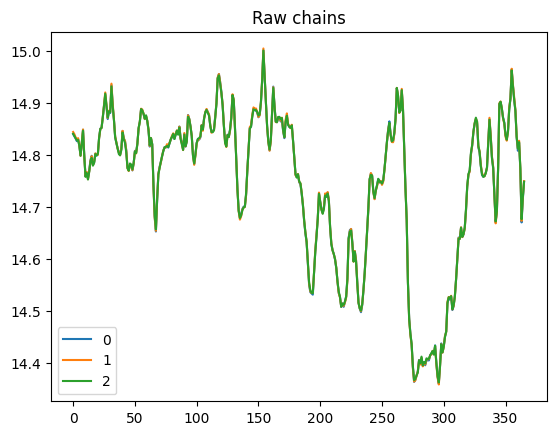

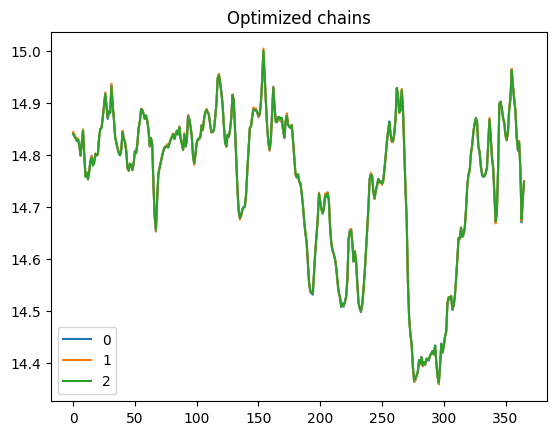

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.062  0.008   0.048    0.077        0.0      0.0     526.0     962.0   
eps  0.116  0.006   0.104    0.127        0.0      0.0    2218.0    3470.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 37 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.067  0.009   0.050    0.083        0.0      0.0     414.0     842.0   
eps  0.153  0.008   0.139    0.168        0.0      0.0    1953.0    4224.0   

     r_hat  
sig    1.0  
eps    1.0  


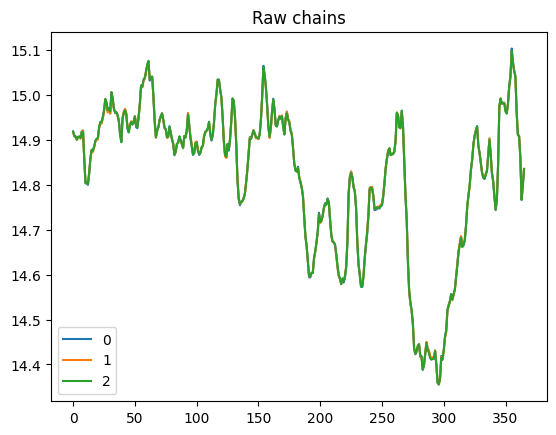

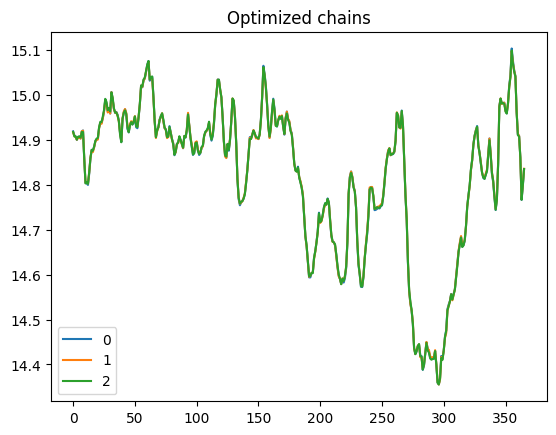

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.067  0.009   0.050    0.083        0.0      0.0     414.0     842.0   
eps  0.153  0.008   0.139    0.168        0.0      0.0    1953.0    4224.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 38 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.068  0.009   0.052    0.085        0.0      0.0     432.0    1034.0   
eps  0.163  0.008   0.149    0.178        0.0      0.0    2690.0    4352.0   

     r_hat  
sig   1.01  
eps   1.00  


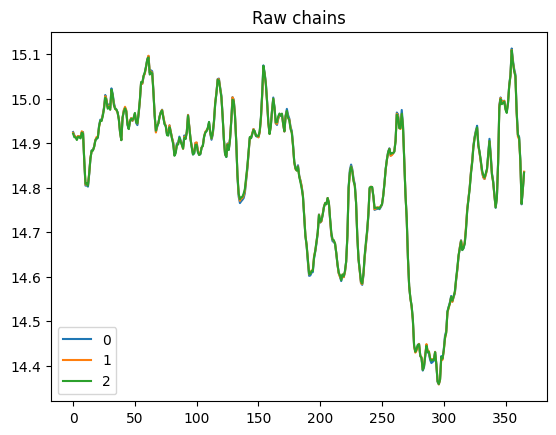

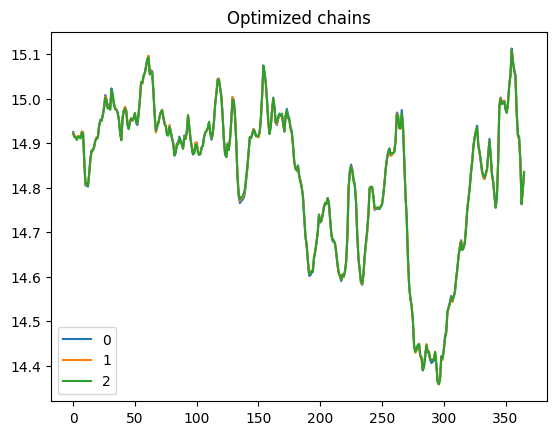

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.068  0.009   0.052    0.085        0.0      0.0     432.0    1034.0   
eps  0.163  0.008   0.149    0.178        0.0      0.0    2690.0    4352.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 36 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.066  0.009    0.05    0.084      0.001      0.0     321.0     779.0   
eps  0.154  0.008    0.14    0.168      0.000      0.0    1604.0    2742.0   

     r_hat  
sig   1.01  
eps   1.00  


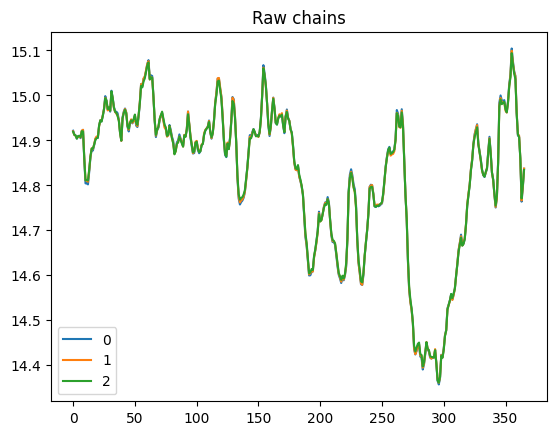

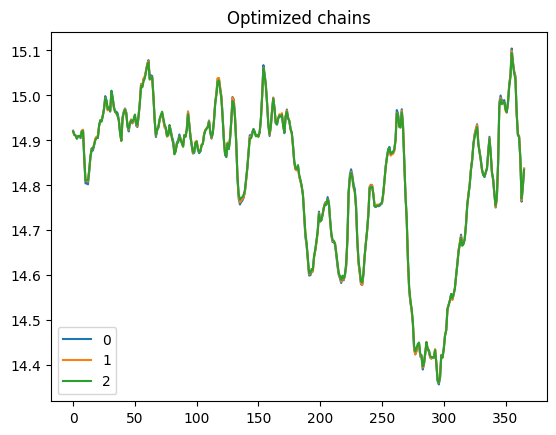

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.066  0.009    0.05    0.084      0.001      0.0     321.0     779.0   
eps  0.154  0.008    0.14    0.168      0.000      0.0    1604.0    2742.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 13 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.045  0.003   0.039    0.052        0.0      0.0    1446.0    2302.0   
eps  0.043  0.003   0.037    0.048        0.0      0.0    2017.0    2964.0   

     r_hat  
sig    1.0  
eps    1.0  


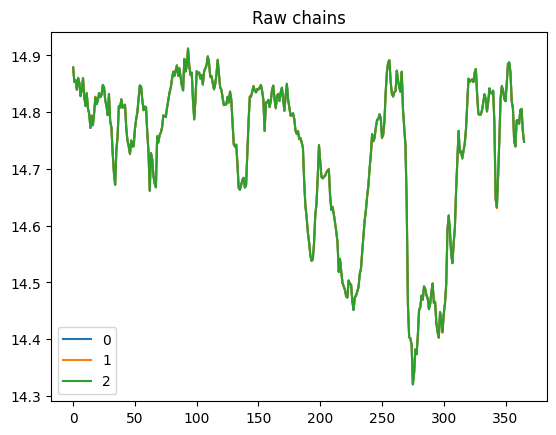

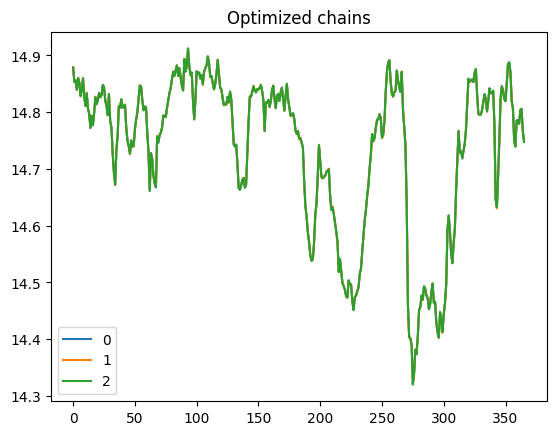

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.045  0.003   0.039    0.052        0.0      0.0    1446.0    2302.0   
eps  0.043  0.003   0.037    0.048        0.0      0.0    2017.0    2964.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 28 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.073        0.0      0.0     458.0    1064.0   
eps  0.115  0.006   0.104    0.127        0.0      0.0    2022.0    3677.0   

     r_hat  
sig    1.0  
eps    1.0  


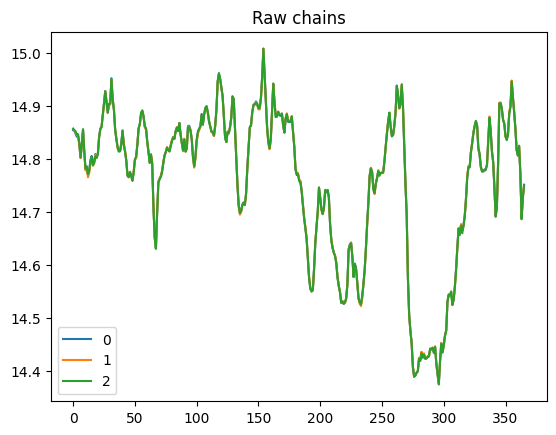

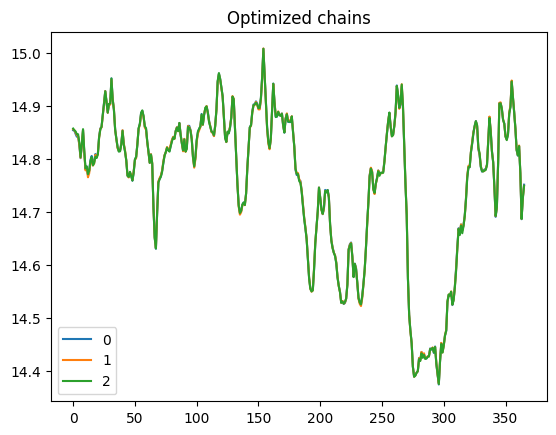

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.073        0.0      0.0     458.0    1064.0   
eps  0.115  0.006   0.104    0.127        0.0      0.0    2022.0    3677.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 29 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.007    0.05    0.077        0.0      0.0     570.0    1459.0   
eps  0.111  0.006    0.10    0.122        0.0      0.0    2445.0    3581.0   

     r_hat  
sig    1.0  
eps    1.0  


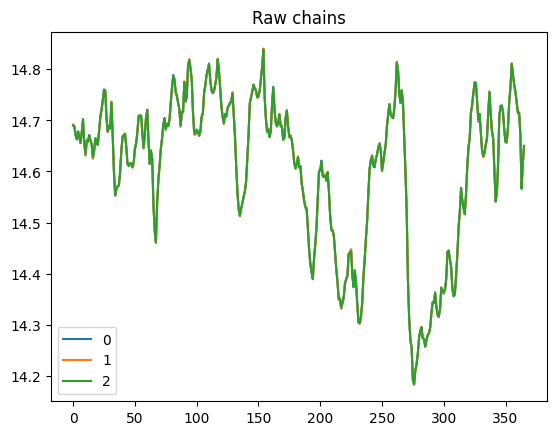

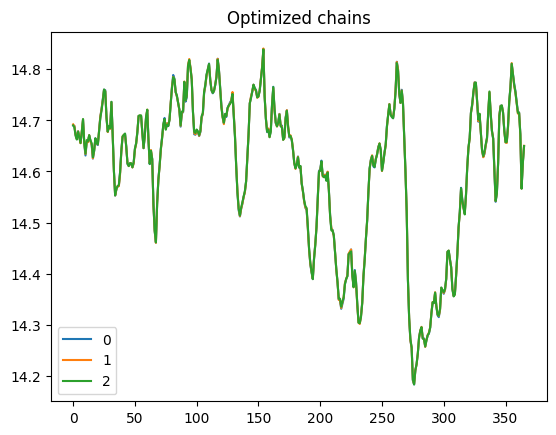

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.007    0.05    0.077        0.0      0.0     570.0    1459.0   
eps  0.111  0.006    0.10    0.122        0.0      0.0    2445.0    3581.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 30 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.063  0.007   0.051    0.076        0.0      0.0     596.0    1123.0   
eps  0.108  0.006   0.097    0.119        0.0      0.0    2407.0    3910.0   

     r_hat  
sig   1.01  
eps   1.00  


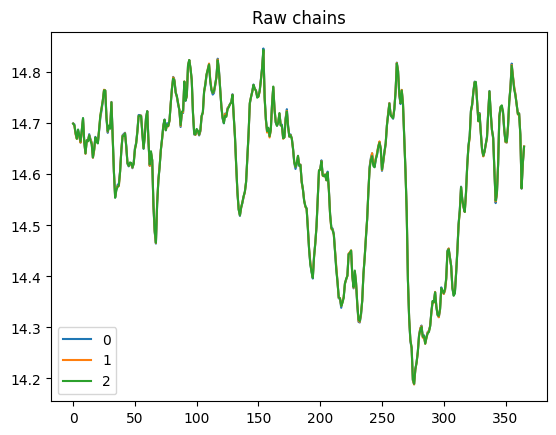

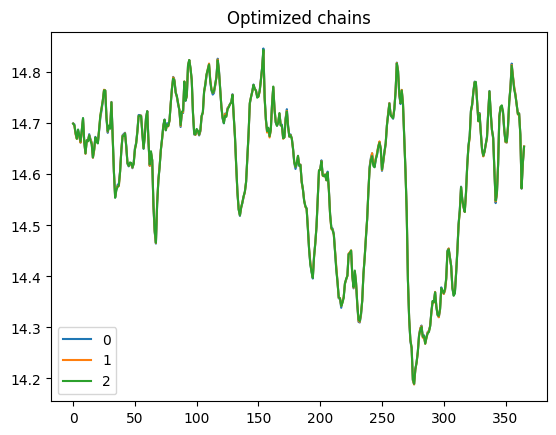

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.063  0.007   0.051    0.076        0.0      0.0     596.0    1123.0   
eps  0.108  0.006   0.097    0.119        0.0      0.0    2407.0    3910.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 30 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.046    0.075        0.0      0.0     468.0     904.0   
eps  0.119  0.006   0.107    0.131        0.0      0.0    2127.0    4266.0   

     r_hat  
sig    1.0  
eps    1.0  


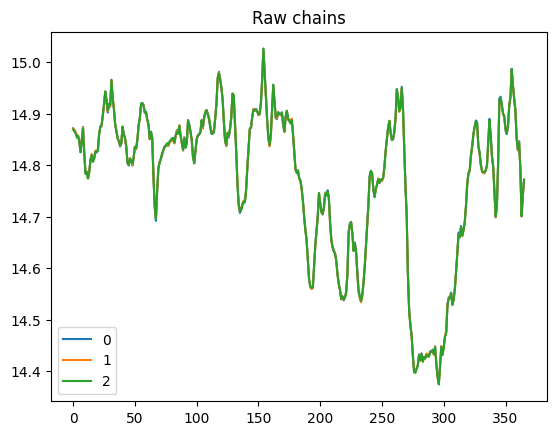

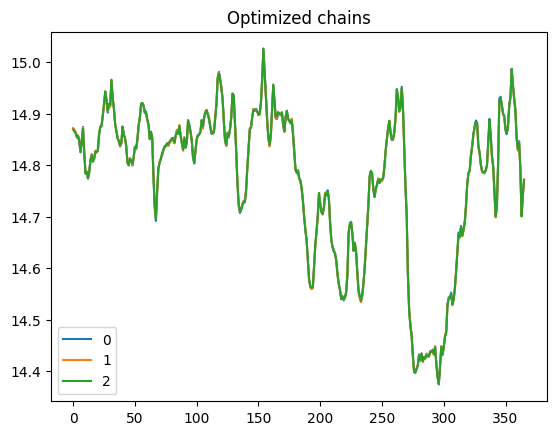

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.008   0.046    0.075        0.0      0.0     468.0     904.0   
eps  0.119  0.006   0.107    0.131        0.0      0.0    2127.0    4266.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 26 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.007   0.051    0.076        0.0      0.0     651.0    1558.0   
eps  0.107  0.006   0.096    0.118        0.0      0.0    2982.0    3547.0   

     r_hat  
sig    1.0  
eps    1.0  


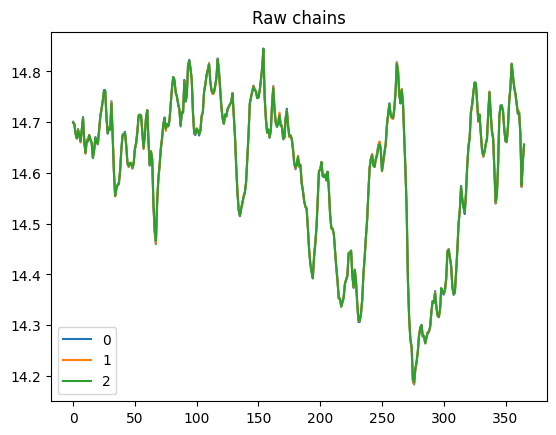

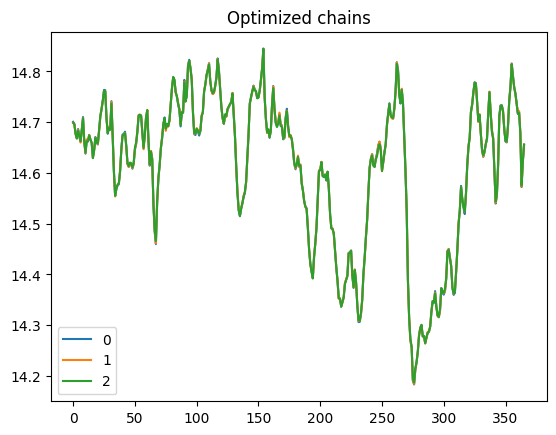

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.007   0.051    0.076        0.0      0.0     651.0    1558.0   
eps  0.107  0.006   0.096    0.118        0.0      0.0    2982.0    3547.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 27 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.075        0.0      0.0     446.0    1153.0   
eps  0.111  0.006   0.099    0.122        0.0      0.0    2068.0    3254.0   

     r_hat  
sig   1.01  
eps   1.00  


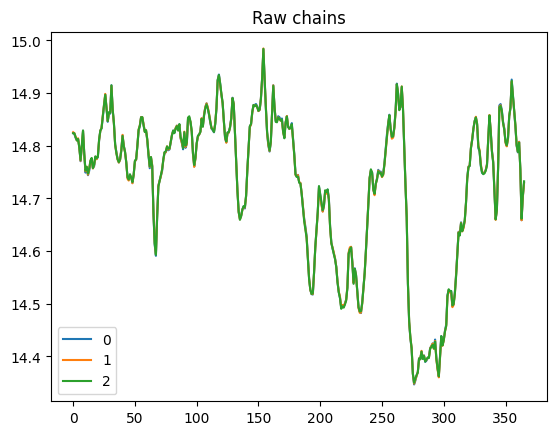

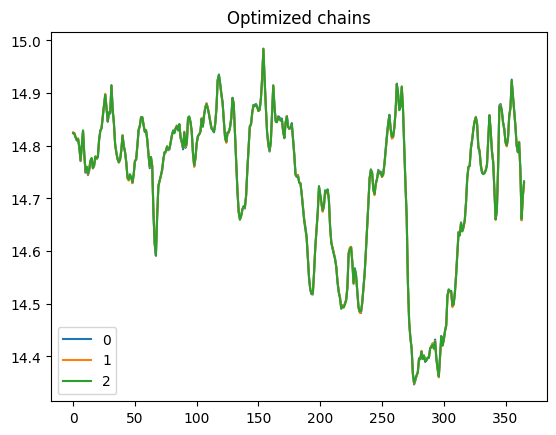

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.075        0.0      0.0     446.0    1153.0   
eps  0.111  0.006   0.099    0.122        0.0      0.0    2068.0    3254.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 26 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.063  0.008   0.050    0.079        0.0      0.0     503.0    1423.0   
eps  0.125  0.007   0.113    0.138        0.0      0.0    2096.0    3367.0   

     r_hat  
sig   1.01  
eps   1.00  


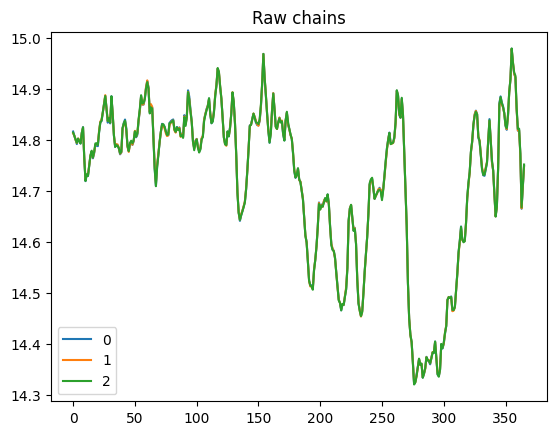

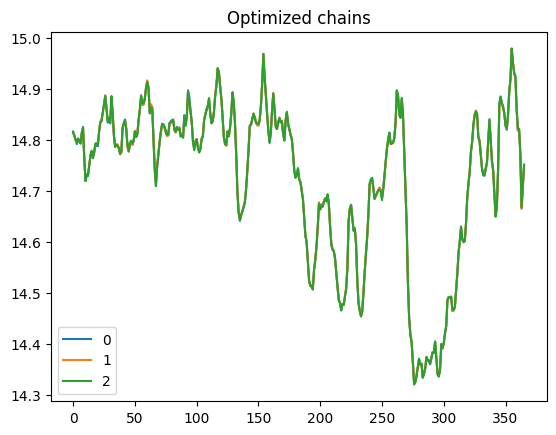

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.063  0.008   0.050    0.079        0.0      0.0     503.0    1423.0   
eps  0.125  0.007   0.113    0.138        0.0      0.0    2096.0    3367.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 27 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.063  0.008   0.048    0.077        0.0      0.0     517.0     907.0   
eps  0.127  0.007   0.115    0.140        0.0      0.0    2067.0    3496.0   

     r_hat  
sig    1.0  
eps    1.0  


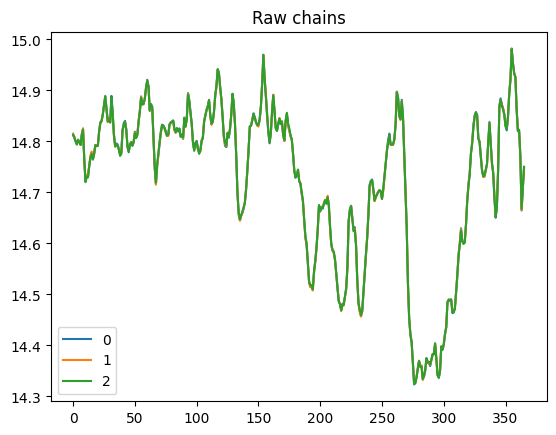

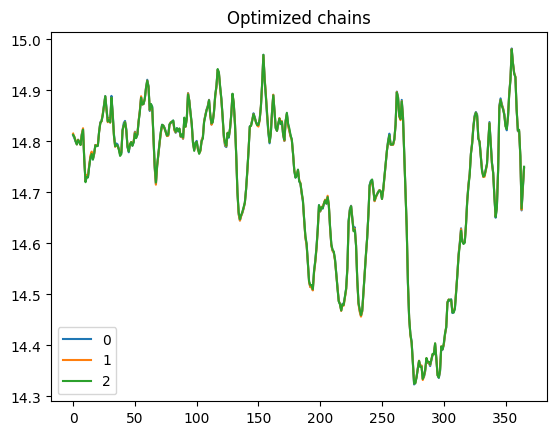

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.063  0.008   0.048    0.077        0.0      0.0     517.0     907.0   
eps  0.127  0.007   0.115    0.140        0.0      0.0    2067.0    3496.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 29 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.074        0.0      0.0     367.0     984.0   
eps  0.112  0.006   0.101    0.124        0.0      0.0    1993.0    4478.0   

     r_hat  
sig   1.01  
eps   1.00  


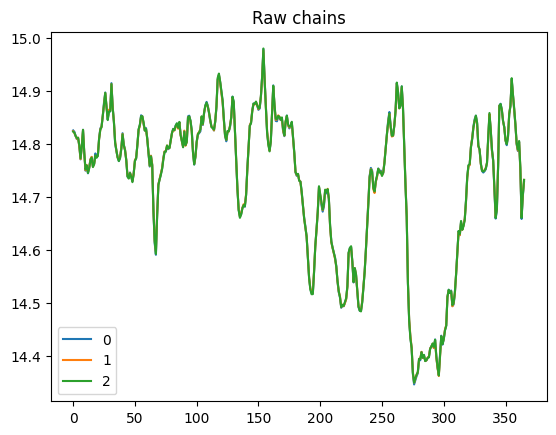

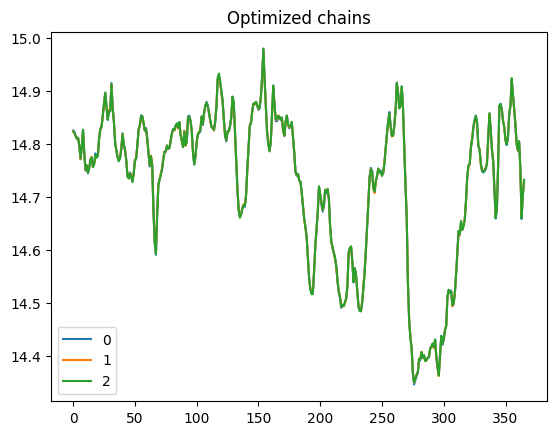

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.007   0.047    0.074        0.0      0.0     367.0     984.0   
eps  0.112  0.006   0.101    0.124        0.0      0.0    1993.0    4478.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 30 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.063  0.008   0.049    0.078        0.0      0.0     437.0    1045.0   
eps  0.125  0.006   0.113    0.138        0.0      0.0    1944.0    3852.0   

     r_hat  
sig   1.01  
eps   1.00  


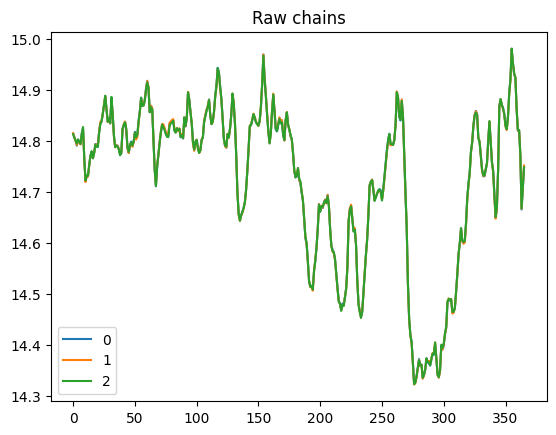

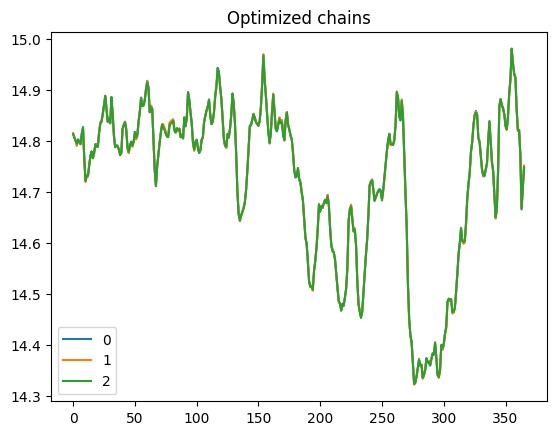

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.063  0.008   0.049    0.078        0.0      0.0     437.0    1045.0   
eps  0.125  0.006   0.113    0.138        0.0      0.0    1944.0    3852.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 14 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.047  0.004   0.040    0.054        0.0      0.0    1291.0    1802.0   
eps  0.048  0.003   0.041    0.054        0.0      0.0    1815.0    2876.0   

     r_hat  
sig    1.0  
eps    1.0  


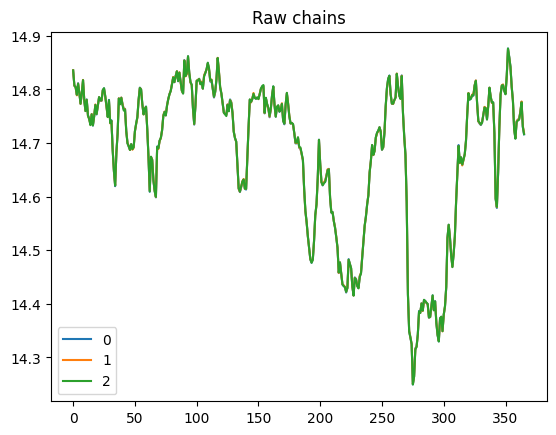

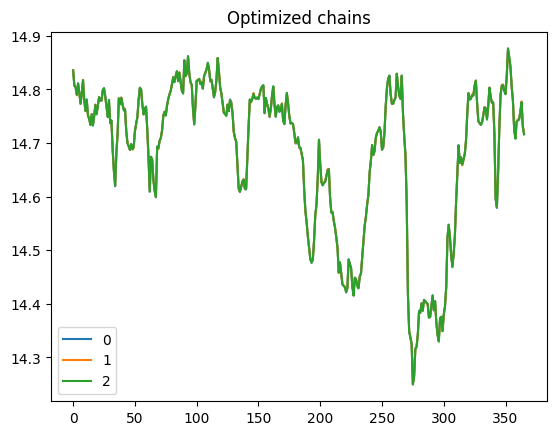

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.047  0.004   0.040    0.054        0.0      0.0    1291.0    1802.0   
eps  0.048  0.003   0.041    0.054        0.0      0.0    1815.0    2876.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 23 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.076        0.0      0.0     525.0     899.0   
eps  0.120  0.006   0.109    0.133        0.0      0.0    2438.0    4275.0   

     r_hat  
sig   1.01  
eps   1.00  


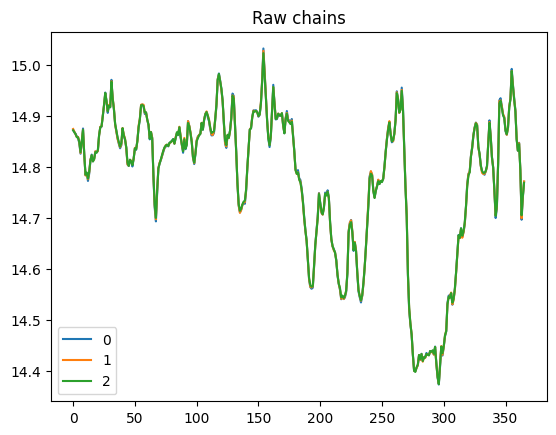

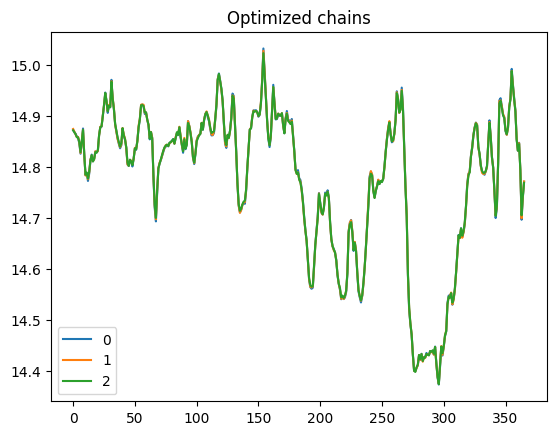

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.048    0.076        0.0      0.0     525.0     899.0   
eps  0.120  0.006   0.109    0.133        0.0      0.0    2438.0    4275.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 22 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.050    0.079        0.0      0.0     436.0     956.0   
eps  0.129  0.007   0.117    0.142        0.0      0.0    2064.0    3755.0   

     r_hat  
sig    1.0  
eps    1.0  


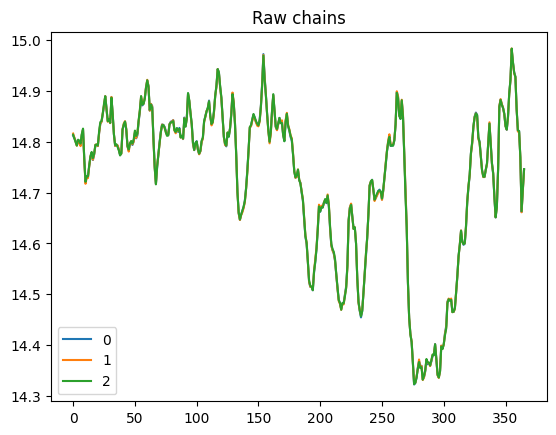

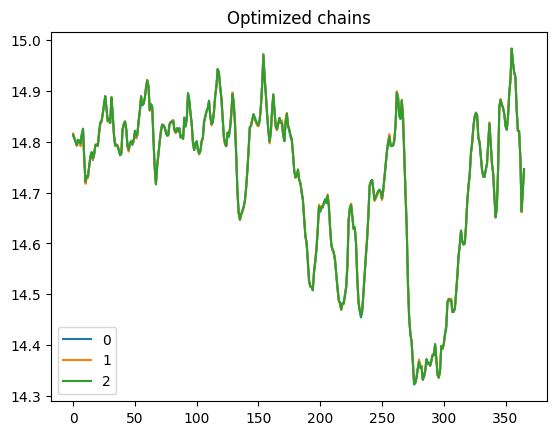

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.008   0.050    0.079        0.0      0.0     436.0     956.0   
eps  0.129  0.007   0.117    0.142        0.0      0.0    2064.0    3755.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.047    0.074        0.0      0.0     446.0    1000.0   
eps  0.116  0.006   0.105    0.128        0.0      0.0    2168.0    3703.0   

     r_hat  
sig    1.0  
eps    1.0  


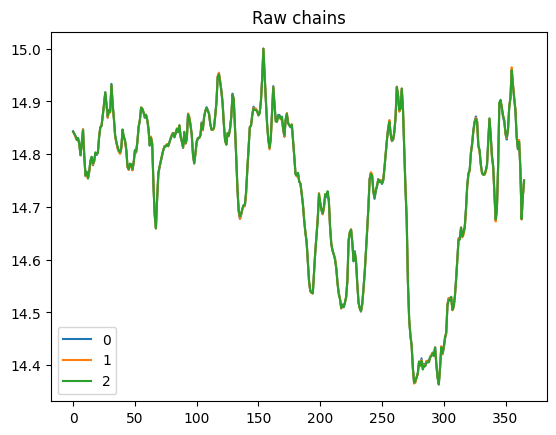

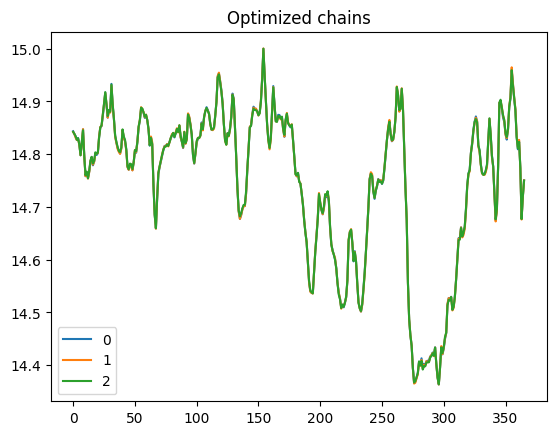

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.047    0.074        0.0      0.0     446.0    1000.0   
eps  0.116  0.006   0.105    0.128        0.0      0.0    2168.0    3703.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 26 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.008   0.047    0.075        0.0      0.0     495.0    1179.0   
eps  0.116  0.006   0.104    0.127        0.0      0.0    2448.0    3754.0   

     r_hat  
sig   1.01  
eps   1.00  


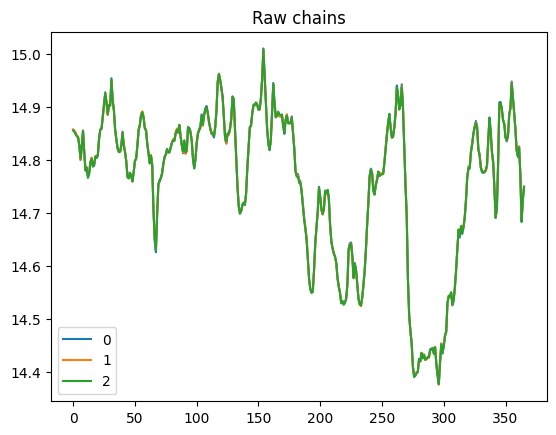

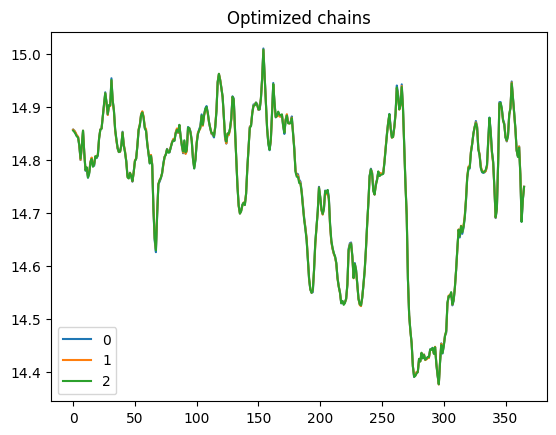

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.060  0.008   0.047    0.075        0.0      0.0     495.0    1179.0   
eps  0.116  0.006   0.104    0.127        0.0      0.0    2448.0    3754.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 11 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.047  0.004   0.040    0.054        0.0      0.0    1190.0    2536.0   
eps  0.047  0.003   0.041    0.053        0.0      0.0    1792.0    3190.0   

     r_hat  
sig   1.01  
eps   1.00  


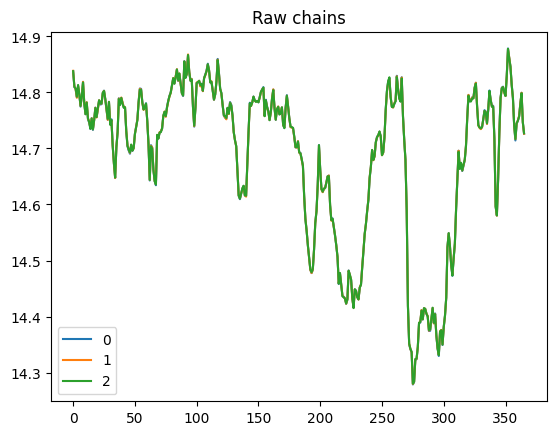

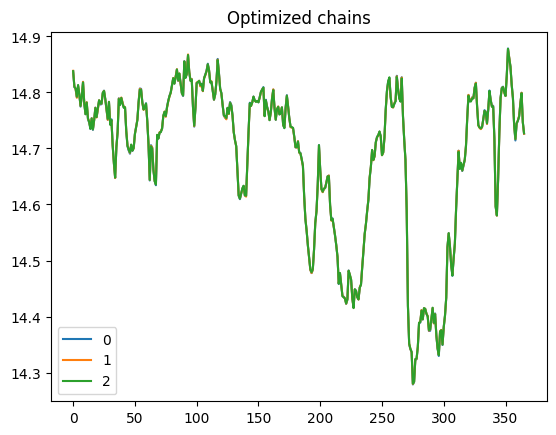

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.047  0.004   0.040    0.054        0.0      0.0    1190.0    2536.0   
eps  0.047  0.003   0.041    0.053        0.0      0.0    1792.0    3190.0   

     r_hat  
sig   1.01  
eps   1.00  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 21 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.062  0.007   0.048    0.076        0.0      0.0     532.0    1094.0   
eps  0.116  0.006   0.104    0.127        0.0      0.0    2237.0    3099.0   

     r_hat  
sig    1.0  
eps    1.0  


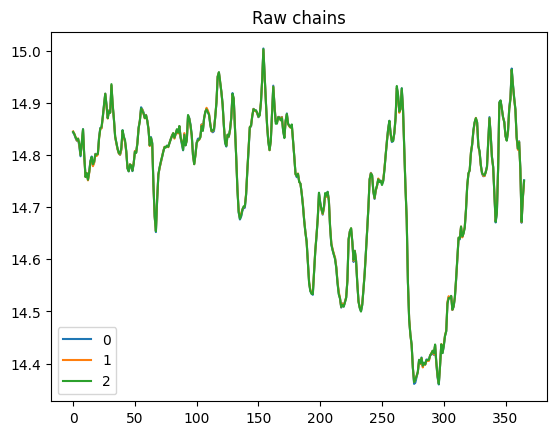

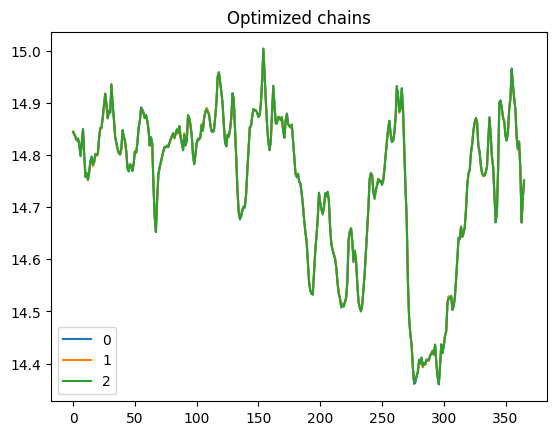

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.062  0.007   0.048    0.076        0.0      0.0     532.0    1094.0   
eps  0.116  0.006   0.104    0.127        0.0      0.0    2237.0    3099.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 26 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.007   0.051    0.079        0.0      0.0     688.0    1115.0   
eps  0.111  0.006   0.100    0.122        0.0      0.0    2503.0    2854.0   

     r_hat  
sig    1.0  
eps    1.0  


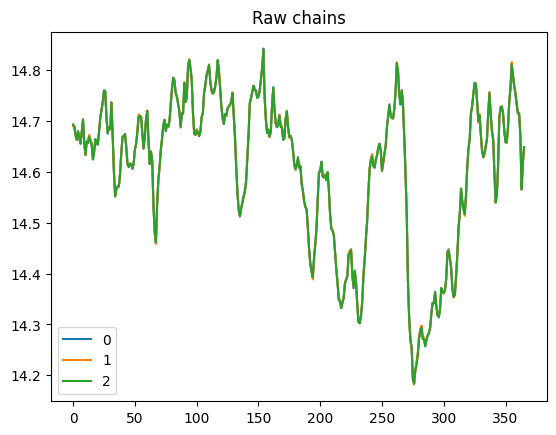

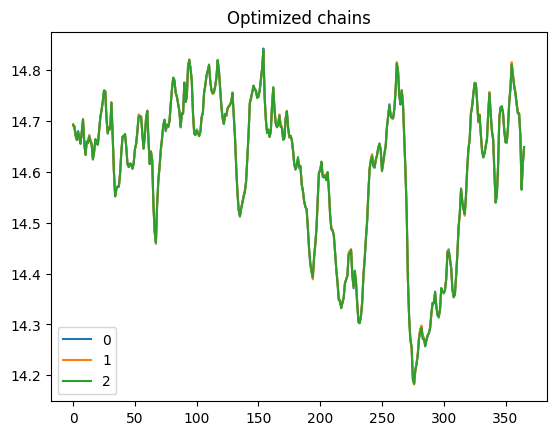

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.064  0.007   0.051    0.079        0.0      0.0     688.0    1115.0   
eps  0.111  0.006   0.100    0.122        0.0      0.0    2503.0    2854.0   

     r_hat  
sig    1.0  
eps    1.0  


/opt/anaconda3/envs/pymc5/lib/python3.9/site-packages/pymc/distributions/timeseries.py:558: UserWarning: Initial distribution not specified, defaulting to `Normal.dist(0, 100, shape=...)`. You can specify an init_dist manually to suppress this warning.
  warnings.warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (3 chains in 4 jobs)
NUTS: [sig, eps, latent]


Sampling 3 chains for 4_000 tune and 2_000 draw iterations (12_000 + 6_000 draws total) took 26 seconds.
We recommend running at least 4 chains for robust computation of convergence diagnostics


Raw summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.047    0.074        0.0      0.0     497.0    1265.0   
eps  0.116  0.006   0.105    0.128        0.0      0.0    2557.0    3877.0   

     r_hat  
sig    1.0  
eps    1.0  


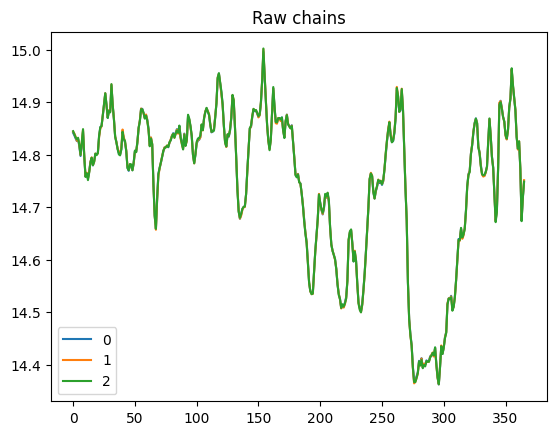

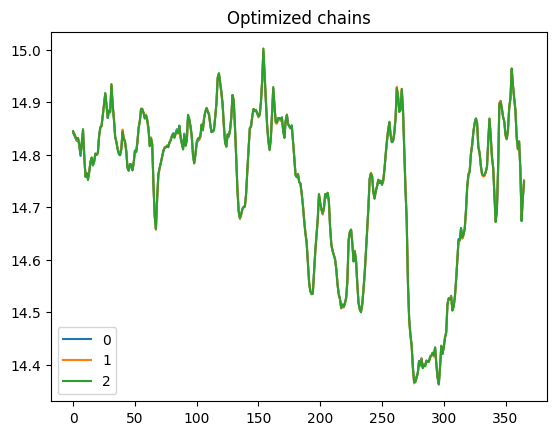

Best chain combination summary:
      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  ess_tail  \
sig  0.061  0.007   0.047    0.074        0.0      0.0     497.0    1265.0   
eps  0.116  0.006   0.105    0.128        0.0      0.0    2557.0    3877.0   

     r_hat  
sig    1.0  
eps    1.0  


In [53]:
for file in filtered_sev_glob:
    file_tail = file.split('model_8_')[1]
    file_fixed_param = file_tail.split('_')[0]
    file_combination = file_tail.split('_')[1].split('.csv')[0]

    sub_data = pd.read_csv(file, sep=';')
    sub_data.dateStart = pd.to_datetime(sub_data.dateStart)
    sub_data['obs'] = np.log(sub_data.Nt_hat)

    scou = fit_model(sub_data)

    sub_data['muX'] = scou.muX
    sub_data['CIL'] = scou.CIL
    sub_data['CIU'] = scou.CIU

    sub_data['muX'] = np.exp(scou.muX)
    sub_data['CIL'] = np.exp(scou.CIL)
    sub_data['CIU'] = np.exp(scou.CIU)

    sub_data = sub_data.rename(columns={'Nt_hat':'obs', 'muX':'Nt_hat'})

    output_filepath = file.replace('model_8', 'model_9')
    sub_data.to_csv(output_filepath, index=False, sep=";")